# <p style="border:3px solid DodgerBlue;text-align:center;font-size:100%;">ВВЕДЕНИЕ</p>
<div class="alert alert-info" role="alert">

### WHAT CASE ARE WE SOLVING?

Based on the provided real estate dataset, perform an Exploratory Data Analysis (EDA) and create a predictive model for property prices.

#### Data Description

<table>
    <thead>
        <tr>
            <th>Feature</th>
            <th>Description</th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td>status</td>
            <td>Sale status</td>
        </tr>
        <tr>
            <td>private pool / PrivatePool</td>
            <td>Presence of a private pool</td>
        </tr>
        <tr>
            <td>propertyType</td>
            <td>Type of property</td>
        </tr>
        <tr>
            <td>street</td>
            <td>Property address</td>
        </tr>
        <tr>
            <td>baths</td>
            <td>Number of bathrooms</td>
        </tr>
        <tr>
            <td>homeFacts</td>
            <td>Construction details (contains several types of information affecting the property valuation)</td>
        </tr>
        <tr>
            <td>fireplace</td>
            <td>Presence of a fireplace</td>
        </tr>
        <tr>
            <td>city</td>
            <td>City</td>
        </tr>
        <tr>
            <td>schools</td>
            <td>Information about nearby schools</td>
        </tr>
        <tr>
            <td>sqft</td>
            <td>Square footage</td>
        </tr>
        <tr>
            <td>zipcode</td>
            <td>ZIP code</td>
        </tr>
        <tr>
            <td>beds</td>
            <td>Number of bedrooms</td>
        </tr>
        <tr>
            <td>state</td>
            <td>State</td>
        </tr>
        <tr>
            <td>stories</td>
            <td>Number of stories</td>
        </tr>
        <tr>
            <td>mls-id / MlsId</td>
            <td>MLS (Multiple Listing Service) identifier</td>
        </tr>
        <tr>
            <td>target</td>
            <td>Property price (target variable to be predicted)</td>
        </tr>
    </tbody>
</table>


</div>

<a id = '0'></a>
<p style = "font-size : 30px; color : white ; text-align : center; background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>Contents</strong></p> 

<ul>
    <li><a href ="#1">1. Import necessary libraries</a></li>
    <li><a href ="#2">2. Create frequently used functions</a></li>
    <li><a href ="#3">3. Data exploration and feature engineering</a>
        <ul>
            <li><a href ="#3.1">3.1 Status</a></li>
            <li><a href ="#3.2">3.2 private pool / PrivatePool</a></li>
            <li><a href ="#3.3">3.3 PropertyType</a></li>
            <li><a href ="#3.4">3.4 Street</a></li>
            <li><a href ="#3.5">3.5 Baths</a></li>
            <li><a href ="#3.6">3.6 Beds</a></li>
            <li><a href ="#3.7">3.7 HomeFacts</a></li>
            <ul>
                <li><a href ="#3.71">3.71 Year Built</a></li>
                <li><a href ="#3.72">3.72 Remodeled Year</a></li>
                <li><a href ="#3.73">3.73 Heating Information</a></li>
                <li><a href ="#3.74">3.74 Cooling Information</a></li>
                <li><a href ="#3.75">3.75 Parking information</a></li>
                <li><a href ="#3.76">3.76 Lot Size</a></li>
                <li><a href ="#3.77">3.77 Price per sqrt</a></li>
            </ul>
            <li><a href ="#3.8">3.8 Fireplace</a></li>
            <li><a href ="#3.9">3.9 City</a></li>
            <li><a href ="#3.10">3.10 Schools</a></li>
            <ul>
                <li><a href ="#3.101">3.101 min_distance_school, num schools</a></li>
                <li><a href ="#3.102">3.102 distance_category</a></li>
                <li><a href ="#3.103">3.103 num_schools_category</a></li>
            </ul>
            <li><a href ="#3.11">3.11 Sqft</a></li>
            <li><a href ="#3.12">3.12 Zipcode</a></li>
            <li><a href ="#3.13">3.13 State</a></li>
            <li><a href ="#3.14">3.14 Stories</a></li>
            <li><a href ="#3.15">3.15 mls-id / MlsId</a></li>
            <li><a href ="#3.16">3.16 Target</a></li>
        </ul>
    </li>
    <li><a href ="#4">4. Feature selection</a></li>
    <li><a href ="#5">5. Model training and prediction</a>
        <ul>
            <li><a href ="#5.1">Algorithm - Linear regressor</a></li>
            <li><a href ="#5.2">Algorithm - Ridge</a></li>
            <li><a href ="#5.3">Algorithm - Lasso</a></li>
            <li><a href ="#5.4">Algorithm - RandomForest Regressor</a></li>
            <li><a href ="#5.5">Algorithm - CatBoost</a></li>
            <li><a href ="#5.6">Algorithm - XGB metric R2</a></li>
            <li><a href ="#5.7">Algorithm - XGB metric MAPE</a></li>
            <li><a href ="#5.8">Algorithm - GradientBoost Regressor</a></li>
            <li><a href ="#5.9">Algorithm - AdaBoost Regressor</a></li>
            <li><a href ="#5.10">Algorithm - LightGBM</a></li>
            <li><a href ="#5.11">Algorithm - H2o.ai</a></li>
            <li><a href ="#5.12">Algorithm - LightGBM TOP features</a></li>
            <li><a href ="#5.13">Algorithm - CatBoost TOP features</a></li>
        </ul>
    </li>
    <li><a href ="#6">6. Conclusion</a></li>
</ul>




<a id='1'></a>
<p style = "background-color : DarkGreen; border-radius: 5px 5px; padding : 10px"><strong>

# 1. Import necessary libraries
</strong></p>

In [25]:
# Import required libraries

# Libraries to work with Data
import numpy as np
import pandas as pd
import pickle
import re
import ast


# Libraries to generate a Graphics
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go

# Work with models and stats
from catboost import CatBoostRegressor
import xgboost as xgb
from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
from sklearn import linear_model
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.model_selection import GridSearchCV
import optuna
from sklearn.model_selection import cross_val_score, RepeatedKFold
from sklearn.metrics import mean_absolute_error, r2_score, mean_absolute_percentage_error
from sklearn.tree import DecisionTreeRegressor
import lightgbm as lgb
import h2o
from h2o.estimators import H2OGradientBoostingEstimator
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor
from scipy import stats
from scipy.stats import zscore
import statsmodels.api as sm
from statsmodels.stats.diagnostic import lilliefors
from statsmodels.formula.api import ols
from sklearn.model_selection import train_test_split

# Display features
from IPython.display import display, HTML
from math import log

%matplotlib inline

In [26]:
RANDOM_STATE = 42
df_results = pd.DataFrame()

<a id='2'></a>
<p style = "background-color : DarkGreen; border-radius: 5px 5px; padding : 10px"><strong>

# 2. Create frequently used functions
</strong></p>


In [27]:
def analyze_feature(data, feature):
    """
    Analyze a specific feature in a DataFrame.

    Parameters:
    data (pd.DataFrame): The DataFrame containing the data.
    feature (str): The name of the feature to analyze.

    Returns:
    None
    """
    color = 'green'

    if feature not in data.columns:
        display(HTML(f"<b style='color:red;'>Feature '{feature}' not found in the DataFrame.</b>"))
        return

    # Basic statistics
    display(HTML(f"<h3>Analysis of feature: {feature}</h3>"))
    desc = data[feature].describe(include='all')
    stats = desc.to_dict()
    for stat, value in stats.items():
        display(HTML(f"<b>{stat}:</b> <span style='color:{color}; font-weight:bold;'>{value}</span>"))

    # Missing values
    missing_values = data[feature].isnull().sum()
    missing_percentage = (missing_values / len(data)) * 100
    display(HTML(f"<b>Missing values:</b> <span style='color:{color}; font-weight:bold;'>{missing_values} ({missing_percentage:.2f}%)</span>"))

    # Unique values
    unique_values = data[feature].nunique()
    display(HTML(f"<b>Unique values:</b> <span style='color:{color}; font-weight:bold;'>{unique_values}</span>"))

    # Distribution plot
    plt.figure(figsize=(14, 6), dpi=200)
    
    if data[feature].dtype == 'object':
    
        # Get the top 60 unique values
        top_60_values = data[feature].value_counts().index[:60]
    
        sns.countplot(data=data, x=feature, order=top_60_values)
        plt.xticks(rotation=90, fontsize=6)
        plt.yticks(fontsize=8)
    else:
        sns.histplot(data[feature], kde=True)
        plt.xticks(fontsize=8)
        plt.yticks(fontsize=8)
    
    plt.title(f"Distribution of {feature}", fontsize=10)
    plt.xlabel(feature, fontsize=6)
    plt.ylabel('Count', fontsize=6)
    plt.show()
    
    # Display sorted unique values
    unique_sorted_values = data[feature].dropna().str.lower().value_counts().sort_index()[:50]
    display(HTML(f"<b>'>Sorted unique values (case insensitive) TOP 50:</b>"))
    for value, count in unique_sorted_values.items():
        display(HTML(f"<span style='color:{color}; font-weight:bold;'>{value} : {count}</span>"))

        

    
    # Boxplot
    if data[feature].dtype != 'object':
        plt.figure(figsize=(10, 5), dpi=120)
        sns.boxplot(x=data[feature])
        plt.title(f"Boxplot of {feature}", fontsize=10)
        plt.xlabel(feature, fontsize=9)
        plt.xticks(fontsize=8)
        plt.show()


def check_outliers(dataframe, feature, zq = 3, iq = 0.25):
    """
    This function checks for outliers in a specified feature of a dataframe using Z-Score and IQR methods.
    
    Parameters:
    dataframe (pd.DataFrame): The input dataframe.
    feature (str): The name of the feature to check for outliers.
    
    Returns:
    dict: A dictionary containing indices of outliers detected by Z-Score and IQR methods.
    """
    # Extract the feature column
    df_feature = dataframe[feature]

    # Check for outliers using Z-Score
    z_scores = zscore(df_feature)
    outliers_zscore = df_feature[np.abs(z_scores) > zq]
    outliers_zscore_indices = outliers_zscore.index.tolist()
    print(f'Outliers identified using Z-Score:\n{outliers_zscore}')
    print(f'Number of outliers using Z-Score: {len(outliers_zscore_indices)}')

    # Check for outliers using IQR
    Q1 = df_feature.quantile(iq)
    Q3 = df_feature.quantile(1 - (iq))
    IQR = Q3 - Q1
    outliers_iqr = df_feature[(df_feature < (Q1 - 1.5 * IQR)) | (df_feature > (Q3 + 1.5 * IQR))]
    outliers_iqr_indices = outliers_iqr.index.tolist()
    print(f'Outliers identified using IQR:\n{outliers_iqr}')
    print(f'Number of outliers using IQR: {len(outliers_iqr_indices)}')

    # Combine indices of outliers
    outliers_indices = {
        'z_score': outliers_zscore_indices,
        'iqr': outliers_iqr_indices
    }
    
    return outliers_indices

def remove_outliers(dataframe, indices):
    """
    This function removes rows from the dataframe based on specified indices.
    
    Parameters:
    dataframe (pd.DataFrame): The input dataframe.
    indices (list): A list of indices to be removed from the dataframe.
    
    Returns:
    pd.DataFrame: The dataframe with the specified indices removed.
    """
    # Remove specified indices
    cleaned_dataframe = dataframe.drop(index=indices)
    return cleaned_dataframe

def plot_histogram_qq(dataframe, feature, title, xlabel, ylabel, log_scale=False):
    """
    This function plots a histogram and a Q-Q plot for a specified feature in a dataframe.
    
    Parameters:
    dataframe (pd.DataFrame): The input dataframe.
    feature (str): The name of the feature to plot.
    title (str): The title of the plot.
    xlabel (str): The label for the x-axis.
    ylabel (str): The label for the y-axis.
    log_scale (bool): If True, use logarithmic scale for the x-axis in the histogram.
    
    Returns:
    None
    """
    
    # Extract the feature column
    df_feature = dataframe[feature].dropna()
    
    # Plot histogram
    plt.figure(figsize=(30, 6))
    plt.hist(df_feature, bins=30, edgecolor='k', alpha=0.7)
    plt.title(f'Histogram of {feature}')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.xticks(rotation=90, fontsize=7)
    if log_scale:
        plt.xscale('log')
    plt.show()
    
    # Plot Q-Q plot
    plt.figure(figsize=(10, 6))
    stats.probplot(df_feature, dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {feature}')
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.xticks(rotation=90)
    plt.show()

def check_normality(dataframe, feature):
    """
    This function checks for normality in a specified feature of a dataframe using Shapiro-Wilk and Lilliefors tests.
    
    Parameters:
    dataframe (pd.DataFrame): The input dataframe.
    feature (str): The name of the feature to check for normality.
    
    Returns:
    dict: A dictionary containing the results of the normality tests.
    """
    results = {}

    # Extract the feature column
    df_feature = dataframe[feature].dropna()

    # Kolmogorov-Smirnov test
    ks_stat, ks_p_value = stats.kstest(df_feature, 'norm', args=(np.mean(df_feature), np.std(df_feature)))
    print(f'Kolmogorov-Smirnov test: Statistic={ks_stat}, p-value={ks_p_value}')
    
    # Anderson-Darling test
    ad_test = stats.anderson(df_feature, dist='norm')
    print(f'Anderson-Darling test: Statistic={ad_test.statistic}')
    for i in range(len(ad_test.critical_values)):
        significance_level, critical_value = ad_test.significance_level[i], ad_test.critical_values[i]
        print(f'Significance level: {significance_level}%, Critical value: {critical_value}')

    # Lilliefors test
    lilliefors_test = lilliefors(df_feature)
    results['Lilliefors'] = {
            'statistic': lilliefors_test[0],
            'p-value': lilliefors_test[1]
        }
    print(f"Lilliefors test statistic: {lilliefors_test[0]}, p-value: {lilliefors_test[1]}")

    
    return results

def standardize_data(dataframe, feature):
    """
    This function standardizes a specified feature of a dataframe.
    
    Parameters:
    dataframe (pd.DataFrame): The input dataframe.
    feature (str): The name of the feature to standardize.
    
    Returns:
    pd.DataFrame: The dataframe with the feature standardized.
    """
    scaler = StandardScaler()
    dataframe[feature] = scaler.fit_transform(dataframe[[feature]])
    return dataframe

def calculate_metrics(y_true, y_pred, y_test, y_test_pred):
    """
    Calculate MAE, MAPE, and R-squared metrics.

    Parameters:
    y_true (array-like): True values
    y_pred (array-like): Predicted values

    Returns:
    dict: Dictionary containing MAE, MAPE, and R2
    """

    # Calculate Mean Absolute Error (MAE)
    mae = mean_absolute_error(y_true, y_pred)

    # Calculate Mean Absolute Percentage Error (MAPE)
    # MAPE is expressed as a percentage
    mape = np.mean(np.abs((y_true - y_pred) / y_true)) * 100

    # Calculate R-squared (R2)
    r2 = r2_score(y_true, y_pred)

    # Calculate Mean Absolute Error (MAE)
    mae_test = mean_absolute_error(y_test, y_test_pred)

    # Calculate Mean Absolute Percentage Error (MAPE)
    # MAPE is expressed as a percentage
    mape_test = np.mean(np.abs((y_test - y_test_pred) / y_test)) * 100

    # Calculate R-squared (R2)
    r2_test = r2_score(y_test, y_test_pred)

    # Return the results as a dictionary
    return {
        'MAE': mae,
        'MAPE': mape,
        'R2': r2,
        'MAE_TEST': mae_test,
        'MAPE_TEST': mape_test,
        'R2_TEST': r2_test
    }
    
def add_row_to_df(df: pd.DataFrame, data: dict, model_name: str) -> pd.DataFrame:
    """
    Adds a row to the given DataFrame with the key-value pairs from the provided dictionary
    and the specified model name.

    Parameters:
    df (pd.DataFrame): The DataFrame to which the row will be added.
    data (dict): The dictionary containing the key-value pairs for the new row.
    model_name (str): The model name to be added as a column.

    Returns:
    pd.DataFrame: The DataFrame with the new row added.
    """
    # Add the model name to the dictionary
    data['model'] = model_name
        
    # Convert the dictionary to a DataFrame with a single row
    new_row = pd.DataFrame([data])
        
    # Append the new row to the DataFrame
    df = pd.concat([df, new_row], ignore_index=True)
    
    return df

In [28]:
# Load data and see first 10 rows
df = pd.read_csv('data/data.csv')
df.head(10)

,status,private pool,propertyType,street,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,PrivatePool,MlsId,target
0,Active,NaN,Single Family Home,240 Heather Ln,3.5,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",Gas Logs,Southern Pines,"[{'rating': ['4', '4', '7', 'NR', '4', '7', 'N...",2900,28387,4,NC,NaN,NaN,NaN,611019,"$418,000"
1,for sale,NaN,single-family home,12911 E Heroy Ave,3 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Spokane Valley,"[{'rating': ['4/10', 'None/10', '4/10'], 'data...","1,947 sqft",99216,3 Beds,WA,2.0,NaN,NaN,201916904,"$310,000"
2,for sale,NaN,single-family home,2005 Westridge Rd,2 Baths,"{'atAGlanceFacts': [{'factValue': '1961', 'fac...",yes,Los Angeles,"[{'rating': ['8/10', '4/10', '8/10'], 'data': ...","3,000 sqft",90049,3 Beds,CA,1.0,NaN,yes,FR19221027,"$2,895,000"
3,for sale,NaN,single-family home,4311 Livingston Ave,8 Baths,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",yes,Dallas,"[{'rating': ['9/10', '9/10', '10/10', '9/10'],...","6,457 sqft",75205,5 Beds,TX,3.0,NaN,NaN,14191809,"$2,395,000"
4,for sale,NaN,lot/land,1524 Kiscoe St,NaN,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Palm Bay,"[{'rating': ['4/10', '5/10', '5/10'], 'data': ...",NaN,32908,NaN,FL,NaN,NaN,NaN,861745,"$5,000"
5,for sale,NaN,townhouse,1624 S Newkirk St,NaN,"{'atAGlanceFacts': [{'factValue': '1920', 'fac...",NaN,Philadelphia,"[{'rating': [], 'data': {'Distance': [], 'Grad...",897 sqft,19145,2 Beds,PA,2.0,NaN,NaN,PAPH847006,"$209,000"
6,Active,NaN,Florida,552 Casanova Ct,NaN,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",NaN,POINCIANA,"[{'rating': ['3', '3', '1', 'NR'], 'data': {'D...","1,507",34759,NaN,FL,One,NaN,NaN,S5026943,"181,500"
7,Active,NaN,NaN,6094 Mingle Dr,NaN,"{'atAGlanceFacts': [{'factValue': '1976', 'fac...",NaN,Memphis,"[{'rating': ['4', '2', '2'], 'data': {'Distanc...",NaN,38115,NaN,TN,NaN,NaN,NaN,10063506,"68,000"
8,Active,NaN,Single Family Home,11182 Owl Ave,2,"{'atAGlanceFacts': [{'factValue': '1970', 'fac...",NaN,Mason City,"[{'rating': ['2', '2', '4', '7', '4', 'NR'], '...",3588,50401,3,IA,NaN,NaN,NaN,190988,"$244,900"
9,NaN,NaN,Single Family,8612 Cedar Plains Ln,3,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Houston,"[{'rating': ['4/10', '3/10', '2/10'], 'data': ...","1,930",77080,3,TX,2.0,NaN,NaN,73968331,"$311,995"


Let's check the data to better understand what we have.



In [29]:
# Check a Data Structure
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 377185 entries, 0 to 377184
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype 
---  ------        --------------   ----- 
 0   status        337267 non-null  object
 1   private pool  4181 non-null    object
 2   propertyType  342452 non-null  object
 3   street        377183 non-null  object
 4   baths         270847 non-null  object
 5   homeFacts     377185 non-null  object
 6   fireplace     103114 non-null  object
 7   city          377151 non-null  object
 8   schools       377185 non-null  object
 9   sqft          336608 non-null  object
 10  zipcode       377185 non-null  object
 11  beds          285903 non-null  object
 12  state         377185 non-null  object
 13  stories       226469 non-null  object
 14  mls-id        24942 non-null   object
 15  PrivatePool   40311 non-null   object
 16  MlsId         310305 non-null  object
 17  target        374704 non-null  object
dtypes: object(18)
memory usa

<a id='3'></a>
<p style = "background-color : DarkGreen; border-radius: 5px 5px; padding : 10px"><strong>

# 3. Data exploration and feature engineering
</strong></p>


The initial dataset consists of 18 features and 377,185 instances. Additionally, we can observe that all features are of the object type. Let's conduct a sequential analysis of each feature.

- **'status'** — sale status;
- **'private pool', 'PrivatePool'** — presence of a private pool;
- **'propertyType'** — type of property;
- **'street'** — property address;
- **'baths'** — number of bathrooms;
- **'homeFacts'** — construction details of the property (contains various types of information affecting the property's evaluation);
- **'fireplace'** — presence of a fireplace;
- **'city'** — city;
- **'schools'** — information about schools in the area;
- **'sqft'** — area in square feet;
- **'zipcode'** — postal code;
- **'beds'** — number of bedrooms;
- **'state'** — state;
- **'stories'** — number of floors;
- **''mls-id','MlsId'** — MLS identifier;
- **'target'** — property price (the target feature to be predicted).

<a id = '3.1'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.1 Status

</strong></p> 

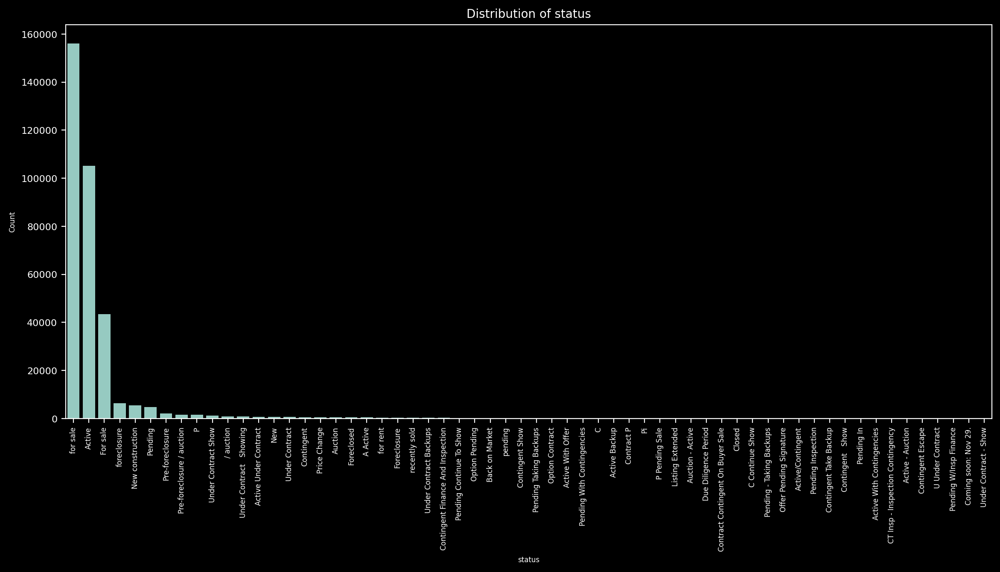

In [30]:
analyze_feature(df, 'status')

The column has 159 unique values and 39,918 missing values, which is too many to remove (approximately 10%). Some values are spelled differently but mean the same thing. We'll standardize them by converting everything to lowercase and filling the missing values with the most common one.

Additionally, I see that we have different spellings of the same phrases or phrases with similar meanings. Let's standardize them to a common format without losing accuracy.

Finally, we will group the statuses into related categories. Some rarely used statuses and records without any status will be moved to the "Other" category.


Firstly lets group statuses by meaning

### 1: Active offer
- 'Active'
- 'A Active'
- 'Active/Contingent'
- 'Active Under Contract'
- 'Active Contingency'
- 'Active With Contingencies'
- 'Active Option'
- 'Active Option Contract'
- 'Active - Auction'
- 'Active With Offer'
- 'Active Contingent'
- 'Active Backup'
- 'Active - Contingent'
- 'Active with Contract'

### 2: New buiding
- 'New construction'
- 'New'

### 3: Pending
- 'Pending'
- 'P'
- 'Pending   Continue To Show'
- 'Pending Ab'
- 'Pending Inspection'
- 'Pending Continue To Show'
- 'Pending, Continue to Show'
- 'Pending - Taking Backups'
- 'Pending Offer Approval'
- 'Pending In'
- 'Pending W/Insp Finance'
- 'Pending (Do Not Show)'
- 'Pending W/ Cont.'
- 'Pending W/Escape Clause'
- 'Pending - Continue to Show'
- 'Pending W/Backup Wanted'
- 'Pending Backups Wanted'
- 'Pending Fe'
- 'Pending Sale'
- 'Pending Take Backups'
- 'Pending - Backup Offer Requested'
- 'Pending Sh'
- 'P Pending Sale'
- 'Pf'
- 'Pi'
- 'Pending Taking Backups'
- 'Pending Bring Backup'
- 'Pending Backups Wanted'

### 4: Under contract
- 'Under Contract'
- 'Under Contract   Showing'
- 'Under Contract Backups'
- 'Under Contract Show'
- 'Under contract'
- 'U Under Contract'
- 'Under Contract - Show'
- 'Under Contract - No Show'
- 'Under Contract Taking Back Up Offers'
- 'Contract'
- 'Contract P'
- 'Conditional Contract'
- 'Accepted Offer'
- 'Backup Contract'
- 'Under Contract W/ Bckp'
- 'Backup'

### 5: Auction
- 'Auction'
- 'Pre-foreclosure / auction'
- ' / auction'
- 'Auction - Active'

### 6: Leasing/Rent
- 'for rent'
- 'Apartment for rent'
- 'Condo for rent'
- 'Lease/Purchase Pending'
- 'Lease/Purchase'

### 7: Sale
- 'for sale'
- 'For Sale'
- 'Price Change'
- 'Listing Extended'

### 8: Waiting for approve
- 'Contingent'
- 'Contingent Show'
- 'Contingent Take Backup'
- 'Contingent   Show'
- 'Contingent   Release'
- 'Contingent Escape'
- 'Contingent Lien Holder Release'
- 'Contingent   No Show'
- 'Contingent   Foreclosure'
- 'Conting Accpt Backups'
- 'Contingent - Sale of Home'
- 'Contingent Finance And Inspection'
- 'Contingent Finance and Inspection'
- 'CT Insp - Inspection Contingency'
- 'Contract Contingent On Buyer Sale'
- 'Contingency Contract'
- 'Contingency 48 Hr (+/ )'
- 'Contingent - Financing'
- 'Re Activated'
- 'Reactivated'
- 'Uc Continue To Show'
- 'C'
- 'C Continue Show'
- 'C Continue Show'
- 'Ct'

### 9: Closed deals
- 'Foreclosed'
- 'Foreclosure'
- 'foreclosure'
- 'recently sold'
- 'Closed'
- 'Sold: $285,000'
- 'Sold: $15,000'

### 10: Soon for sale
- 'Coming soon: Nov 21.'
- 'Coming soon: Dec 4.'
- 'Coming soon: Nov 23.'
- 'Coming soon: Nov 29.'
- 'Coming soon: Dec 2.'
- 'Coming soon: Nov 30.'
- 'Coming soon: Dec 10.'
- 'Coming soon: Dec 24.'
- 'Coming soon: Nov 14.'
- 'Coming soon: Nov 22.'
- 'Coming soon: Oct 21.'
- 'Coming soon: Dec 14.'
- 'Coming soon: Oct 24.'
- 'Coming soon: Dec 18.'
- 'Coming soon: Dec 16.'
- 'Coming soon: Dec 3.'
- 'Coming soon: Dec 25.'
- 'Coming soon: Nov 11.'
- 'Coming soon: Nov 28.'
- 'Coming soon: Nov 17.'
- 'Coming soon: Nov 27.'
- 'Coming soon: Nov 26.'
- 'Coming soon: Dec 7.'
- 'Coming soon: Dec 27.'
- 'Coming soon: Dec 11.'
- 'Coming soon: Dec 5.'
- 'Coming soon: Nov 13.'
- 'Coming soon: Nov 19.'
- 'Coming soon: Nov 8.'
- 'Coming soon: Oct 29.'
- 'Coming soon: Dec 15.'
- 'Coming soon: Oct 30.'
- 'Coming soon: Dec 9.'
- 'Coming soon: Nov 5.'
- 'Coming soon: Nov 12.'
- 'Coming soon: Dec 1.'
- 'Coming soon: Nov 25.'
- 'Coming soon: Dec 23.'
- 'Coming soon: Dec 20.'
- 'Coming soon: Dec 13.'
- 'Coming soon: Nov 6.'



In [31]:
def categorize_status(status):
    # Groups and their patterns
    patterns = {
        'Active': [
            r'^Active$', r'^A Active$', r'^Active/Contingent$', r'^Active Under Contract$',
            r'^Active Contingency$', r'^Active With Contingencies$', r'^Active Option$',
            r'^Active Option Contract$', r'^Active - Auction$', r'^Active With Offer$',
            r'^Active Contingent$', r'^Active Backup$', r'^Active - Contingent$', r'^Active with Contract$'
        ],
        'New construction': [r'^New construction$', r'^New$'],
        'Pending': [
            r'^Pending$', r'^P$', r'^Pending   Continue To Show$', r'^Pending Ab$', r'^Pending Inspection$',
            r'^Pending Continue To Show$', r'^Pending, Continue to Show$', r'^Pending - Taking Backups$',
            r'^Pending Offer Approval$', r'^Pending In$', r'^Pending W/Insp Finance$', r'^Pending \(Do Not Show\)$',
            r'^Pending W/ Cont.$', r'^Pending W/Escape Clause$', r'^Pending - Continue to Show$',
            r'^Pending W/Backup Wanted$', r'^Pending Backups Wanted$', r'^Pending Fe$', r'^Pending Sale$',
            r'^Pending Take Backups$', r'^Pending - Backup Offer Requested$', r'^Pending Sh$', r'^P Pending Sale$',
            r'^Pf$', r'^Pi$', r'^Pending Taking Backups$', r'^Pending Bring Backup$', r'^Pending Backups Wanted$'
        ],
        'Under Contract': [
            r'^Under Contract$', r'^Under Contract   Showing$', r'^Under Contract Backups$', r'^Under Contract Show$',
            r'^Under contract$', r'^U Under Contract$', r'^Under Contract - Show$', r'^Under Contract - No Show$',
            r'^Under Contract Taking Back Up Offers$', r'^Contract$', r'^Contract P$', r'^Conditional Contract$',
            r'^Accepted Offer$', r'^Backup Contract$', r'^Under Contract W/ Bckp$', r'^Backup$'
        ],
        'Auction': [r'^Auction$', r'^Pre-foreclosure / auction$', r'^ / auction$', r'^Auction - Active$'],
        'For Rent': [r'^for rent$', r'^Apartment for rent$', r'^Condo for rent$', r'^Lease/Purchase Pending$', r'^Lease/Purchase$'],
        'For Sale': [r'^for sale$', r'^For Sale$', r'^Price Change$', r'^Listing Extended$'],
        'Contingent': [
            r'^Contingent$', r'^Contingent Show$', r'^Contingent Take Backup$', r'^Contingent   Show$',
            r'^Contingent   Release$', r'^Contingent Escape$', r'^Contingent Lien Holder Release$',
            r'^Contingent   No Show$', r'^Contingent   Foreclosure$', r'^Conting Accpt Backups$',
            r'^Contingent - Sale of Home$', r'^Contingent Finance And Inspection$', r'^Contingent Finance and Inspection$',
            r'^CT Insp - Inspection Contingency$', r'^Contract Contingent On Buyer Sale$', r'^Contingency Contract$',
            r'^Contingency 48 Hr \(\+/ \)$', r'^Contingent - Financing$', r'^Re Activated$', r'^Reactivated$', r'^Uc Continue To Show$',
            r'^C$', r'^C Continue Show$', r'^Ct$'
        ],
        'Closed': [
            r'^Foreclosed$', r'^Foreclosure$', r'^foreclosure$', r'^recently sold$', r'^Closed$', r'^Sold: \$285,000$', r'^Sold: \$15,000$'
        ],
        'Coming Soon': [
            r'^Coming soon: .*'
        ]
    }

    for group, regex_patterns in patterns.items():
        for pattern in regex_patterns:
            if re.match(pattern, status, re.IGNORECASE):
                return group

    return 'Other'

# Create a new feature -> categorize_status
df['status'] = df['status'].astype(str).fillna('')
df['status'] = df['status'].astype(str)
df['status_category'] = df.status.apply(categorize_status)



Lets have a look of created categories

We have 11 categories, of which 3 are significantly different from the others: For Sale, Active, and Other.


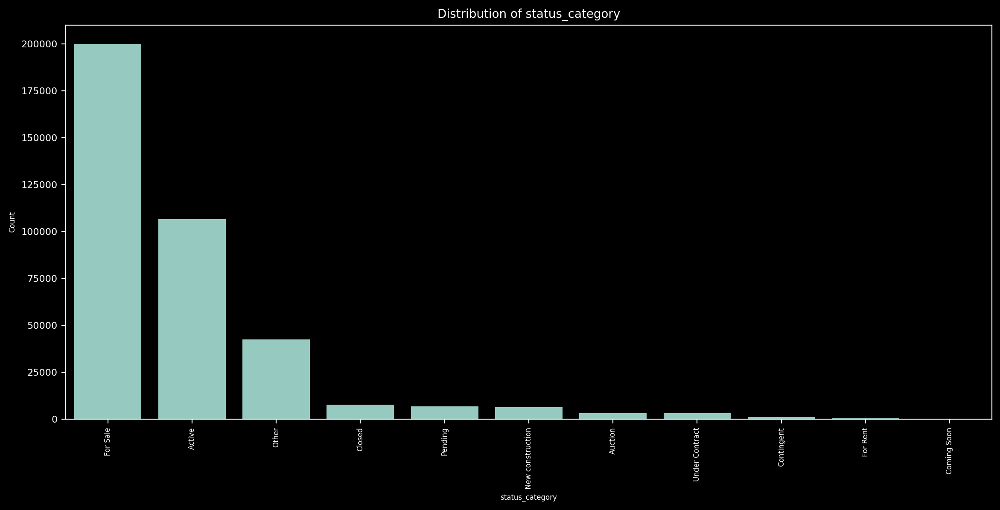

In [32]:
analyze_feature(df, 'status_category')

In [33]:
list(df.status_category.value_counts().index)

['For Sale',
 'Active',
 'Other',
 'Closed',
 'Pending',
 'New construction',
 'Auction',
 'Under Contract',
 'Contingent',
 'For Rent',
 'Coming Soon']

In [34]:
# drop old feature
df.drop(['status'], axis=1, inplace=True)

<a id = '3.2'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.2 private pool, PrivatePool

</strong></p> 



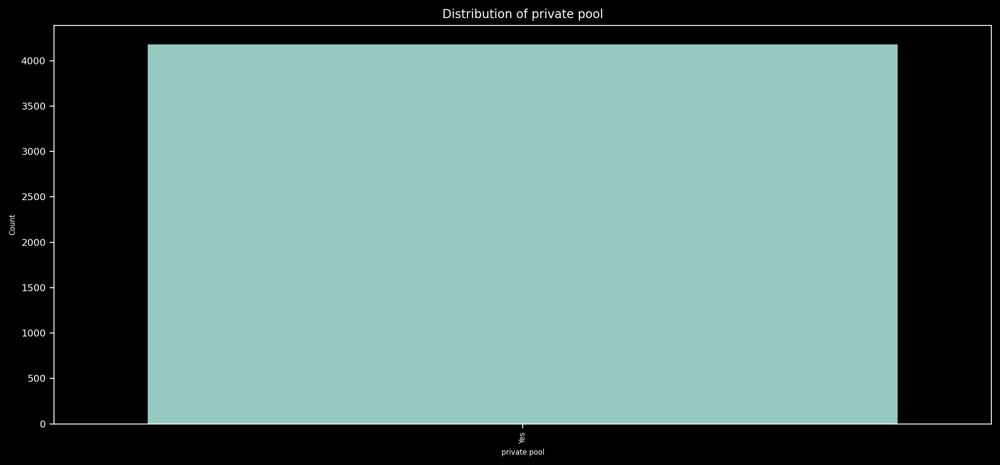

In [35]:
analyze_feature(df, 'private pool')

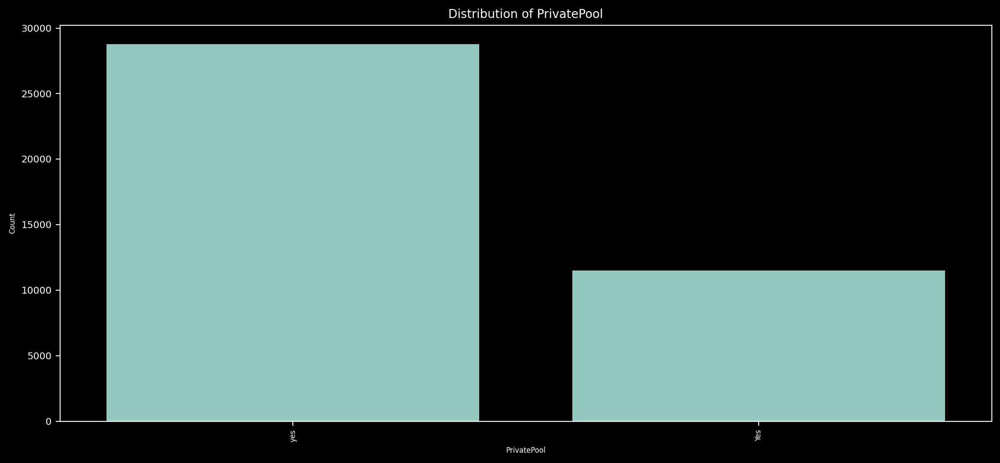

In [36]:
analyze_feature(df, 'PrivatePool')

I see that we have two similar features: "private pool" and "PrivatePool," which indicate the presence of a private pool in the property. In one case, "Yes" is used to indicate the presence of a pool and "NaN" for its absence. In the other case, it is similar, but "Yes" and "yes" are both used to indicate the presence of a pool.

Also check, if these features doen't crosses

In [37]:
filtered_df = df[df['private pool'].notna() & df['PrivatePool'].notna()]
print(filtered_df)

Empty DataFrame
Columns: [private pool, propertyType, street, baths, homeFacts, fireplace, city, schools, sqft, zipcode, beds, state, stories, mls-id, PrivatePool, MlsId, target, status_category]
Index: []


Since the values of the features do not overlap, we can standardize them to 'Yes' and 'No' and combine the values of both features into one.

In [38]:
df['private pool'] = df['private pool'].apply(lambda x: 'Yes' if x=='Yes' else 'No')
df['PrivatePool'] = df['PrivatePool'].apply(lambda x: 'Yes' if (x=='Yes' or x=='yes') else 'No')
# Union features in new feature
df['PrivatePoolStatus'] = df.apply(
    lambda row: 'Yes' if row['private pool'] == 'Yes' or row['PrivatePool'] == 'Yes' else 'No',
    axis=1
)



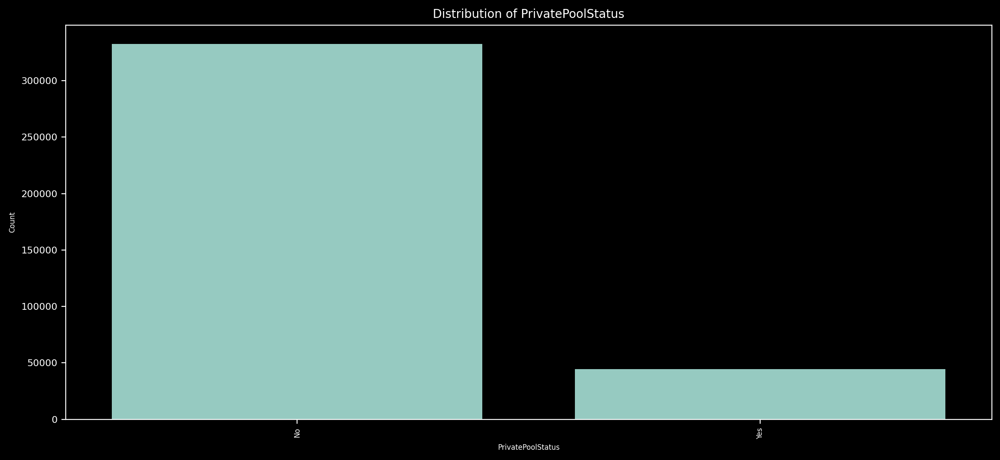

In [39]:
analyze_feature(df, 'PrivatePoolStatus')

We have finished with this feature. We combined the two similar features into one and standardized the values to "Yes" and "No."

In [40]:
# drop old features
df.drop(['private pool'], axis=1, inplace=True)
df.drop(['PrivatePool'], axis=1, inplace=True)

<a id = '3.3'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.3 PropertyType

</strong></p> 


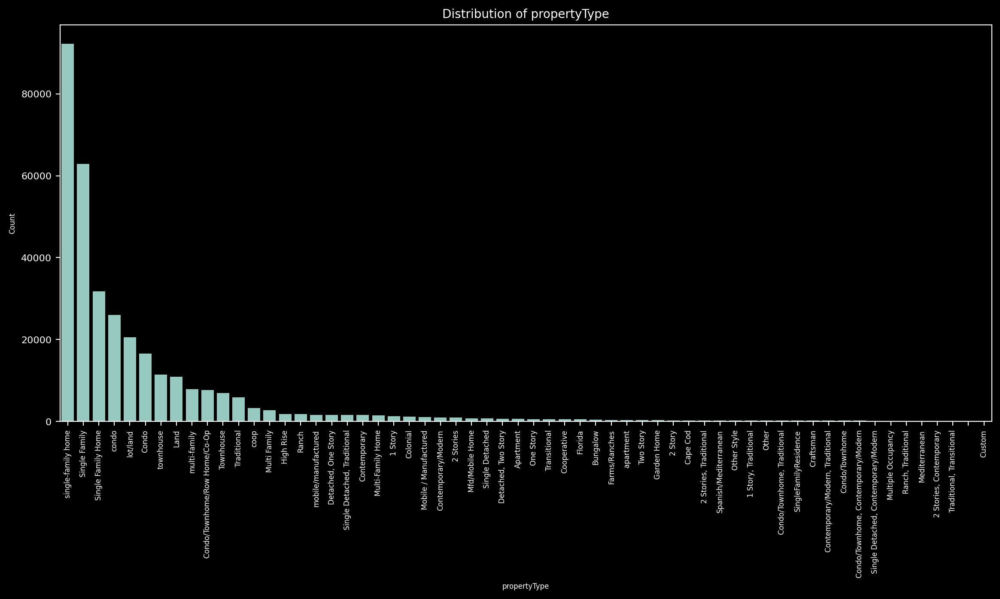

In [41]:
analyze_feature(df, 'propertyType')

Based on values this feature, the main groups of building types can be determined as follows:

### Main Groups by Building Type:

Based on the provided file, here are the main groups of property types:

### Main Groups by Building Type:

1. **Single-Family Home**
   - Examples: 'single-family home', 'Single Family', 'Single Family Home', 'SingleFamilyResidence'

2. **Condominium/Apartment**
   - Examples: 'condo', 'Condo', 'apartment', 'Apartment', 'Condominium'

3. **Townhouse**
   - Examples: 'townhouse', 'Townhouse', 'Condo/Townhome', 'Condo/Townhome/Row Home/Co-Op'

4. **Multi-Family Home**
   - Examples: 'multi-family', 'Multi Family', 'Multi-Family Home'

5. **Land/Lot**
   - Examples: 'lot/land', 'Land', 'Residential (<1 Acre)', 'Residential (1+ Acre)'

6. **Manufactured/Mobile Home**
   - Examples: 'mobile/manufactured', 'Mfd/Mobile Home', 'Manufactured House', 'Manufactured Home', 'Manufactured Single-Wide', 'Manufactured Double-Wide'

7. **Ranch**
   - Examples: 'Ranch', 'Rancher', 'Ranch, One Story', 'Single Detached, Ranch'

8. **Bungalow**
   - Examples: 'Bungalow', 'Bungalow, Craftsman', 'Bungalow, Colonial'

9. **Colonial**
   - Examples: 'Colonial', 'Colonial, Traditional', 'Colonial, Contemporary'

10. **Contemporary/Modern**
    - Examples: 'Contemporary', 'Contemporary/Modern', 'Modern', 'Contemporary/Modern, Traditional'

11. **Cottage**
    - Examples: 'Cottage', 'Bungalow, Cottage', 'Cape Cod, Cottage'

12. **Traditional**
    - Examples: 'Traditional', 'Single Detached, Traditional', '1 Story, Traditional'

13. **Victorian**
    - Examples: 'Victorian', 'Victorian/Federal', 'Colonial, Victorian'

14. **Cape Cod**
    - Examples: 'Cape Cod', 'Cape', 'Bungalow, Cape Cod'

15. **Other/Various Styles**
    - Examples: 'Other Style', 'Miscellaneous', 'Custom', 'Other', 'Unknown'



In [42]:

# Comprehensive mapping dictionary for grouping
property_type_patterns = {
    'Single-Family Home': [
        r'single-family home', r'single family', r'single family home', r'singlefamilyresidence', r'single detached',
        r'detached,? one story',  r'detached,? two story', r'single detached,? traditional', r'single detached,? contemporary/modern',
        r'single detached,? ranch', r'one story', r'two story', r'single detached,? french', r'1\.5 story|2\.5 story|1 story|2 story|3 story', r'2 stories', r'3+ stories',
    ],
    'Condominium/Apartment': [
        r'condo', r'condominium', r'apartment', r'condo/unit', r'condo/townhome,? traditional',
        r'condo/townhome', r'condominium \(single level\)', r'apartment for rent',r'penthouse', r'flat', r'studio'
    ],
    'Townhouse': [
        r'townhouse', r'condo/townhome/row home/co-op', r'townhome style', r'townhouse,? modern',
        r'condo/townhome,? contemporary/modern', r'condo/townhome,? hi-rise,? contemporary/modern',
        r'townhouse,? traditional'
    ],
    'Multi-Family Home': [
        r'multi-family', r'multi family', r'multi-family home', r'multiple occupancy', r'duplex', r'fourplex', r'triplex',
        r'multi-family home', r'multiplex', r'multi-family'
    ],
    'Land/Lot': [
        r'lot/land', r'land', r'residential \(<1 acre\)', r'residential \(1\+ acre\)', r'farms/ranches',
        r'farm/ranch house', r'land/lot', r'farm',r'commercial/industrial', r'warehouse'
        r'co-op'
    ],
    'Manufactured/Mobile Home': [
        r'mobile/manufactured', r'mfd/mobile home', r'manufactured house', r'manufactured home',
        r'manufactured single-wide', r'manufactured double-wide', r'manufactured home', r'mobile home',
        r'mobile/manufactured'
    ],
    'Ranch': [
        r'ranch', r'rancher', r'ranch,? one story', r'single detached,? ranch', r'ranch,? traditional'
    ],
    'Bungalow': [
        r'bungalow', r'bungalow,? craftsman', r'bungalow,? colonial', r'bungalow,? traditional'
    ],
    'Colonial': [
        r'colonial', r'colonial,? traditional', r'colonial,? contemporary', r'colonial,? modern'
    ],
    'Contemporary/Modern': [
        r'contemporary', r'contemporary/modern', r'modern', r'contemporary/modern,? traditional', r'contemporary/modern,? ranch',
        r'contemporary/modern,? mediterranean', r'modernist'
    ],
    'Cottage': [
        r'cottage', r'bungalow,? cottage', r'cape cod,? cottage', r'cottage,? traditional'
    ],
    'Traditional': [
        r'traditional', r'single detached,? traditional', r'1 story,? traditional', r'traditional,? contemporary'
    ],
    'Victorian': [
        r'victorian', r'victorian/federal', r'colonial,? victorian', r'victorian,? traditional'
    ],
    'Cape Cod': [
        r'cape cod', r'cape', r'bungalow,? cape cod', r'cape cod,? traditional'
    ],
    'Other/Various Styles': [
        r'other style', r'miscellaneous', r'custom', r'unknown',
    ]
}
# Inverting the dictionary for mapping
inverse_mapping = {v: k for k, values in property_type_patterns.items() for v in values}

# Function to map property types
def map_property_type(x):
    if isinstance(x, str):
        for category, patterns in property_type_patterns.items():
            for pattern in patterns:
                if re.search(pattern, x, re.IGNORECASE):
                    return category
    return 'Other/Various Styles'


# Applying the mapping to the DataFrame
df['propertyTypeGroup'] = df['propertyType'].apply(map_property_type)



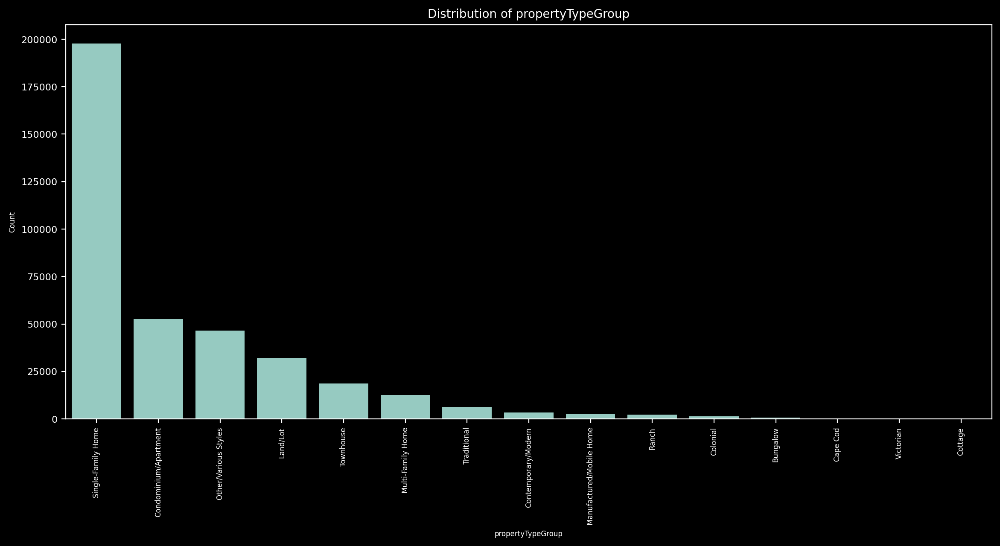

In [43]:
analyze_feature(df, 'propertyTypeGroup')

Considering that we should only take residential properties into account, I have grouped land plots and commercial spaces under Land/Lot.

We will delete these entries.

Additionally, I observe that there are very few records in the last groups. Therefore, I think we should limit ourselves to the first 10 groups, and categorize the remaining entries under Various/Other.

In [44]:
drop_property_index = df[df.propertyTypeGroup=='Land/Lot'].index
df.drop(drop_property_index,  inplace=True)
df = df.reset_index(drop=True)

def less_group(group_name):
    if group_name in['Bungalow','Victorian','Cape Cod','Cottage']:
        return 'Other/Various Styles'
    else:
        return group_name



df.propertyTypeGroup = df.propertyTypeGroup.apply(less_group)

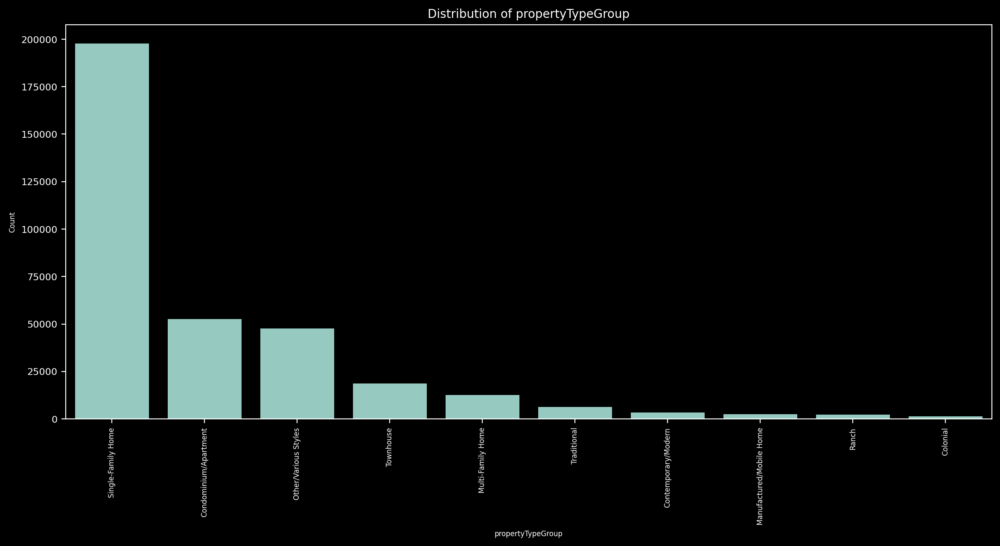

In [45]:
analyze_feature(df, 'propertyTypeGroup')

In [46]:
# drop old features
df.drop(['propertyType'], axis=1, inplace=True)

<a id = '3.4'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.4 Street

</strong></p> 


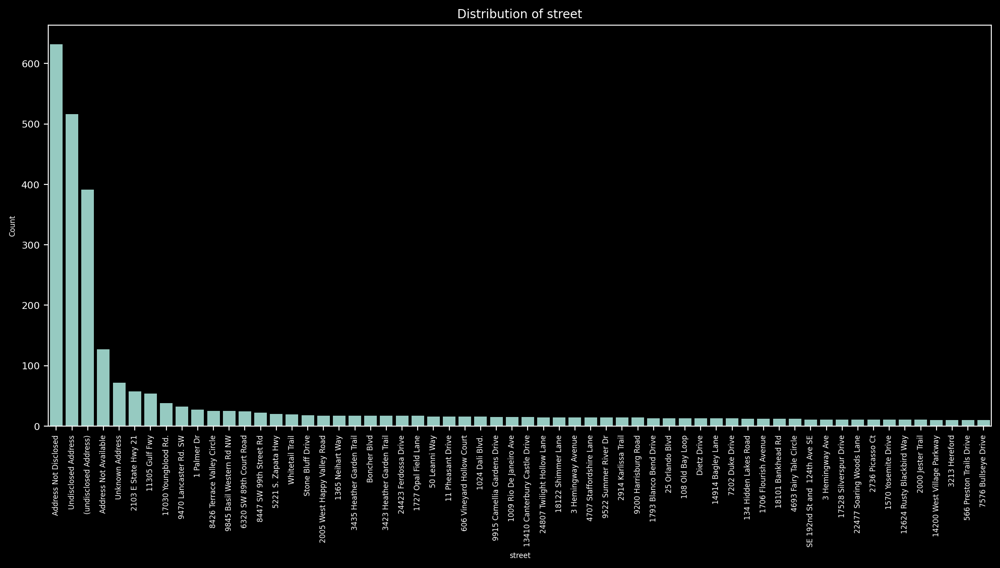

In [47]:
analyze_feature(df, 'street')

This feature is essentially unique, and without processing it in some way, such as identifying city districts, we will not obtain any useful information for the model.

Due to time constraints for additional research, we will remove this feature.

In [48]:
# drop old features
df.drop(['street'], axis=1, inplace=True)

<a id = '3.5'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.5 Baths

</strong></p> 

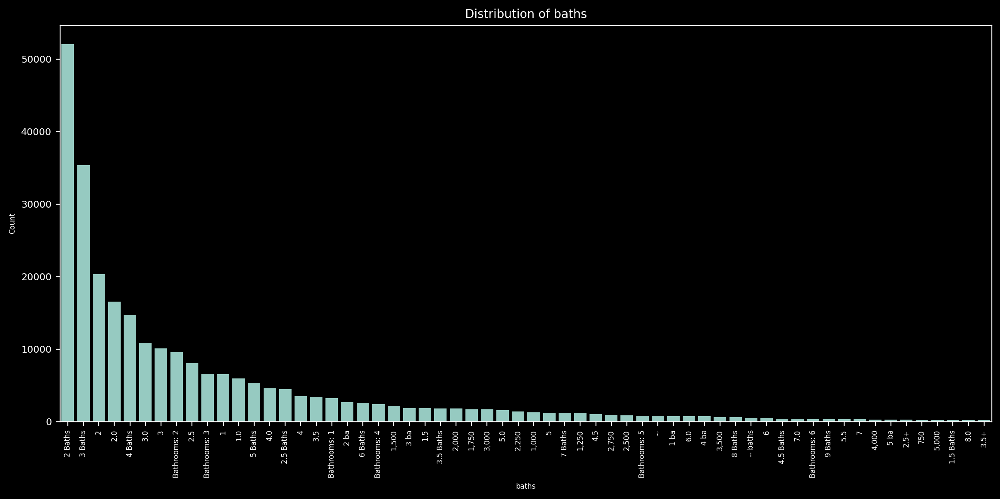

In [49]:
analyze_feature(df, 'baths')

There appears to be a complete mess with the data entries in this field. We also observe that the majority of records clearly indicate, for example, "2 baths" or simply "2" or "2.0." 

Also we have a lot of records which looks like 1.250 or 1.750

I checked an inrnet and found next explanation


1.0 = 1 full bathroom
1.5 = 1 full bathroom and 1 half bathroom
1.75 = 1 full bathroom, 1 three-quarter bathroom (usually includes a shower, sink, and toilet, but no tub)
2.5 = 2 full bathrooms and 1 half bathroom
3.75 = 3 full bathrooms and 1 three-quarter bathroom

Its mean that records like 1.250 has a meant and we need to translate exisiting mess to numbers


In [50]:
# Have a look for unique data
df.baths.sort_values().unique()


array(['-- baths', '0', '0 / 0', '0.0', '0.00', '0.75 Baths', '1',
       '1 / 1 / 1 / 1', '1 / 1-0 / 1-0 / 1-0', '1 ba', '1,000', '1,250',
       '1,500', '1,750', '1-0 / 1-0 / 1', '1-2 Baths', '1.0', '1.1 Baths',
       '1.25 Baths', '1.5', '1.5 Baths', '1.5 ba', '1.5+', '1.75 Baths',
       '1.75 ba', '1.8 Baths', '10', '10 Baths', '10 ba', '10.0', '10.5',
       '10.5 Baths', '10.5+', '11', '11 Baths', '11 ba', '11.0',
       '11.5 Baths', '11.5+', '116 / 116 / 116', '12', '12 Baths',
       '12 ba', '12.0', '12.5', '12.5+', '13', '13 Baths', '13 ba',
       '13.0', '14', '14 Baths', '14.0', '14.5+', '15', '15 Baths',
       '15.0', '16', '16 Baths', '16 ba', '16.0', '17', '17 Baths',
       '17.0', '18', '18 Baths', '18.0', '19 Baths', '2', '2 Baths',
       '2 ba', '2 baths', '2,000', '2,250', '2,500', '2,750',
       '2-1 / 2-1 / 1-1 / 1-1', '2.0', '2.1 Baths', '2.2 Baths',
       '2.25 Baths', '2.25 ba', '2.5', '2.5 Baths', '2.5 ba', '2.5+',
       '2.75 Baths', '2.8 Baths', '2

In [51]:
# fill Nan Values with 'no data'
df['baths'] = df['baths'].fillna('no data')

In [52]:
# Clean data
def clean_baths_data(baths):
    # Groups and their patterns
    patterns = {
        'no data': [
            r'Bathrooms: SemiMod', r'Sq. Ft. ', r'~', r'—'
        ],
        '0.0': [r'-- baths', r'0', r'0 / 0', r'0.0', r'0.00'],
        '2.0':[r'1-2'],
        '3.0': [r'1-0 / 1-0 / 1'],
        '4.0':[r'1 / 1 / 1 / 1',r'1 / 1-0 / 1-0 / 1-0'],
        '5.0':[r'3-1 / 2-2'],
        '6.0':[r'2-1 / 2-1 / 1-1 / 1-1'],
        '116.0':[r'116 / 116 / 116']
    }

    for group, regex_patterns in patterns.items():
        for pattern in regex_patterns:
            if re.match(pattern, baths, re.IGNORECASE):
                return group

    return baths


def clean_bath_data_remove_words(baths):
    if baths == 'no data':
        return baths
    else:
        return float(re.sub(r'[^\d.,]', '', baths.replace(',','.')))


In [53]:
# Applying the mapping to the DataFrame
df['bathCleaned'] = df['baths'].apply(clean_baths_data)
df['bathCleaned'] = df['bathCleaned'].apply(clean_bath_data_remove_words)

In [54]:
df['bathCleaned'].unique()

array([3.5, 3.0, 2.0, 8.0, 'no data', 1.75, 4.0, 5.0, 1.0, 7.0, 2.1, 2.5,
       4.5, 6.0, 5.5, 1.5, 1.25, 9.0, 2.25, 12.0, 2.75, 0.0, 750.0, 10.0,
       19.0, 7.5, 18.0, 11.0, 1.1, 6.5, 16.0, 13.0, 14.0, 8.5, 17.0,
       241.0, 20.0, 40.0, 24.0, 22.0, 3.1, 3.25, 32.0, 27.0, 26.0, 9.5,
       15.0, 35.0, 3.75, 29.0, 116.0, 21.0, 5.2, 14.5, 76.0, 10.5, 23.0,
       3.3, 43.0, 34.0, 2.2, 55.0, 25.0, 12.5, 44.0, 4.25, 4.75, 4.1,
       5.25, 41.0, 1.8, 36.0, 30.0, 28.0, 2.8, 64.0, 11.5, 39.0, 42.0,
       3.2, 60.0, 6.75, 68.0], dtype=object)

I see that we have some records with huge quantity of baths. Lets check this records in details

In [55]:
df[df.bathCleaned == 750.0].head(10)

,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned
1026,750,"{'atAGlanceFacts': [{'factValue': '1993', 'fac...",1,Dallas,"[{'rating': ['5', '5', '2', '10'], 'data': {'D...","1,758",75219,Baths,TX,NaN,NaN,14240509,"499,000",Active,No,Multi-Family Home,750.0
1868,750,"{'atAGlanceFacts': [{'factValue': '2013', 'fac...",NaN,Washington,"[{'rating': ['8', '8', '3', '8'], 'data': {'Di...","1,367",20001,NaN,DC,NaN,NaN,DCDC449992,"1,499,000",Active,No,Other/Various Styles,750.0
3294,750,"{'atAGlanceFacts': [{'factValue': '1981', 'fac...",NaN,DENVER,"[{'rating': ['5', 'NR', '5', '2'], 'data': {'D...",873,80204,Baths,CO,NaN,NaN,7106586,"348,900",Active,No,Other/Various Styles,750.0
6913,750,"{'atAGlanceFacts': [{'factValue': '1936', 'fac...",NaN,DENVER,"[{'rating': ['2', '2', '2'], 'data': {'Distanc...","1,864",80204,Baths,CO,NaN,NaN,5419627,"560,000",Active,No,Other/Various Styles,750.0
7032,750,"{'atAGlanceFacts': [{'factValue': '1984', 'fac...",3,Dallas,"[{'rating': ['4', '3', '2', '10'], 'data': {'D...","1,336",75219,Baths,TX,3,NaN,14237911,"285,000",Active,No,Condominium/Apartment,750.0
8993,750,"{'atAGlanceFacts': [{'factValue': '1954', 'fac...",0,DENVER,"[{'rating': ['2', '2', '2'], 'data': {'Distanc...",906,80204,Baths,CO,NaN,NaN,3096963,"395,000",Active,No,Other/Various Styles,750.0
10649,750,"{'atAGlanceFacts': [{'factValue': '2006', 'fac...",NaN,Washington,"[{'rating': ['8', 'NR', '3', '8'], 'data': {'D...",856,20005,NaN,DC,NaN,NaN,DCDC450942,"675,000",Active,No,Contemporary/Modern,750.0
14017,750,"{'atAGlanceFacts': [{'factValue': '2018', 'fac...",NaN,Dallas,"[{'rating': ['4', '3', '2', '10'], 'data': {'D...","2,526",75219,Baths,TX,NaN,NaN,14102793,"650,000",Active,No,Multi-Family Home,750.0
17505,750,"{'atAGlanceFacts': [{'factValue': '1940', 'fac...",NaN,Washington,"[{'rating': ['3', '4', '3'], 'data': {'Distanc...",960,20019,Baths,DC,NaN,NaN,DCDC451916,"350,000",Active,No,Colonial,750.0
18576,750,"{'atAGlanceFacts': [{'factValue': '', 'factLab...",NaN,Dallas,"[{'rating': ['4', '3', '2', '10'], 'data': {'D...",NaN,75219,Baths,TX,NaN,NaN,14198891,"350,000",Active,No,Other/Various Styles,750.0


I think its a mistake. Probably its 7.5 baths. Will replace

In [56]:
# Replace 750 with 7.5
df.loc[df['bathCleaned'] == 750.0, 'bathCleaned'] = 7.5

In [57]:
df[df.bathCleaned == 241.0].head(10)

,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned
10197,Bathrooms: 241,"{'atAGlanceFacts': [{'factValue': '2014', 'fac...",NaN,McAllen,"[{'rating': ['6/10', 'NA', '4/10'], 'data': {'...","Total interior livable area: 3,770 sqft",78503,4 bd,TX,1.0,NaN,NaN,"$449,000",For Sale,No,Single-Family Home,241.0


We have only one records with 241 baths. I see that this building have a 4 Bedrooms. In this case we can propose that Baths also 4
Will change it

In [58]:
# Replace 241 with 4
df.loc[df['bathCleaned'] == 241.0, 'bathCleaned'] = 4

In [59]:
df[df.bathCleaned == 116.0].head(10)

,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned
58141,116 / 116 / 116,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Madison,"[{'rating': ['1', 'NR', '3', '1', '2', '1', 'N...",99999,37115,NaN,TN,2.00,NaN,2051320,"$1,600,000",Active,No,Multi-Family Home,116.0


This records looks faked. 2 story building with 99999 sqft, and low ratings of school. Better to delete this record

In [60]:
# Remove rows where bathCleaned is 116.0
df = df[df['bathCleaned'] != 116.0]

In [61]:
df[df.bathCleaned.isin(['42.0','40.0','55.0','64.0'])].head(10)

,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned


In [62]:
# Lets have a look for records where is mentioned more than 30 Baths
df[df['bathCleaned'].isin([x for x in df['bathCleaned'].unique().tolist() if x != 'no data' and x > 30])]

,baths,homeFacts,fireplace,city,schools,sqft,zipcode,beds,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned
19706,40 Baths,"{'atAGlanceFacts': [{'factValue': '1974', 'fac...",NaN,Lauderhill,"[{'rating': ['3/10', '4/10', '2/10', '2/10'], ...","1,100 sqft",33313,32 Beds,FL,2.0,NaN,H10668287,"$1,704,000",For Sale,Yes,Multi-Family Home,40.0
30722,32,"{'atAGlanceFacts': [{'factValue': '1957', 'fac...",NaN,Los Angeles,"[{'rating': ['8', '7', '7', '7', '5', '5', 'NR...",19384,90020,28,CA,NaN,NaN,19-511574,"$7,580,000",Active,No,Multi-Family Home,32.0
47266,35,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Los Angeles,"[{'rating': ['4', '3', '7', '3', '8', '6', 'NR...",24307,90019,40,CA,NaN,NaN,19-513590,"$13,000,000",Pending,No,Multi-Family Home,35.0
63533,40,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Denver,"[{'rating': ['2', '2', '2', '5', '3', '1', 'NR...",16506,80214,30.0,CO,Multi-Story,NaN,7831070,"$4,500,000",Under Contract,No,Multi-Family Home,40.0
73323,76 Baths,"{'atAGlanceFacts': [{'factValue': '2016', 'fac...",NaN,Bayside,"[{'rating': ['9/10', '5/10', '10/10'], 'data':...","31,000 sqft",11361,32 Beds,NY,NaN,NaN,NaN,"$18,500,000",For Sale,No,Multi-Family Home,76.0
79386,32 Baths,"{'atAGlanceFacts': [{'factValue': '1957', 'fac...",NaN,Los Angeles,"[{'rating': ['6/10', '6/10', '8/10'], 'data': ...","19,384 sqft",90020,28 Beds,CA,2.0,NaN,19511574,"$7,580,000",For Sale,No,Multi-Family Home,32.0
89825,43 Baths,"{'atAGlanceFacts': [{'factValue': '2019', 'fac...",NaN,Flushing,"[{'rating': ['9/10', '5/10', '10/10'], 'data':...","22,600 sqft",11361,32 Beds,NY,3.0,NaN,10648866,"$18,500,000",For Sale,No,Multi-Family Home,43.0
92133,34 Baths,"{'atAGlanceFacts': [{'factValue': '2015', 'fac...",NaN,Denver,"[{'rating': ['4/10', '6/10', '9/10'], 'data': ...","17,672 sqft",80206,34 Beds,CO,NaN,NaN,6268281,"$7,900,000",For Sale,No,Multi-Family Home,34.0
101021,55.0,"{'atAGlanceFacts': [{'factValue': '1910', 'fac...",NaN,Boston,"[{'rating': ['2/10', '3/10'], 'data': {'Distan...","30,500",02215,99,MA,NaN,NaN,"81, Boston, MA 02215","$30,000,000",For Sale,No,Multi-Family Home,55.0
111659,44 Baths,"{'atAGlanceFacts': [{'factValue': '1910', 'fac...",NaN,Boston,"[{'rating': [], 'data': {'Distance': [], 'Grad...","21,210 sqft",2120,78 Beds,MA,NaN,NaN,72576547,"$20,000,000",For Sale,No,Multi-Family Home,44.0


It looks more or less correct now. 

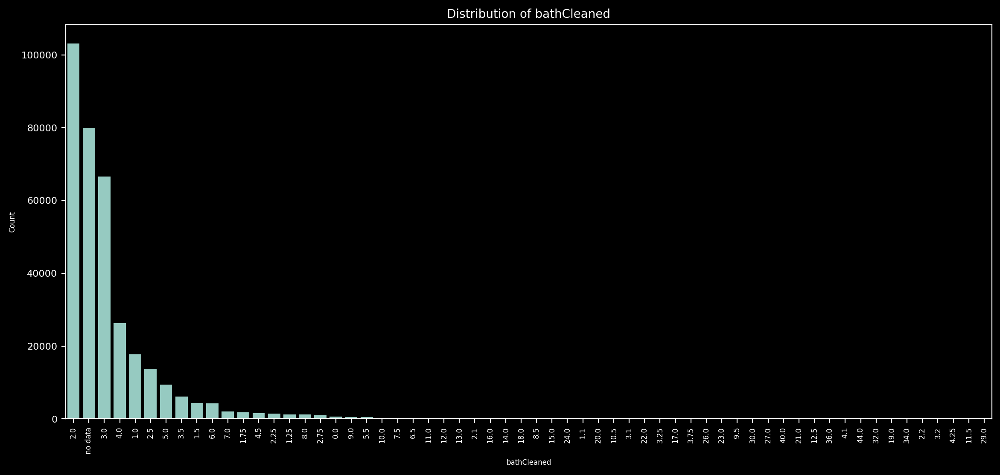

In [63]:
analyze_feature(df, 'bathCleaned')

Lets take first 16 groups, others will rename as 'Other'

In [64]:
def less_group_bath(group_name, index_list):
    if group_name not in index_list:
        return 'other'
    else:
        return group_name

index_list = df.bathCleaned.value_counts().head(16).index.tolist()
df.bathCleaned = df.bathCleaned.apply(lambda x: less_group_bath(x,index_list))

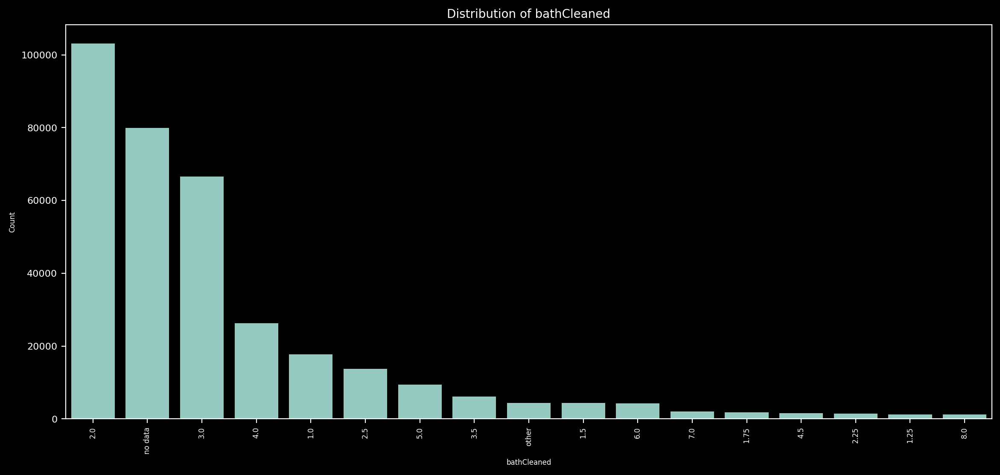

In [65]:
analyze_feature(df, 'bathCleaned')

In [66]:
df.drop(['baths'], axis=1, inplace=True)

<a id = '3.6'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.6 Beds

</strong></p> 


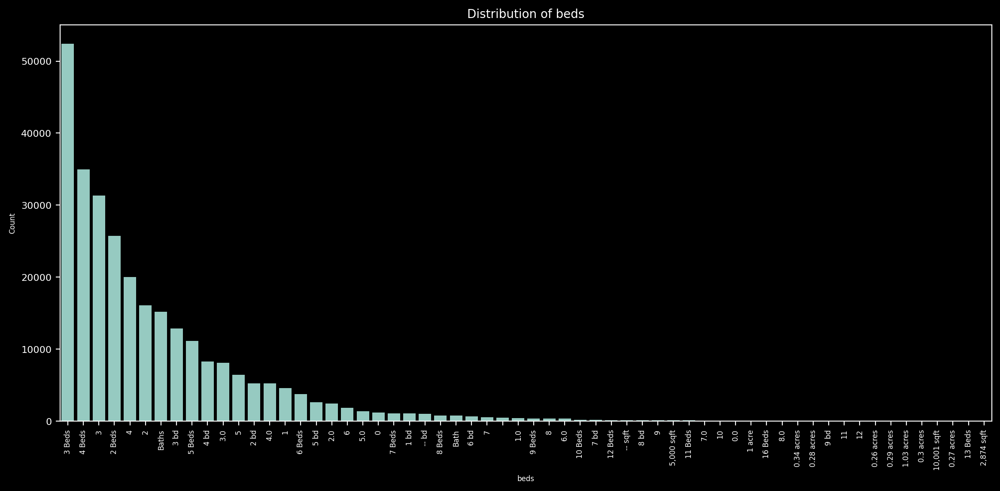

In [67]:
analyze_feature(df, 'beds')

There is a lot of junk in this field. However, I see that the top values are still dominant and can be identified. Let's try to convert them into a readable format.

In [68]:
# fill Nan Values with 'no data'
df['beds'] = df['beds'].fillna('no data')

Make a steps similar with feature baths

In [69]:
# Clean data
def clean_beds_data(beds):
    # Groups and their patterns
    patterns = {
        'no data': [
            r'.*acre', r'.*sqft', r'Bath',r'.*--',r'^\s*$',r'Based on Redfin\'s Raleigh data, we estimate the home\'s value is \$708,248, which is 1.2\% more than its current list price.',
            r'Based on Redfin\'s St Johns data, we estimate the home\'s value is \$360,731, which is 2.2\% less than its current list price.',
        ],
        '0':[r'0.0'],
        '1':[r'1-2 Beds'],
        '2':[r'1 Bath, 2 Bedrooms, Cable TV Available, Dining Room, Eat-In Kitchen, Living Room',
             r'1 Bath, 2 Bedrooms, Eat-In Kitchen, Living Room, Range/Oven, Refrigerator',
             r'1 Bath, 2 Bedrooms, Living Room, Range/Oven, Refrigerator',
             r'1 Bath, 2 Bedrooms'],
        '3':[r'1 Bath, 3 or More Bedrooms, Cable TV Available, Dining Room, Eat-In Kitchen, Living Room, Range/Oven, Refrigerator',r'2 Baths, 3 or More Bedrooms',
             r'3 or More Bedrooms, Dining Room, Living Room, Range/Oven, Refrigerator',
             ]
    }

    for group, regex_patterns in patterns.items():
        for pattern in regex_patterns:
            if re.match(pattern, beds, re.IGNORECASE):
                return group

    return beds


def clean_beds_data_remove_words(beds):
    if beds == 'no data':
        return beds
    else:
        return float(re.sub(r'[^\d.,]', '', beds.replace(',','.')))

In [70]:
# Applying the mapping to the DataFrame
df['bedsCleaned'] = df['beds'].apply(clean_beds_data)
df['bedsCleaned'] = df['bedsCleaned'].apply(clean_beds_data_remove_words)

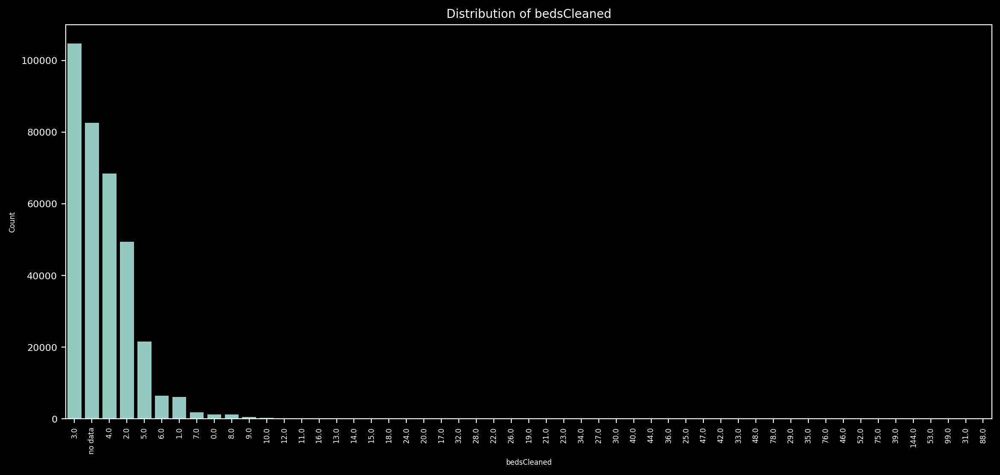

In [71]:
analyze_feature(df,'bedsCleaned')

Lets take first 10 groups, others will rename as 'Other'

In [72]:
def less_group_beds(group_name, index_list):
    if group_name not in index_list:
        return 'other'
    else:
        return group_name

index_list = df.bedsCleaned.value_counts().head(10).index.tolist()
df.bedsCleaned = df.bedsCleaned.apply(lambda x: less_group_beds(x,index_list))

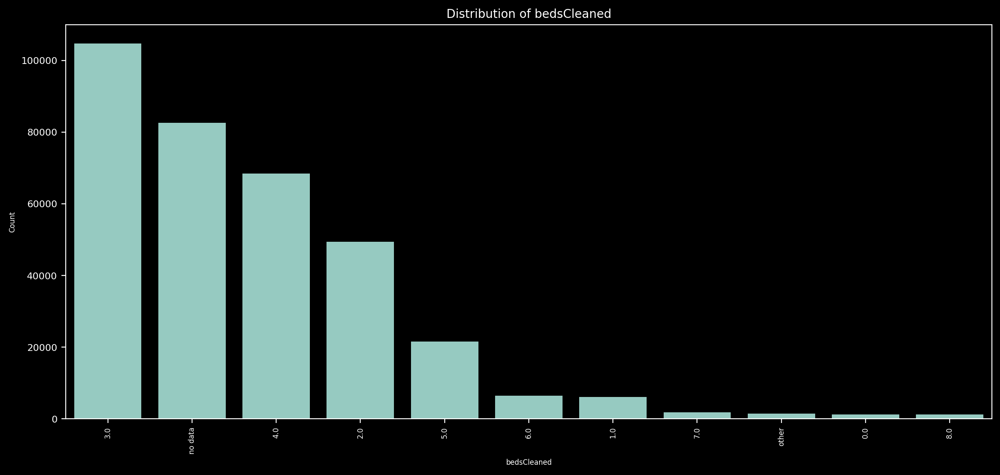

In [73]:
analyze_feature(df,'bedsCleaned')

In [74]:
# Remove old feature
df.drop(['beds'], axis=1, inplace=True)

<a id = '3.7'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.7 HomeFacts

</strong></p> 


In [75]:
# have a look to homeFacts value
df.homeFacts[0]

"{'atAGlanceFacts': [{'factValue': '2019', 'factLabel': 'Year built'}, {'factValue': '', 'factLabel': 'Remodeled year'}, {'factValue': 'Central A/C, Heat Pump', 'factLabel': 'Heating'}, {'factValue': '', 'factLabel': 'Cooling'}, {'factValue': '', 'factLabel': 'Parking'}, {'factValue': None, 'factLabel': 'lotsize'}, {'factValue': '$144', 'factLabel': 'Price/sqft'}]}"

How we can see this value stores encoded in string dictionary with property description

In [76]:
# lets decode it
df.homeFacts = df.homeFacts.apply(eval)

Have look to data structure for few records

In [77]:
df.homeFacts[10]['atAGlanceFacts']

[{'factValue': '2015', 'factLabel': 'Year built'},
 {'factValue': '2015', 'factLabel': 'Remodeled year'},
 {'factValue': 'Central Electric', 'factLabel': 'Heating'},
 {'factValue': 'Central Gas', 'factLabel': 'Cooling'},
 {'factValue': '', 'factLabel': 'Parking'},
 {'factValue': '5,715 Sq. Ft.', 'factLabel': 'lotsize'},
 {'factValue': '$83 / Sq. Ft.', 'factLabel': 'Price/sqft'}]

In [78]:
df.homeFacts[1000]['atAGlanceFacts']


[{'factValue': '1973', 'factLabel': 'Year built'},
 {'factValue': '', 'factLabel': 'Remodeled year'},
 {'factValue': 'Electric Heat', 'factLabel': 'Heating'},
 {'factValue': 'Refrigeration', 'factLabel': 'Cooling'},
 {'factValue': 'Electric Door Opener, Dir Entry frm Garage, Slab Parking Spaces',
  'factLabel': 'Parking'},
 {'factValue': '6564', 'factLabel': 'lotsize'},
 {'factValue': '$154', 'factLabel': 'Price/sqft'}]

In [79]:
df.homeFacts[10000]['atAGlanceFacts']

[{'factValue': '', 'factLabel': 'Year built'},
 {'factValue': '', 'factLabel': 'Remodeled year'},
 {'factValue': '', 'factLabel': 'Heating'},
 {'factValue': '', 'factLabel': 'Cooling'},
 {'factValue': '', 'factLabel': 'Parking'},
 {'factValue': None, 'factLabel': 'lotsize'},
 {'factValue': '$167', 'factLabel': 'Price/sqft'}]

<a id = '3.71'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.71 Year Built

</strong></p> 

Looks that we have fixed structure, where 0 index always Year built, 1 is a Remodeled Year and etc. In this case, using this we can create a new features. Will start with Year of Built

In [80]:
df['year_built'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][0]['factValue'])

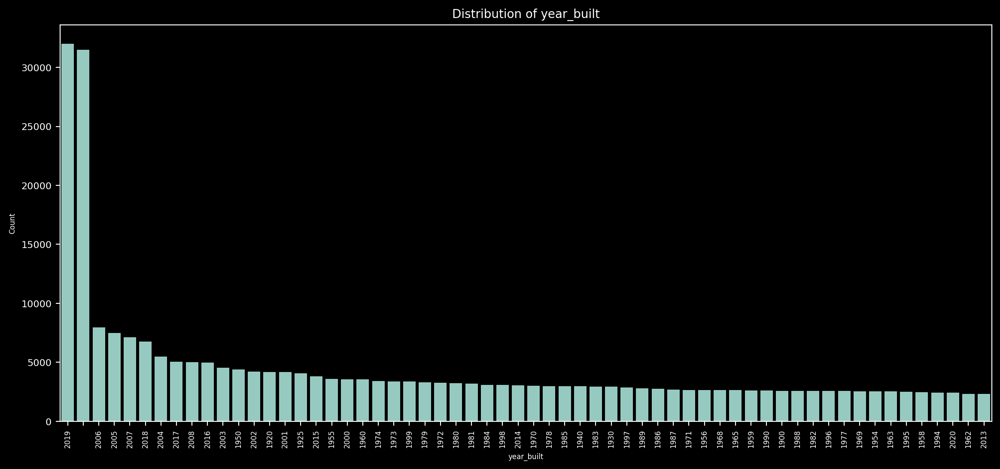

In [81]:
analyze_feature(df,'year_built')

In [82]:
print(format(df.year_built.unique()))

['2019' '1961' '2006' '1920' '1976' '1970' '1965' '2015' '1996' '1982'
 '1905' '2008' '1899' '2016' '1954' '1989' '2014' '1915' '' '1994' '1910'
 '1923' '1960' '1977' '1972' '1963' '1981' '1949' '1930' '1991' '1958'
 '2005' '2017' '2018' '1983' '1928' '1998' '1997' '1964' '1940' '1973'
 '1968' '1999' '1918' '2007' '1984' '1946' '2003' '2000' '2004' '1969'
 '2002' '1952' '1974' '1947' '1957' '1978' '1956' '1967' '1975' '1988'
 '1955' '1950' '1959' '2012' '1924' '1966' '1992' '2001' '1995' '1985'
 '2010' '1971' '1909' '1953' '1993' '1990' '1980' '1951' '1907' '1885'
 '1941' '1927' '1929' '1901' None '1922' '1906' '1945' '1979' '2009'
 '1962' '1913' '2011' '1897' '1987' '2020' '1926' '1939' '1925' '2013'
 '1986' 'No Data' '1943' '1935' '1890' '1900' '1895' '1911' '1948' '1942'
 '1916' '1931' '1944' '1893' '1879' '1914' '1937' '1912' '1938' '1921'
 '1860' '1850' '1936' '1861' '1880' '1908' '1865' '1917' '1898' '1740'
 '1934' '1902' '1904' '1932' '1896' '1892' '1830' '1919' '1933' '1875'
 '

In [83]:
# Check a strange built year
df[df.year_built == '559990649990'].index

Index([71208, 323949], dtype='int64')

In [84]:
df.iloc[71207].homeFacts

{'atAGlanceFacts': [{'factValue': '559990649990', 'factLabel': 'Year built'},
  {'factValue': '', 'factLabel': 'Remodeled year'},
  {'factValue': '', 'factLabel': 'Heating'},
  {'factValue': '', 'factLabel': 'Cooling'},
  {'factValue': '', 'factLabel': 'Parking'},
  {'factValue': None, 'factLabel': 'lotsize'},
  {'factValue': '$437', 'factLabel': 'Price/sqft'}]}

In [85]:
df.iloc[323948].homeFacts

{'atAGlanceFacts': [{'factValue': '559990649990', 'factLabel': 'Year built'},
  {'factValue': '', 'factLabel': 'Remodeled year'},
  {'factValue': '', 'factLabel': 'Heating'},
  {'factValue': '', 'factLabel': 'Cooling'},
  {'factValue': '', 'factLabel': 'Parking'},
  {'factValue': None, 'factLabel': 'lotsize'},
  {'factValue': '$454', 'factLabel': 'Price/sqft'}]}

These records doesn't have any valuable description. Such we have only 2 such records, Can easy to delete it

In [86]:
df = df.drop(df[(df.year_built == '559990649990')].index)
df.reset_index(inplace = True, drop = True)

Also we have records with NaN, Empty string and 'No Data' records. Need to join it to one value

In [87]:
df.year_built = df.year_built.apply(lambda x: None if (x == '') | (x == 'No Data') else x)

In [88]:
print(format(df.year_built.unique()))

['2019' '1961' '2006' '1920' '1976' '1970' '1965' '2015' '1996' '1982'
 '1905' '2008' '1899' '2016' '1954' '1989' '2014' '1915' None '1994'
 '1910' '1923' '1960' '1977' '1972' '1963' '1981' '1949' '1930' '1991'
 '1958' '2005' '2017' '2018' '1983' '1928' '1998' '1997' '1964' '1940'
 '1973' '1968' '1999' '1918' '2007' '1984' '1946' '2003' '2000' '2004'
 '1969' '2002' '1952' '1974' '1947' '1957' '1978' '1956' '1967' '1975'
 '1988' '1955' '1950' '1959' '2012' '1924' '1966' '1992' '2001' '1995'
 '1985' '2010' '1971' '1909' '1953' '1993' '1990' '1980' '1951' '1907'
 '1885' '1941' '1927' '1929' '1901' '1922' '1906' '1945' '1979' '2009'
 '1962' '1913' '2011' '1897' '1987' '2020' '1926' '1939' '1925' '2013'
 '1986' '1943' '1935' '1890' '1900' '1895' '1911' '1948' '1942' '1916'
 '1931' '1944' '1893' '1879' '1914' '1937' '1912' '1938' '1921' '1860'
 '1850' '1936' '1861' '1880' '1908' '1865' '1917' '1898' '1740' '1934'
 '1902' '1904' '1932' '1896' '1892' '1830' '1919' '1933' '1875' '1888'
 '1889' 

How i can see this DB stores Data regardind USA area. We can to guess that year built cant be less than 1800.
Also, Actually we have 2024 year. I think Dataset was created one year before at least. In this case additionally will check all records which is more than 2023

In [89]:
df[(df.year_built<'1800') | (df.year_built>'2023')]

,homeFacts,fireplace,city,schools,sqft,zipcode,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned,bedsCleaned,year_built
1908,"{'atAGlanceFacts': [{'factValue': '1740', 'fac...",NaN,Barnstable,"[{'rating': ['NA', '4/10', '5/10'], 'data': {'...","Total interior livable area: 7,366 sqft",2630,MA,1.0,21904260,NaN,"$1,425,000",For Sale,Yes,Single-Family Home,other,other,1740
21223,"{'atAGlanceFacts': [{'factValue': '1799', 'fac...",NaN,Laredo,"[{'rating': [], 'data': {'Distance': [], 'Grad...","2,348 sqft",78040,TX,1.0,NaN,NaN,"$89,714",Closed,No,Single-Family Home,2.0,3.0,1799
46396,"{'atAGlanceFacts': [{'factValue': '1794', 'fac...",NaN,Washington,"[{'rating': ['8', '8', '8', '8', '9', '9', 'NR...",2145,20007,DC,3+,NaN,DCDC445998,"$1,695,000",Active,No,Condominium/Apartment,3.0,2.0,1794
49669,"{'atAGlanceFacts': [{'factValue': '1795', 'fac...",NaN,Vergennes,"[{'rating': ['6', '5', '9', 'NR'], 'data': {'D...",3867,05491,VT,2,NaN,4745585,"$568,000",Active,No,Single-Family Home,3.5,3.0,1795
74437,"{'atAGlanceFacts': [{'factValue': '1796', 'fac...",Yes,Philadelphia,"[{'rating': ['7/10', '1/10'], 'data': {'Distan...","4,900 sqft",19106,PA,NaN,NaN,PAPH812888,"$2,095,000",For Sale,No,Townhouse,6.0,4.0,1796
82992,"{'atAGlanceFacts': [{'factValue': '1795', 'fac...",# Fireplaces - Woodburning,Little Falls,"[{'rating': ['4', '3', '4', 'NR'], 'data': {'D...",2378,13365,NY,2.0000,NaN,S1217473,"$149,900",Pending,No,Single-Family Home,2.0,4.0,1795
118917,"{'atAGlanceFacts': [{'factValue': '1780', 'fac...",NaN,Washington,"[{'rating': ['8', '8', '9'], 'data': {'Distanc...","1,755",20007,DC,NaN,NaN,DCDC448420,NaN,Closed,No,Other/Various Styles,no data,no data,1780
137130,"{'atAGlanceFacts': [{'factValue': '1208', 'fac...",NaN,Logan,"[{'rating': ['9', '6', '4', '6', 'NR', 'NR'], ...",1208,43138,OH,NaN,NaN,9922581,"$79,000",Pending,No,Single-Family Home,2.0,3.0,1208
150159,"{'atAGlanceFacts': [{'factValue': '2025', 'fac...",1,Raleigh,"[{'rating': ['5', '4', '3'], 'data': {'Distanc...","3,518",27603,NC,NaN,NaN,2226990,"534,000",Active,No,Traditional,no data,no data,2025
154022,"{'atAGlanceFacts': [{'factValue': '1750', 'fac...",Yes,Barnstable,"[{'rating': ['NA', '4/10', '5/10'], 'data': {'...","Total interior livable area: 2,948 sqft",2630,MA,2.0,72360494,NaN,"$519,900",For Sale,No,Single-Family Home,4.0,4.0,1750


Its not a huge volume of records. I think we can easy to drop it


In [90]:
df = df.drop(df[(df.year_built<'1800') | (df.year_built>'2023')].index)
df.reset_index(inplace = True, drop = True)

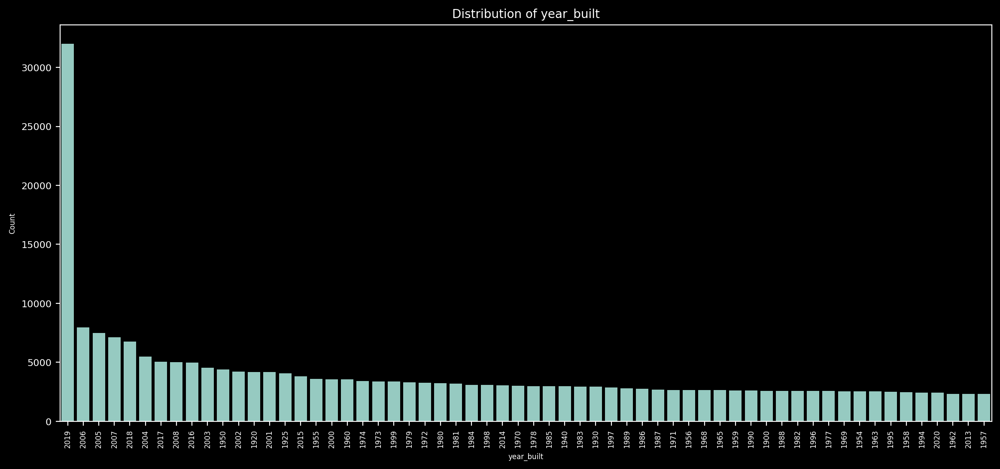

In [91]:
analyze_feature(df,'year_built')

We have ar 10% empty values. Need to fill it with some data. Simple way to fill it with median data.

In [92]:
median_year = df[df.year_built.notna()].year_built.apply(float).median()
median_year

1985.0

In [93]:
df.year_built = df.year_built.fillna('1985')

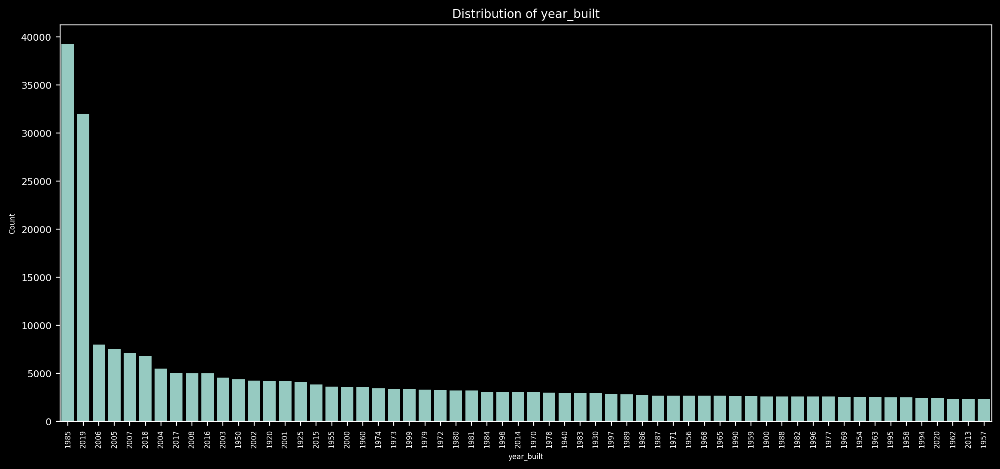

In [94]:
analyze_feature(df,'year_built')

<a id = '3.72'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.72 Remodeled Year

</strong></p> 

Lets do similar steps with remodeled_year and create a feature


In [95]:
df['remodeled_year'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][1]['factValue'])

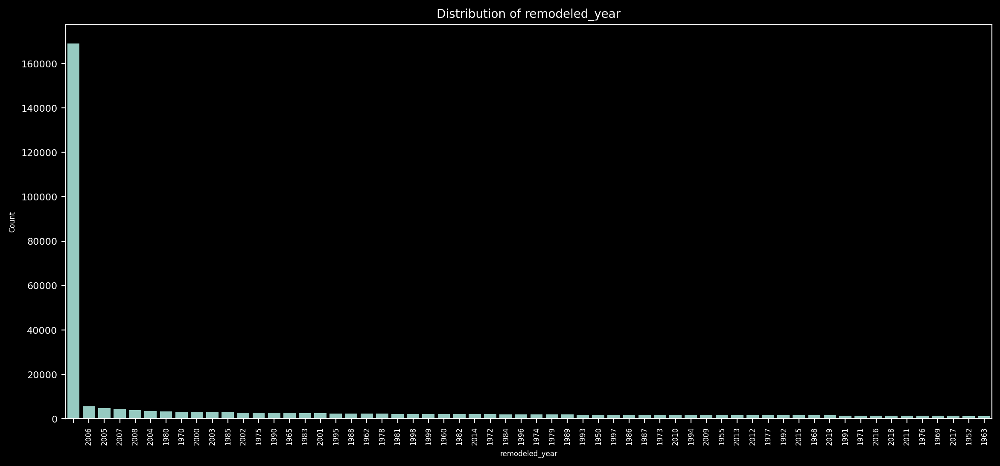

In [96]:
analyze_feature(df,'remodeled_year')

Half of records doesn't have any value. I think that its mean that reconstructions jobs wasn't made. In this case lets encode this feature with 2 possible values - no(wasn't) and yes(was made)

In [97]:
print(format(df.remodeled_year.unique()))

['' '1967' '2006' None '2015' '1997' '2019' '1982' '1905' '2009' '2007'
 '1996' '1995' '1988' '1972' '1949' '1954' '1930' '2003' '2000' '1994'
 '2005' '1983' '1965' '1968' '1993' '1999' '2014' '2008' '2010' '2004'
 '2002' '1984' '1952' '1978' '1975' '1947' '1957' '1950' '2012' '1970'
 '2016' '1989' '1998' '1980' '1986' '1973' '1955' '1991' '2011' '2017'
 '1941' '2001' '1990' '1979' '1901' '1918' '1977' '1962' '1956' '2013'
 '1960' '1981' '1969' '1987' '1958' '1910' '1925' '1964' '1966' '1992'
 '1943' '1961' '1948' '1931' '1976' '1974' '1935' '1940' '1971' '2018'
 '1916' '1914' '1963' '1985' '1951' '1944' '1942' '1959' '1927' '1946'
 '1945' '1920' '1938' '1936' '0' '1939' '1915' '1928' '1923' '1929' '1898'
 '1899' '1934' '1953' '1926' '1937' '1912' '1917' '1906' '1932' '1919'
 '1921' '1924' '1907' '1911' '1900' '1889' '1913' '1895' '1908' '1903'
 '1904' '1933' '1894' '1892' '1922' '1909' '1880' '1902' '1877' '2020'
 '1893' '1890' '1891' '2021' '1869' '1884' '1897' '1886' '1883' '1845'
 

In [98]:
df.remodeled_year = df.remodeled_year.apply(lambda x: 'no' if pd.isnull(x) or x in ['', 0] else 'yes')


In [99]:
print(format(df.remodeled_year.unique()))

['no' 'yes']


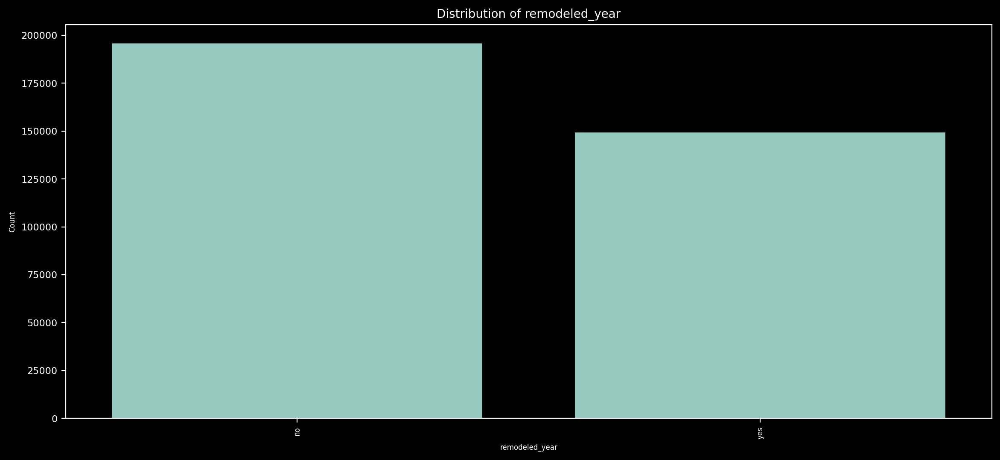

In [100]:
analyze_feature(df,'remodeled_year')

<a id = '3.73'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.73 heating information

</strong></p> 

The next parameter is Heating information.
Will retrieve it

In [101]:
df['heating_info'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][2]['factValue'])

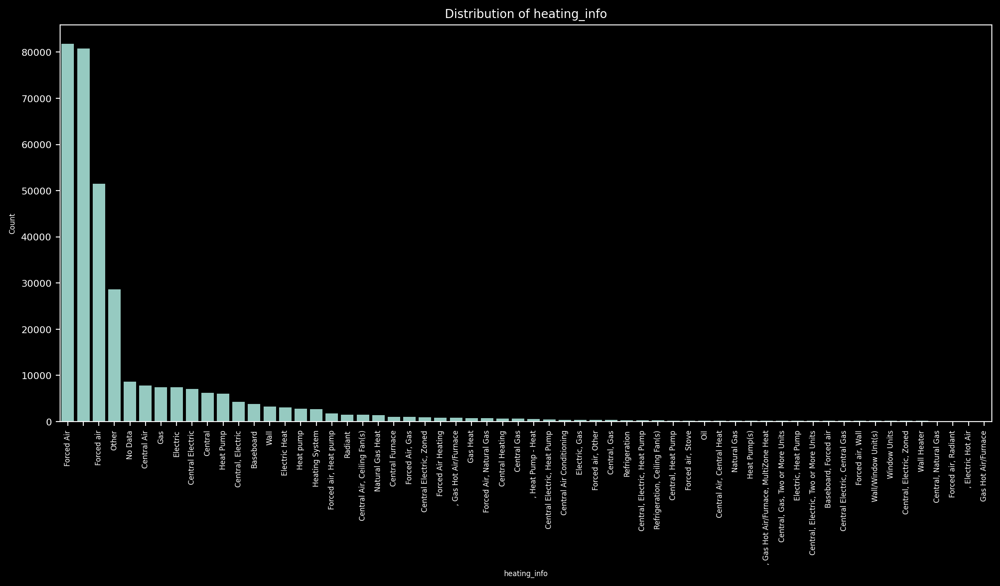

In [102]:
analyze_feature(df, 'heating_info')

80742 records hasn't data, will fill it with "no data"

In [103]:
df.heating_info = df.heating_info.fillna('no data')
df.heating_info = df.heating_info.apply(lambda x: 'no data' if x == '' else x)


I think it makes sense to divide heating systems into major groups, such as forced air, gas, heat pump, central, and electric, as the cost of these resources can differ significantly.

In [104]:
# Clean data
def clean_heater_data(heater):
    # Groups and their patterns
    patterns = {
        'gas': [
            r'.*\bgas.*\b',
        ],
        'air': [
            r'.*\bair.*\b',
        ],
        'pump': [
            r'.*\bpump.*\b',
        ],
        'central': [
            r'.*\bcentral.*\b',
        ],
        'no data': [
            r'.*\bno data.*\b',
        ],
        'electric': [
            r'.*\belectric.*\b',
        ]

    }

    for group, regex_patterns in patterns.items():
        for pattern in regex_patterns:
            if re.match(pattern, heater, re.IGNORECASE):
                return group

    return 'other'


In [105]:
# Applying the mapping to the DataFrame
df['heating_info_cleaned'] = df['heating_info'].apply(clean_heater_data)


In [106]:
print(format(df.heating_info_cleaned.value_counts().head(40)))

heating_info_cleaned
air         148558
no data      92886
other        43627
central      21330
gas          16421
pump         11115
electric     11106
Name: count, dtype: int64


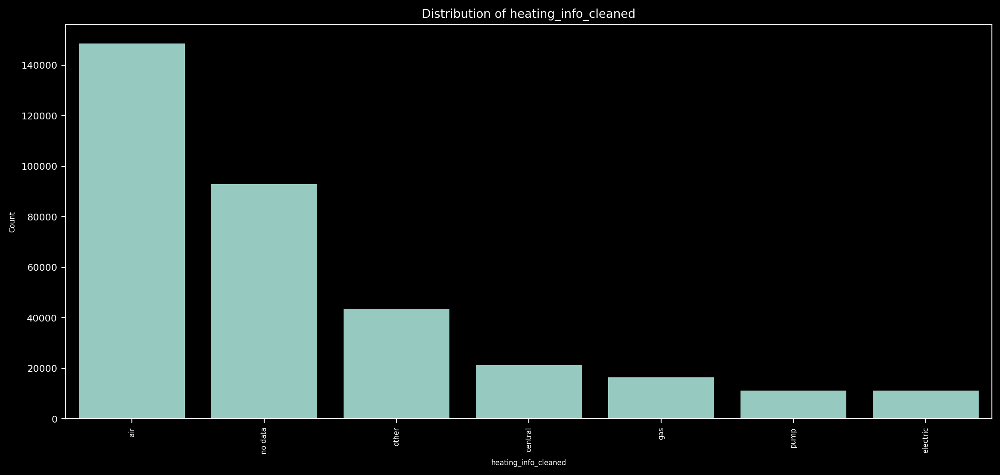

In [107]:
analyze_feature(df,'heating_info_cleaned')

In [108]:
df.drop(['heating_info'], axis=1, inplace=True)

<a id = '3.74'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.74 Cooling Information

</strong></p> 

The next parameter is Cooling information.
Will retrieve it

In [109]:
df['cooling_info'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][3]['factValue'])

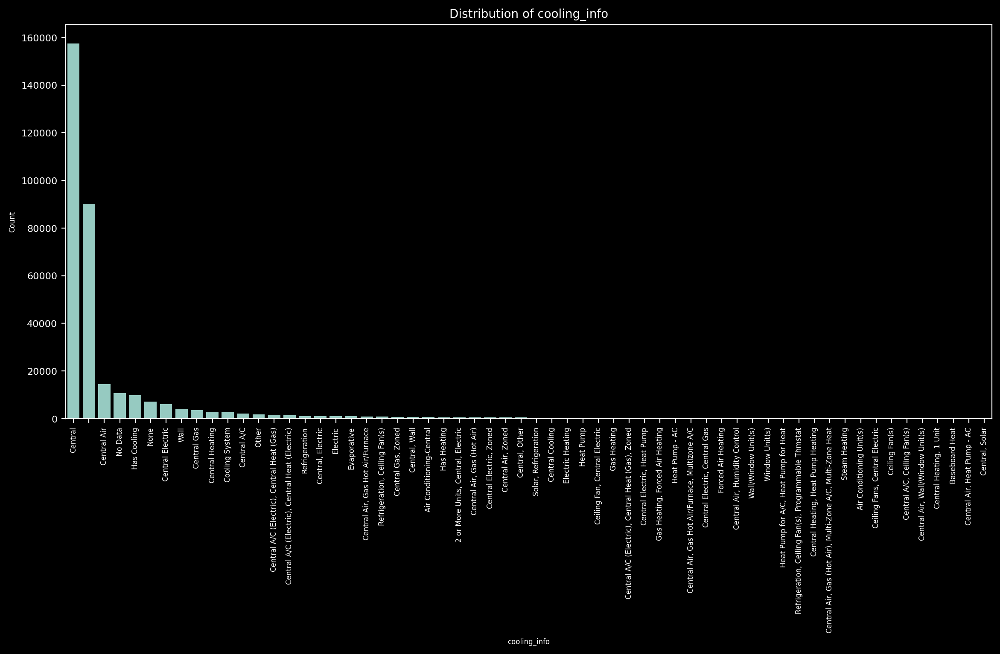

In [110]:
analyze_feature(df, 'cooling_info')

We have records with NaN values and empty strings. Will replace values with 'no data'

In [111]:
df.cooling_info = df.cooling_info.fillna('no data')
df.cooling_info = df.cooling_info.apply(lambda x: 'no data' if x == '' else x)

I think it makes sense to divide heating systems into major groups, such as air, gas, central, as the cost of these resources can differ significantly.

In [112]:
# Clean data
def clean_cooling_data(cooling):
    # Groups and their patterns
    patterns = {
        'gas': [
            r'.*\bgas.*\b',
        ],
        'air': [
            r'.*\bair.*\b',
        ],
        'central': [
            r'.*\bcentral.*\b',
        ],
        'no data': [
            r'.*\bno data.*\b',
        ],
    }

    for group, regex_patterns in patterns.items():
        for pattern in regex_patterns:
            if re.match(pattern, cooling, re.IGNORECASE):
                return group

    return 'other'


In [113]:
# Applying the mapping to the DataFrame
df['cooling_info_cleaned'] = df['cooling_info'].apply(clean_cooling_data)

In [114]:
print(format(df.cooling_info_cleaned.value_counts().head(40)))

cooling_info_cleaned
central    176681
no data    104373
other       35781
air         17790
gas         10418
Name: count, dtype: int64


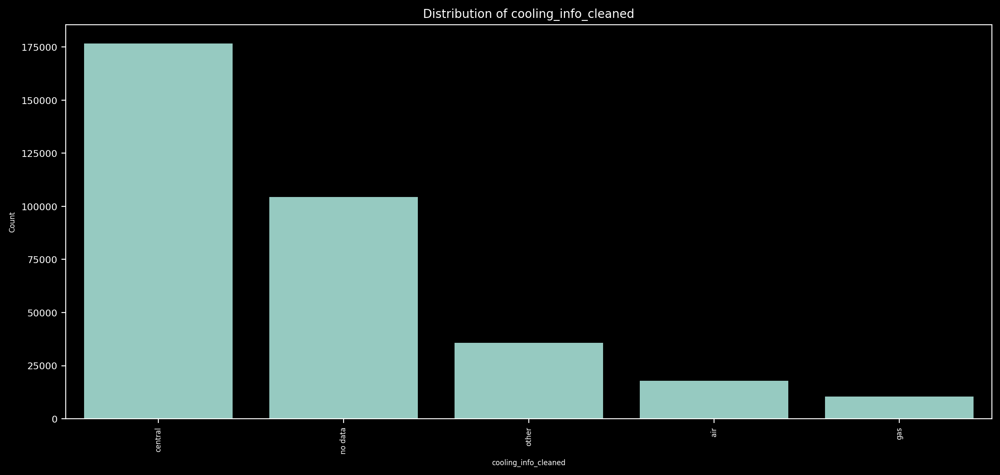

In [115]:
analyze_feature(df,'cooling_info_cleaned')

In [116]:
df.drop(['cooling_info'], axis=1, inplace=True)

<a id = '3.75'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.75 Parking Information

</strong></p> 

The next parameter is Parking information.
Will retrieve it

In [117]:
df['parking_info'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][4]['factValue'])

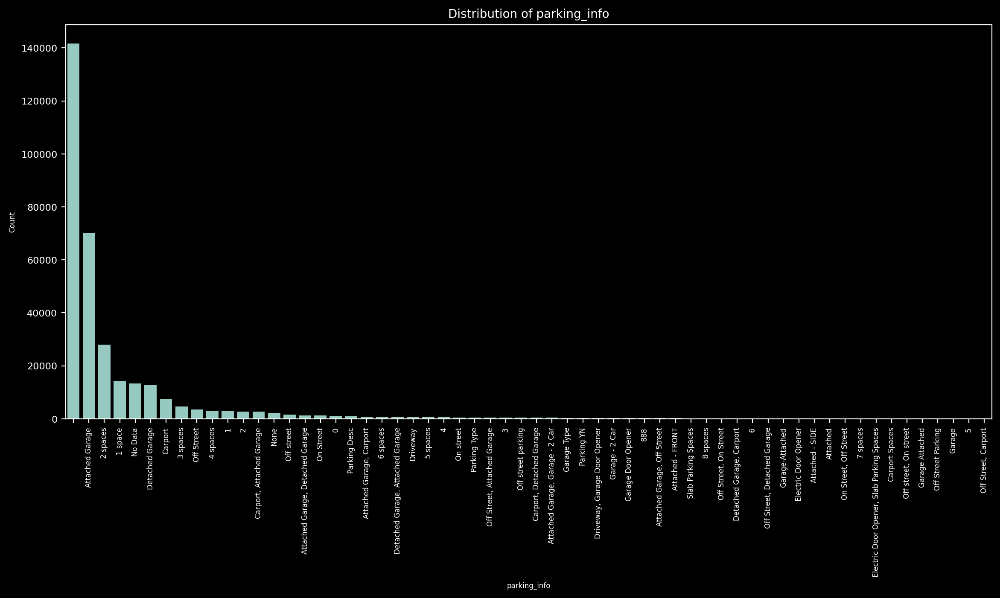

In [118]:
analyze_feature(df,'parking_info')

In [119]:
print(format(df.parking_info.value_counts().head(40)))

parking_info
                                    141682
Attached Garage                      70120
2 spaces                             28061
1 space                              14252
No Data                              13333
Detached Garage                      12924
Carport                               7568
3 spaces                              4724
Off Street                            3586
4 spaces                              2916
1                                     2906
2                                     2727
Carport, Attached Garage              2700
None                                  2323
Off street                            1657
Attached Garage, Detached Garage      1304
On Street                             1230
0                                     1114
Parking Desc                           880
Attached Garage, Carport               859
6 spaces                               755
Detached Garage, Attached Garage       705
Driveway                               69

We have NaN values, '' and 'None'. Looks all these values means that parking is absent

In [120]:
df.parking_info = df.parking_info.fillna('0')
df.parking_info = df.parking_info.apply(lambda x: '0' if x == '' else x)

Based on data evaluation will make some data clearance.
I see that we have main type of parking like garage, parking on streets, number of parking places.


In [121]:
# Clean data
def clean_parking_data(parking):
    # Groups and their patterns
    patterns = {
        'garage': [
            r'.*\bgarage.*\b',
        ],
        '0': [
            r'.*\bnone.*\b',
        ],
        'other': [
            r'.*\b888.*\b',
        ],
        'street': [
            r'.*\bstreet.*\b',
        ],

    }

    for group, regex_patterns in patterns.items():
        for pattern in regex_patterns:
            if re.match(pattern, parking, re.IGNORECASE):
                return group

    return parking


def clean_parking_data_remove_words(parking):
    try:
        return str(int(re.sub(r'[^\d.,]', '', parking.replace(',','.'))))
    except:
        if parking in ['garage', 'other', 'street']:
            return parking
        else:
            return 'other'

In [122]:
# Applying the mapping to the DataFrame
df['parkingCleaned'] = df['parking_info'].apply(clean_parking_data)
df['parkingCleaned'] = df['parkingCleaned'].apply(clean_parking_data_remove_words)

In [123]:
print(format(df.parkingCleaned.value_counts().head(30)))

parkingCleaned
0         148686
garage     97919
2          30974
other      29313
1          17258
street      9237
3           5213
4           3555
6            953
5            793
8            288
7            188
10           139
9             90
12            76
14            44
20            43
11            32
16            22
15            16
18            14
510           13
13            12
30            12
50             7
100            7
40             7
22             7
25             6
21             6
Name: count, dtype: int64


I think that no reason to divide this feature for more than 5 features because it will big gap between TOP 2 and others. In this case will merge all segments after 5 to segment 'other'

In [124]:
def less_group_parking(group_name, index_list):
    if group_name not in index_list:
        return 'other'
    else:
        return group_name

index_list = df.parkingCleaned.value_counts().head(5).index.tolist()
df.parkingCleaned = df.parkingCleaned.apply(lambda x: less_group_parking(x,index_list))

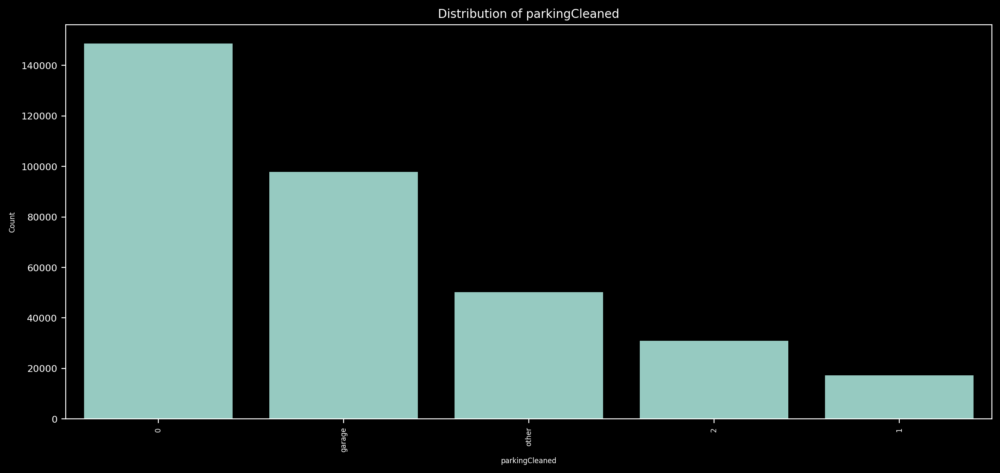

In [125]:
analyze_feature(df, 'parkingCleaned')

In [126]:
df.drop(['parking_info'], axis=1, inplace=True)

<a id = '3.76'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.76 Lot Size

</strong></p> 

The next parameter is LotSize information.
Will retrieve it

In [127]:
df['lotsize_info'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][5]['factValue'])

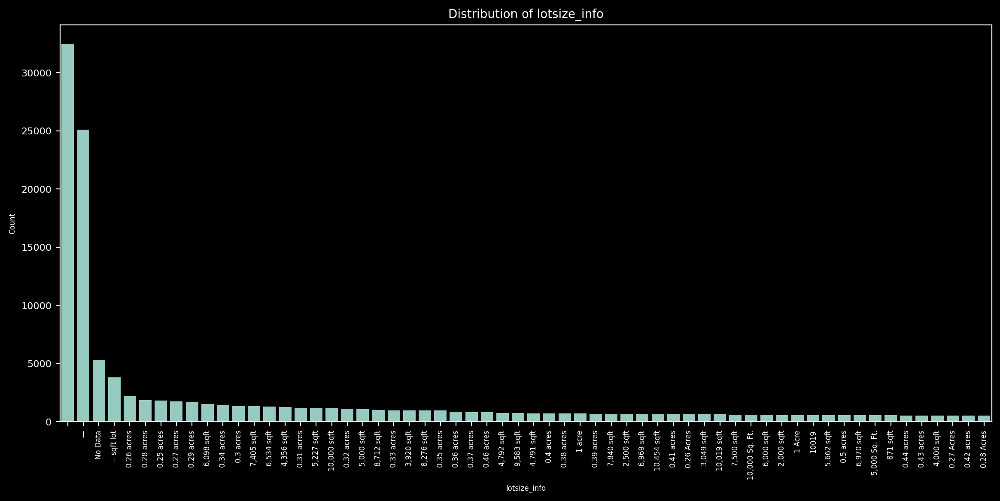

In [128]:
analyze_feature(df,'lotsize_info')

In [129]:
print(format(df.lotsize_info.value_counts().tail(30)))

lotsize_info
3,686 Sq. Ft.     1
10395             1
12969             1
5.8 acres lot     1
3652 sqft         1
3.80 Acres        1
31.33 Acres       1
9,158 Sq. Ft.     1
4817 sqft         1
4,170 Sq. Ft.     1
9,324 Sq. Ft.     1
23933             1
5880600           1
2,921 sqft        1
8,479 Sq. Ft.     1
7,179 Sq. Ft.     1
5,573 Sq. Ft.     1
11988             1
2,038 sqft lot    1
163786            1
10,492 Sq. Ft.    1
6956              1
13274             1
17404             1
5539 sqft         1
12903             1
7954              1
5,283 sqft lot    1
9983              1
7,084 sqft lot    1
Name: count, dtype: int64


I think that entries with values '-' and '' indicate the absence of a land plot, so we should replace them with 0. On the other hand, 'no data' likely indicates a lack of data, so after cleaning and converting to a single measurement unit (sqft), we will replace 'no data' with the median value. Also, if we have big values without measurement units, will decide that its a sqft.

In [130]:
df.lotsize_info = df.lotsize_info.fillna('0')

In [131]:
def clean_and_convert_to_sqft(value):
    # Check for the presence of '--'
    if '--' in str(value) or '-' in str(value) or '—' in str(value) or str(value).strip() == '': 
        return '0'
    
    # Check for 'No Data' case-insensitively
    if isinstance(value, str) and value.strip().lower() in ['no data', 'none']:
        return 'no data'
    
   
    try:
        
        # Check for units (acres, acr, acre) and convert to square feet if found
        if any(unit in str(value).lower() for unit in ['acre', 'acres', 'acr']):

            # Remove all characters except digits and the decimal point
            cleaned_value = re.sub(r'[^\d.]', '', str(value).replace(',', ''))
            # Attempt to convert the cleaned value to a float
            numeric_value = float(cleaned_value)
            return str(numeric_value * 43560)

        elif any(unit in str(value).lower() for unit in ['sq', 'ft']):

            # Remove all characters except digits and the decimal point
            cleaned_value = re.sub(r'[^\d]', '', str(value).replace(',', ''))
            # Attempt to convert the cleaned value to a float
            numeric_value = float(cleaned_value)
            return str(numeric_value)
        else:
            cleaned_value = re.sub(r'[^\d]', '', str(value).replace(',', ''))
            return str(cleaned_value)
    except ValueError:
        
        # Return 0 if the value is not convertible to a number
        return '0'


In [132]:
df['lotsize_info_cleaned'] = df.lotsize_info.apply(clean_and_convert_to_sqft)

In [133]:
print(format(df.lotsize_info_cleaned.value_counts().head(30)))

lotsize_info_cleaned
0                     89624
no data                5330
11325.6                3089
12196.800000000001     2591
11761.2                2507
10890.0                2476
12632.4                2291
6098.0                 2232
13068.0                2078
7405.0                 2072
14810.400000000001     1923
5000.0                 1907
6534.0                 1816
10000.0                1760
13503.6                1703
4356.0                 1700
5227.0                 1664
43560.0                1584
13939.2                1539
8712.0                 1502
8276.0                 1459
14374.800000000001     1415
15245.999999999998     1325
3920.0                 1256
4791.0                 1207
15681.599999999999     1193
9583.0                 1165
20037.600000000002     1164
16117.199999999999     1139
6969.0                 1132
Name: count, dtype: int64


Will fill no data records with median value


In [134]:
median_lotsize = df[df.lotsize_info_cleaned != 'no data'].lotsize_info_cleaned.apply(float).median()
median_lotsize

5967.0

In [135]:
df.lotsize_info_cleaned = df.lotsize_info_cleaned.replace('no data', str(median_lotsize))

In [136]:
df.lotsize_info_cleaned = df.lotsize_info_cleaned.astype(float).astype(int)

In [137]:
df.drop(['lotsize_info'], axis=1, inplace=True)

In [138]:
df.lotsize_info_cleaned.describe()

count    3.450430e+05
mean     6.686822e+04
std      5.439365e+06
min      0.000000e+00
25%      0.000000e+00
50%      5.967000e+03
75%      1.001900e+04
max      2.147484e+09
Name: lotsize_info_cleaned, dtype: float64

<a id = '3.77'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.77 Price per sqrt

</strong></p> 

The next parameter is Price per Sqrt.
Will retrieve it

In [139]:
df['lotprice_info'] = df['homeFacts'].apply(lambda x: x['atAGlanceFacts'][6]['factValue'])

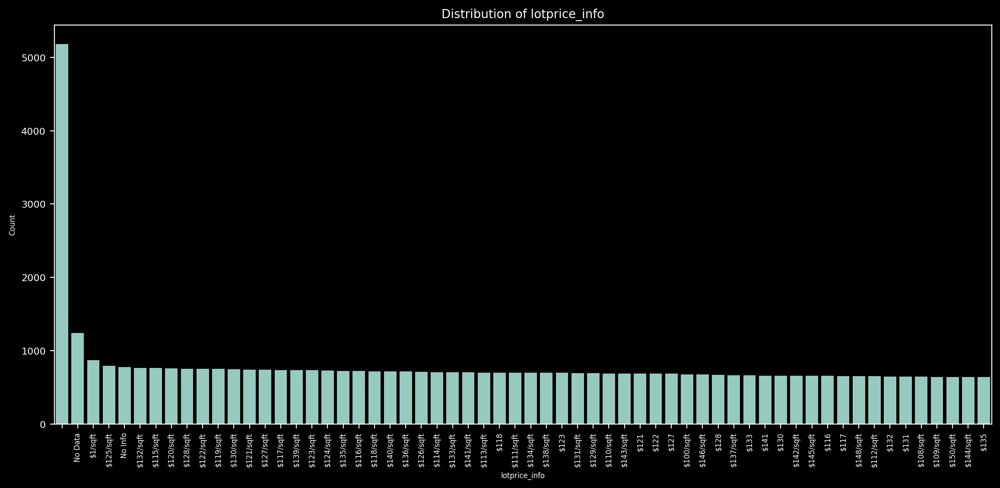

In [140]:
analyze_feature(df,'lotprice_info')

I believe this feature directly depends on the target feature 'target'. Therefore, I am removing it to prevent data leakage. Data leakage can occur when the model is trained with information it wouldn't have in a real-world scenario, leading to overly optimistic performance during training but poor generalization to new data.

Features highly correlated with the target variable can cause the model to overfit, capturing patterns specific to the training data that don't generalize well. By removing 'lotsize_info_cleaned', we ensure the model's performance reflects its true ability to handle unseen data.



In [141]:
df.drop('lotprice_info', axis = 1, inplace = True)
df.drop('homeFacts', axis = 1, inplace = True)


<a id = '3.8'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.8 Fireplace

</strong></p> 

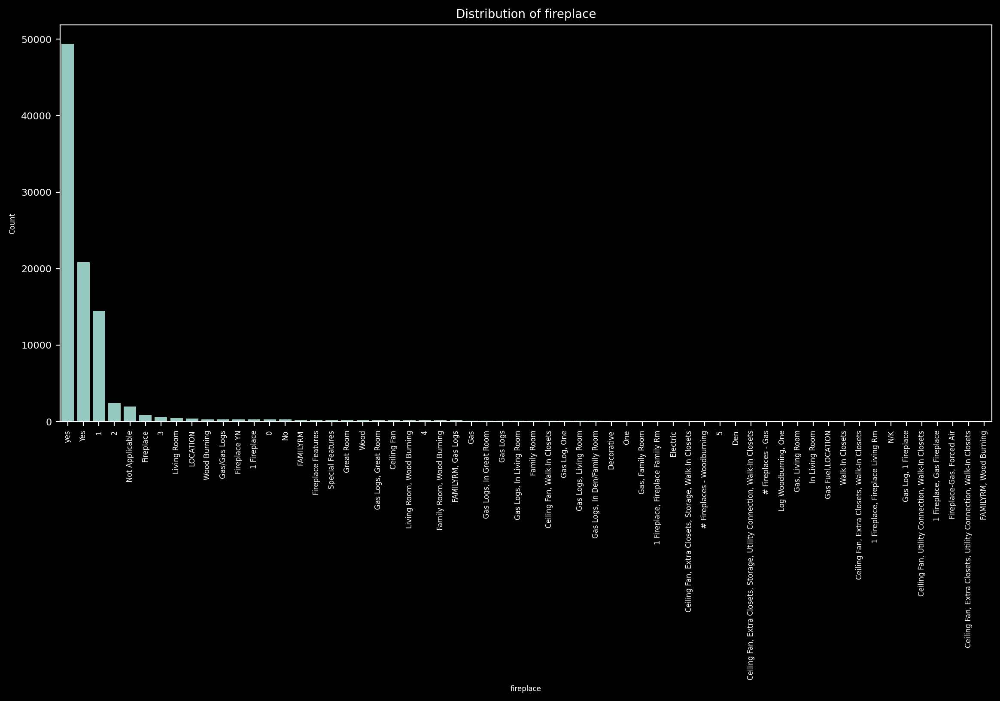

In [142]:
analyze_feature(df,'fireplace')

In [143]:
print(format(df.fireplace.value_counts().head(30)))

fireplace
yes                          49390
Yes                          20851
1                            14488
2                             2419
Not Applicable                1993
Fireplace                      847
3                              563
Living Room                    433
LOCATION                       399
Wood Burning                   309
Gas/Gas Logs                   300
Fireplace YN                   287
1 Fireplace                    274
0                              271
No                             265
FAMILYRM                       246
Fireplace Features             237
Special Features               218
Great Room                     207
Wood                           206
Gas Logs, Great Room           188
Ceiling Fan                    186
Living Room, Wood Burning      185
4                              184
Family Room, Wood Burning      149
FAMILYRM, Gas Logs             146
Gas                            133
Gas Logs, In Great Room        112
Gas Logs  

I don't think it makes sense to create a separate group for one or more fireplaces or the location. I understand that if the value is NaN, it means there is no fireplace, as well as for "Not applicable", "No" and "No Fireplace". I will consider the remaining entries as indicating the presence of a fireplace.

In [144]:
df[df['fireplace'].str.contains('no', case=False, na=False)].fireplace.value_counts()

fireplace
Not Applicable                                                         1993
No                                                                      265
No Fireplace                                                             10
Gas, Family Room, Non Wood Burning                                        7
Gas, Living Room, Non Wood Burning                                        6
Gas, Non Wood Burning                                                     6
Electric, Living Room, Non Wood Burning                                   6
Gas, Other Room, Non Wood Burning                                         3
Decorative, Electric, Family Room, Non Wood Burning                       3
Decorative, Electric, Free Standing, Living Room, Non Wood Burning        2
Decorative, Electric, Free Standing, Family Room, Non Wood Burning        2
Electric, Non Wood Burning                                                2
Family Room Fireplace, No Fireplace                                       1
Pr

In [145]:
df.fireplace = df.fireplace.apply(lambda x: 'no' if pd.isna(x) else x)

In [146]:
change_values = ['Not Applicable', 'No Fireplace', 'No', '0']
df.fireplace = df.fireplace.apply(lambda x: 'no' if x in change_values else x)
df.fireplace = df.fireplace.apply(lambda x: 'yes' if x !='no' else x)

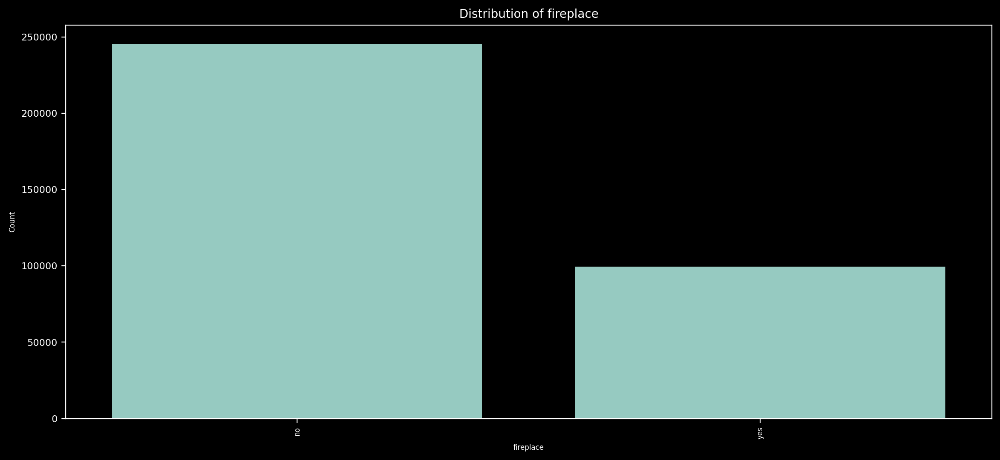

In [147]:
analyze_feature(df, 'fireplace')

<a id = '3.9'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.9 City

</strong></p> 

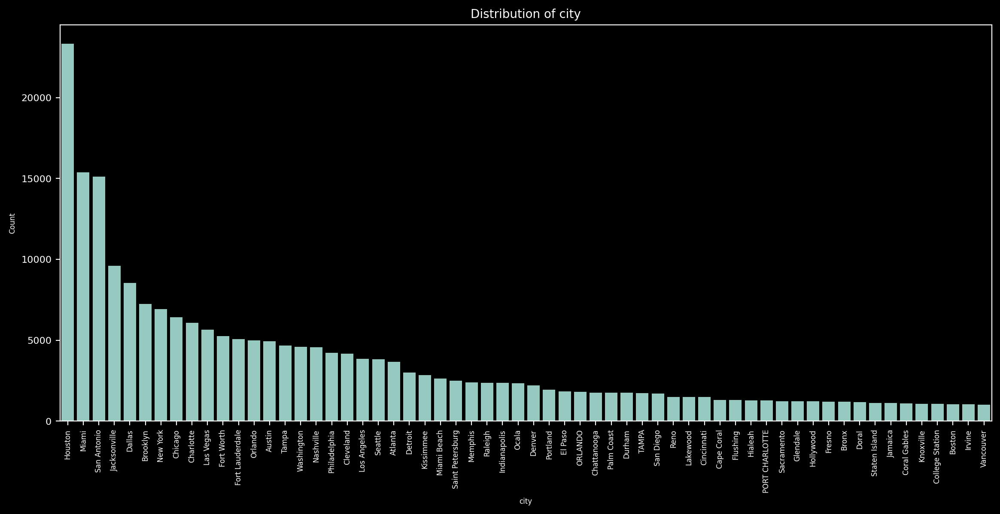

In [148]:
analyze_feature(df, 'city')

Let's normalize the text to a single case. We have a lot of unique values, almost 2000. Let's see how the picture changes.

In [149]:
df['city'] = df['city'].str.lower()

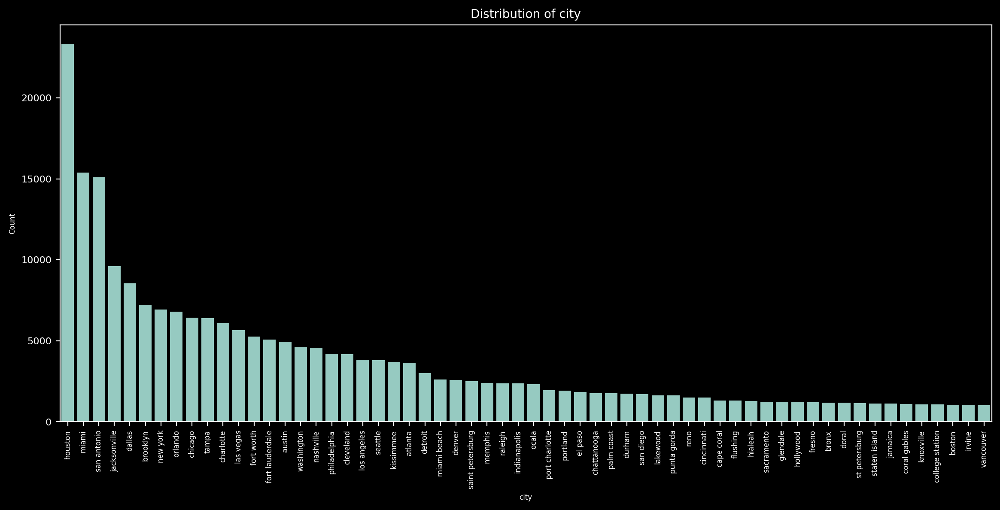

In [150]:
analyze_feature(df, 'city')

Small values will not improve the model. I think we should take the top 40 cities and classify the rest as 'other'.

In [151]:
def less_group_cities(group_name, index_list):
    if group_name not in index_list:
        return 'other'
    else:
        return group_name

index_list = df.city.value_counts().head(40).index.tolist()
df.city = df.city.apply(lambda x: less_group_cities(x,index_list))

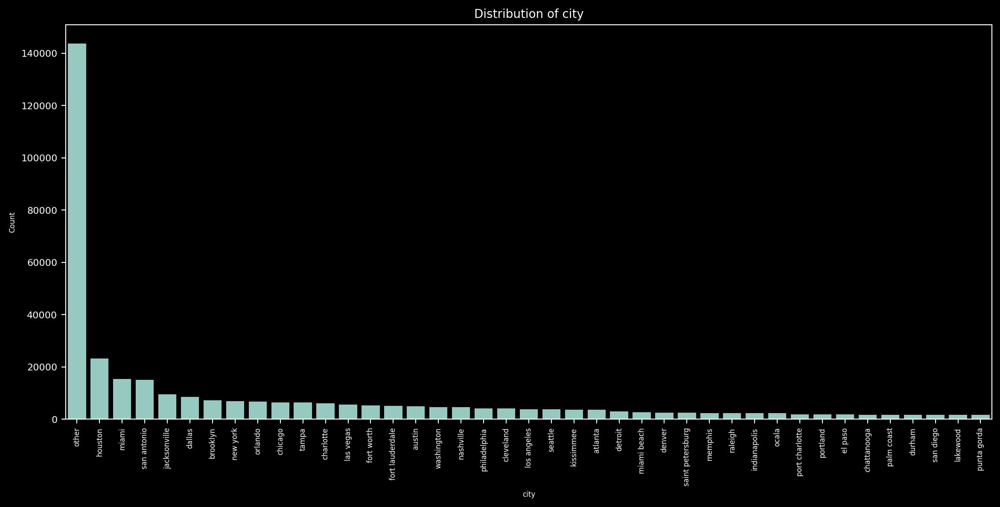

In [152]:
analyze_feature(df, 'city')

<a id = '3.10'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.10 Schools

</strong></p> 

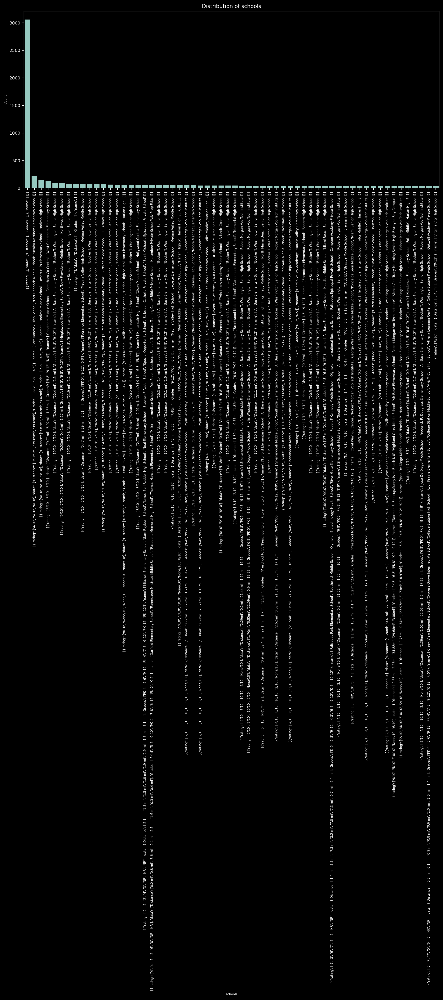

In [153]:
analyze_feature(df, 'schools')

Let's look at the structure. We have school ratings, distance, education, and distance for each school.

I think this factor is quite specific and can be either a plus, if a young couple is looking for a home, or a minus, if the home is for an elderly couple.

I think we should extract the minimum distance to a school and the number of available schools from this data.

In [154]:
ast.literal_eval(df.schools[0])[0]['data']

{'Distance': ['2.7 mi',
  '3.6 mi',
  '5.1 mi',
  '4.0 mi',
  '10.5 mi',
  '12.6 mi',
  '2.7 mi',
  '3.1 mi'],
 'Grades': ['3–5', '6–8', '9–12', 'PK–2', '6–8', '9–12', 'PK–5', 'K–12']}

In [155]:

def extract_school_info(school_str):
    # Parse the string to a dictionary
    school_data = ast.literal_eval(school_str)
    
    # Extract distances and ratings
    distances = school_data[0]['data']['Distance']

    # Check if distances list is empty
    if not distances:
        return 'no data', 'no data'    
    
    # Convert distances to float
    distances = [float(re.match(r'([0-9.]+)', dist).group(0)) for dist in distances]
    
    # Calculate the minimum distance
    min_distance = min(distances)
    
    # Count the number of available schools
    num_schools = len(distances)
    
    return min_distance, num_schools

<a id = '3.101'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.101 min_distance_school, num schools

</strong></p> 

In [156]:
df[['min_distance_school', 'num_schools']] = df['schools'].apply(lambda x: pd.Series(extract_school_info(x)))

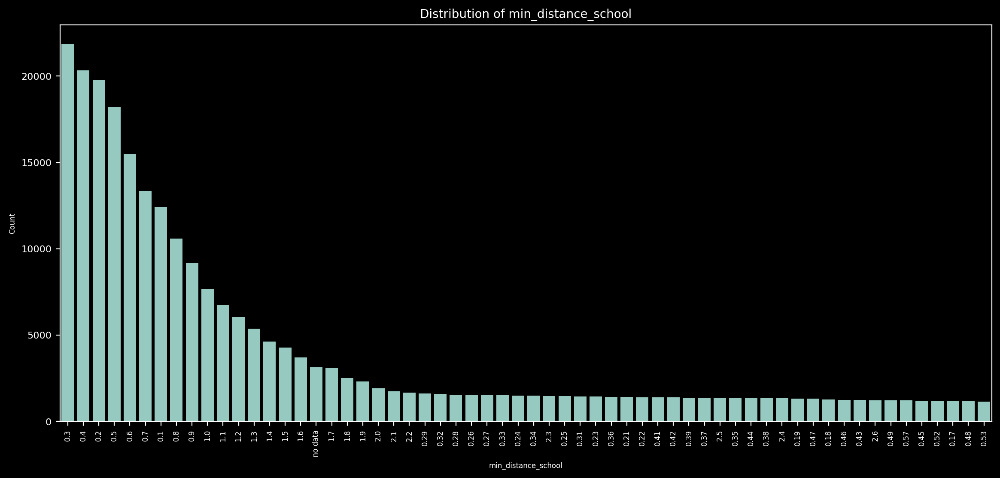

In [157]:
analyze_feature(df, 'min_distance_school')

In [158]:
print(format(df.min_distance_school.value_counts()))

min_distance_school
0.30     21871
0.40     20339
0.20     19779
0.50     18182
0.60     15484
         ...  
13.74        1
26.01        1
22.61        1
10.62        1
10.13        1
Name: count, Length: 1332, dtype: int64


In [159]:
df_schools = pd.to_numeric(df['min_distance_school'], errors='coerce')
df_schools = df_schools.dropna()
df_schools = df_schools.value_counts().sort_index()
df_schools

min_distance_school
0.00       891
0.01         1
0.02        21
0.03       113
0.04       174
          ... 
725.20       1
725.21       1
1187.14      1
1590.36      1
1590.38      1
Name: count, Length: 1331, dtype: int64

Let's look at the distribution of distances to the nearest school.

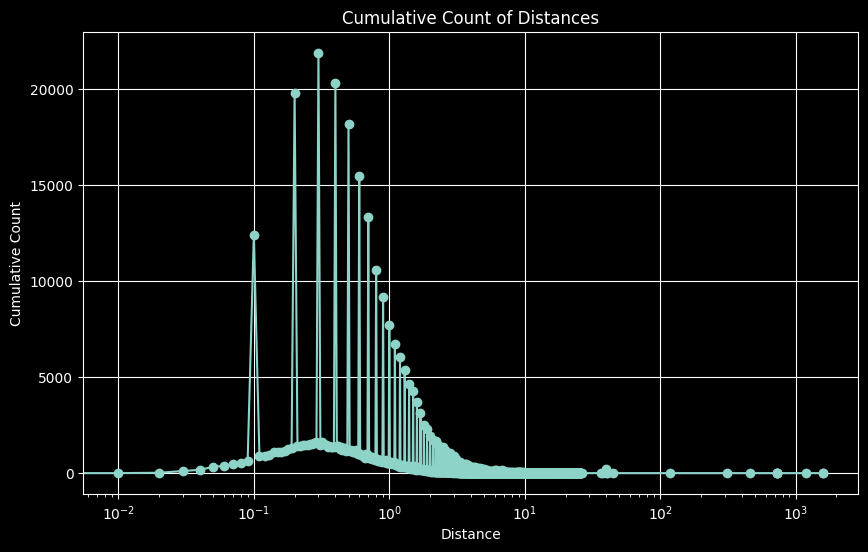

In [160]:
# Plot the cumulative count of distances
plt.figure(figsize=(10, 6))
plt.plot(df_schools.index, df_schools.values, marker='o')
plt.xlabel('Distance')
plt.ylabel('Cumulative Count')
plt.title('Cumulative Count of Distances')
plt.xscale('log')  # Set x-axis to logarithmic scale
plt.grid(True)
plt.show()

I will divide the distances into several categories: up to 0.5, then from 0.5 to 1, from 1 to 2, and above 5.

Also we still have a records with no data. Lets fill it with median values

In [161]:
df.min_distance_school = df.min_distance_school.replace('no data', df_schools.median())

C:\Users\Andrew\AppData\Local\Temp\ipykernel_26136\653390125.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.min_distance_school = df.min_distance_school.replace('no data', df_schools.median())


In [162]:
# Define the bins and labels
bins = [0, 0.5, 1, 2, 5, float('inf')]
labels = ['up to 0.5', '0.5 to 1', '1 to 2', '2 to 5', 'above 5']

# Apply the bins to the min_distance_school column
df['distance_category'] = pd.cut(df['min_distance_school'], bins=bins, labels=labels, right=False)


<a id = '3.102'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.102 distance_category

</strong></p> 

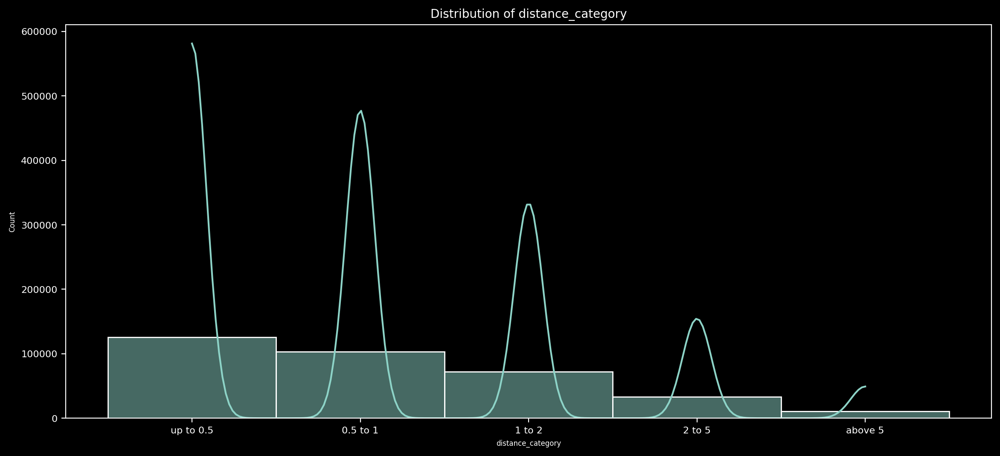

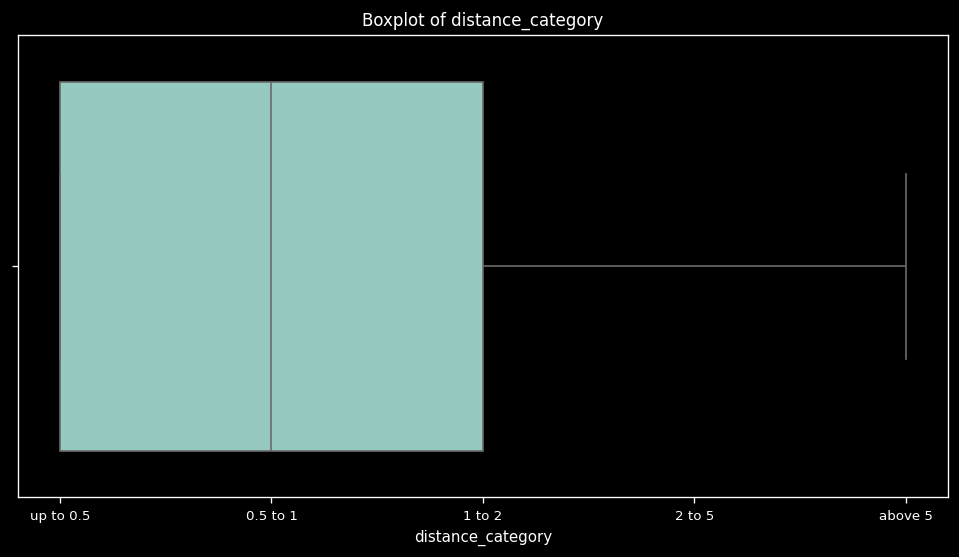

In [163]:
analyze_feature(df,'distance_category')

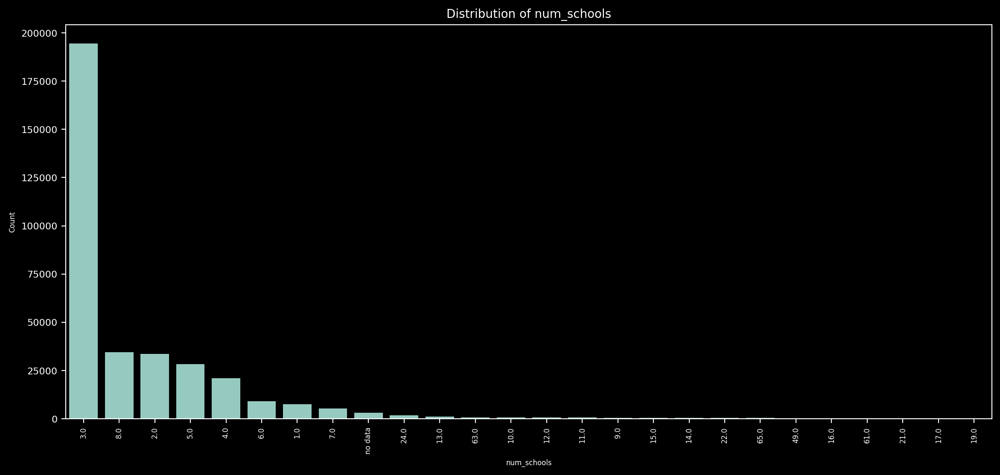

In [164]:
analyze_feature(df,'num_schools')

A similar situation: we will categorize the distances into larger groups, and replace 'no data' with the median value.



In [165]:
median_num_schools = df[df.num_schools != 'no data'].num_schools.median()

In [166]:
df.num_schools = df.num_schools.replace('no data', median_num_schools)

C:\Users\Andrew\AppData\Local\Temp\ipykernel_26136\757759378.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df.num_schools = df.num_schools.replace('no data', median_num_schools)


In [167]:
# Define the bins and labels
bins = [0, 1, 2, 3, 5, float('inf')]
labels = ['0', '1', '2', '3', 'above 5']

# Apply the bins to the min_distance_school column
df['num_schools_category'] = pd.cut(df['num_schools'], bins=bins, labels=labels, right=False)

<a id = '3.103'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.103 num_schools_category

</strong></p> 

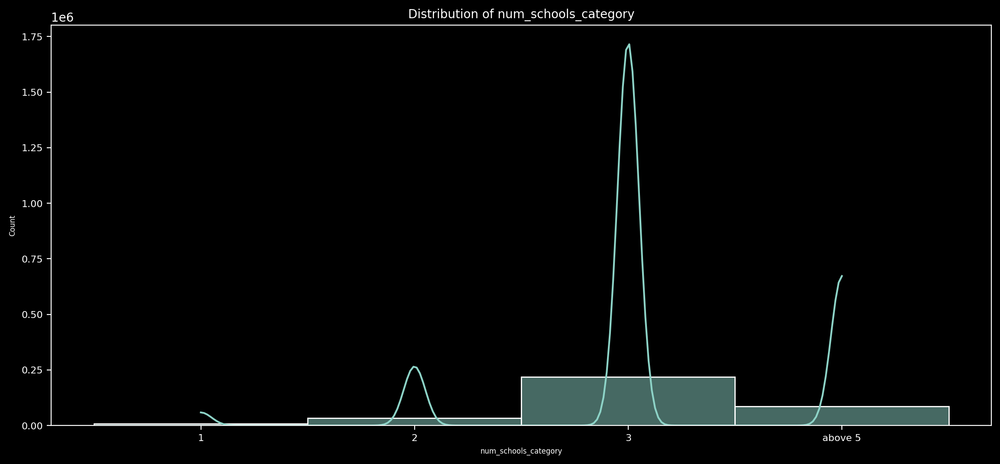

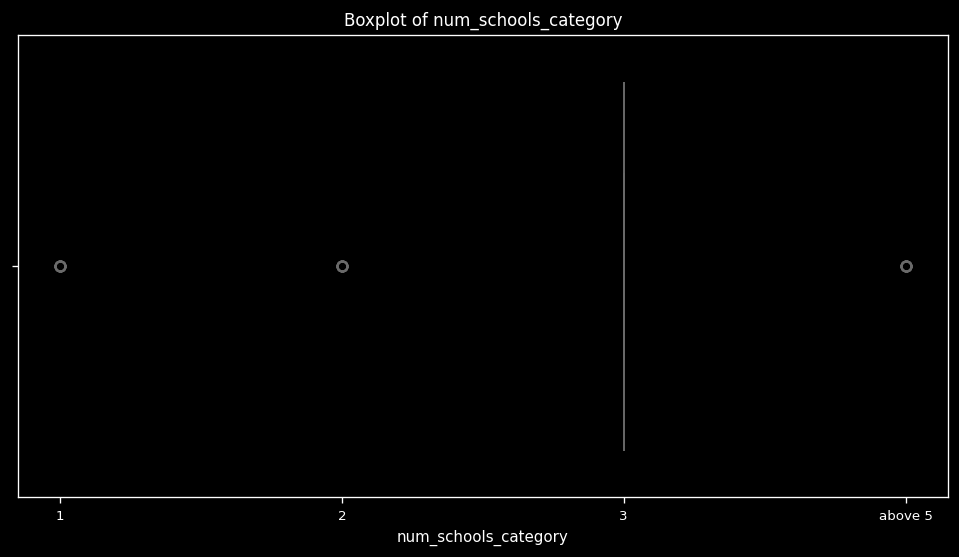

In [168]:
analyze_feature(df, 'num_schools_category')

In [169]:
df.drop('schools', axis = 1, inplace = True)
df.drop('num_schools', axis = 1, inplace = True)
df.drop('min_distance_school', axis = 1, inplace = True)

<a id = '3.11'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.11 Sqft

</strong></p> 

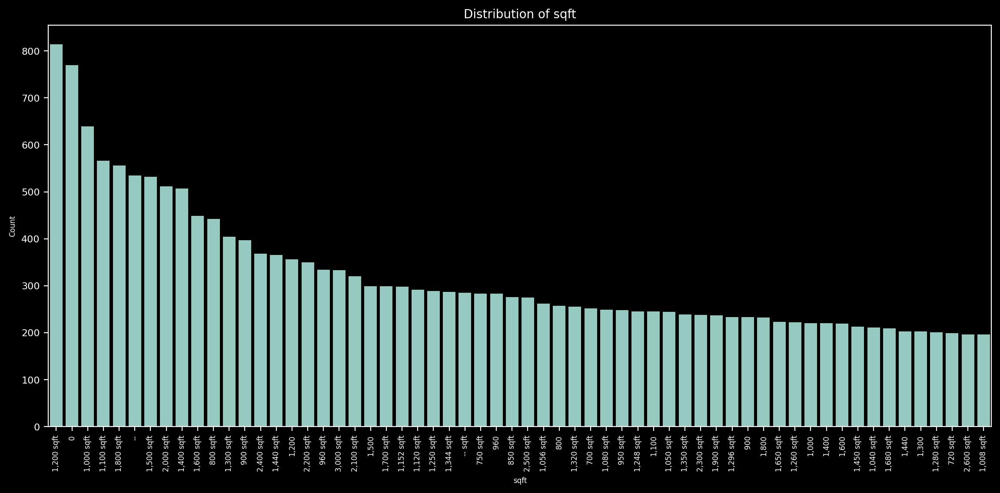

In [170]:
analyze_feature(df,'sqft')

In [171]:
df.sqft.isna().sum()

23964

In [172]:
df.sqft.replace(np.nan, 'no data', inplace=True)

C:\Users\Andrew\AppData\Local\Temp\ipykernel_26136\4075642283.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df.sqft.replace(np.nan, 'no data', inplace=True)


I will check for various types of writings for this feature.

In [173]:
# Function to check if a value contains any numeric characters
def contains_numbers(value):
    return bool(re.search(r'\d', value))

# Function to extract string parts from mixed values
def extract_string_parts(value):
    return ' '.join(re.findall(r'[^\d\s]+', value))

# Function to check if a value is purely numeric
def is_purely_numeric(value):
    try:
        float(value.replace(',', '').replace('.', ''))
        return True
    except ValueError:
        return False

# Apply functions to filter mixed values and extract string parts
mixed_values = df[df['sqft'].apply(lambda x: not is_purely_numeric(x))]
df['string_parts'] = mixed_values['sqft'].apply(extract_string_parts)

# Group by string parts and count their occurrences
grouped_string_parts = df['string_parts'].value_counts()

print("String parts and their counts:")
print(grouped_string_parts)

String parts and their counts:
string_parts
, sqft                                 136821
no data                                 23964
Total interior livable area: , sqft     21347
sqft                                    17848
Total interior livable area: sqft        2328
--                                        535
-- sqft                                   285
, , sqft                                    2
- sqft                                      1
Name: count, dtype: int64


We can see that all records refers only to sqft, no acres
Also some records has't any information about area size: '--', '-- sqft', '- sqft'
Will replace it with no data, other records get only numeric part

After additional evaluation I also found record like 610-840 sqft. Replaced with 610

In [174]:
df['sqft'] = df['sqft'].replace(['--', '-- sqft'], 'no data')
df['sqft'] = df['sqft'].replace(['610-840 sqft'], '610')


In [175]:
# Function to extract numeric part from mixed values
def extract_numeric_part(value):
    numeric_part = re.findall(r'[\d.,]+', value)
    if numeric_part:
        return numeric_part[0].replace(',', '')
    return value

# Apply functions to filter mixed values, extract numeric parts, and replace in the DataFrame
df['sqft'] = df['sqft'].apply(lambda x: extract_numeric_part(x) if not is_purely_numeric(x) and x != 'no data' else x)

# Convert remaining numeric strings to float for consistency
df['sqft'] = df['sqft'].apply(lambda x: float(x.replace(',', '')) if is_purely_numeric(x) else x)

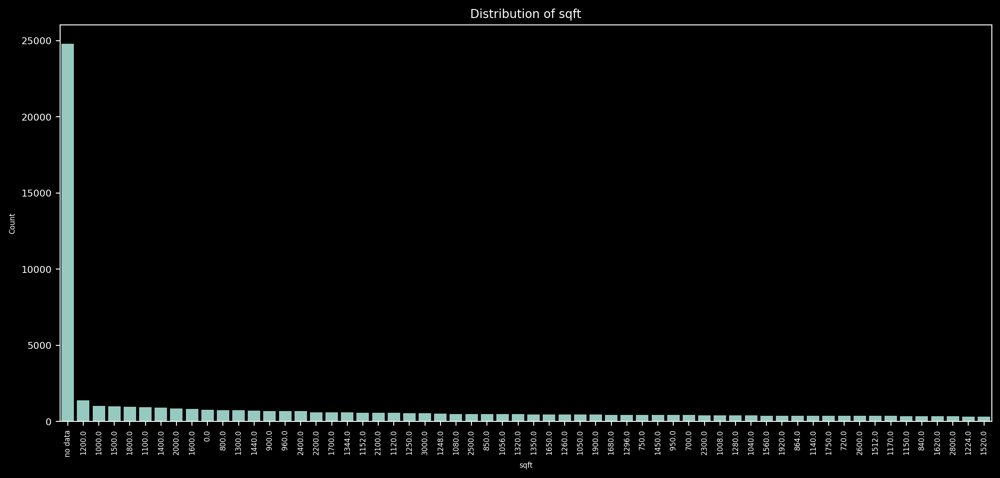

In [176]:
analyze_feature(df,'sqft')

We have no data and 0 values. Will be good to fill it with median value. But before lets evaluate a data, for clean reason

In [177]:
df.describe()

,lotsize_info_cleaned
count,3.450430e+05
mean,6.686822e+04
std,5.439365e+06
min,0.000000e+00
25%,0.000000e+00
50%,5.967000e+03
75%,1.001900e+04
max,2.147484e+09


I see that we have huge range for this feature. lets evaluate a data

C:\Users\Andrew\AppData\Local\Temp\ipykernel_26136\2518772307.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_sqft['sqft_cleaned'] = df_sqft.sqft.astype(float)


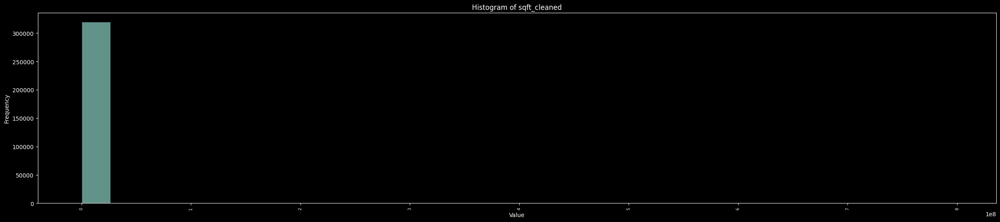

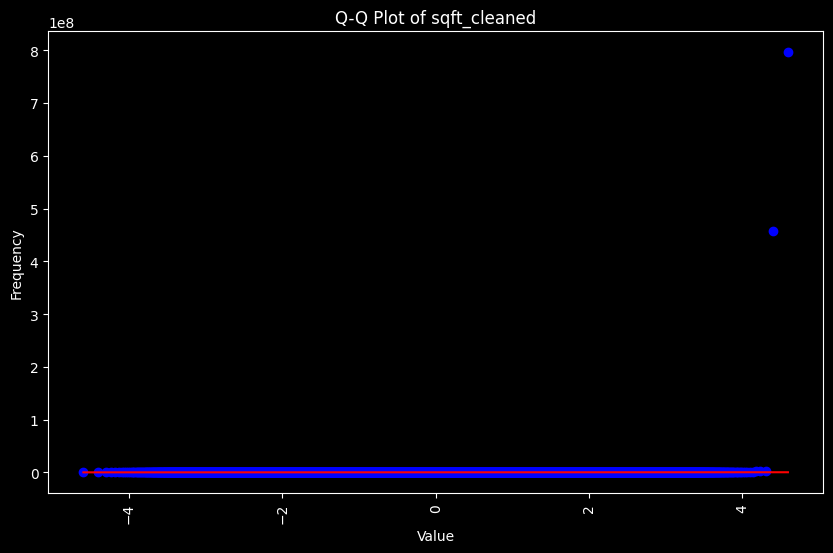

In [178]:
df_sqft = df[~df['sqft'].isin([0, 'no data'])]
df_sqft['sqft_cleaned'] = df_sqft.sqft.astype(float)

plot_histogram_qq(df_sqft,'sqft_cleaned','Sqft', 'Value','Frequency')

The plot shows that we do not have a normal distribution and the scatter is wild, which can significantly affect the model. We need to transform the data to a more normal distribution and remove the outliers.

In [179]:
outliers_indices = check_outliers(df_sqft, 'sqft_cleaned')

Outliers identified using Z-Score:
57423     795979430.0
344444    456602479.0
Name: sqft_cleaned, dtype: float64
Number of outliers using Z-Score: 2
Outliers identified using IQR:
3           6457.0
20          5266.0
24          5796.0
44          5358.0
69          5131.0
            ...   
344934      5621.0
344939    409538.0
344974      4860.0
344977      4615.0
345026      5992.0
Name: sqft_cleaned, Length: 17145, dtype: float64
Number of outliers using IQR: 17145


In [180]:
# Combine indices from both Z-Score and IQR methods
combined_outliers_indices = list(set(outliers_indices['z_score'] + outliers_indices['iqr']))

df_sqft = remove_outliers(df_sqft, combined_outliers_indices)

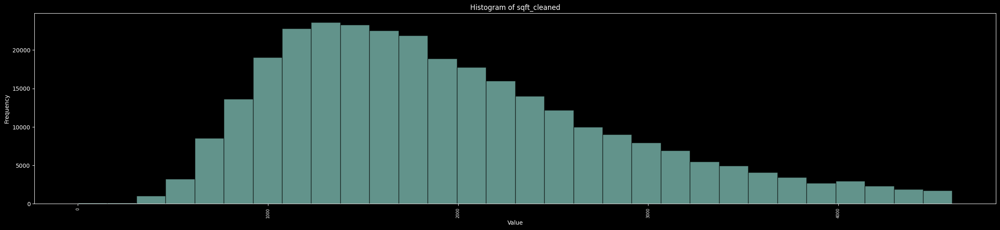

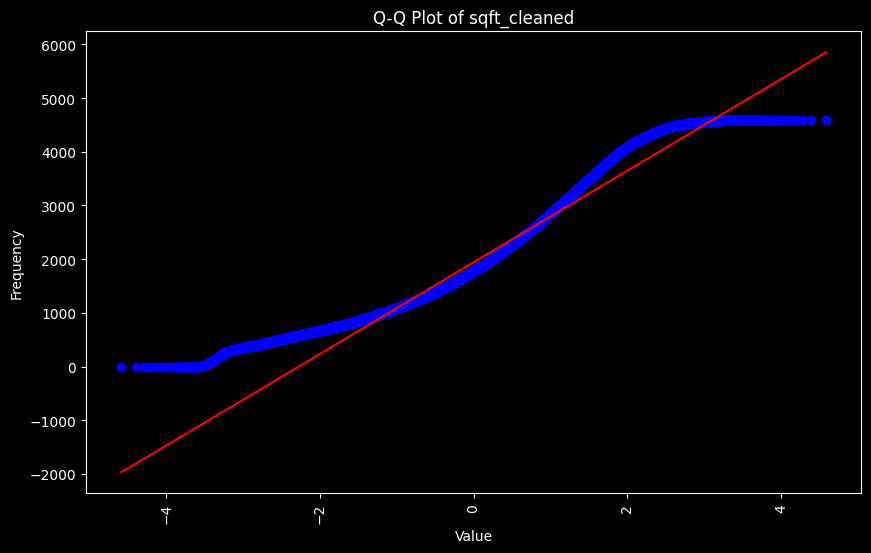

In [181]:
plot_histogram_qq(df_sqft,'sqft_cleaned','Sqft', 'Value','Frequency')

I think that all properties less than 10 sq. m is outliers, will drop these records

In [182]:
indices_to_remove = df_sqft[df_sqft.sqft_cleaned < 32].index
indices_to_remove

Index([   529,   3447,   5372,  15079,  17010,  29584,  30930,  38149,  41599,
        47415,  57410,  61175,  66275,  71771,  71885,  83957,  85552,  91619,
        94631, 109471, 121476, 125787, 135430, 136255, 139228, 141756, 158618,
       161906, 164058, 169052, 169931, 171969, 172280, 173911, 179047, 179697,
       181732, 181800, 183690, 192609, 196418, 201156, 214048, 217639, 221758,
       225027, 227049, 227645, 232275, 238866, 243488, 257263, 262863, 262876,
       268108, 269913, 291515, 295305, 295690, 301886, 303741, 305102, 307258,
       309011, 320906, 321574, 327371, 332058, 335086, 340645, 341609, 342337],
      dtype='int64')

Will draw Histogram again

In [183]:
df_sqft.drop(indices_to_remove, inplace=True)

df.drop(indices_to_remove, inplace=True)

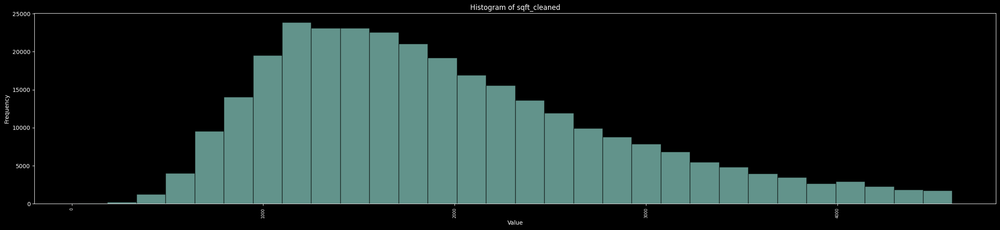

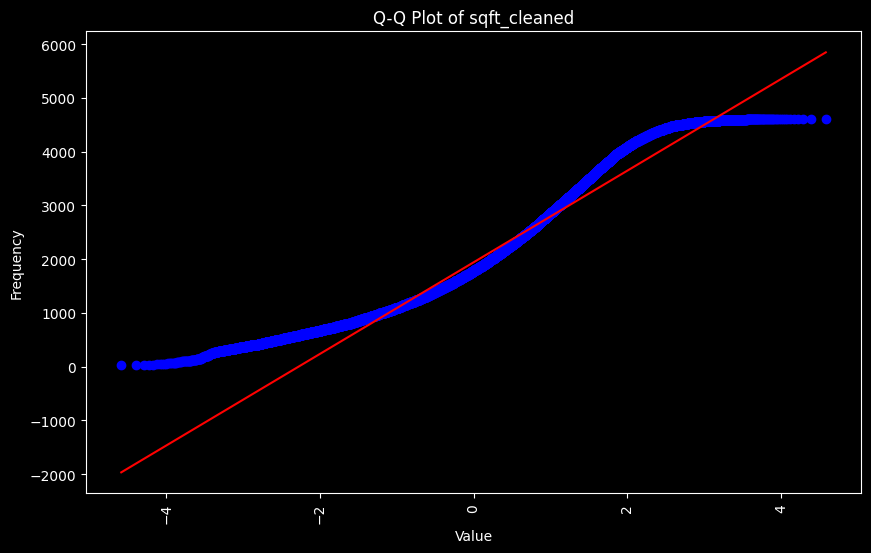

In [184]:
plot_histogram_qq(df_sqft,'sqft_cleaned','Sqft', 'Value','Frequency')

In [185]:
check_normality(df_sqft, 'sqft_cleaned')

Kolmogorov-Smirnov test: Statistic=0.07576681713771727, p-value=0.0
Anderson-Darling test: Statistic=4001.953747437685
Significance level: 15.0%, Critical value: 0.576
Significance level: 10.0%, Critical value: 0.656
Significance level: 5.0%, Critical value: 0.787
Significance level: 2.5%, Critical value: 0.918
Significance level: 1.0%, Critical value: 1.092
Lilliefors test statistic: 0.0757667118509977, p-value: 0.0009999999999998899


{'Lilliefors': {'statistic': 0.0757667118509977,
  'p-value': 0.0009999999999998899}}

### Analysis of Normality Test Results

#### Kolmogorov-Smirnov Test
- **Statistic**: 0.07576681713771727
- **p-value**: 0.0

#### Anderson-Darling Test
- **Statistic**: 4001.953747437685
- **Critical Values**:
  - **15.0%**: 0.576
  - **10.0%**: 0.656
  - **5.0%**: 0.787
  - **2.5%**: 0.918
  - **1.0%**: 1.092

#### Lilliefors Test
- **Statistic**: 0.0757667118509977
- **p-value**: 0.0009999999999998899

### Interpretation of Results

1. **Kolmogorov-Smirnov Test**:
   - **Statistic**: 0.07576681713771727
   - **p-value**: 0.0 (very small value)
   - **Interpretation**: The p-value is significantly less than the typical significance level (e.g., 0.05), indicating that we reject the null hypothesis of normality. Thus, the data are not normally distributed.

2. **Anderson-Darling Test**:
   - **Statistic**: 4001.953747437685
   - **Critical Values**: The test statistic (4001.953) far exceeds all critical values at all significance levels (even at 1% significance level, the critical value is 1.092).
   - **Interpretation**: The test statistic is much larger than all critical values, indicating a significant deviation from normality. The data strongly deviate from a normal distribution.

3. **Lilliefors Test**:
   - **Statistic**: 0.0757667118509977
   - **p-value**: 0.0009999999999998899
   - **Interpretation**: The p-value is very small, confirming the data are not normally distributed.

### Conclusion
All three tests (Kolmogorov-Smirnov, Anderson-Darling, and Lilliefors) indicate that the data do not follow a normal distribution. The extremely low p-values and high test statistics confirm significant deviations from normality.

### Recommendations
Given that the data are not normally distributed, it may be necessary to apply transformations to the data or use non-parametric methods for further analysis. If normality is critical for the analysis, consider transformations such as logarithmic, square root, or Box-Cox, and re-evaluate the normality after transformation.

### Actions
Will try to normalize data


In [186]:
# Logarithmic transformation
df_sqft['log_transformed'] = np.log(df_sqft['sqft_cleaned'] + 1)  # Adding 1 to avoid log of zero

# Square root transformation
df_sqft['sqrt_transformed'] = np.sqrt(df_sqft['sqft_cleaned'])

# Box-Cox transformation (requires positive data)
df_sqft['boxcox_transformed'], lambda_sqft_box_cox = stats.boxcox(df_sqft['sqft_cleaned'] + 1)  # Adding 1 to ensure positive values



In [190]:
# later will use it for transforming data website form
print(lambda_sqft_box_cox)
# Save the lambda value
with open('data/boxcox_lambda.pkl', 'wb') as f:
    pickle.dump(lambda_sqft_box_cox, f)

0.23356413367096304


In [ ]:
print('1.Log_transformed\n')
check_normality(df_sqft, 'log_transformed')
print('\n2. Sqrt_transformed\n')
check_normality(df_sqft, 'sqrt_transformed')
print('\n3. Boxcox_transformed\n')
check_normality(df_sqft, 'boxcox_transformed')

1.Log_transformed

Kolmogorov-Smirnov test: Statistic=0.020503753208855335, p-value=8.086585890992699e-111
Anderson-Darling test: Statistic=293.6623587818467
Significance level: 15.0%, Critical value: 0.576
Significance level: 10.0%, Critical value: 0.656
Significance level: 5.0%, Critical value: 0.787
Significance level: 2.5%, Critical value: 0.918
Significance level: 1.0%, Critical value: 1.092
Lilliefors test statistic: 0.02050346631800115, p-value: 0.0009999999999998899

2. Sqrt_transformed

Kolmogorov-Smirnov test: Statistic=0.03524725935349016, p-value=0.0
Anderson-Darling test: Statistic=870.7077818271937
Significance level: 15.0%, Critical value: 0.576
Significance level: 10.0%, Critical value: 0.656
Significance level: 5.0%, Critical value: 0.787
Significance level: 2.5%, Critical value: 0.918
Significance level: 1.0%, Critical value: 1.092
Lilliefors test statistic: 0.03524707179782116, p-value: 0.0009999999999998899

3. Boxcox_transformed

Kolmogorov-Smirnov test: Statistic=

{'Lilliefors': {'statistic': 0.016915348652708717,
  'p-value': 0.0009999999999998899}}

### Best Data Transformation for Normalization

#### Normality Test Results

1. **Original Data**
   - **Kolmogorov-Smirnov Test**: Statistic = 0.0758, p-value = 0.0
   - **Anderson-Darling Test**: Statistic = 4001.954
   - **Lilliefors Test**: Statistic = 0.0758, p-value = 0.0009999999999998899

2. **Log_transformed**
   - **Kolmogorov-Smirnov Test**: Statistic = 0.0205, p-value = 8.09e-111
   - **Anderson-Darling Test**: Statistic = 293.662
   - **Lilliefors Test**: Statistic = 0.0205, p-value = 0.0009999999999998899

3. **Sqrt_transformed**
   - **Kolmogorov-Smirnov Test**: Statistic = 0.0352, p-value = 0.0
   - **Anderson-Darling Test**: Statistic = 870.708
   - **Lilliefors Test**: Statistic = 0.0352, p-value = 0.0009999999999998899

4. **Boxcox_transformed**
   - **Kolmogorov-Smirnov Test**: Statistic = 0.0169, p-value = 1.46e-75
   - **Anderson-Darling Test**: Statistic = 219.753
   - **Lilliefors Test**: Statistic = 0.0169, p-value = 0.0009999999999998899

### Analysis of Results

- **Kolmogorov-Smirnov Test**: The Box-Cox transformation has the lowest statistic (0.0169) and a significantly better p-value (1.46e-75).
- **Anderson-Darling Test**: The Box-Cox transformation also has the lowest statistic (219.753) compared to other methods.
- **Lilliefors Test**: The Box-Cox transformation again shows the lowest statistic (0.0169) and p-value.

### Conclusion
The **Box-Cox transformation** demonstrated the best normalization results across all three tests (Kolmogorov-Smirnov, Anderson-Darling, and Lilliefors). It provides the lowest test statistics and the best p-values, indicating the best approximation to a normal distribution among the methods considered.

### Next Steps
We will use the values obtained from the Box-Cox transformation instead of the sqrt_transformed feature. Additionally, in the initial dataset, we will replace zero and "no data" values with the median value based on the boxcox_transformed feature.

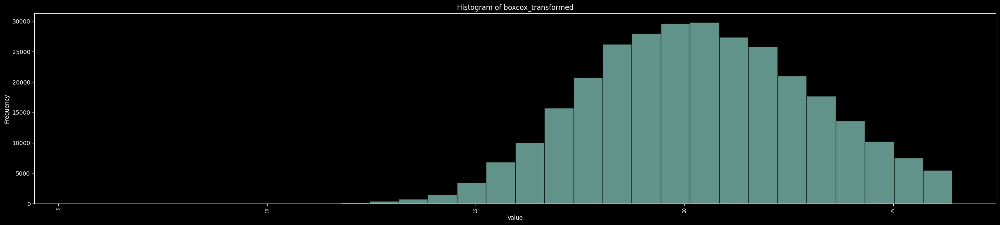

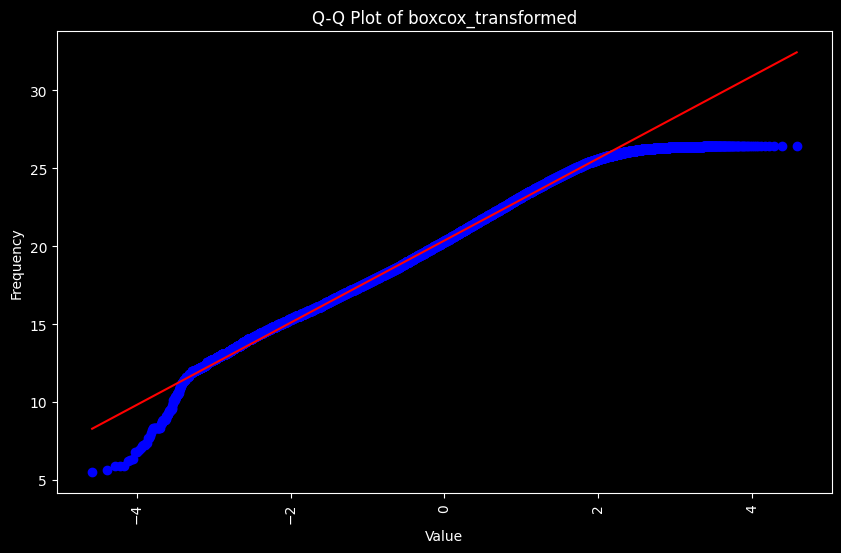

In [ ]:
plot_histogram_qq(df_sqft,'boxcox_transformed','Sqft', 'Value','Frequency')


In [ ]:
# Calculate the median value from the boxcox_transformed column
boxcox_median = df_sqft['boxcox_transformed'].median()

# Replace 0 and "no data" values in df['sqft'] with the Box-Cox median
df['sqft_cleaned'] = df['sqft'].replace([0, 'no data'], boxcox_median)

# Replace each value in df['sqft'] with the corresponding value from df_sqrt['boxcox_transformed'] by index
df.loc[df_sqft.index, 'sqft_cleaned'] = df_sqft['boxcox_transformed']
df = remove_outliers(df, combined_outliers_indices)

C:\Users\Andrew\AppData\Local\Temp\ipykernel_36584\2773161423.py:5: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['sqft_cleaned'] = df['sqft'].replace([0, 'no data'], boxcox_median)


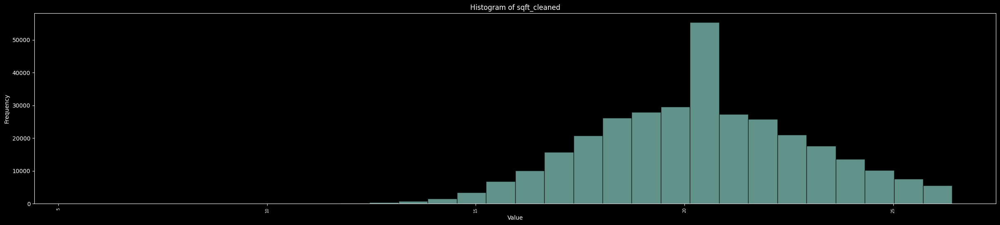

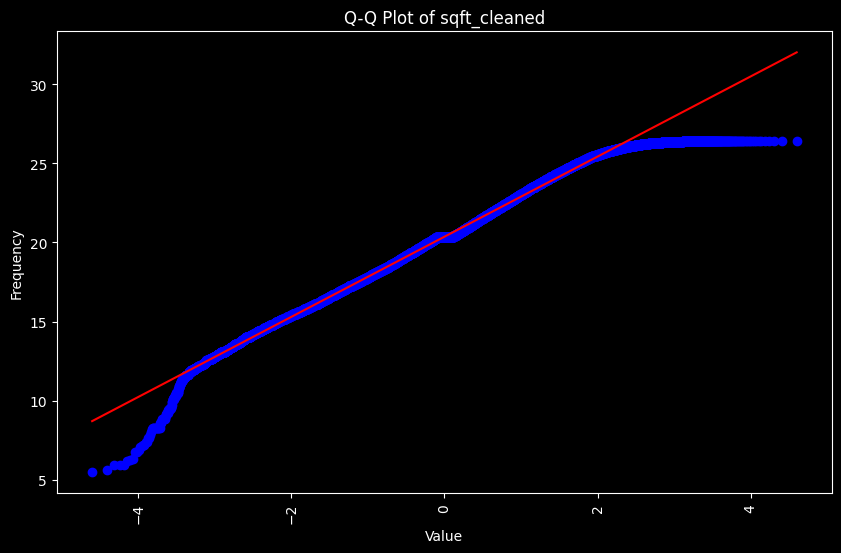

In [ ]:
plot_histogram_qq(df,'sqft_cleaned','Sqft', 'Value','Frequency')

In [ ]:
check_normality(df, 'sqft_cleaned')

Kolmogorov-Smirnov test: Statistic=0.04664670082867228, p-value=0.0
Anderson-Darling test: Statistic=464.54820384905906
Significance level: 15.0%, Critical value: 0.576
Significance level: 10.0%, Critical value: 0.656
Significance level: 5.0%, Critical value: 0.787
Significance level: 2.5%, Critical value: 0.918
Significance level: 1.0%, Critical value: 1.092
Lilliefors test statistic: 0.046646690105834, p-value: 0.0009999999999998899


{'Lilliefors': {'statistic': 0.046646690105834,
  'p-value': 0.0009999999999998899}}

I think we're done with the transformations for this feature, and we can move on to the next one.

In [ ]:
df.drop('sqft', axis = 1, inplace = True)
df.drop('string_parts', axis = 1, inplace = True)

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 327826 entries, 0 to 345042
Data columns (total 22 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   fireplace             327826 non-null  object  
 1   city                  327826 non-null  object  
 2   zipcode               327826 non-null  object  
 3   state                 327826 non-null  object  
 4   stories               211791 non-null  object  
 5   mls-id                23587 non-null   object  
 6   MlsId                 263468 non-null  object  
 7   target                325414 non-null  object  
 8   status_category       327826 non-null  object  
 9   PrivatePoolStatus     327826 non-null  object  
 10  propertyTypeGroup     327826 non-null  object  
 11  bathCleaned           327826 non-null  object  
 12  bedsCleaned           327826 non-null  object  
 13  year_built            327826 non-null  object  
 14  remodeled_year        327826 non-null  ob

<a id = '3.12'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.12 ZipCode

</strong></p> 

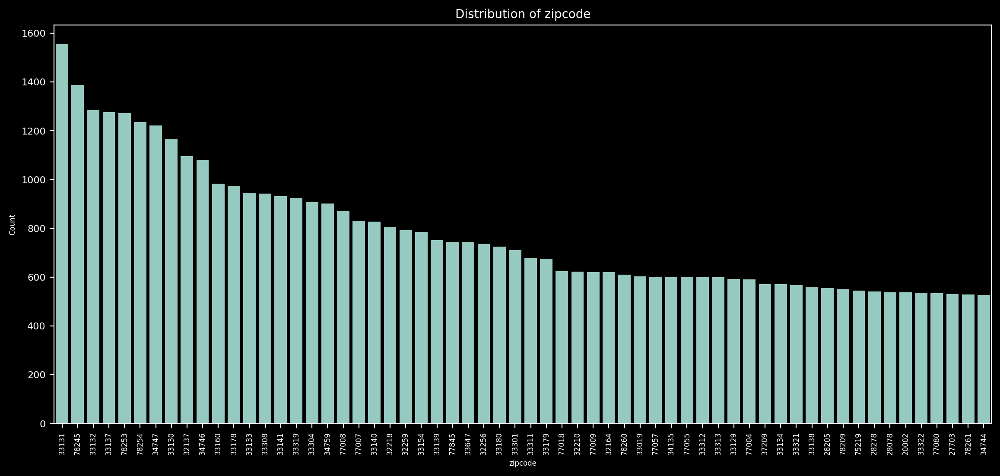

In [ ]:
analyze_feature(df, 'zipcode')

In [ ]:
# Define a regex pattern for valid US ZIP codes
valid_zipcode_pattern = re.compile(r'^[0-9]{5}$')

# List of some known valid ZIP code ranges for simplification
# Note: This is not exhaustive but can be expanded based on more detailed data
valid_zipcode_ranges = [
    (1000, 99950),  # General ZIP code ranges within the continental US and major territories
]

# Function to check if the zipcode is valid
def is_valid_zipcode(zipcode):
    # Ensure the zipcode is a string and pad with leading zeros if necessary
    zipcode = str(zipcode).zfill(5)
    if not bool(valid_zipcode_pattern.match(zipcode)):
        return False
    zip_int = int(zipcode)
    for (start, end) in valid_zipcode_ranges:
        if start <= zip_int <= end:
            return True
    return False

# Filter the DataFrame to find invalid zipcodes
invalid_zipcodes = df[~df['zipcode'].apply(is_valid_zipcode)]

Given that a valid US ZIP code should be in the range (1000, 99950) and consist of 5 digits, I wrote a small function to help us find incorrectly filled ZIP codes.

As a result, we identified the following invalid ZIP codes:
['0', '123456', '112229', '331446', '00000', '--']

Additionally, there are 220 entries where the ZIP code is in the format xxxxx-xxxx, with the first 5-digit part conforming to the ZIP code format. I think we should simply remove the last 4 digits and the hyphen.
Also, we have only few records wih incorrect zipcode, will remove it

In [ ]:
invalid_zipcodes.zipcode

3347      27606-1626
4740      27607-6632
6546      27705-3261
6896      27603-2692
10151     27613-8607
             ...    
332262    27610-5617
332952    27615-3876
333929    77015-2522
334563    27615-6225
338762    77092-5540
Name: zipcode, Length: 227, dtype: object

In [ ]:
# lets check for inputs contained symbols
invalid_zipcodes.zipcode.apply(extract_string_parts).value_counts()

zipcode
-     220
        5
--      2
Name: count, dtype: int64

In [ ]:
invalid_zipcodes[invalid_zipcodes.zipcode == '--']

,fireplace,city,zipcode,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,...,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned
211646,no,other,--,CA,NaN,OC19261036,NaN,"$60,000,000",New construction,No,...,no data,1985,no,no data,no data,0,0,2 to 5,3,20.312701
215190,no,fort lauderdale,--,FL,NaN,NaN,"1744, Fort Lauderdale, FL","$425,000",Other,No,...,3.0,2010,no,air,central,other,5967,0.5 to 1,3,21.116751


In [ ]:
invalid_zipcodes_to_remove = invalid_zipcodes[~invalid_zipcodes.zipcode.str.contains(r'-{1}')].zipcode.to_list()
invalid_zipcodes_to_remove.append('--')
invalid_zipcodes_to_remove

['0', '123456', '112229', '331446', '00000', '--']

In [ ]:
df[(df['zipcode'].str.len()<10) & (df['zipcode'].str.contains('-'))]

,fireplace,city,zipcode,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,...,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned
102932,yes,raleigh,27603-43,NC,NaN,NaN,2292160,"352,000",Active,No,...,no data,2014,yes,no data,no data,0,3920,1 to 2,3,22.087296
211646,no,other,--,CA,NaN,OC19261036,NaN,"$60,000,000",New construction,No,...,no data,1985,no,no data,no data,0,0,2 to 5,3,20.312701
215190,no,fort lauderdale,--,FL,NaN,NaN,"1744, Fort Lauderdale, FL","$425,000",Other,No,...,3.0,2010,no,air,central,other,5967,0.5 to 1,3,21.116751
222204,no,durham,27713-967,NC,NaN,NaN,2266947,"295,000",Active,No,...,no data,1985,no,no data,no data,0,35283,2 to 5,3,20.312701


In [ ]:
df = df[~df['zipcode'].isin(invalid_zipcodes_to_remove)]
df['zipcode'] = df['zipcode'].apply(lambda x: x[:5] if '-' in x else x)

<a id = '3.13'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.13 State

</strong></p> 

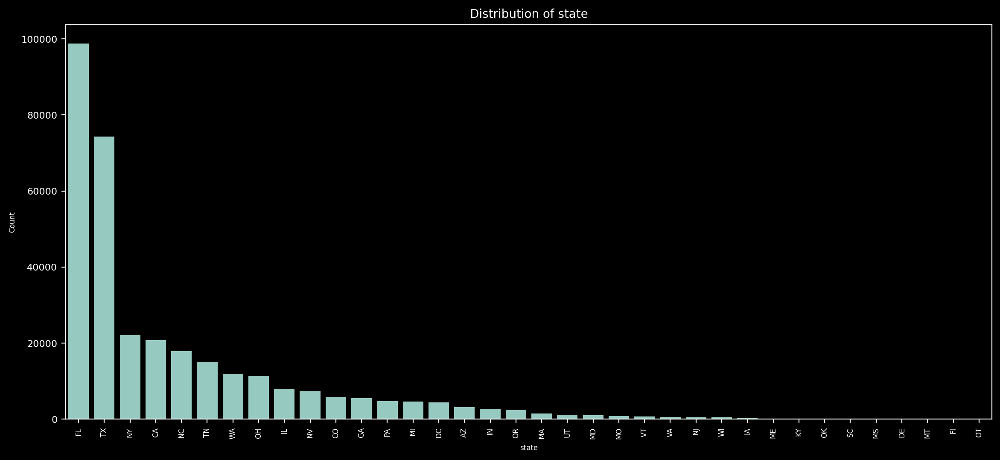

In [ ]:
analyze_feature(df,'state')

The majority of the entries fall within the top 19 categories. Let's create 20 categories in total: the top 19 plus an "other" category.

In [ ]:
top_states = df.state.value_counts()[:19].index
top_states

Index(['FL', 'TX', 'NY', 'CA', 'NC', 'TN', 'WA', 'OH', 'IL', 'NV', 'CO', 'GA',
       'PA', 'MI', 'DC', 'AZ', 'IN', 'OR', 'MA'],
      dtype='object', name='state')

In [ ]:
df.state = df.state.apply(lambda x: x if x in top_states else 'other')

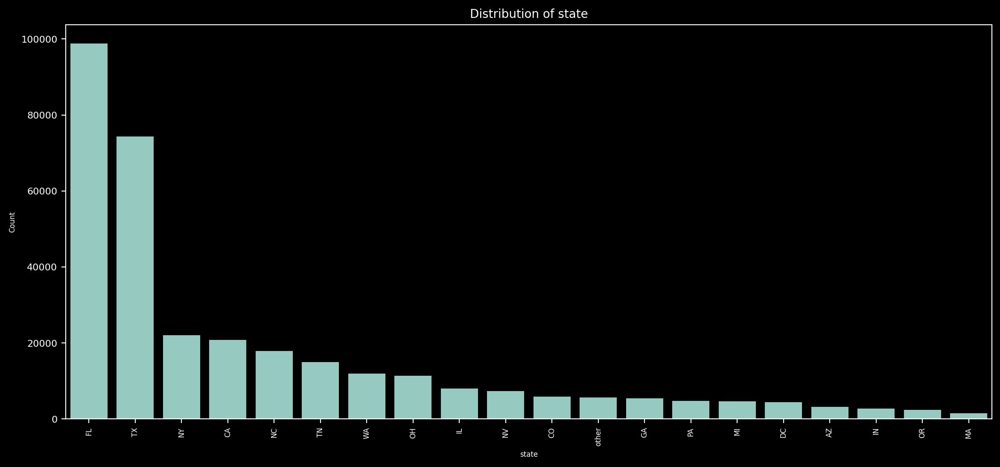

In [ ]:
analyze_feature(df, 'state')

<a id = '3.14'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.14 Stories

</strong></p> 

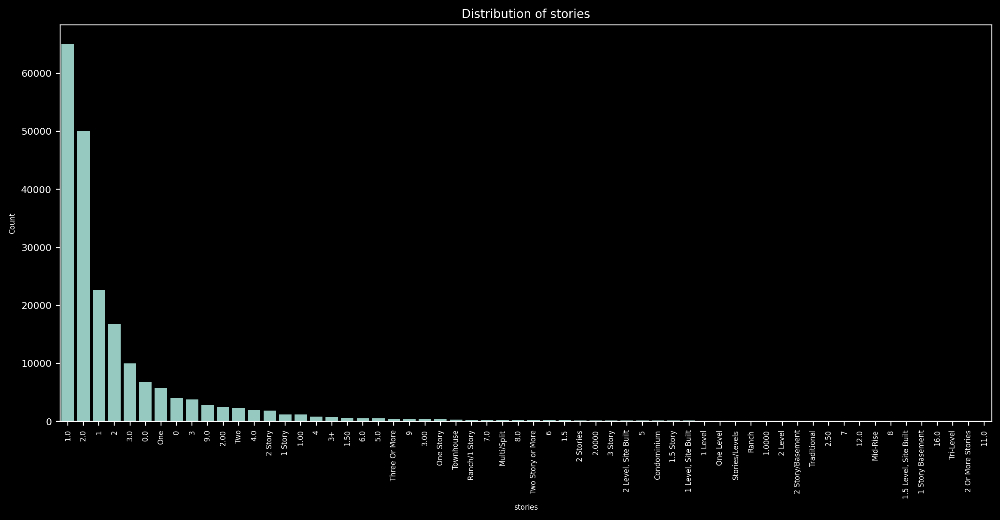

In [ ]:
analyze_feature(df, 'stories')

The feature is very "dirty" with a lot of missing and zero values. Let's try to clean it up.

We'll replace the missing and zero values with the median values based on the previously created propertyTypeGroup.

Additionally, we'll try to infer the number of stories from the property type descriptions.

In [ ]:
df[df.stories == '0']

,fireplace,city,zipcode,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,...,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned
35,yes,other,93705,CA,0,NaN,533746,"$284,900",For Sale,No,...,3.0,1949,yes,air,central,garage,7440,up to 0.5,2,19.155738
461,no,other,92037,CA,0,NaN,190048944,"$2,999,999",For Sale,No,...,4.0,2019,yes,air,central,2,130680,up to 0.5,3,24.085089
489,no,other,94621,CA,0,NaN,40889896,"$395,000",For Sale,No,...,2.0,1922,yes,other,no data,garage,4225,up to 0.5,2,15.571737
533,no,kissimmee,34746,FL,0,NaN,10674273,"$65,000",Other,Yes,...,3.0,1991,no,no data,central,2,0,2 to 5,2,18.654897
676,no,denver,80202,CO,0,NaN,4739658,"$599,000",For Sale,No,...,2.0,2009,yes,air,central,2,0,0.5 to 1,3,18.622379
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344747,no,other,92614,CA,0,NaN,"106, Irvine, CA 92614","$762,900",For Sale,Yes,...,2.0,1986,no,air,central,garage,0,up to 0.5,3,17.109811
344785,yes,other,95125,CA,0,NaN,ML81769870,"$1,895,000",For Sale,No,...,3.0,1948,yes,air,central,2,7653,1 to 2,3,21.421243
344859,yes,tampa,33605,FL,0,NaN,NaN,"$170,591",Other,No,...,0.0,1945,yes,other,central,other,0,up to 0.5,3,20.961381
344879,yes,other,93726,CA,0,NaN,533814,"$199,900",For Sale,No,...,2.0,1955,yes,air,central,garage,7191,0.5 to 1,3,17.764427


In [ ]:
# Function to convert stories to numerical values
def convert_to_numeric(stories):
    # Dictionary to map textual representations to numeric values
    mapping = {
        'one': 1, 'two': 2, 'three': 3, 'four': 4, 'five': 5, 'six': 6,
        'seven': 7, 'eight': 8, 'nine': 9, 'ten': 10, 'eleven': 11, 'twelve': 12,
        'one level': 1, 'one story': 1, 'one story/f.r.o.g.': 1,
        'two stories': 2, 'two story': 2, 'two level': 2,
        'three stories': 3, 'three story': 3, 'three or more': 3,
        'four stories': 4, 'four story': 4, 'fourplex': 4,
        'five stories': 5, 'five story': 5, 'sixplex': 6,
        'ranch/1 story': 1, 'condominium': 1, 'ground level, one': 1,
        'split level': 2, 'tri-level': 3, 'multi-level': 3,
        'high-rise': 8, 'mid-rise': 4, 'low-rise (1-3 story)': 3,
        'traditional': 2, 'townhouse': 2, 'farm house': 2,
        'mobile': 1, 'duplex': 2, 'triplex': 3, 'quad level': 4,
        'bi-level': 2, 'bungalow': 1, 'log home': 2, 'cape cod': 2,
        'raised ranch': 2, 'patio home': 1, 'split entry (bi-level)': 2,
        'a frame': 1, 'tudor': 2, 'colonial': 2, 'victorian': 3,
        'loft': 1, 'craftsman': 2, 'contemporary': 2,
        'federal': 2, 'garden': 1, 'chalet': 1, 'split foyer': 2,
        'site built': 1, 'site built, tri-level': 3,
        'site built, split foyer': 2, 'site built, split level': 2,
        'site built, townhouse': 2, 'site built, condo': 2,
        'multi/split': 2, 'tri/multi level': 3, 'three or more levels': 3,
        'other': 1, 'none': np.nan
    }

    # Convert string to lower case and strip whitespace
    stories = str(stories).strip().lower()
    
    # Check if the story is in the mapping dictionary
    if stories in mapping:
        return mapping[stories]
    
    # Handle numeric values and fractions
    try:
        if 'story' in stories or 'level' in stories:
            return float(stories.split()[0])
        if ',' in stories:
            parts = stories.split(',')
            return sum(float(part) for part in parts)
        if '/' in stories:
            parts = stories.split('/')
            return sum(float(part) for part in parts) / len(parts)
        return float(stories)
    except ValueError:
        return np.nan


In [ ]:
df['stories_cleaned'] = df.stories.apply(convert_to_numeric)

In [ ]:
df['stories_cleaned'].unique()

array([      nan, 2.000e+00, 1.000e+00, 4.000e+00, 0.000e+00, 9.000e+00,
       3.000e+00, 5.000e+00, 7.000e+00, 2.200e+01, 6.000e+00, 1.500e+00,
       5.400e+01, 2.300e+01, 8.000e+00, 1.600e+01, 1.800e+01, 2.100e+01,
       1.200e+01, 1.100e+01, 2.800e+01, 2.500e+00, 6.300e+01, 2.700e+01,
       1.400e+01, 1.300e+00, 1.900e+01, 1.500e+01, 1.700e+01, 1.300e+01,
       3.100e+01, 4.600e+01, 7.000e+01, 2.500e+01, 3.300e+01, 1.000e+01,
       9.000e+01, 9.100e+01, 2.000e+01, 2.400e+01, 1.750e+00, 3.800e+01,
       2.600e+01, 3.000e+01, 3.600e+01, 4.500e+01, 2.900e+01, 5.500e+01,
       7.800e+01, 5.600e+01, 4.700e+01, 4.000e+01, 4.200e+01, 3.500e+01,
       4.300e+01, 8.000e+01, 3.400e+01, 1.700e+00, 3.200e+01, 5.700e+01,
       4.100e+01, 3.900e+01, 6.400e+01, 4.800e+01, 3.500e+00, 5.100e+01,
       5.800e+01, 5.200e+01, 3.700e+01, 5.000e+01, 4.400e+01, 6.000e+01,
       7.700e+01, 1.200e+00, 7.500e+01, 6.600e+01, 6.200e+01, 8.200e+01,
       9.500e+01, 4.900e+01, 1.120e+03, 2.200e+00, 

In [ ]:
df.stories_cleaned  = df.stories_cleaned.astype('str')

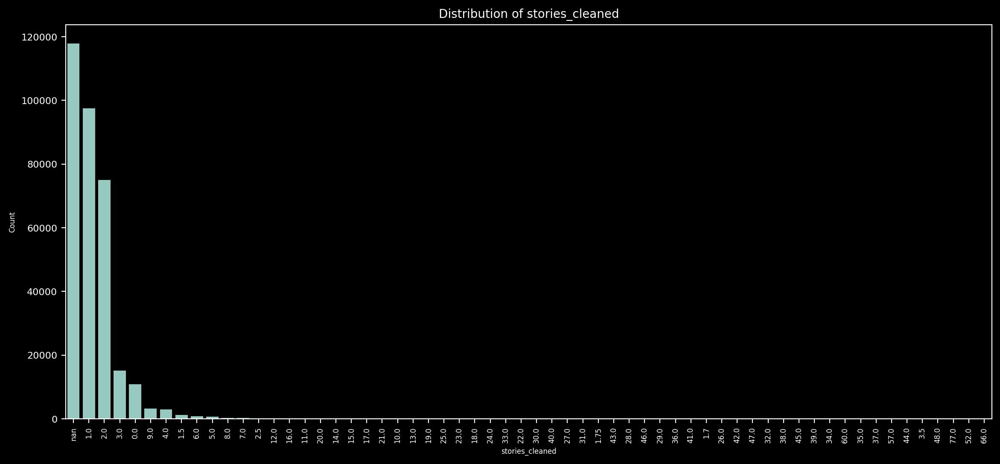

In [ ]:
analyze_feature(df,'stories_cleaned')

In [ ]:
df.stories_cleaned  = df.stories_cleaned.astype('float')

In [ ]:
df[df.stories_cleaned>80]

,fireplace,city,zipcode,state,stories,mls-id,MlsId,target,status_category,PrivatePoolStatus,...,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned,stories_cleaned
13311,no,new york,10019,NY,90.0,NaN,19130939,"$16,500,000",For Sale,Yes,...,2009,no,no data,central,0,0,0.5 to 1,above 5,24.452786,90.0
13737,no,new york,10014,NY,91,NaN,2836355,"$6,975,000",For Sale,Yes,...,2017,no,no data,no data,0,0,up to 0.5,above 5,20.787678,91.0
103459,no,new york,10022,NY,90.0,NaN,2813149,"$10,995,000",For Sale,Yes,...,2012,no,no data,no data,0,34412,up to 0.5,above 5,20.341673,90.0
162619,no,new york,10019,NY,82,NaN,4733863,"$3,470,000",For Sale,Yes,...,2019,no,no data,central,0,0,0.5 to 1,above 5,19.774411,82.0
169014,no,new york,10014,NY,91,NaN,2836712,"$3,750,000",For Sale,Yes,...,2017,no,no data,no data,0,0,up to 0.5,above 5,20.787678,91.0
192466,no,new york,10019,NY,95,NaN,3118654,"$18,000,000",For Sale,No,...,1985,no,no data,no data,0,0,up to 0.5,above 5,24.326047,95.0
203999,no,jacksonville,32202,FL,1120.0,974565,NaN,"$53,000",For Sale,No,...,1949,yes,air,central,0,25,0.5 to 1,2,13.327315,1120.0
204905,no,new york,10022,NY,90.0,NaN,"66B, New York, NY 10022","$32,500,000",For Sale,Yes,...,2015,no,no data,no data,other,0,up to 0.5,3,25.463371,90.0
264580,no,new york,10014,NY,91,NaN,2836642,"$1,450,000",For Sale,Yes,...,2017,no,no data,no data,0,0,up to 0.5,above 5,16.573226,91.0
289561,yes,other,97703,OR,1002.0,201909859,NaN,"$325,000",For Sale,No,...,2006,no,air,central,1,2613,2 to 5,3,19.338500,1002.0


2 records has more than 100 stories but cost is small. Its a mistake. Will drop these 2 records

In [ ]:
df = df.drop(index=[203999, 289561])

In [ ]:
df[df.stories_cleaned.isna()].propertyTypeGroup.value_counts()

propertyTypeGroup
Single-Family Home          46440
Other/Various Styles        33640
Condominium/Apartment       21971
Multi-Family Home            4830
Townhouse                    3919
Traditional                  1998
Ranch                        1515
Contemporary/Modern          1242
Manufactured/Mobile Home     1197
Colonial                     1094
Name: count, dtype: int64

In [ ]:
df[df.stories_cleaned == 0].propertyTypeGroup.value_counts()

propertyTypeGroup
Single-Family Home       7108
Condominium/Apartment    2124
Townhouse                 767
Other/Various Styles      442
Multi-Family Home         381
Name: count, dtype: int64

In [ ]:
df_stories = df[df.stories.notna()]

In [ ]:
medians = df_stories.groupby('propertyTypeGroup')['stories_cleaned'].median()

In [ ]:
medians


propertyTypeGroup
Colonial                    2.0
Condominium/Apartment       2.0
Contemporary/Modern         2.0
Manufactured/Mobile Home    1.0
Multi-Family Home           2.0
Other/Various Styles        1.0
Ranch                       1.0
Single-Family Home          1.0
Townhouse                   2.0
Traditional                 2.0
Name: stories_cleaned, dtype: float64

In [ ]:
# Function to replace NaN values with median based on propertyTypeGroup
def replace_with_median(median_values, row):
    if pd.isnull(row['stories_cleaned']):
        return median_values.get(row['propertyTypeGroup'], np.nan)
    return row['stories_cleaned']

In [ ]:
df['stories_cleaned'].replace(0, np.nan, inplace=True)
df['stories_cleaned'] = df.apply(lambda row: replace_with_median(medians, row), axis = 1)

C:\Users\Andrew\AppData\Local\Temp\ipykernel_36584\2194662788.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['stories_cleaned'].replace(0, np.nan, inplace=True)


In [ ]:
df['stories_cleaned'].value_counts()

stories_cleaned
1.0     187845
2.0     113350
3.0      15135
9.0       3301
4.0       2932
         ...  
62.0         1
82.0         1
95.0         1
2.2          1
96.0         1
Name: count, Length: 80, dtype: int64

In [ ]:
df['stories_cleaned'] = df.stories_cleaned.apply(round)
df.stories_cleaned = df.stories_cleaned.astype(str)

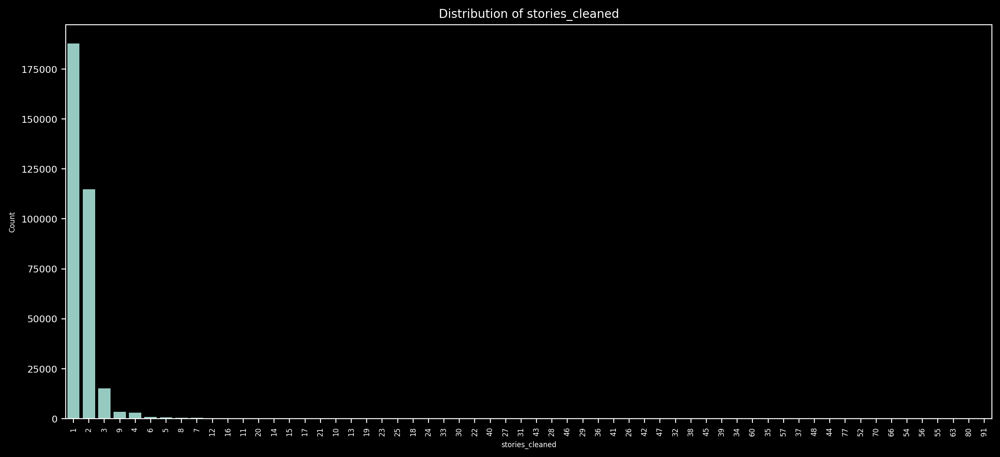

In [ ]:
analyze_feature(df,'stories_cleaned')

In [ ]:
df.stories_cleaned = df.stories_cleaned.astype(float)

In [ ]:
# Define the bins and labels
bins = [1, 2, 3, 4, 5, 10, float('inf')]
labels = ['1', '2', '3', '4', '5-10','above 10']

# Apply the bins to the min_distance_school column
df['stories_category'] = pd.cut(df['stories_cleaned'], bins=bins, labels=labels, right=False)

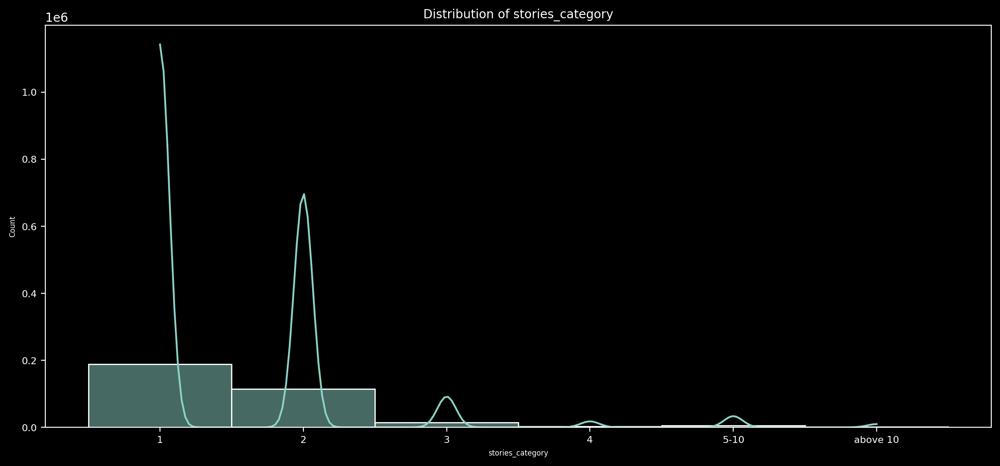

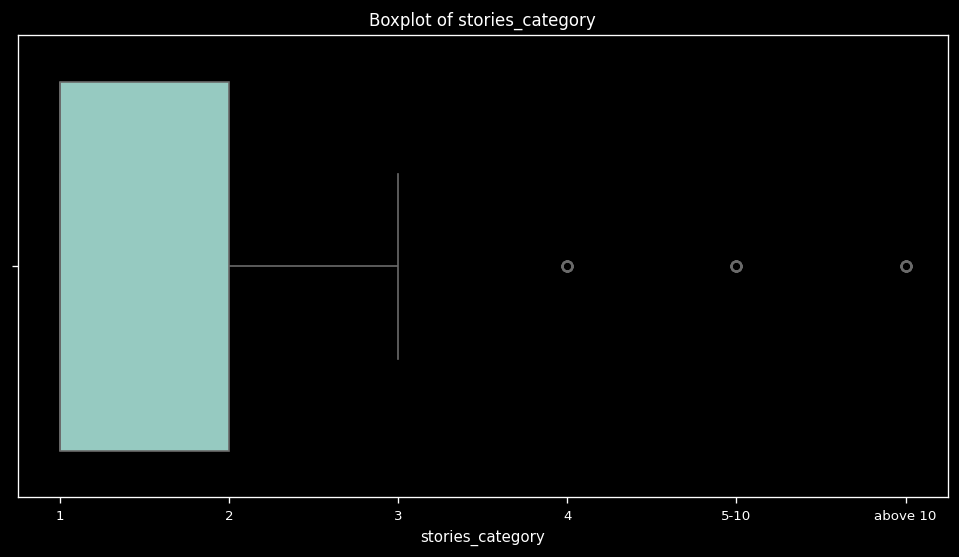

In [ ]:
analyze_feature(df,'stories_category')

I think we will use the data from the obtained floor categories for the model.

In [ ]:
df.state.value_counts()

state
FL       98786
TX       74352
NY       22072
CA       20823
NC       17839
TN       14971
WA       11958
OH       11305
IL        7987
NV        7306
CO        5829
other     5580
GA        5463
PA        4769
MI        4657
DC        4407
AZ        3188
IN        2673
OR        2414
MA        1438
Name: count, dtype: int64

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 327817 entries, 0 to 345042
Data columns (total 24 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   fireplace             327817 non-null  object  
 1   city                  327817 non-null  object  
 2   zipcode               327817 non-null  object  
 3   state                 327817 non-null  object  
 4   stories               211789 non-null  object  
 5   mls-id                23584 non-null   object  
 6   MlsId                 263462 non-null  object  
 7   target                325405 non-null  object  
 8   status_category       327817 non-null  object  
 9   PrivatePoolStatus     327817 non-null  object  
 10  propertyTypeGroup     327817 non-null  object  
 11  bathCleaned           327817 non-null  object  
 12  bedsCleaned           327817 non-null  object  
 13  year_built            327817 non-null  object  
 14  remodeled_year        327817 non-null  ob

In [ ]:
# drop old feature
df.drop(['stories'], axis=1, inplace=True)
df.drop(['stories_cleaned'], axis=1, inplace=True)

<a id = '3.15'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.15 mls-id, MlsId

</strong></p> 

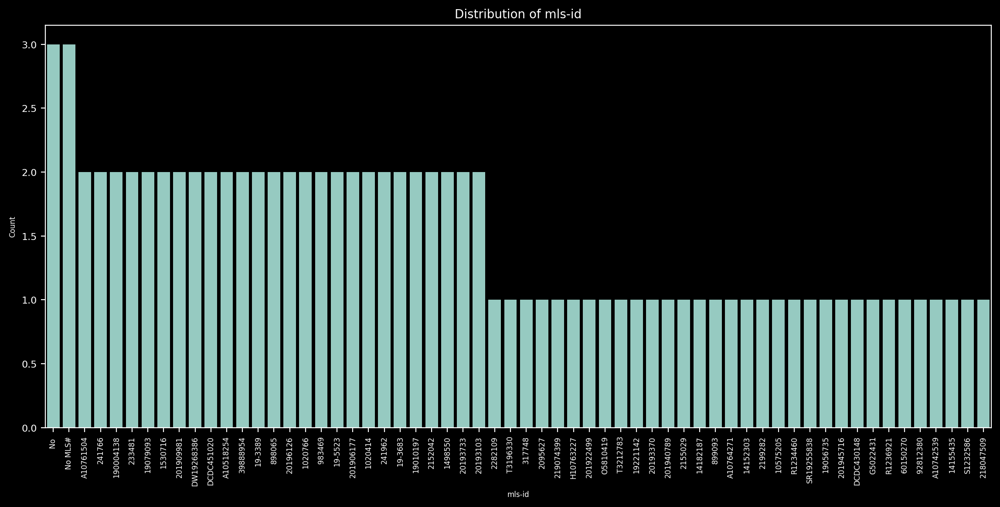

In [ ]:
analyze_feature(df,'mls-id')

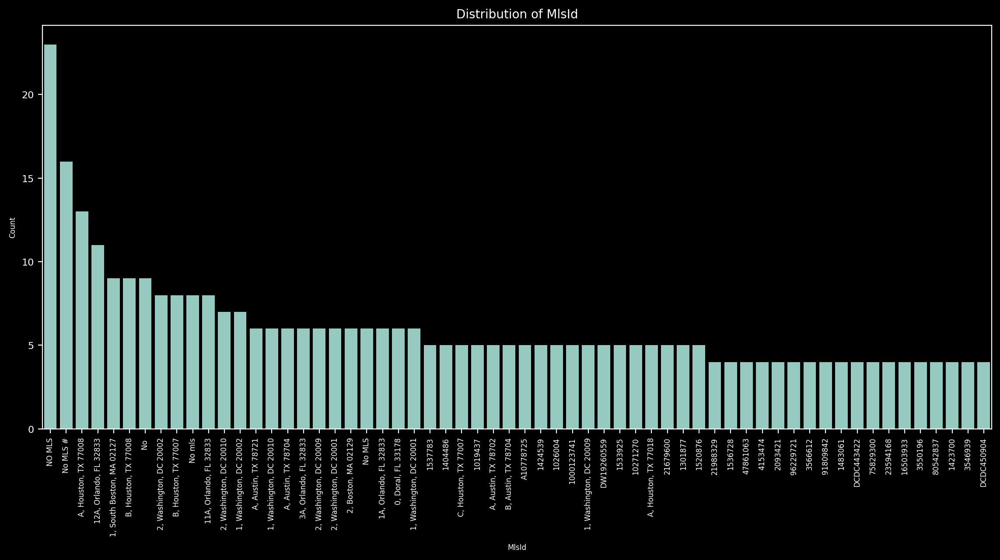

In [ ]:
analyze_feature(df,'MlsId')

After a brief analysis, I found that this feature is too chaotic and holds no value for us, so we will remove it.

In [ ]:
# drop features
df.drop(['mls-id'], axis=1, inplace=True)
df.drop(['MlsId'], axis=1, inplace=True)

<a id = '3.16'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 3.16 Target

</strong></p>

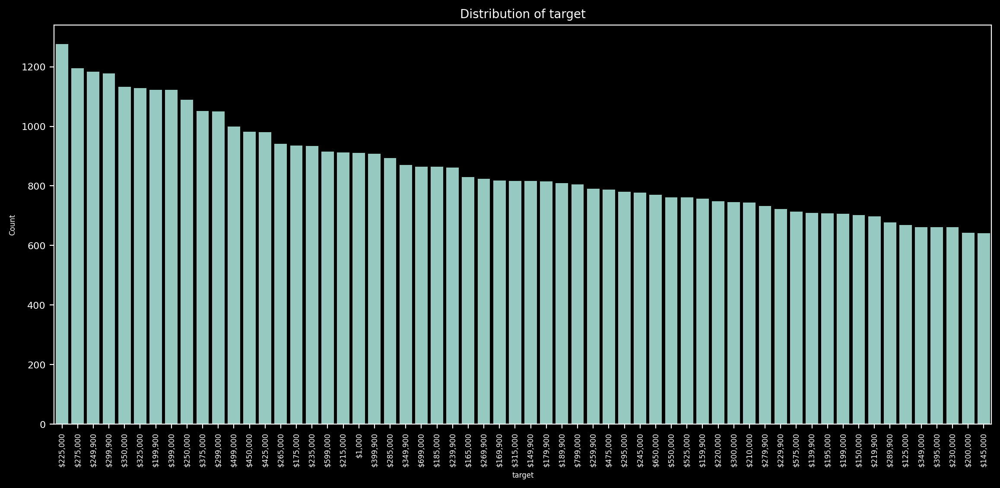

In [ ]:
analyze_feature(df, 'target')

In [ ]:
df[df['target'].notna() & df['target'].str.contains(r'\/m')]

,fireplace,city,zipcode,state,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned,stories_category
512,yes,chicago,60618,IL,"$5,500/mo",For Rent,No,Single-Family Home,3.5,4.0,1913,no,gas,no data,garage,0,up to 0.5,3,24.125381,1
573,yes,other,2116,MA,"$10,500/mo",For Rent,No,Multi-Family Home,2.0,2.0,1985,no,no data,no data,0,0,above 5,3,19.959351,2
1917,no,fort lauderdale,33308,FL,"$6,390/mo",For Rent,Yes,Single-Family Home,4.0,4.0,1965,no,no data,no data,0,0,1 to 2,3,22.089862,1
2777,no,other,37040,TN,"$1,200/mo",For Rent,No,Multi-Family Home,2.5,2.0,2014,no,electric,no data,0,0,0.5 to 1,3,18.490767,2
3338,no,chicago,60611,IL,"$3,600/mo",For Rent,Yes,Multi-Family Home,2.0,2.0,2003,no,no data,no data,garage,0,0.5 to 1,2,19.249566,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
340088,no,el paso,79925,TX,$890/mo,For Rent,No,Multi-Family Home,1.5,2.0,1985,no,gas,no data,0,0,1 to 2,3,17.462142,2
340690,no,other,77375,TX,"$2,500/mo",For Rent,No,Townhouse,2.5,3.0,2014,no,gas,no data,garage,0,2 to 5,3,22.589725,2
342371,yes,fort worth,76131,TX,"$2,000/mo",For Rent,No,Single-Family Home,2.0,4.0,2016,no,no data,no data,0,0,1 to 2,3,20.990937,1
343534,no,philadelphia,19121,PA,"$1,500/mo",For Rent,No,Townhouse,no data,2.0,1920,no,electric,no data,0,0,up to 0.5,2,15.630069,2


I see we have a "For Rent" category with a small number of entries. We will remove these entries.

In [ ]:
df = df[df.status_category != 'For Rent']

In [ ]:
def clean_to_number(value):
    """
    Convert a string containing numbers and special characters to a numeric value.
    
    Parameters:
    value (str): The input string with numbers and special characters.
    
    Returns:
    float: The cleaned numeric value.
    """
    if isinstance(value, str):
        # Remove all non-numeric characters except for the decimal point
        value = re.sub(r'[^\d.]', '', value)
        # Convert to float
        try:
            return float(value)
        except ValueError:
            return None
    return None

In [ ]:
df['target_cleaned'] = df.target.apply(clean_to_number)

In [ ]:
df.target_cleaned.isna().sum()

2412

We have some missing records. Its not a lot and we will delete it

In [ ]:
df = df[df.target_cleaned.notna()]

In [ ]:
df.target_cleaned = df.target_cleaned.astype(str)

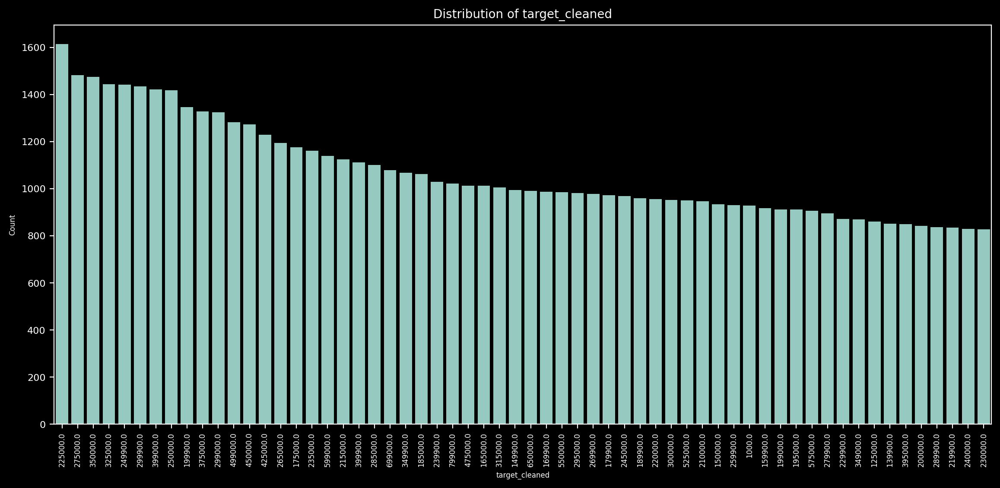

In [ ]:
analyze_feature(df,'target_cleaned')

It is evident that we have some outliers, as there are prices of 1 and 1000. Let's check the data for outliers and test for normality.

In [ ]:
df.target_cleaned = df.target_cleaned.astype(float)

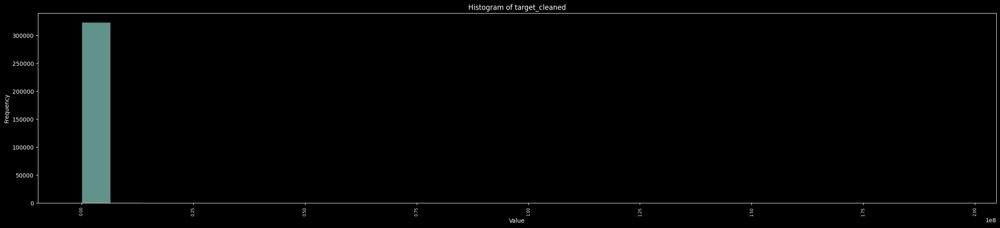

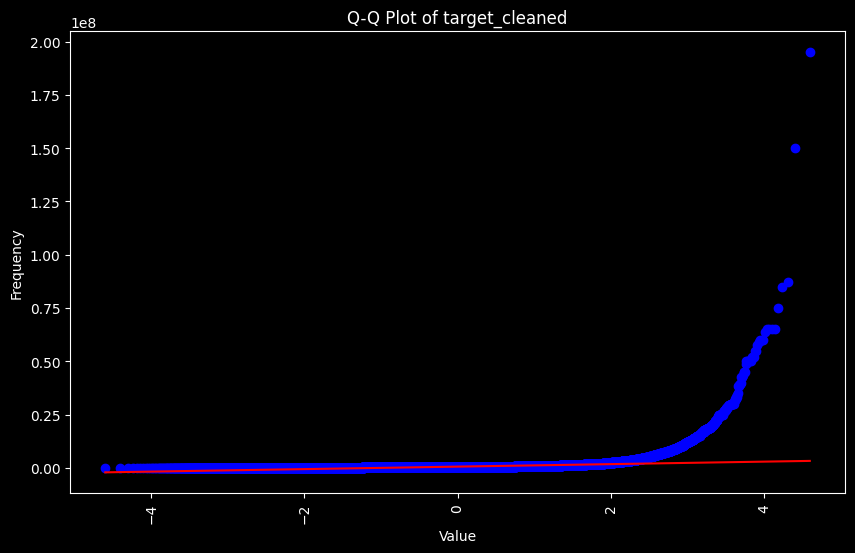

In [ ]:
plot_histogram_qq(df,'target_cleaned','price', 'Value','Frequency')

I see that we have some records with parice less tna 1000 USD. I think that better to delete it

In [ ]:
df[df.target_cleaned<1000]

,fireplace,city,zipcode,state,target,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned,bedsCleaned,...,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned,stories_category,target_cleaned
13752,no,jacksonville,32254,FL,$900,Other,No,Single-Family Home,no data,no data,...,no,air,central,other,0,0.5 to 1,3,20.312701,1,900.0
14247,no,other,37072,TN,$1,Active,No,Single-Family Home,2.0,3.0,...,no,other,no data,other,87120,up to 0.5,above 5,19.694204,1,1.0
23240,yes,indianapolis,46224,IN,$1,Other,No,Single-Family Home,1.0,3.0,...,yes,other,central,garage,23522,up to 0.5,3,19.659054,1,1.0
46693,no,other,12206,NY,$600,Closed,No,Single-Family Home,2.0,no data,...,no,no data,no data,0,1960,up to 0.5,3,18.972054,1,600.0
67401,no,other,13208,NY,$500,Closed,No,Other/Various Styles,no data,no data,...,no,no data,no data,0,0,up to 0.5,3,20.312701,1,500.0
100888,no,other,33018,FL,20,Active,No,Other/Various Styles,no data,no data,...,no,no data,no data,0,94525,1 to 2,above 5,20.312701,1,20.0
113799,no,other,33158,FL,$800,Other,No,Other/Various Styles,no data,no data,...,no,no data,no data,0,0,1 to 2,2,20.312701,1,800.0
114871,no,other,12210,NY,$600,Closed,No,Single-Family Home,other,no data,...,no,no data,no data,0,2000,up to 0.5,3,20.312701,1,600.0
122198,no,other,33169,FL,$750,Other,No,Other/Various Styles,no data,no data,...,no,no data,no data,0,0,1 to 2,2,20.312701,1,750.0
123877,no,other,33158,FL,29,Active,No,Other/Various Styles,2.5,no data,...,no,no data,no data,0,0,above 5,3,20.312701,1,29.0


In [ ]:
df = df[df.target_cleaned>1000]

In [ ]:
outliers_indices = check_outliers(df, 'target_cleaned')

Outliers identified using Z-Score:
130        8095000.0
209       15000000.0
260        5895000.0
316        6449000.0
631        4975000.0
             ...    
344378    15000000.0
344573     4599000.0
344797     8900000.0
344901     6990000.0
344929     5500000.0
Name: target_cleaned, Length: 2783, dtype: float64
Number of outliers using Z-Score: 2783
Outliers identified using IQR:
2         2895000.0
14        1650000.0
16        2650000.0
29        1195000.0
48        1780000.0
            ...    
344982    1150000.0
344994    1090000.0
345016    2695000.0
345024    1450000.0
345038    1249000.0
Name: target_cleaned, Length: 28414, dtype: float64
Number of outliers using IQR: 28414


In [ ]:
# Combine indices from both Z-Score and IQR methods
combined_outliers_indices = list(set(outliers_indices['z_score'] + outliers_indices['iqr']))

df = remove_outliers(df, combined_outliers_indices)

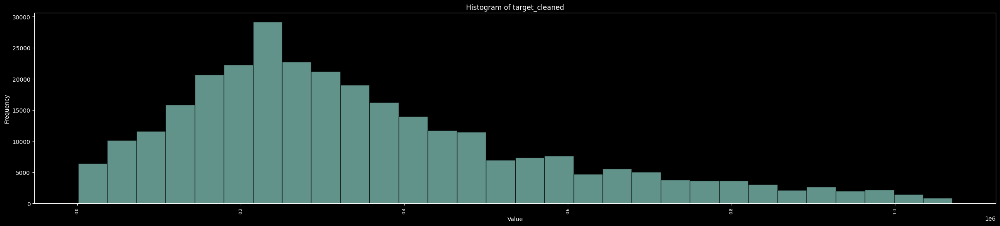

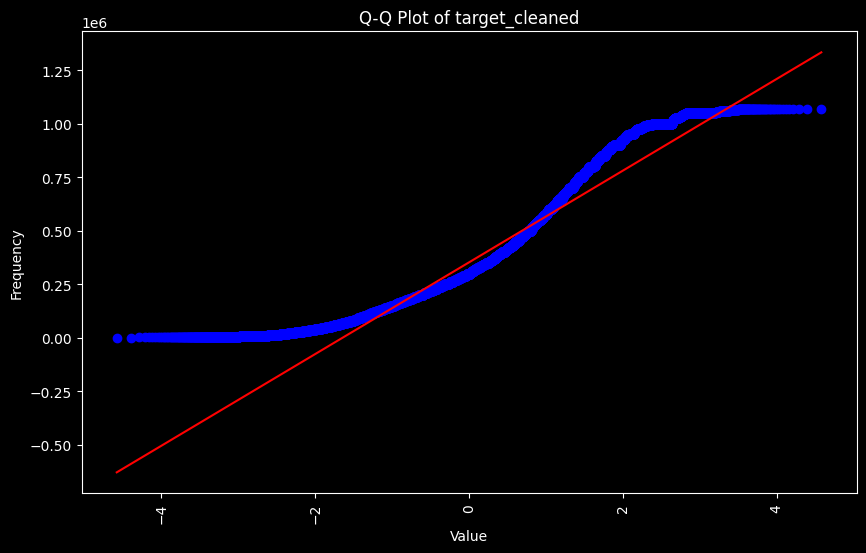

In [ ]:
plot_histogram_qq(df,'target_cleaned','price', 'Value','Frequency')

After removing the outliers, the situation looks better.

In [ ]:
df.target_cleaned.describe()

count    2.956260e+05
mean     3.520588e+05
std      2.220997e+05
min      1.100000e+03
25%      1.939000e+05
50%      2.999000e+05
75%      4.650000e+05
max      1.070000e+06
Name: target_cleaned, dtype: float64

In [ ]:
check_normality(df, 'target_cleaned')

Kolmogorov-Smirnov test: Statistic=0.10457188730720424, p-value=0.0
Anderson-Darling test: Statistic=6095.1787051606225
Significance level: 15.0%, Critical value: 0.576
Significance level: 10.0%, Critical value: 0.656
Significance level: 5.0%, Critical value: 0.787
Significance level: 2.5%, Critical value: 0.918
Significance level: 1.0%, Critical value: 1.092
Lilliefors test statistic: 0.10457188105889592, p-value: 0.0009999999999998899


{'Lilliefors': {'statistic': 0.10457188105889592,
  'p-value': 0.0009999999999998899}}

### Analysis of Normality Test Results:

#### **1. Kolmogorov-Smirnov Test:**
- **Test Statistic:** 0.1046
- **p-value:** 0.0

The Kolmogorov-Smirnov test checks the hypothesis that the data follow a specified distribution (in this case, a normal distribution).

- **Test Statistic (0.1046):** This value indicates the maximum deviation of the empirical distribution function of the data from the cumulative distribution function of the specified distribution.
- **p-value (0.0):** A very low p-value (less than 0.05) indicates that the hypothesis of normality is rejected.

#### **2. Anderson-Darling Test:**
- **Test Statistic:** 6095.18

The Anderson-Darling test checks if a sample follows a specified distribution (in this case, a normal distribution).

- **Test Statistic (6095.18):** This value is compared to critical values at various significance levels. The higher the statistic, the greater the deviation from normality.
- **Critical Values:**
  - **Significance level 15.0%:** 0.576
  - **Significance level 10.0%:** 0.656
  - **Significance level 5.0%:** 0.787
  - **Significance level 2.5%:** 0.918
  - **Significance level 1.0%:** 1.092

Since the test statistic (6095.18) significantly exceeds all critical values, the hypothesis of normality is rejected.

#### **3. Lilliefors Test:**
- **Test Statistic:** 0.1046
- **p-value:** 0.001

The Lilliefors test is a modification of the Kolmogorov-Smirnov test for checking normality.

- **Test Statistic (0.1046):** This value indicates the maximum deviation of the empirical distribution function of the data from a normal distribution.
- **p-value (0.001):** A very low p-value (less than 0.05) indicates that the hypothesis of normality is rejected.

### Overall Conclusions:
1. **Kolmogorov-Smirnov Test:** Showed significant deviation from normality, hypothesis of normality is rejected.
2. **Anderson-Darling Test:** Test statistic significantly exceeds all critical values, indicating strong deviation from normality.
3. **Lilliefors Test:** Showed significant deviation from normality, hypothesis of normality is rejected.



In [ ]:
# drop features
df.drop(['target'], axis=1, inplace=True)


Finally will check for duplicates

In [ ]:
df.duplicated().any()

True

In [ ]:
df[df.duplicated()]

,fireplace,city,zipcode,state,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned,stories_category,target_cleaned
4094,no,san antonio,78261,TX,Other,No,Single-Family Home,3.0,3.0,2019,no,gas,central,2,5357,2 to 5,3,21.671197,2,279000.0
5384,no,other,11420,NY,For Sale,No,Condominium/Apartment,3.0,3.0,1940,no,no data,no data,0,2800,up to 0.5,3,18.254253,2,615000.0
7521,no,other,33411,FL,For Sale,No,Single-Family Home,2.0,2.0,2004,no,air,central,garage,3498,1 to 2,3,18.403021,1,235000.0
12009,no,houston,77085,TX,Active,No,Other/Various Styles,no data,no data,1985,no,no data,no data,0,0,1 to 2,3,20.312701,1,50000.0
12016,no,charlotte,28214,NC,Active,No,Condominium/Apartment,2.5,4.0,2019,no,pump,other,garage,0,0.5 to 1,above 5,20.063463,2,210900.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
344696,no,other,34609,FL,For Sale,Yes,Single-Family Home,2.0,3.0,1985,no,no data,no data,0,0,2 to 5,3,20.500626,1,221990.0
344725,no,other,33314,FL,For Sale,No,Condominium/Apartment,2.0,2.0,1999,no,electric,central,1,0,up to 0.5,3,18.075781,2,190000.0
344762,yes,other,30328,GA,For Sale,No,Single-Family Home,4.0,4.0,1983,no,air,central,2,13068,0.5 to 1,3,24.443102,2,474900.0
344804,yes,other,98155,WA,For Sale,No,Single-Family Home,2.0,3.0,1947,no,air,no data,other,8184,up to 0.5,3,17.265974,1,490000.0


Will remove duplicates

In [ ]:
df = df[~df.duplicated()]

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 291592 entries, 0 to 345042
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype   
---  ------                --------------   -----   
 0   fireplace             291592 non-null  object  
 1   city                  291592 non-null  object  
 2   zipcode               291592 non-null  object  
 3   state                 291592 non-null  object  
 4   status_category       291592 non-null  object  
 5   PrivatePoolStatus     291592 non-null  object  
 6   propertyTypeGroup     291592 non-null  object  
 7   bathCleaned           291592 non-null  object  
 8   bedsCleaned           291592 non-null  object  
 9   year_built            291592 non-null  object  
 10  remodeled_year        291592 non-null  object  
 11  heating_info_cleaned  291592 non-null  object  
 12  cooling_info_cleaned  291592 non-null  object  
 13  parkingCleaned        291592 non-null  object  
 14  lotsize_info_cleaned  291592 non-null  in

In [ ]:

#Save data
df.to_csv('data/cleaned_data.csv', index = False)


<a id='4'></a>
<p style = "background-color : DarkGreen; border-radius: 5px 5px; padding : 10px"><strong>

# 4. Feature Selection
</strong></p>

In [ ]:
df_final = pd.read_csv('data/cleaned_data.csv')
df_temp = pd.read_csv('data/cleaned_data.csv')
df_final.head(3)

,fireplace,city,zipcode,state,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned,stories_category,target_cleaned
0,yes,other,28387,NC,Active,No,Single-Family Home,3.5,4.0,2019,no,pump,no data,0,0,2 to 5,above 5,23.281160,1,418000.0
1,no,other,99216,WA,For Sale,No,Single-Family Home,3.0,3.0,2019,no,no data,no data,0,5828,1 to 2,3,20.832981,2,310000.0
2,no,philadelphia,19145,PA,For Sale,No,Townhouse,no data,2.0,1920,no,air,central,0,680,above 5,3,16.677652,2,209000.0


In [ ]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291592 entries, 0 to 291591
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   fireplace             291592 non-null  object 
 1   city                  291592 non-null  object 
 2   zipcode               291592 non-null  int64  
 3   state                 291592 non-null  object 
 4   status_category       291592 non-null  object 
 5   PrivatePoolStatus     291592 non-null  object 
 6   propertyTypeGroup     291592 non-null  object 
 7   bathCleaned           291592 non-null  object 
 8   bedsCleaned           291592 non-null  object 
 9   year_built            291592 non-null  int64  
 10  remodeled_year        291592 non-null  object 
 11  heating_info_cleaned  291592 non-null  object 
 12  cooling_info_cleaned  291592 non-null  object 
 13  parkingCleaned        291592 non-null  object 
 14  lotsize_info_cleaned  291592 non-null  int64  
 15  

We perform label encoding to convert categorical variables into numerical values, which is necessary for most machine learning algorithms that require numerical input. By transforming these categorical features into numerical labels, we enable the model to process and learn from these features

In [ ]:
# Initialize the label encoder
le = LabelEncoder()

# Apply label encoding to each categorical column
for col in ['fireplace', 'city', 'zipcode', 'state', 'status_category','PrivatePoolStatus','propertyTypeGroup','bathCleaned', 'bedsCleaned', 'year_built','remodeled_year', 'heating_info_cleaned', 'cooling_info_cleaned', 'parkingCleaned', 'distance_category', 'num_schools_category','stories_category']:
    df_final[col] = le.fit_transform(df_final[col])

In [ ]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291592 entries, 0 to 291591
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   fireplace             291592 non-null  int32  
 1   city                  291592 non-null  int32  
 2   zipcode               291592 non-null  int64  
 3   state                 291592 non-null  int32  
 4   status_category       291592 non-null  int32  
 5   PrivatePoolStatus     291592 non-null  int32  
 6   propertyTypeGroup     291592 non-null  int32  
 7   bathCleaned           291592 non-null  int32  
 8   bedsCleaned           291592 non-null  int32  
 9   year_built            291592 non-null  int64  
 10  remodeled_year        291592 non-null  int32  
 11  heating_info_cleaned  291592 non-null  int32  
 12  cooling_info_cleaned  291592 non-null  int32  
 13  parkingCleaned        291592 non-null  int32  
 14  lotsize_info_cleaned  291592 non-null  int64  
 15  

In [ ]:

# Function to plot a correlation heatmap
def show_corr_heatmap(df, columns_list, title, method):
    """
    Plots a correlation heatmap.
    
    Parameters:
    columns_list (list): List of columns to include in the heatmap.
    title (str): Title of the heatmap.
    method (str): Correlation method ('pearson', 'spearman', or 'kendall').
    
    Returns:
    None
    """
    # Create a figure and axis for the heatmap
    fig_, ax_ = plt.subplots(figsize=(15, 12))
    
    # Calculate the correlation matrix
    corr = df[columns_list].corr(method=method).abs()
    
    # Create a mask for the upper triangle
    mask = np.triu(np.ones_like(corr, dtype=bool))
    
    # Plot the heatmap
    sns.heatmap(corr, 
                annot=True,  # Show the correlation values
                annot_kws={"fontsize": 9},  # Font size for annotations
                linewidths=0.1,  # Line width between cells
                ax=ax_,  # Axis to plot on
                mask=mask,  # Apply the mask to the heatmap
                cmap='GnBu',  # Color map to use
                fmt='.2f')  # Format for the annotation text
    
    # Set the title of the heatmap
    ax_.set_title(title, fontsize=18)
    
    # Display the heatmap
    plt.show()



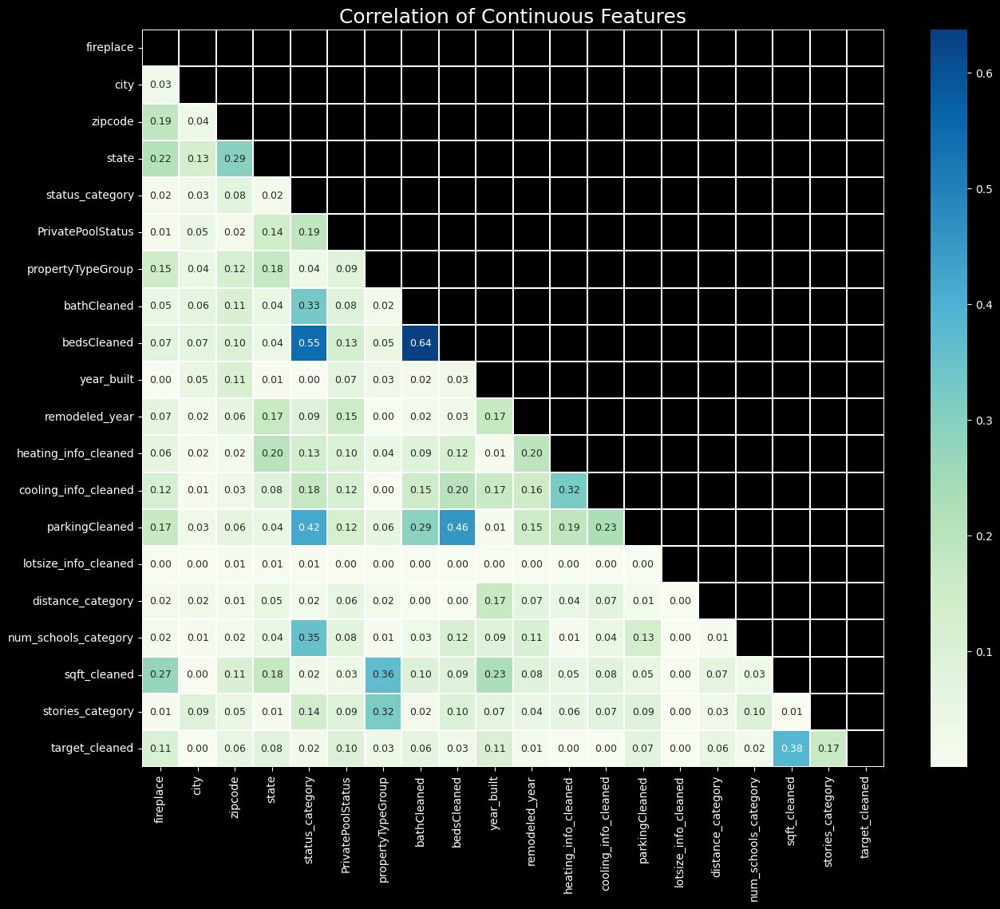

In [ ]:
show_corr_heatmap(df_final, df_final.columns, 'Correlation of Continuous Features', method='pearson');

### Summary of Correlation Analysis

We checked the correlation of continuous features using the Pearson method. Here are the key observations from the analysis:

- **Highly Correlated Features**: `bedsCleaned` and `bathCleaned`, `sqft_cleaned` and `bedsCleaned`, `zipcode` and `state`.
- **Moderately Correlated Features**: `propertyTypeGroup` and `sqft_cleaned`, `parkingCleaned` and `zipcode`.
- **Low Correlation Features**: `fireplace`, `city`, `status_category`, `PrivatePoolStatus`, `distance_category`.

At this point, we do not see any reason to remove these features based on the correlation analysis.

Considering that we have multiple categorical features and a dependent variable, we will conduct a multivariate ANOVA (MANOVA) to identify the influence of these features.

In [ ]:
# used features
formula = 'target_cleaned ~ fireplace + city + zipcode + state + status_category + PrivatePoolStatus + propertyTypeGroup + bathCleaned + bedsCleaned + year_built + remodeled_year + heating_info_cleaned + cooling_info_cleaned + parkingCleaned + lotsize_info_cleaned + distance_category + num_schools_category + sqft_cleaned + stories_category'

# Anova model creation and implementation
model = ols(formula, data=df_final).fit()
anova_table = sm.stats.anova_lm(model, typ=2)

print(anova_table)

                            sum_sq        df             F         PR(>F)
fireplace             1.342382e+13       1.0    356.531261   1.788391e-79
city                  4.081614e+10       1.0      1.084060   2.977918e-01
zipcode               6.521261e+13       1.0   1732.020669   0.000000e+00
state                 2.990536e+14       1.0   7942.745102   0.000000e+00
status_category       1.370644e+11       1.0      3.640375   5.639522e-02
PrivatePoolStatus     1.814538e+13       1.0    481.934080  9.900212e-107
propertyTypeGroup     2.147235e+14       1.0   5702.971335   0.000000e+00
bathCleaned           1.510117e+13       1.0    401.080994   3.679274e-89
bedsCleaned           3.573951e+11       1.0      9.492271   2.063584e-03
year_built            4.449168e+12       1.0    118.168119   1.612480e-27
remodeled_year        1.749463e+13       1.0    464.650349  5.630686e-103
heating_info_cleaned  1.788115e+12       1.0     47.491619   5.535098e-12
cooling_info_cleaned  5.879496e+13    

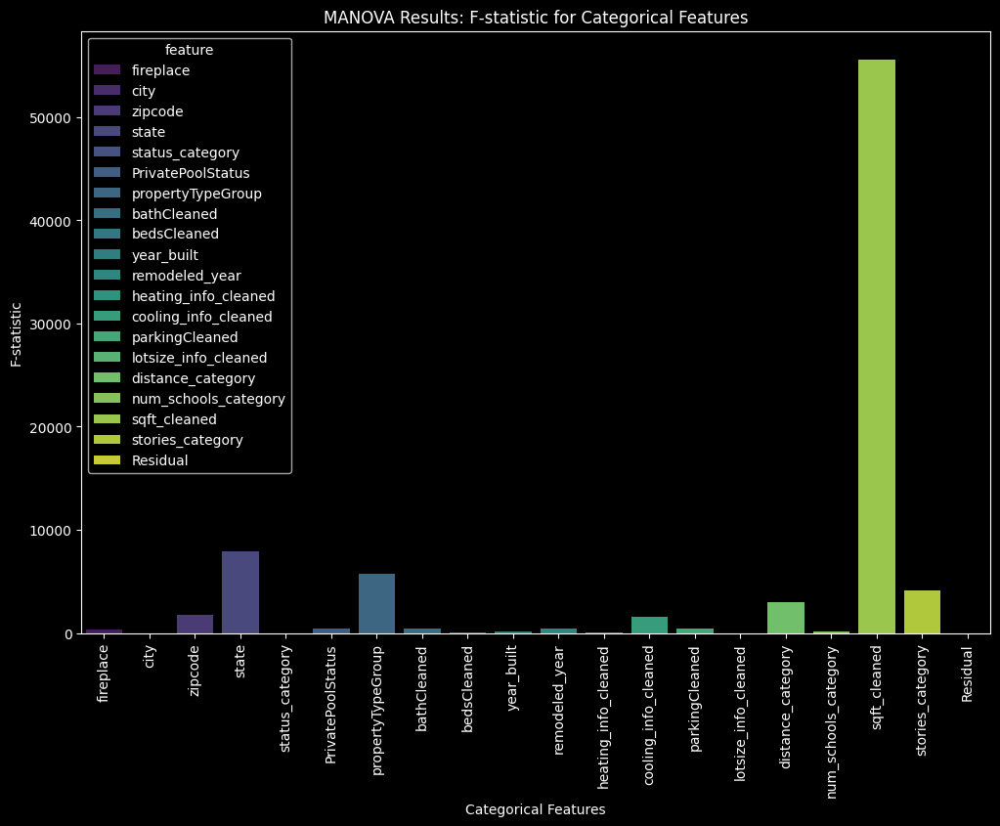

In [ ]:
anova_table['feature'] = anova_table.index
anova_table = anova_table.reset_index(drop=True)

# Визуализация результатов ANOVA
plt.figure(figsize=(12, 8))
sns.barplot(x='feature', y='F', data=anova_table, palette='viridis', hue = 'feature', legend=True)
plt.xticks(rotation=90)
plt.xlabel('Categorical Features')
plt.ylabel('F-statistic')
plt.title('MANOVA Results: F-statistic for Categorical Features')
plt.show()

At this point, we will not remove any features and will proceed with training on the current dataset.

In [ ]:
# df_final = df_final.drop(['lotsize_info_cleaned','city','status_category'], axis=1)

In [ ]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 291592 entries, 0 to 291591
Data columns (total 20 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   fireplace             291592 non-null  int32  
 1   city                  291592 non-null  int32  
 2   zipcode               291592 non-null  int64  
 3   state                 291592 non-null  int32  
 4   status_category       291592 non-null  int32  
 5   PrivatePoolStatus     291592 non-null  int32  
 6   propertyTypeGroup     291592 non-null  int32  
 7   bathCleaned           291592 non-null  int32  
 8   bedsCleaned           291592 non-null  int32  
 9   year_built            291592 non-null  int64  
 10  remodeled_year        291592 non-null  int32  
 11  heating_info_cleaned  291592 non-null  int32  
 12  cooling_info_cleaned  291592 non-null  int32  
 13  parkingCleaned        291592 non-null  int32  
 14  lotsize_info_cleaned  291592 non-null  int64  
 15  

In [ ]:
y = df_final.target_cleaned.values
X = df_final.drop(['target_cleaned'], axis = 1)
X_train_init, X_test_init, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=RANDOM_STATE)

In [ ]:
X.shape, X_train_init.shape, X_test_init.shape

((291592, 19), (204114, 19), (87478, 19))

We will use StandardScaler for linear-based models, while for other models, we will use the original dataset. Since we have already removed outliers, RobustScaler is not necessary.

In [ ]:
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train_init)
X_test = scaler.fit_transform(X_test_init)
df_standard_train_scaled = pd.DataFrame(X_train, columns=df_final.drop(['target_cleaned'], axis = 1).columns)
df_standard_test_scaled = pd.DataFrame(X_test, columns=df_final.drop(['target_cleaned'], axis = 1).columns)


In [ ]:
X_train = X_train_init
X_test = X_test_init

In [ ]:
df_standard_train_scaled

,fireplace,city,zipcode,state,status_category,PrivatePoolStatus,propertyTypeGroup,bathCleaned,bedsCleaned,year_built,remodeled_year,heating_info_cleaned,cooling_info_cleaned,parkingCleaned,lotsize_info_cleaned,distance_category,num_schools_category,sqft_cleaned,stories_category
0,-0.616969,0.512987,0.459229,1.167068,0.426613,-0.354952,0.551426,-0.753655,-0.586151,1.251501,-0.881778,-1.002800,0.937945,0.848898,-0.012890,0.047880,-0.167072,0.127303,-0.676807
1,-0.616969,0.512987,-0.619514,-0.959230,-1.489405,-0.354952,-0.314819,-1.147905,1.704568,-0.335035,1.134073,0.870512,0.937945,-1.048565,-0.013041,-1.130796,-0.167072,-0.751766,-0.676807
2,1.620827,-1.022243,0.597324,1.167068,1.193020,-0.354952,0.551426,-0.753655,-0.204364,0.960097,-0.881778,-1.002800,-0.728375,0.216410,-0.012909,-1.130796,-1.735687,0.688101,-0.676807
3,-0.616969,-0.101105,-0.701570,-0.959230,1.193020,-0.354952,-2.047307,-0.753655,-1.349724,1.219123,-0.881778,-1.002800,-0.728375,1.481385,-0.014358,-0.541458,-1.735687,-1.052638,0.582257
4,-0.616969,0.512987,-0.438389,-0.959230,0.426613,2.817283,0.551426,-0.162280,-0.586151,0.798205,1.134073,-1.002800,-0.728375,0.848898,-0.012273,-0.541458,1.401543,0.616160,-0.676807
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204109,-0.616969,0.512987,-0.540459,-0.959230,0.426613,-0.354952,0.551426,-0.162280,-0.204364,0.150639,-0.881778,0.870512,0.937945,-1.048565,-0.012202,0.047880,-0.167072,0.856708,-0.676807
204110,-0.616969,0.512987,-0.710576,-0.959230,0.426613,2.817283,0.551426,-0.359405,-0.967937,0.150639,-0.881778,0.870512,0.937945,-1.048565,-0.014358,0.047880,1.401543,0.745978,-0.676807
204111,-0.616969,-1.841031,0.272100,-0.632107,0.426613,-0.354952,-2.047307,1.611844,-0.586151,-1.824437,-0.881778,-1.002800,-0.728375,-1.048565,-0.014358,1.226556,-0.167072,-0.652262,1.841322
204112,-0.616969,1.229427,-0.567478,-0.959230,1.193020,2.817283,-2.047307,-0.753655,-0.967937,-0.076009,1.134073,0.402184,-0.728375,-0.416078,-0.014358,-0.541458,-0.167072,-1.005147,1.841322


In [ ]:
print(X_train.shape)
print(X_test.shape)

(204114, 19)
(87478, 19)


<a id='5'></a>
<p style = "background-color : DarkGreen; border-radius: 5px 5px; padding : 10px"><strong>

# 5. Model training and prediction
</strong></p>

<a id = '5.1'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.1 Linear Regression

</strong></p>

In [ ]:
lr = linear_model.LinearRegression()
# train model
lr.fit(X_train, y_train)
# make prediction
y_train_predict = lr.predict(X_train)
y_test_predict = lr.predict(X_test)

In [ ]:
linear_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("Linear Regression metrics:", linear_results)
df_results = add_row_to_df(df_results, linear_results, "Linear Regression")

Linear Regression metrics: {'MAE': 146932.70537426797, 'MAPE': 106.63049462849324, 'R2': 0.23629018413506941, 'MAE_TEST': 146165.84662377476, 'MAPE_TEST': 104.20830972952959, 'R2_TEST': 0.2336631384730954}


Linear regression showed very poor results. I don't believe hyperparameter tuning will significantly improve the situation. However, let's try Lasso and Ridge regression models.

<a id = '5.2'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.2 Ridge

</strong></p>

In [ ]:
ridge = Ridge(alpha=1.0)  # Параметр alpha контролирует степень регуляризации
ridge.fit(X_train, y_train)

y_train_predict = ridge.predict(X_train)
y_test_predict = ridge.predict(X_test)

In [ ]:
ridge_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("Ridge metrics:", ridge_results)
df_results = add_row_to_df(df_results, ridge_results, "Ridge")

Ridge metrics: {'MAE': 146932.71172773853, 'MAPE': 106.63053762874817, 'R2': 0.23629018412948966, 'MAE_TEST': 146165.85221619054, 'MAPE_TEST': 104.20835165923886, 'R2_TEST': 0.23366314359642193}


<a id = '5.3'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.3 Lasso

</strong></p>

In [ ]:
lasso = Lasso()
param_grid = {'alpha': [0.01, 0.1, 1.0, 10.0]}
lasso_cv = GridSearchCV(lasso, param_grid, cv=5)
lasso_cv.fit(X_train, y_train)

# Лучшее значение alpha
print("Best alpha for Lasso:", lasso_cv.best_params_)

# Предсказания с использованием наилучшей модели
y_train_predict = lasso_cv.predict(X_train)
y_test_predict = lasso_cv.predict(X_test)


Best alpha for Lasso: {'alpha': 1.0}


In [ ]:
lasso_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("Lasso metrics:", lasso_results)
df_results = add_row_to_df(df_results, lasso_results, "Lasso")

Lasso metrics: {'MAE': 146932.73684241847, 'MAPE': 106.63084789899133, 'R2': 0.2362901836290705, 'MAE_TEST': 146165.8719054173, 'MAPE_TEST': 104.20865350807193, 'R2_TEST': 0.2336631416110586}


As I suspected, neither Lasso nor Ridge significantly improved the situation. Therefore, let's move on to regression models.

Let's revert to the previous data, without using StandardScaler. For regression models, it is not necessary.

In [ ]:
X_train = X_train_init
X_test = X_test_init

<a id = '5.4'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.4 RandomForestRegressor

</strong></p>

In this model and the subsequent ones, I will use Optuna for hyperparameter tuning.

RandomForest turned out to be quite CPU-intensive, so I reduced the tuning process to 10 steps. This is not ideal, but it saves time. Considering that we will not be using this work in a real production environment but only for educational purposes, I think this is an acceptable approach.

In [ ]:
# Define the objective function
def objective(trial):
    n_estimators = trial.suggest_int('n_estimators', 500, 1500)
    max_depth = trial.suggest_int('max_depth', 3, 50)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 5)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 3)
    max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None])
    
    # Define the model with suggested hyperparameters
    model = RandomForestRegressor(
        n_estimators=n_estimators,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        max_features=max_features,
        random_state=RANDOM_STATE,
        n_jobs=-1
    )
    
    # Use a robust cross-validation strategy
    cv = RepeatedKFold(n_splits=3, n_repeats=2, random_state=42)
    
    # Evaluate the model using cross-validation
    score = cross_val_score(model, X_train, y_train, cv=cv, scoring='neg_mean_absolute_error').mean()
    return score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=10)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
best_model = RandomForestRegressor(
    n_estimators=best_params['n_estimators'],
    max_depth=best_params['max_depth'],
    min_samples_split=best_params['min_samples_split'],
    min_samples_leaf=best_params['min_samples_leaf'],
    max_features=best_params['max_features'],
    random_state=42,
    n_jobs=-1
)
best_model.fit(X_train, y_train)

# Make final predictions and evaluate performance
y_train_predict = best_model.predict(X_train)
y_test_predict = best_model.predict(X_test)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
r2_difference = abs(train_r2 - test_r2)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")
print(f"Difference in R²: {r2_difference}")

[I 2024-07-21 20:28:28,363] A new study created in memory with name: no-name-eb89dcfc-ac51-412d-9e81-1d82fe07c9d6
[I 2024-07-21 20:33:45,027] Trial 0 finished with value: -66747.38149661747 and parameters: {'n_estimators': 801, 'max_depth': 40, 'min_samples_split': 5, 'min_samples_leaf': 2, 'max_features': None}. Best is trial 0 with value: -66747.38149661747.
[I 2024-07-21 20:35:46,979] Trial 1 finished with value: -128676.29635186864 and parameters: {'n_estimators': 986, 'max_depth': 5, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': None}. Best is trial 0 with value: -66747.38149661747.
[I 2024-07-21 20:36:30,586] Trial 2 finished with value: -91517.89951706084 and parameters: {'n_estimators': 851, 'max_depth': 14, 'min_samples_split': 5, 'min_samples_leaf': 1, 'max_features': 'sqrt'}. Best is trial 0 with value: -66747.38149661747.
[I 2024-07-21 20:37:19,782] Trial 3 finished with value: -81971.41080150154 and parameters: {'n_estimators': 768, 'max_depth': 18, 'min_s

Best parameters: {'n_estimators': 1325, 'max_depth': 31, 'min_samples_split': 2, 'min_samples_leaf': 2, 'max_features': None}
Train R²: 0.9464440866549888
Test R²: 0.8059038393850169
Difference in R²: 0.14054024726997194


In [ ]:
randomforest_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("Random Forest metrics:", randomforest_results)
df_results = add_row_to_df(df_results, randomforest_results, "Random Forest")

Random Forest metrics: {'MAE': 30402.061897909465, 'MAPE': 16.691646532449838, 'R2': 0.9464440866549888, 'MAE_TEST': 61676.856500171896, 'MAPE_TEST': 32.006955081855374, 'R2_TEST': 0.8059038393850169}


I also used a metric that not only looks for the maximum R² for both the test and training data but also aims for the smallest difference between the two. I am specifically interested in a balanced model that indicates the absence of overfitting.

<a id = '5.5'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.5 Catboost

</strong></p>

In [ ]:
# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    params = {
        'iterations': trial.suggest_int('iterations', 1000, 20000),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.1, log=True),
        'depth': trial.suggest_int('depth', 2, 10),
        'task_type': 'GPU',
        'devices': '0:1'
    }
    
    # Train the model
    model = CatBoostRegressor(**params, verbose=1)
    model.fit(X_train, y_train)
    
    # Make predictions and evaluate
    y_train_predict = model.predict(X_train)
    y_test_predict = model.predict(X_test)
    train_r2 = r2_score(y_train, y_train_predict)
    test_r2 = r2_score(y_test, y_test_predict)
    
    # Calculate the absolute difference in R²
    r2_difference = abs(train_r2 - test_r2)
    
    # Combine the metrics to maximize R² and minimize the difference
    combined_score = (train_r2 + test_r2) / 2 - r2_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=20)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
best_catmodel = CatBoostRegressor(**best_params, verbose=1)
best_catmodel.fit(X_train, y_train)

# Make final predictions and evaluate performance
y_train_predict = best_catmodel.predict(X_train)
y_test_predict = best_catmodel.predict(X_test)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
r2_difference = abs(train_r2 - test_r2)
combined_score = (train_r2 + test_r2) / 2 - r2_difference

print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")
print(f"Difference in R²: {r2_difference}")
print(f"Combined Score: {combined_score}")


[I 2024-07-21 20:50:52,961] A new study created in memory with name: no-name-2608781d-05ce-4623-a99f-eae52c2f48b7


0:	learn: 222217.3503636	total: 240ms	remaining: 50m 2s
1:	learn: 222209.3369859	total: 247ms	remaining: 25m 39s
2:	learn: 222201.3943426	total: 253ms	remaining: 17m 31s
3:	learn: 222193.4040647	total: 258ms	remaining: 13m 25s
4:	learn: 222185.3779853	total: 263ms	remaining: 10m 57s
5:	learn: 222177.4344854	total: 269ms	remaining: 9m 20s
6:	learn: 222169.5025406	total: 275ms	remaining: 8m 10s
7:	learn: 222161.5466337	total: 280ms	remaining: 7m 17s
8:	learn: 222153.5667625	total: 287ms	remaining: 6m 37s
9:	learn: 222145.6221251	total: 292ms	remaining: 6m 4s
10:	learn: 222137.6535224	total: 297ms	remaining: 5m 37s
11:	learn: 222129.7201570	total: 303ms	remaining: 5m 15s
12:	learn: 222121.6917764	total: 308ms	remaining: 4m 55s
13:	learn: 222113.7104732	total: 314ms	remaining: 4m 39s
14:	learn: 222105.8117796	total: 320ms	remaining: 4m 26s
15:	learn: 222097.8299058	total: 326ms	remaining: 4m 13s
16:	learn: 222089.9188042	total: 331ms	remaining: 4m 3s
17:	learn: 222081.9955771	total: 338ms	

[I 2024-07-21 20:52:20,454] Trial 0 finished with value: 0.36334423721534 and parameters: {'iterations': 12486, 'learning_rate': 0.00011357211525199763, 'depth': 5}. Best is trial 0 with value: 0.36334423721534.


0:	learn: 221851.1148617	total: 11.5ms	remaining: 1m 21s
1:	learn: 221474.5712247	total: 20.2ms	remaining: 1m 11s
2:	learn: 221098.0644000	total: 29.4ms	remaining: 1m 9s
3:	learn: 220726.6948208	total: 38.8ms	remaining: 1m 8s
4:	learn: 220360.7987993	total: 47.7ms	remaining: 1m 7s
5:	learn: 219995.4419901	total: 56.4ms	remaining: 1m 6s
6:	learn: 219631.7647814	total: 64.7ms	remaining: 1m 5s
7:	learn: 219264.8933082	total: 73.6ms	remaining: 1m 5s
8:	learn: 218908.4252672	total: 82ms	remaining: 1m 4s
9:	learn: 218554.3724870	total: 90.7ms	remaining: 1m 4s
10:	learn: 218198.2986947	total: 99.2ms	remaining: 1m 3s
11:	learn: 217843.6713276	total: 108ms	remaining: 1m 3s
12:	learn: 217485.5511087	total: 117ms	remaining: 1m 3s
13:	learn: 217134.4112698	total: 126ms	remaining: 1m 3s
14:	learn: 216787.1312063	total: 134ms	remaining: 1m 3s
15:	learn: 216441.4084295	total: 143ms	remaining: 1m 3s
16:	learn: 216097.3964729	total: 151ms	remaining: 1m 2s
17:	learn: 215755.6886826	total: 161ms	remainin

[I 2024-07-21 20:53:33,045] Trial 1 finished with value: 0.7091665512989809 and parameters: {'iterations': 7085, 'learning_rate': 0.004223961789278948, 'depth': 9}. Best is trial 1 with value: 0.7091665512989809.


0:	learn: 218867.6535589	total: 5.82ms	remaining: 1m 8s
1:	learn: 215730.6471752	total: 10.4ms	remaining: 1m 1s
2:	learn: 212823.2141338	total: 15.6ms	remaining: 1m 1s
3:	learn: 210226.1105924	total: 20ms	remaining: 59.3s
4:	learn: 207824.4097184	total: 24.5ms	remaining: 58s
5:	learn: 205522.2299770	total: 29.7ms	remaining: 58.6s
6:	learn: 203409.8201835	total: 34.2ms	remaining: 57.9s
7:	learn: 201480.1273635	total: 38.8ms	remaining: 57.4s
8:	learn: 199582.0763455	total: 43.4ms	remaining: 57s
9:	learn: 197832.5942612	total: 48.5ms	remaining: 57.4s
10:	learn: 196227.4381854	total: 53ms	remaining: 57.1s
11:	learn: 194707.3169209	total: 57.5ms	remaining: 56.7s
12:	learn: 193282.7490812	total: 62.8ms	remaining: 57.1s
13:	learn: 191950.4906746	total: 67.4ms	remaining: 56.9s
14:	learn: 190748.5657247	total: 72ms	remaining: 56.8s
15:	learn: 189613.8366035	total: 76.4ms	remaining: 56.5s
16:	learn: 188472.1431994	total: 81.5ms	remaining: 56.7s
17:	learn: 187481.1993458	total: 86ms	remaining: 56

[I 2024-07-21 20:54:43,487] Trial 2 finished with value: 0.7319722371439201 and parameters: {'iterations': 11844, 'learning_rate': 0.053718346521087194, 'depth': 4}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 222193.7947072	total: 10.3ms	remaining: 32.2s
1:	learn: 222162.3517087	total: 18.4ms	remaining: 28.7s
2:	learn: 222130.7621674	total: 27.1ms	remaining: 28.2s
3:	learn: 222099.4049867	total: 35.1ms	remaining: 27.4s
4:	learn: 222067.8538685	total: 43.7ms	remaining: 27.3s
5:	learn: 222036.4048813	total: 51.5ms	remaining: 26.8s
6:	learn: 222005.0462207	total: 60.2ms	remaining: 26.8s
7:	learn: 221973.6831301	total: 68.1ms	remaining: 26.5s
8:	learn: 221942.2207990	total: 76.7ms	remaining: 26.5s
9:	learn: 221910.9555036	total: 85ms	remaining: 26.5s
10:	learn: 221879.4724234	total: 94.1ms	remaining: 26.6s
11:	learn: 221848.1745727	total: 102ms	remaining: 26.4s
12:	learn: 221816.4572841	total: 110ms	remaining: 26.4s
13:	learn: 221785.0200869	total: 118ms	remaining: 26.2s
14:	learn: 221753.2581818	total: 127ms	remaining: 26.2s
15:	learn: 221721.8476123	total: 134ms	remaining: 26.1s
16:	learn: 221690.6698826	total: 143ms	remaining: 26.1s
17:	learn: 221659.3691057	total: 150ms	remaining:

[I 2024-07-21 20:55:12,842] Trial 3 finished with value: 0.4041086521629015 and parameters: {'iterations': 3122, 'learning_rate': 0.0003679136999545614, 'depth': 8}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 221042.8348478	total: 5.87ms	remaining: 1m 49s
1:	learn: 219897.3934630	total: 11.4ms	remaining: 1m 45s
2:	learn: 218766.0096567	total: 15.9ms	remaining: 1m 38s
3:	learn: 217685.0332988	total: 20.4ms	remaining: 1m 34s
4:	learn: 216621.2356492	total: 24.8ms	remaining: 1m 32s
5:	learn: 215595.3800948	total: 30ms	remaining: 1m 32s
6:	learn: 214606.7238507	total: 34.5ms	remaining: 1m 31s
7:	learn: 213629.9908637	total: 38.9ms	remaining: 1m 30s
8:	learn: 212701.4322533	total: 44.2ms	remaining: 1m 31s
9:	learn: 211763.1632308	total: 48.5ms	remaining: 1m 30s
10:	learn: 210855.4494296	total: 52.9ms	remaining: 1m 29s
11:	learn: 209976.5137906	total: 57.2ms	remaining: 1m 28s
12:	learn: 209112.9276996	total: 62.4ms	remaining: 1m 29s
13:	learn: 208304.3955919	total: 67ms	remaining: 1m 28s
14:	learn: 207497.8657920	total: 71.6ms	remaining: 1m 28s
15:	learn: 206709.1851361	total: 76.9ms	remaining: 1m 29s
16:	learn: 205951.1323588	total: 81.3ms	remaining: 1m 28s
17:	learn: 205215.1392102	to

[I 2024-07-21 20:57:02,248] Trial 4 finished with value: 0.7230979450151066 and parameters: {'iterations': 18580, 'learning_rate': 0.018674807210499404, 'depth': 4}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 222214.8883817	total: 9.3ms	remaining: 2m 52s
1:	learn: 222204.5311880	total: 17.9ms	remaining: 2m 46s
2:	learn: 222194.1143233	total: 25.9ms	remaining: 2m 40s
3:	learn: 222183.7916756	total: 34.2ms	remaining: 2m 38s
4:	learn: 222173.3264837	total: 42ms	remaining: 2m 35s
5:	learn: 222162.9791916	total: 50.3ms	remaining: 2m 35s
6:	learn: 222152.6432574	total: 58.2ms	remaining: 2m 33s
7:	learn: 222142.2831615	total: 66.6ms	remaining: 2m 34s
8:	learn: 222131.8633777	total: 74.5ms	remaining: 2m 33s
9:	learn: 222121.5496785	total: 82.6ms	remaining: 2m 32s
10:	learn: 222111.1407641	total: 90.7ms	remaining: 2m 32s
11:	learn: 222100.8024175	total: 98.9ms	remaining: 2m 32s
12:	learn: 222090.3688444	total: 107ms	remaining: 2m 31s
13:	learn: 222080.0295308	total: 115ms	remaining: 2m 32s
14:	learn: 222069.6542031	total: 123ms	remaining: 2m 31s
15:	learn: 222059.2428561	total: 131ms	remaining: 2m 31s
16:	learn: 222048.9376293	total: 139ms	remaining: 2m 31s
17:	learn: 222038.5963864	total:

[I 2024-07-21 20:59:56,002] Trial 5 finished with value: 0.5025987406585132 and parameters: {'iterations': 18522, 'learning_rate': 0.00012119048946601128, 'depth': 8}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 222177.6002246	total: 5.16ms	remaining: 55.8s
1:	learn: 222130.0635473	total: 9.76ms	remaining: 52.8s
2:	learn: 222082.5166949	total: 13.9ms	remaining: 50.2s
3:	learn: 222035.0662757	total: 18.1ms	remaining: 48.9s
4:	learn: 221987.7123515	total: 22.1ms	remaining: 47.8s
5:	learn: 221940.0638958	total: 26.8ms	remaining: 48.4s
6:	learn: 221892.7371121	total: 30.8ms	remaining: 47.7s
7:	learn: 221845.2579572	total: 35.1ms	remaining: 47.4s
8:	learn: 221798.1362605	total: 39ms	remaining: 46.9s
9:	learn: 221751.0045505	total: 43.9ms	remaining: 47.5s
10:	learn: 221704.0763691	total: 47.9ms	remaining: 47.1s
11:	learn: 221657.2450490	total: 52ms	remaining: 46.9s
12:	learn: 221609.9884239	total: 56.4ms	remaining: 46.9s
13:	learn: 221563.3271580	total: 60.8ms	remaining: 47s
14:	learn: 221516.2761003	total: 65ms	remaining: 46.9s
15:	learn: 221469.6544719	total: 69.1ms	remaining: 46.7s
16:	learn: 221422.9992694	total: 73.9ms	remaining: 47s
17:	learn: 221376.4886918	total: 77.9ms	remaining: 

[I 2024-07-21 21:00:50,384] Trial 6 finished with value: 0.507086844533576 and parameters: {'iterations': 10826, 'learning_rate': 0.0008240294685373135, 'depth': 3}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 222216.6520158	total: 6.53ms	remaining: 1m 1s
1:	learn: 222208.0112589	total: 12.6ms	remaining: 59.7s
2:	learn: 222199.3464914	total: 17.8ms	remaining: 56.3s
3:	learn: 222190.6695481	total: 22.9ms	remaining: 54.3s
4:	learn: 222182.0514573	total: 28.8ms	remaining: 54.5s
5:	learn: 222173.4567097	total: 33.9ms	remaining: 53.6s
6:	learn: 222164.7905944	total: 39ms	remaining: 52.8s
7:	learn: 222156.1714997	total: 44.8ms	remaining: 53s
8:	learn: 222147.5165503	total: 50ms	remaining: 52.6s
9:	learn: 222138.9678287	total: 55.2ms	remaining: 52.2s
10:	learn: 222130.3240500	total: 61.2ms	remaining: 52.7s
11:	learn: 222121.6799349	total: 66.5ms	remaining: 52.4s
12:	learn: 222113.0354834	total: 71.6ms	remaining: 52.1s
13:	learn: 222104.3788530	total: 77.3ms	remaining: 52.2s
14:	learn: 222095.8284711	total: 82.5ms	remaining: 52s
15:	learn: 222087.1356400	total: 87.7ms	remaining: 51.9s
16:	learn: 222078.5253752	total: 93.7ms	remaining: 52.2s
17:	learn: 222069.9739978	total: 98.9ms	remaining

[I 2024-07-21 21:01:50,177] Trial 7 finished with value: 0.33519236153987214 and parameters: {'iterations': 9479, 'learning_rate': 0.00012310246519161436, 'depth': 5}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 220297.4686456	total: 11.9ms	remaining: 2m 38s
1:	learn: 218381.6294248	total: 22.5ms	remaining: 2m 30s
2:	learn: 216546.0504715	total: 33.2ms	remaining: 2m 27s
3:	learn: 214763.3736997	total: 43.9ms	remaining: 2m 26s
4:	learn: 213027.6055293	total: 54.3ms	remaining: 2m 24s
5:	learn: 211343.9465458	total: 65.1ms	remaining: 2m 24s
6:	learn: 209698.2871689	total: 75.9ms	remaining: 2m 24s
7:	learn: 208060.3440415	total: 86.4ms	remaining: 2m 24s
8:	learn: 206427.6378301	total: 97ms	remaining: 2m 23s
9:	learn: 204861.5328982	total: 107ms	remaining: 2m 23s
10:	learn: 203334.4714269	total: 118ms	remaining: 2m 22s
11:	learn: 201903.5990983	total: 129ms	remaining: 2m 22s
12:	learn: 200494.5523694	total: 139ms	remaining: 2m 22s
13:	learn: 199096.5656352	total: 149ms	remaining: 2m 22s
14:	learn: 197774.8840966	total: 160ms	remaining: 2m 22s
15:	learn: 196440.4141348	total: 171ms	remaining: 2m 22s
16:	learn: 195217.4411062	total: 181ms	remaining: 2m 22s
17:	learn: 193968.3713388	total: 1

[I 2024-07-21 21:04:23,948] Trial 8 finished with value: 0.7282584706098922 and parameters: {'iterations': 13345, 'learning_rate': 0.020968852964206215, 'depth': 10}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 220428.7883183	total: 6.69ms	remaining: 26.2s
1:	learn: 218694.3401129	total: 12ms	remaining: 23.5s
2:	learn: 217041.5659297	total: 17.2ms	remaining: 22.5s
3:	learn: 215459.8816017	total: 22.4ms	remaining: 22s
4:	learn: 213902.3349971	total: 27.9ms	remaining: 21.9s
5:	learn: 212413.6927358	total: 33.3ms	remaining: 21.8s
6:	learn: 211006.2333858	total: 38.5ms	remaining: 21.6s
7:	learn: 209640.5248669	total: 43.9ms	remaining: 21.5s
8:	learn: 208294.4389996	total: 49.1ms	remaining: 21.4s
9:	learn: 207014.4598308	total: 54.3ms	remaining: 21.3s
10:	learn: 205776.3157414	total: 59.9ms	remaining: 21.3s
11:	learn: 204606.3047069	total: 65.1ms	remaining: 21.2s
12:	learn: 203445.5512921	total: 70.2ms	remaining: 21.1s
13:	learn: 202328.4269985	total: 75.6ms	remaining: 21.1s
14:	learn: 201256.3118122	total: 80.7ms	remaining: 21s
15:	learn: 200212.8641420	total: 85.8ms	remaining: 21s
16:	learn: 199201.1951110	total: 91.4ms	remaining: 21s
17:	learn: 198226.4022912	total: 96.6ms	remaining: 

[I 2024-07-21 21:04:48,671] Trial 9 finished with value: 0.7071653697843714 and parameters: {'iterations': 3922, 'learning_rate': 0.025881947925078835, 'depth': 5}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 218820.1190348	total: 6.65ms	remaining: 1m 40s
1:	learn: 215761.0769814	total: 11.8ms	remaining: 1m 29s
2:	learn: 213041.8534825	total: 17.3ms	remaining: 1m 27s
3:	learn: 210534.1689848	total: 22.5ms	remaining: 1m 25s
4:	learn: 208296.9644961	total: 27.7ms	remaining: 1m 23s
5:	learn: 206202.6104675	total: 33.1ms	remaining: 1m 23s
6:	learn: 204245.3214161	total: 38.4ms	remaining: 1m 22s
7:	learn: 202503.5898942	total: 43.5ms	remaining: 1m 22s
8:	learn: 200877.9765816	total: 48.9ms	remaining: 1m 22s
9:	learn: 199430.9902228	total: 54ms	remaining: 1m 21s
10:	learn: 198085.8146688	total: 59.1ms	remaining: 1m 21s
11:	learn: 196858.5735158	total: 64.6ms	remaining: 1m 21s
12:	learn: 195743.5974135	total: 69.7ms	remaining: 1m 20s
13:	learn: 194626.4773542	total: 74.7ms	remaining: 1m 20s
14:	learn: 193506.8907634	total: 80.1ms	remaining: 1m 20s
15:	learn: 192579.4102054	total: 85.2ms	remaining: 1m 20s
16:	learn: 191672.6512491	total: 90.1ms	remaining: 1m 20s
17:	learn: 190894.7844145	

[I 2024-07-21 21:05:47,569] Trial 10 finished with value: 0.6865270263998521 and parameters: {'iterations': 15113, 'learning_rate': 0.08480104127053843, 'depth': 2}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 214749.9503473	total: 12.2ms	remaining: 2m 56s
1:	learn: 208005.3450874	total: 23.3ms	remaining: 2m 48s
2:	learn: 201873.9989980	total: 34.2ms	remaining: 2m 44s
3:	learn: 196219.4625896	total: 45ms	remaining: 2m 42s
4:	learn: 191474.9023929	total: 56.2ms	remaining: 2m 42s
5:	learn: 186935.3833540	total: 67.2ms	remaining: 2m 41s
6:	learn: 183165.8154820	total: 78.5ms	remaining: 2m 42s
7:	learn: 179662.4617271	total: 89.2ms	remaining: 2m 41s
8:	learn: 176406.1821549	total: 100ms	remaining: 2m 40s
9:	learn: 173619.8041594	total: 111ms	remaining: 2m 40s
10:	learn: 170965.6966483	total: 122ms	remaining: 2m 39s
11:	learn: 168599.4132660	total: 133ms	remaining: 2m 39s
12:	learn: 166521.0695701	total: 144ms	remaining: 2m 39s
13:	learn: 164411.2489306	total: 155ms	remaining: 2m 40s
14:	learn: 162576.0188526	total: 166ms	remaining: 2m 40s
15:	learn: 160842.9939907	total: 178ms	remaining: 2m 40s
16:	learn: 159344.0768664	total: 189ms	remaining: 2m 40s
17:	learn: 157912.7707254	total: 20

[I 2024-07-21 21:08:34,150] Trial 11 finished with value: 0.6983177525697287 and parameters: {'iterations': 14455, 'learning_rate': 0.08286407602687104, 'depth': 10}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 221450.6871346	total: 8.42ms	remaining: 1m 4s
1:	learn: 220687.0218204	total: 15.5ms	remaining: 59.8s
2:	learn: 219935.6063745	total: 22.1ms	remaining: 56.8s
3:	learn: 219199.7346225	total: 29ms	remaining: 55.9s
4:	learn: 218467.8013179	total: 35.6ms	remaining: 54.9s
5:	learn: 217748.1085935	total: 42.4ms	remaining: 54.4s
6:	learn: 217035.1187133	total: 49.2ms	remaining: 54.2s
7:	learn: 216330.4299267	total: 55.9ms	remaining: 53.9s
8:	learn: 215641.6251007	total: 63.1ms	remaining: 54s
9:	learn: 214960.2307251	total: 69.6ms	remaining: 53.6s
10:	learn: 214292.2337031	total: 76.5ms	remaining: 53.6s
11:	learn: 213630.4464138	total: 83.3ms	remaining: 53.5s
12:	learn: 212976.0258960	total: 90ms	remaining: 53.3s
13:	learn: 212332.7069674	total: 96.8ms	remaining: 53.2s
14:	learn: 211693.3472928	total: 103ms	remaining: 53.1s
15:	learn: 211060.3381994	total: 111ms	remaining: 53.2s
16:	learn: 210440.3489625	total: 117ms	remaining: 53.1s
17:	learn: 209805.1578444	total: 124ms	remaining: 

[I 2024-07-21 21:09:36,379] Trial 12 finished with value: 0.7214369648315805 and parameters: {'iterations': 7713, 'learning_rate': 0.009623959033626374, 'depth': 7}. Best is trial 2 with value: 0.7319722371439201.


0:	learn: 219565.4930791	total: 7.38ms	remaining: 1m 54s
1:	learn: 217026.3564937	total: 13.4ms	remaining: 1m 43s
2:	learn: 214661.0607019	total: 19.2ms	remaining: 1m 39s
3:	learn: 212409.0244150	total: 25.1ms	remaining: 1m 37s
4:	learn: 210274.1118533	total: 31ms	remaining: 1m 35s
5:	learn: 208253.9574256	total: 37ms	remaining: 1m 35s
6:	learn: 206251.2803209	total: 43.2ms	remaining: 1m 35s
7:	learn: 204384.0336586	total: 49.3ms	remaining: 1m 35s
8:	learn: 202585.5642198	total: 55.2ms	remaining: 1m 34s
9:	learn: 200942.6297674	total: 61ms	remaining: 1m 34s
10:	learn: 199309.0622989	total: 67.2ms	remaining: 1m 34s
11:	learn: 197793.0765833	total: 73.1ms	remaining: 1m 34s
12:	learn: 196284.9601103	total: 79ms	remaining: 1m 34s
13:	learn: 194922.2574065	total: 85ms	remaining: 1m 33s
14:	learn: 193591.8662633	total: 90.9ms	remaining: 1m 33s
15:	learn: 192268.4805874	total: 96.9ms	remaining: 1m 33s
16:	learn: 191036.5060343	total: 103ms	remaining: 1m 33s
17:	learn: 189888.6214747	total: 10

[I 2024-07-21 21:11:27,321] Trial 13 finished with value: 0.7431482201449245 and parameters: {'iterations': 15479, 'learning_rate': 0.03558256214791192, 'depth': 6}. Best is trial 13 with value: 0.7431482201449245.


0:	learn: 222029.0720666	total: 8.19ms	remaining: 2m 8s
1:	learn: 221832.8559849	total: 15.1ms	remaining: 1m 58s
2:	learn: 221638.3056327	total: 21.6ms	remaining: 1m 52s
3:	learn: 221443.4774576	total: 28.3ms	remaining: 1m 50s
4:	learn: 221249.7854200	total: 35.1ms	remaining: 1m 49s
5:	learn: 221056.9588405	total: 41.8ms	remaining: 1m 49s
6:	learn: 220863.8805502	total: 48.6ms	remaining: 1m 48s
7:	learn: 220670.3472594	total: 55ms	remaining: 1m 47s
8:	learn: 220480.9984335	total: 61.8ms	remaining: 1m 47s
9:	learn: 220293.1703694	total: 68.3ms	remaining: 1m 47s
10:	learn: 220103.8316706	total: 74.7ms	remaining: 1m 46s
11:	learn: 219914.7126882	total: 81.5ms	remaining: 1m 46s
12:	learn: 219724.8922513	total: 87.9ms	remaining: 1m 46s
13:	learn: 219536.0458798	total: 94.4ms	remaining: 1m 45s
14:	learn: 219347.7563967	total: 101ms	remaining: 1m 45s
15:	learn: 219162.2455046	total: 108ms	remaining: 1m 45s
16:	learn: 218978.0188354	total: 114ms	remaining: 1m 45s
17:	learn: 218795.2839988	tota

[I 2024-07-21 21:13:18,612] Trial 14 finished with value: 0.6863790449170216 and parameters: {'iterations': 15684, 'learning_rate': 0.0025961959845861387, 'depth': 6}. Best is trial 13 with value: 0.7431482201449245.


0:	learn: 219339.7461060	total: 5.47ms	remaining: 1m 34s
1:	learn: 216669.6289046	total: 9.35ms	remaining: 1m 20s
2:	learn: 214253.4807769	total: 13.2ms	remaining: 1m 16s
3:	learn: 211993.7649108	total: 16.9ms	remaining: 1m 13s
4:	learn: 209933.4811887	total: 21ms	remaining: 1m 12s
5:	learn: 207978.1563256	total: 24.9ms	remaining: 1m 11s
6:	learn: 206235.0965736	total: 28.7ms	remaining: 1m 10s
7:	learn: 204532.5541185	total: 32.6ms	remaining: 1m 10s
8:	learn: 202929.6956848	total: 36.8ms	remaining: 1m 10s
9:	learn: 201393.9417859	total: 40.6ms	remaining: 1m 10s
10:	learn: 200017.3320751	total: 44.4ms	remaining: 1m 9s
11:	learn: 198671.9562105	total: 48.2ms	remaining: 1m 9s
12:	learn: 197457.1100950	total: 52.3ms	remaining: 1m 9s
13:	learn: 196269.1539825	total: 56.2ms	remaining: 1m 9s
14:	learn: 195230.5907399	total: 60.2ms	remaining: 1m 9s
15:	learn: 194187.6311435	total: 64ms	remaining: 1m 9s
16:	learn: 193242.1648594	total: 68ms	remaining: 1m 9s
17:	learn: 192243.5264821	total: 72ms

[I 2024-07-21 21:14:39,412] Trial 15 finished with value: 0.7193685568187629 and parameters: {'iterations': 17311, 'learning_rate': 0.050833114994197376, 'depth': 3}. Best is trial 13 with value: 0.7431482201449245.


0:	learn: 221801.6345663	total: 7.34ms	remaining: 1m 23s
1:	learn: 221383.6411456	total: 13.6ms	remaining: 1m 17s
2:	learn: 220964.8451156	total: 19.5ms	remaining: 1m 14s
3:	learn: 220550.0838581	total: 25.6ms	remaining: 1m 13s
4:	learn: 220139.9297911	total: 31.4ms	remaining: 1m 11s
5:	learn: 219727.9447465	total: 37.4ms	remaining: 1m 11s
6:	learn: 219322.1056470	total: 43.5ms	remaining: 1m 10s
7:	learn: 218917.4846157	total: 49.3ms	remaining: 1m 10s
8:	learn: 218523.4770638	total: 55.2ms	remaining: 1m 9s
9:	learn: 218134.7506806	total: 61ms	remaining: 1m 9s
10:	learn: 217744.8229922	total: 66.7ms	remaining: 1m 9s
11:	learn: 217356.4223974	total: 72.8ms	remaining: 1m 9s
12:	learn: 216968.5994043	total: 78.9ms	remaining: 1m 9s
13:	learn: 216585.1097024	total: 84.9ms	remaining: 1m 9s
14:	learn: 216204.1393540	total: 91ms	remaining: 1m 9s
15:	learn: 215831.4660360	total: 96.8ms	remaining: 1m 9s
16:	learn: 215458.2823988	total: 103ms	remaining: 1m 9s
17:	learn: 215093.1213966	total: 109ms

[I 2024-07-21 21:16:01,152] Trial 16 finished with value: 0.7052025376927327 and parameters: {'iterations': 11418, 'learning_rate': 0.005610812379637196, 'depth': 6}. Best is trial 13 with value: 0.7431482201449245.


0:	learn: 219290.9705524	total: 5.99ms	remaining: 1m 59s
1:	learn: 216520.2378786	total: 10.7ms	remaining: 1m 46s
2:	learn: 213921.6888144	total: 15.1ms	remaining: 1m 40s
3:	learn: 211577.8519972	total: 19.6ms	remaining: 1m 37s
4:	learn: 209403.7143480	total: 24.3ms	remaining: 1m 36s
5:	learn: 207305.1576084	total: 29.1ms	remaining: 1m 36s
6:	learn: 205353.7855466	total: 33.6ms	remaining: 1m 35s
7:	learn: 203510.1836362	total: 38.2ms	remaining: 1m 35s
8:	learn: 201802.5083220	total: 43.2ms	remaining: 1m 35s
9:	learn: 200160.6563956	total: 47.5ms	remaining: 1m 34s
10:	learn: 198619.3964025	total: 52ms	remaining: 1m 33s
11:	learn: 197167.4940008	total: 56.4ms	remaining: 1m 33s
12:	learn: 195830.1341549	total: 61.4ms	remaining: 1m 33s
13:	learn: 194561.8072030	total: 65.8ms	remaining: 1m 33s
14:	learn: 193337.9160749	total: 70.2ms	remaining: 1m 33s
15:	learn: 192175.1665627	total: 75ms	remaining: 1m 33s
16:	learn: 191104.3235882	total: 79.6ms	remaining: 1m 33s
17:	learn: 190073.9547049	to

[I 2024-07-21 21:17:48,878] Trial 17 finished with value: 0.7363473538768393 and parameters: {'iterations': 19910, 'learning_rate': 0.0468247551925565, 'depth': 4}. Best is trial 13 with value: 0.7431482201449245.


0:	learn: 222093.6493737	total: 8.07ms	remaining: 2m 36s
1:	learn: 221962.3666846	total: 15.3ms	remaining: 2m 29s
2:	learn: 221831.4094383	total: 22ms	remaining: 2m 22s
3:	learn: 221700.9087149	total: 29ms	remaining: 2m 20s
4:	learn: 221570.5329352	total: 35.7ms	remaining: 2m 18s
5:	learn: 221441.1018948	total: 42.3ms	remaining: 2m 17s
6:	learn: 221311.4525405	total: 49.4ms	remaining: 2m 17s
7:	learn: 221182.6071821	total: 56ms	remaining: 2m 16s
8:	learn: 221053.3059651	total: 63ms	remaining: 2m 16s
9:	learn: 220924.8100902	total: 69.6ms	remaining: 2m 15s
10:	learn: 220796.3466482	total: 76.7ms	remaining: 2m 15s
11:	learn: 220668.0348906	total: 83.3ms	remaining: 2m 14s
12:	learn: 220539.9466407	total: 90.4ms	remaining: 2m 15s
13:	learn: 220412.2493548	total: 97.3ms	remaining: 2m 15s
14:	learn: 220284.4064022	total: 104ms	remaining: 2m 14s
15:	learn: 220157.8631343	total: 111ms	remaining: 2m 14s
16:	learn: 220031.3068595	total: 118ms	remaining: 2m 14s
17:	learn: 219906.1608932	total: 12

[I 2024-07-21 21:20:24,688] Trial 18 finished with value: 0.6898056815503831 and parameters: {'iterations': 19449, 'learning_rate': 0.0016311195781372318, 'depth': 7}. Best is trial 13 with value: 0.7431482201449245.


0:	learn: 221732.9509505	total: 4.93ms	remaining: 1m 23s
1:	learn: 221250.9147912	total: 8.19ms	remaining: 1m 9s
2:	learn: 220776.8330083	total: 11.4ms	remaining: 1m 4s
3:	learn: 220314.4340778	total: 14.7ms	remaining: 1m 2s
4:	learn: 219856.9965710	total: 18.3ms	remaining: 1m 2s
5:	learn: 219407.5964840	total: 21.5ms	remaining: 1m 1s
6:	learn: 218968.0130432	total: 24.7ms	remaining: 1m
7:	learn: 218532.5523704	total: 27.9ms	remaining: 59.3s
8:	learn: 218107.3654363	total: 31.1ms	remaining: 58.8s
9:	learn: 217685.0453817	total: 34.4ms	remaining: 58.4s
10:	learn: 217272.1098302	total: 38.1ms	remaining: 58.8s
11:	learn: 216857.1144435	total: 41.2ms	remaining: 58.3s
12:	learn: 216455.3952184	total: 44.3ms	remaining: 58s
13:	learn: 216058.3586369	total: 47.6ms	remaining: 57.8s
14:	learn: 215664.2011617	total: 50.9ms	remaining: 57.7s
15:	learn: 215278.3756432	total: 54ms	remaining: 57.3s
16:	learn: 214901.5756431	total: 57.2ms	remaining: 57.1s
17:	learn: 214528.1353399	total: 60.4ms	remaini

[I 2024-07-21 21:21:30,970] Trial 19 finished with value: 0.6408649907850911 and parameters: {'iterations': 17001, 'learning_rate': 0.011889047889661743, 'depth': 2}. Best is trial 13 with value: 0.7431482201449245.


Best parameters: {'iterations': 15479, 'learning_rate': 0.03558256214791192, 'depth': 6}
0:	learn: 219632.0527822	total: 36.8ms	remaining: 9m 29s
1:	learn: 217114.5336353	total: 53.3ms	remaining: 6m 52s
2:	learn: 214724.1638331	total: 69.7ms	remaining: 5m 59s
3:	learn: 212452.2548952	total: 85.3ms	remaining: 5m 29s
4:	learn: 210344.1094509	total: 101ms	remaining: 5m 11s
5:	learn: 208314.8524140	total: 115ms	remaining: 4m 56s
6:	learn: 206354.9329223	total: 129ms	remaining: 4m 46s
7:	learn: 204436.9118614	total: 144ms	remaining: 4m 38s
8:	learn: 202679.8281511	total: 160ms	remaining: 4m 34s
9:	learn: 200976.3153424	total: 175ms	remaining: 4m 30s
10:	learn: 199347.5140941	total: 190ms	remaining: 4m 26s
11:	learn: 197799.4070790	total: 204ms	remaining: 4m 23s
12:	learn: 196282.2039833	total: 219ms	remaining: 4m 20s
13:	learn: 194840.8313407	total: 234ms	remaining: 4m 17s
14:	learn: 193499.6094969	total: 248ms	remaining: 4m 16s
15:	learn: 192215.8805190	total: 264ms	remaining: 4m 15s
16:	l

{'loss_function': 'RMSE',
 'task_type': 'GPU',
 'devices': '0:1',
 'depth': 4,
 'learning_rate': 0.1,
 'iterations': 20000}

In [ ]:
catboost_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("Catboost metrics:", catboost_results)
df_results = add_row_to_df(df_results, catboost_results, "Catboost")

Catboost metrics: {'MAE': 61127.65698294584, 'MAPE': 31.821557278720906, 'R2': 0.8356033267613259, 'MAE_TEST': 68507.61032761475, 'MAPE_TEST': 34.85805034903259, 'R2_TEST': 0.7860366125472767}


CatBoost is also not the fastest model. In this case, I stopped at 20 steps for hyperparameter tuning.

In [ ]:
df_results

,MAE,MAPE,R2,MAE_TEST,MAPE_TEST,R2_TEST,model
0,146932.705374,106.630495,0.236290,146165.846624,104.208310,0.233663,Linear Regression
1,146932.711728,106.630538,0.236290,146165.852216,104.208352,0.233663,Ridge
2,146932.736842,106.630848,0.236290,146165.871905,104.208654,0.233663,Lasso
3,30402.061898,16.691647,0.946444,61676.856500,32.006955,0.805904,Random Forest
4,61127.656983,31.821557,0.835603,68507.610328,34.858050,0.786037,Catboost


<a id = '5.6'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.6 XGB metric R2

</strong></p>

We will also try the XGB model. Here, I decided to use both R² and MAPE metrics to see how the results may differ when using different metrics for tuning.

For the MAPE metric, I used the same principle as for R². That is, I consider the improvement of this metric not only for the training set but also for the test set and aim for the minimal difference between them.

In [ ]:

dtrain = xgb.DMatrix(X_train, label=y_train, feature_names=list(df_final.columns[:-1]))
dtest = xgb.DMatrix(X_test, label=y_test, feature_names=list(df_final.columns[:-1]))

# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    params = {
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 20),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 1.0),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0, log=True),
        'lambda': trial.suggest_float('lambda', 1e-3, 10.0, log=True),
        'alpha': trial.suggest_float('alpha', 1e-3, 10.0, log=True),
        'nthread': -1,
        'booster': 'gbtree',
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse'
    }
    
    # Train the model
    model = xgb.train(
        params=params,
        dtrain=dtrain,
        num_boost_round=1000,
        evals=[(dtrain, 'train'), (dtest, 'valid')],
        early_stopping_rounds=20,
        verbose_eval=False
    )
    
    # Make predictions for both train and test sets
    y_train_pred = model.predict(dtrain)
    y_test_pred = model.predict(dtest)
    
    # Calculate R² for both train and test sets
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    
    # Calculate the absolute difference in R²
    r2_difference = abs(train_r2 - test_r2)
    
    # Combine the metrics to maximize R² and minimize the difference
    combined_score = (train_r2 + test_r2) / 2 - r2_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
best_xgbmodel = xgb.train(
    params=best_params,
    dtrain=dtrain,
    num_boost_round=1000,
    evals=[(dtrain, 'train'), (dtest, 'valid')],
    early_stopping_rounds=20,
    verbose_eval=10
)

# Make final predictions and evaluate performance
y_train_predict = best_xgbmodel.predict(dtrain)
y_test_predict = best_xgbmodel.predict(dtest)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
r2_difference = abs(train_r2 - test_r2)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")
print(f"Difference in R²: {r2_difference}")

[I 2024-07-21 21:25:06,472] A new study created in memory with name: no-name-4e765dd8-176c-4c6c-a2f4-e87a1dca62b5


[I 2024-07-21 21:25:18,643] Trial 0 finished with value: 0.7144711326476465 and parameters: {'min_child_weight': 16, 'colsample_bytree': 0.7548546721374627, 'max_depth': 10, 'subsample': 0.8120931720451874, 'lambda': 0.08473317002512519, 'alpha': 0.28787581794872713}. Best is trial 0 with value: 0.7144711326476465.
[I 2024-07-21 21:25:28,940] Trial 1 finished with value: 0.7040490222873316 and parameters: {'min_child_weight': 10, 'colsample_bytree': 0.44060196105631916, 'max_depth': 10, 'subsample': 0.6344941488678251, 'lambda': 0.006454756155044982, 'alpha': 0.001701059195994424}. Best is trial 0 with value: 0.7144711326476465.
[I 2024-07-21 21:25:37,364] Trial 2 finished with value: 0.6992788860824773 and parameters: {'min_child_weight': 8, 'colsample_bytree': 0.7788829421078586, 'max_depth': 10, 'subsample': 0.6030883151419038, 'lambda': 0.002864553113462532, 'alpha': 0.013295727417976645}. Best is trial 0 with value: 0.7144711326476465.
[I 2024-07-21 21:25:55,093] Trial 3 finished 

Best parameters: {'min_child_weight': 20, 'colsample_bytree': 0.5834019392874232, 'max_depth': 5, 'subsample': 0.9754933576026984, 'lambda': 3.2615522382326767, 'alpha': 0.0012169896027419017}
[0]	train-rmse:207491.70446	valid-rmse:206612.90611
[10]	train-rmse:151715.29890	valid-rmse:151768.77127
[20]	train-rmse:137480.41509	valid-rmse:138023.34460
[30]	train-rmse:132309.70908	valid-rmse:133191.40140
[40]	train-rmse:127918.91762	valid-rmse:129095.47936
[50]	train-rmse:125674.63590	valid-rmse:127101.98880
[60]	train-rmse:123696.08217	valid-rmse:125371.00842
[70]	train-rmse:121732.07198	valid-rmse:123615.53188
[80]	train-rmse:120295.13171	valid-rmse:122345.55526
[90]	train-rmse:118619.03036	valid-rmse:120833.40984
[100]	train-rmse:117532.05370	valid-rmse:119906.10628
[110]	train-rmse:116443.97780	valid-rmse:118962.04412
[120]	train-rmse:115519.09698	valid-rmse:118249.32036
[130]	train-rmse:114725.87958	valid-rmse:117589.82973
[140]	train-rmse:113865.73018	valid-rmse:116834.70975
[150]	tr

In [ ]:
xgb_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("XGB metrics:", xgb_results)
df_results = add_row_to_df(df_results, xgb_results, "XGB")

XGB metrics: {'MAE': 63000.311814881825, 'MAPE': 32.949423837696266, 'R2': 0.826619794197786, 'MAE_TEST': 70754.16443629237, 'MAPE_TEST': 35.73341114685902, 'R2_TEST': 0.7755439100052521}


In [ ]:
df_results

,MAE,MAPE,R2,MAE_TEST,MAPE_TEST,R2_TEST,model
0,146932.705374,106.630495,0.236290,146165.846624,104.208310,0.233663,Linear Regression
1,146932.711728,106.630538,0.236290,146165.852216,104.208352,0.233663,Ridge
2,146932.736842,106.630848,0.236290,146165.871905,104.208654,0.233663,Lasso
3,30402.061898,16.691647,0.946444,61676.856500,32.006955,0.805904,Random Forest
4,61127.656983,31.821557,0.835603,68507.610328,34.858050,0.786037,Catboost
5,63000.311815,32.949424,0.826620,70754.164436,35.733411,0.775544,XGB


<a id = '5.7'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.7 XGB  metric MAPE

</strong></p>

In [ ]:
dtrain = xgb.DMatrix(X_train, label=y_train, feature_names=list(df_final.columns[:-1]))
dtest = xgb.DMatrix(X_test, label=y_test, feature_names=list(df_final.columns[:-1]))

# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    params = {
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 20),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.3, 1.0),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'subsample': trial.suggest_float('subsample', 0.5, 1.0, log=True),
        'lambda': trial.suggest_float('lambda', 1e-3, 10.0, log=True),
        'alpha': trial.suggest_float('alpha', 1e-3, 10.0, log=True),
        'nthread': -1,
        'booster': 'gbtree',
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse'
    }
    
    # Train the model
    model = xgb.train(
        params=params,
        dtrain=dtrain,
        num_boost_round=1000,
        evals=[(dtrain, 'train'), (dtest, 'valid')],
        early_stopping_rounds=20,
        verbose_eval=False
    )
    
    # Make predictions for both train and test sets
    y_train_pred = model.predict(dtrain)
    y_test_pred = model.predict(dtest)
    
    # Calculate MAPE for both train and test sets
    train_mape = mean_absolute_percentage_error(y_train, y_train_pred)
    test_mape = mean_absolute_percentage_error(y_test, y_test_pred)
    
    # Calculate the absolute difference in MAPE
    mape_difference = abs(train_mape - test_mape)
    
    # Combine the metrics to minimize MAPE and the difference
    combined_score = (train_mape + test_mape) / 2 + mape_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
best_xgbmpapemodel = xgb.train(
    params=best_params,
    dtrain=dtrain,
    num_boost_round=1000,
    evals=[(dtrain, 'train'), (dtest, 'valid')],
    early_stopping_rounds=20,
    verbose_eval=10
)

# Make final predictions and evaluate performance
y_train_predict = best_xgbmpapemodel.predict(dtrain)
y_test_predict = best_xgbmpapemodel.predict(dtest)
train_mape = mean_absolute_percentage_error(y_train, y_train_predict)
test_mape = mean_absolute_percentage_error(y_test, y_test_predict)
mape_difference = abs(train_mape - test_mape)

print(f"Train MAPE: {train_mape}")
print(f"Test MAPE: {test_mape}")
print(f"Difference in MAPE: {mape_difference}")


[I 2024-07-21 21:43:25,527] A new study created in memory with name: no-name-cc6f555e-0d03-40f3-8fdc-2b322f4fdb2d


[I 2024-07-21 21:43:41,502] Trial 0 finished with value: 0.4133661585569143 and parameters: {'min_child_weight': 7, 'colsample_bytree': 0.6958540560378186, 'max_depth': 9, 'subsample': 0.5834764672348207, 'lambda': 3.812909198777785, 'alpha': 5.257502099197489}. Best is trial 0 with value: 0.4133661585569143.
[I 2024-07-21 21:44:04,890] Trial 1 finished with value: 0.39575071959153135 and parameters: {'min_child_weight': 8, 'colsample_bytree': 0.7505978896872151, 'max_depth': 4, 'subsample': 0.5382202724534059, 'lambda': 0.012848067632161796, 'alpha': 0.01141274573284391}. Best is trial 1 with value: 0.39575071959153135.
[I 2024-07-21 21:44:13,530] Trial 2 finished with value: 0.4237528322638302 and parameters: {'min_child_weight': 1, 'colsample_bytree': 0.7355668210714766, 'max_depth': 10, 'subsample': 0.66401369009078, 'lambda': 0.02216168232018114, 'alpha': 0.14867439278157613}. Best is trial 1 with value: 0.39575071959153135.
[I 2024-07-21 21:44:23,338] Trial 3 finished with value:

Best parameters: {'min_child_weight': 17, 'colsample_bytree': 0.9545712502227333, 'max_depth': 6, 'subsample': 0.9485955720491713, 'lambda': 0.0035347405173910547, 'alpha': 0.026559984108720715}
[0]	train-rmse:201691.79038	valid-rmse:200837.99643
[10]	train-rmse:139449.12415	valid-rmse:140048.37537
[20]	train-rmse:129523.76080	valid-rmse:130736.11958
[30]	train-rmse:124651.09005	valid-rmse:126431.32006
[40]	train-rmse:120498.26375	valid-rmse:122847.94080
[50]	train-rmse:117075.20114	valid-rmse:119987.00103
[60]	train-rmse:114881.60060	valid-rmse:118238.80186
[70]	train-rmse:113084.65970	valid-rmse:116853.35896
[80]	train-rmse:111218.55727	valid-rmse:115346.34819
[90]	train-rmse:109956.86641	valid-rmse:114404.74821
[100]	train-rmse:108626.58482	valid-rmse:113415.07043
[110]	train-rmse:107494.46061	valid-rmse:112654.99909
[120]	train-rmse:106432.93203	valid-rmse:111976.55689
[130]	train-rmse:105328.58958	valid-rmse:111249.12941
[140]	train-rmse:104523.66694	valid-rmse:110811.78432
[150]	

In [ ]:
xgb_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("XGB metrics:", xgb_results)
df_results = add_row_to_df(df_results, xgb_results, "XGB MAPE")

XGB metrics: {'MAE': 52972.974086743234, 'MAPE': 28.003044253705227, 'R2': 0.8751845998374027, 'MAE_TEST': 68094.22035920064, 'MAPE_TEST': 33.95919339275818, 'R2_TEST': 0.7877274824650021}


<a id = '5.8'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.8 GradientBoosting Regressor

</strong></p>

I also decided to use gradient boosting. For parameter tuning, I chose to use GridSearchCV to diversify the approaches. Of course, Optuna is a more reasonable approach, so to speak, because it uses a calculation mechanism. In contrast, this approach simply iterates through all specified parameters, which significantly reduces the likelihood of finding the best parameter compared to Optuna.

In [ ]:
# Define the parameter grid
param_grid = {
    'n_estimators': [100,200],
    'learning_rate': [0.01],
    'max_depth': [3,4,5],
}

# Initialize the model
model = GradientBoostingRegressor(random_state=RANDOM_STATE)

# Initialize GridSearchCV
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, n_jobs=-1, scoring='r2')

# Fit the model
grid_search.fit(X_train, y_train)

# Get the best model
best_grboostingmodel = grid_search.best_estimator_

# Make final predictions and evaluate performance
y_train_predict = best_grboostingmodel.predict(X_train)
y_test_predict = best_grboostingmodel.predict(X_test)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")


Train R²: 0.5050882134445814
Test R²: 0.499727138686874


In [ ]:
gradientboost_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("GradientBoost Regressor metrics:", gradientboost_results)
df_results = add_row_to_df(df_results, gradientboost_results, 'GradientBoostRegressor')

GradientBoost Regressor metrics: {'MAE': 116344.07200947456, 'MAPE': 83.16172246977774, 'R2': 0.5050882134445814, 'MAE_TEST': 116138.60691014942, 'MAPE_TEST': 81.12470232877959, 'R2_TEST': 0.499727138686874}


<a id = '5.9'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.9 AdaBoost Regressor

</strong></p>

I experimented with the parameters of AdaBoost, but the model did not yield good results. Therefore, I kept an example of its use in the project, but without hyperparameter tuning.

In [ ]:

# Train the model with the best parameters
ada_model = AdaBoostRegressor(
    estimator=DecisionTreeRegressor(max_depth=4),
    n_estimators=50,
    learning_rate=0.1,
    random_state=42
)
ada_model.fit(X_train, y_train)

# Make final predictions and evaluate performance
y_train_predict = ada_model.predict(X_train)
y_test_predict = ada_model.predict(X_test)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")


Train R²: 0.3940265610880017
Test R²: 0.3883977882896298


In [ ]:
adaboost_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("AdaBoost metrics:", adaboost_results)
df_results = add_row_to_df(df_results, adaboost_results, "AdaBoost")

AdaBoost metrics: {'MAE': 137258.51685352254, 'MAPE': 103.2761491833626, 'R2': 0.3940265610880017, 'MAE_TEST': 137062.9662777677, 'MAPE_TEST': 101.36158266708537, 'R2_TEST': 0.3883977882896298}


<a id = '5.10'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.10 LightGBM

</strong></p>

For LightGBM, we will also tune the hyperparameters based on the balanced R² metric.

In [ ]:
# Create LightGBM dataset
dtrain = lgb.Dataset(X_train, label=y_train)
dtest = lgb.Dataset(X_test, label=y_test, reference=dtrain)

# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    param = {
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        'num_leaves': trial.suggest_int('num_leaves', 20, 100),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.1, log=True),
        'feature_fraction': trial.suggest_float('feature_fraction', 0.6, 1.0),
        'bagging_fraction': trial.suggest_float('bagging_fraction', 0.6, 1.0),
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 7),
        'lambda_l1': trial.suggest_float('lambda_l1', 1e-4, 10.0, log=True),
        'lambda_l2': trial.suggest_float('lambda_l2', 1e-4, 10.0, log=True),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 10, 100),
        'feature_pre_filter': False
    }
    
    # Train the model
    gbm = lgb.train(param, dtrain, num_boost_round=1000, valid_sets=[dtrain, dtest])
    
    # Make predictions and evaluate
    y_train_pred = gbm.predict(X_train, num_iteration=gbm.best_iteration)
    y_test_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    
    # Calculate the absolute difference in R²
    r2_difference = abs(train_r2 - test_r2)
    
    # Combine the metrics to maximize R² and minimize the difference
    combined_score = (train_r2 + test_r2) / 2 - r2_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
lgb_model = lgb.train(
    {**best_params, 'objective': 'regression', 'metric': 'rmse', 'boosting_type': 'gbdt'},
    dtrain,
    num_boost_round=1000,
    valid_sets=[dtrain, dtest]
)

# Make final predictions and evaluate performance
y_train_predict = lgb_model.predict(X_train, num_iteration=lgb_model.best_iteration)
y_test_predict = lgb_model.predict(X_test, num_iteration=lgb_model.best_iteration)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")

[I 2024-07-21 22:07:24,401] A new study created in memory with name: no-name-12ab467e-810d-419f-b4ee-4fcb8ebff2fe


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012558 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:07:46,163] Trial 0 finished with value: 0.11858147237506245 and parameters: {'num_leaves': 79, 'learning_rate': 0.0001589095183853337, 'feature_fraction': 0.6515350783060503, 'bagging_fraction': 0.8728776026712011, 'bagging_freq': 7, 'lambda_l1': 5.9257253800024925, 'lambda_l2': 6.2707159694782035, 'min_data_in_leaf': 65}. Best is trial 0 with value: 0.11858147237506245.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010214 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:07:59,308] Trial 1 finished with value: 0.45296256395101314 and parameters: {'num_leaves': 30, 'learning_rate': 0.001272351977228457, 'feature_fraction': 0.775629392310119, 'bagging_fraction': 0.9143137813672678, 'bagging_freq': 2, 'lambda_l1': 0.0001188407615151947, 'lambda_l2': 0.0001353051511919643, 'min_data_in_leaf': 41}. Best is trial 1 with value: 0.45296256395101314.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010850 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:08:09,157] Trial 2 finished with value: 0.7438248592264135 and parameters: {'num_leaves': 34, 'learning_rate': 0.05385916695161055, 'feature_fraction': 0.7009932284461378, 'bagging_fraction': 0.773503426501848, 'bagging_freq': 3, 'lambda_l1': 0.0012863055211248724, 'lambda_l2': 0.03508881619834414, 'min_data_in_leaf': 31}. Best is trial 2 with value: 0.7438248592264135.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:08:18,296] Trial 3 finished with value: 0.7169123570965185 and parameters: {'num_leaves': 22, 'learning_rate': 0.03302176826037046, 'feature_fraction': 0.8780437767968012, 'bagging_fraction': 0.705845973465225, 'bagging_freq': 2, 'lambda_l1': 0.896871167555461, 'lambda_l2': 0.1421966693714959, 'min_data_in_leaf': 67}. Best is trial 2 with value: 0.7438248592264135.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010791 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:08:36,960] Trial 4 finished with value: 0.7577237006063627 and parameters: {'num_leaves': 100, 'learning_rate': 0.04565550096752941, 'feature_fraction': 0.6878190537877152, 'bagging_fraction': 0.9836633718875073, 'bagging_freq': 5, 'lambda_l1': 0.00045854071767180866, 'lambda_l2': 2.104974364176789, 'min_data_in_leaf': 97}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010352 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:08:46,573] Trial 5 finished with value: 0.44706812939877516 and parameters: {'num_leaves': 20, 'learning_rate': 0.00145189587124366, 'feature_fraction': 0.836969119546032, 'bagging_fraction': 0.7707580955544672, 'bagging_freq': 4, 'lambda_l1': 0.00043245513213744746, 'lambda_l2': 0.0002996340747534363, 'min_data_in_leaf': 44}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009478 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:09:02,782] Trial 6 finished with value: 0.41037945090316336 and parameters: {'num_leaves': 62, 'learning_rate': 0.0009142976061924461, 'feature_fraction': 0.6049002011783416, 'bagging_fraction': 0.6001129593992887, 'bagging_freq': 1, 'lambda_l1': 0.015586914513564257, 'lambda_l2': 0.0006455840468301397, 'min_data_in_leaf': 58}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009908 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:09:20,022] Trial 7 finished with value: 0.5567429265181804 and parameters: {'num_leaves': 60, 'learning_rate': 0.0019490708785994358, 'feature_fraction': 0.6009058638910607, 'bagging_fraction': 0.9951670907897653, 'bagging_freq': 1, 'lambda_l1': 0.0031444106959510948, 'lambda_l2': 0.13539914607145215, 'min_data_in_leaf': 11}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009523 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:09:28,843] Trial 8 finished with value: 0.7277595097175665 and parameters: {'num_leaves': 23, 'learning_rate': 0.044801363740737565, 'feature_fraction': 0.6587338148577532, 'bagging_fraction': 0.8780525900674938, 'bagging_freq': 3, 'lambda_l1': 0.05383490628490373, 'lambda_l2': 0.0005297017685225239, 'min_data_in_leaf': 38}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007737 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:09:43,380] Trial 9 finished with value: 0.6105969473941357 and parameters: {'num_leaves': 46, 'learning_rate': 0.003186958356855376, 'feature_fraction': 0.6419433312802131, 'bagging_fraction': 0.7503665067157708, 'bagging_freq': 5, 'lambda_l1': 0.061392830838419704, 'lambda_l2': 0.09689650703449887, 'min_data_in_leaf': 57}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011518 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:10:05,910] Trial 10 finished with value: 0.7221995886526094 and parameters: {'num_leaves': 93, 'learning_rate': 0.010277537781946533, 'feature_fraction': 0.9994898120482644, 'bagging_fraction': 0.9956166718217018, 'bagging_freq': 6, 'lambda_l1': 0.0034729608339063097, 'lambda_l2': 8.46716889998618, 'min_data_in_leaf': 100}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009262 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:10:22,580] Trial 11 finished with value: 0.7520858108931556 and parameters: {'num_leaves': 99, 'learning_rate': 0.09983395088650071, 'feature_fraction': 0.7290170852021955, 'bagging_fraction': 0.681738469281186, 'bagging_freq': 4, 'lambda_l1': 0.0007593186368762688, 'lambda_l2': 0.0070751645041995, 'min_data_in_leaf': 93}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:10:39,494] Trial 12 finished with value: 0.7535913264801745 and parameters: {'num_leaves': 99, 'learning_rate': 0.08517367712447169, 'feature_fraction': 0.7364272254978012, 'bagging_fraction': 0.6370146958633474, 'bagging_freq': 5, 'lambda_l1': 0.00011947617087311467, 'lambda_l2': 0.0056160905407763775, 'min_data_in_leaf': 100}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:10:57,546] Trial 13 finished with value: 0.7303780685167038 and parameters: {'num_leaves': 84, 'learning_rate': 0.012602318787709808, 'feature_fraction': 0.7421871360803384, 'bagging_fraction': 0.6082222878088941, 'bagging_freq': 6, 'lambda_l1': 0.00010881689293105991, 'lambda_l2': 0.0049027554044782234, 'min_data_in_leaf': 83}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012001 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:11:15,703] Trial 14 finished with value: 0.7303017255397548 and parameters: {'num_leaves': 77, 'learning_rate': 0.013733602048229713, 'feature_fraction': 0.835646666196092, 'bagging_fraction': 0.838448243791783, 'bagging_freq': 5, 'lambda_l1': 0.00031847402780047667, 'lambda_l2': 1.648348909839525, 'min_data_in_leaf': 82}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010822 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:11:31,057] Trial 15 finished with value: 0.7534812463557059 and parameters: {'num_leaves': 90, 'learning_rate': 0.09500836579594593, 'feature_fraction': 0.6956401323169207, 'bagging_fraction': 0.6727890824311884, 'bagging_freq': 5, 'lambda_l1': 0.012807190805574239, 'lambda_l2': 0.7641160751431546, 'min_data_in_leaf': 82}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.013256 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:11:50,420] Trial 16 finished with value: 0.6793858632886501 and parameters: {'num_leaves': 70, 'learning_rate': 0.00528385335724013, 'feature_fraction': 0.7740219972008708, 'bagging_fraction': 0.9321855242752638, 'bagging_freq': 7, 'lambda_l1': 0.0033439008217185755, 'lambda_l2': 0.0029906850830764583, 'min_data_in_leaf': 97}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014012 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:12:10,867] Trial 17 finished with value: 0.7501540720508573 and parameters: {'num_leaves': 100, 'learning_rate': 0.024368472970635106, 'feature_fraction': 0.9269607198817127, 'bagging_fraction': 0.8104888333229279, 'bagging_freq': 5, 'lambda_l1': 0.1839558634545848, 'lambda_l2': 0.4516303555320087, 'min_data_in_leaf': 75}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010585 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:12:25,290] Trial 18 finished with value: 0.20688183769098234 and parameters: {'num_leaves': 46, 'learning_rate': 0.000308168839340161, 'feature_fraction': 0.8142667524469948, 'bagging_fraction': 0.642691136126428, 'bagging_freq': 6, 'lambda_l1': 0.0001027610468635097, 'lambda_l2': 0.019244060898949755, 'min_data_in_leaf': 89}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011701 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:12:48,442] Trial 19 finished with value: 0.7007771982490275 and parameters: {'num_leaves': 90, 'learning_rate': 0.006171751637204834, 'feature_fraction': 0.6945498949399046, 'bagging_fraction': 0.9487639013775373, 'bagging_freq': 3, 'lambda_l1': 0.0014774257871021947, 'lambda_l2': 0.0019263046758961986, 'min_data_in_leaf': 73}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011211 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:13:04,476] Trial 20 finished with value: 0.742110263819379 and parameters: {'num_leaves': 72, 'learning_rate': 0.022065906666740527, 'feature_fraction': 0.7447419124457385, 'bagging_fraction': 0.7200711295967102, 'bagging_freq': 4, 'lambda_l1': 0.0004575204079408232, 'lambda_l2': 0.019669646759924074, 'min_data_in_leaf': 89}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:13:20,214] Trial 21 finished with value: 0.7533779466675784 and parameters: {'num_leaves': 90, 'learning_rate': 0.0981166238469649, 'feature_fraction': 0.6885401534485764, 'bagging_fraction': 0.6554240334578367, 'bagging_freq': 5, 'lambda_l1': 0.007116019834225939, 'lambda_l2': 1.4055949291448586, 'min_data_in_leaf': 100}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011828 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:13:37,100] Trial 22 finished with value: 0.7556404880393769 and parameters: {'num_leaves': 94, 'learning_rate': 0.05204293865288058, 'feature_fraction': 0.7156659229697077, 'bagging_fraction': 0.6497462804926688, 'bagging_freq': 6, 'lambda_l1': 0.35848851088606437, 'lambda_l2': 1.5859904117216808, 'min_data_in_leaf': 83}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010796 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:13:54,228] Trial 23 finished with value: 0.7553484622888161 and parameters: {'num_leaves': 99, 'learning_rate': 0.05012178723042426, 'feature_fraction': 0.7781148703749816, 'bagging_fraction': 0.6327721895581139, 'bagging_freq': 6, 'lambda_l1': 0.34083156646604806, 'lambda_l2': 3.4594873098927357, 'min_data_in_leaf': 89}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010861 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:14:09,735] Trial 24 finished with value: 0.756031909253851 and parameters: {'num_leaves': 84, 'learning_rate': 0.05029330023857208, 'feature_fraction': 0.7950916785711039, 'bagging_fraction': 0.7252448758095105, 'bagging_freq': 6, 'lambda_l1': 0.24717443406817743, 'lambda_l2': 3.541884796940216, 'min_data_in_leaf': 75}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009512 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:14:26,970] Trial 25 finished with value: 0.7443723644288901 and parameters: {'num_leaves': 86, 'learning_rate': 0.020717099140113073, 'feature_fraction': 0.896335898413095, 'bagging_fraction': 0.7298040580847911, 'bagging_freq': 7, 'lambda_l1': 2.569614319556852, 'lambda_l2': 0.3233116301627629, 'min_data_in_leaf': 76}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:14:42,403] Trial 26 finished with value: 0.7526942040653007 and parameters: {'num_leaves': 81, 'learning_rate': 0.03747730360962427, 'feature_fraction': 0.7178327370642288, 'bagging_fraction': 0.6977483288150272, 'bagging_freq': 7, 'lambda_l1': 0.15233731604254344, 'lambda_l2': 2.141764210094795, 'min_data_in_leaf': 67}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010863 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:15:01,378] Trial 27 finished with value: 0.6995492571937744 and parameters: {'num_leaves': 73, 'learning_rate': 0.007008679518649791, 'feature_fraction': 0.8046965020012086, 'bagging_fraction': 0.7971591975406045, 'bagging_freq': 6, 'lambda_l1': 0.6467094891274814, 'lambda_l2': 3.964857253703578, 'min_data_in_leaf': 50}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010589 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:15:20,570] Trial 28 finished with value: 0.7410035327339634 and parameters: {'num_leaves': 94, 'learning_rate': 0.01671547485792364, 'feature_fraction': 0.6619497476614276, 'bagging_fraction': 0.7451093198287515, 'bagging_freq': 6, 'lambda_l1': 2.5095133684659094, 'lambda_l2': 0.7193919927692335, 'min_data_in_leaf': 78}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010881 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:15:41,476] Trial 29 finished with value: 0.14907390077723393 and parameters: {'num_leaves': 78, 'learning_rate': 0.00020721076539383137, 'feature_fraction': 0.6245532311517322, 'bagging_fraction': 0.8461289328825914, 'bagging_freq': 7, 'lambda_l1': 6.603587356507355, 'lambda_l2': 8.836370858051275, 'min_data_in_leaf': 68}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012743 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:15:56,185] Trial 30 finished with value: 0.7470620095886044 and parameters: {'num_leaves': 66, 'learning_rate': 0.030256117414249648, 'feature_fraction': 0.7708819402133478, 'bagging_fraction': 0.8858955139975604, 'bagging_freq': 6, 'lambda_l1': 0.10617273654374312, 'lambda_l2': 0.2842160992651154, 'min_data_in_leaf': 86}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011393 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:16:12,678] Trial 31 finished with value: 0.7546107793655005 and parameters: {'num_leaves': 94, 'learning_rate': 0.05562416916285089, 'feature_fraction': 0.7700778552941123, 'bagging_fraction': 0.6252905273191767, 'bagging_freq': 6, 'lambda_l1': 0.3696637729846001, 'lambda_l2': 3.13987993099049, 'min_data_in_leaf': 93}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011781 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:16:28,031] Trial 32 finished with value: 0.754696565838567 and parameters: {'num_leaves': 85, 'learning_rate': 0.05907389095892803, 'feature_fraction': 0.8207412626545003, 'bagging_fraction': 0.664871551881634, 'bagging_freq': 7, 'lambda_l1': 0.4025124905068855, 'lambda_l2': 4.32924116704921, 'min_data_in_leaf': 92}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011676 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:16:44,603] Trial 33 finished with value: 0.7563566232345985 and parameters: {'num_leaves': 96, 'learning_rate': 0.05738082994581574, 'feature_fraction': 0.7905739385467074, 'bagging_fraction': 0.6947174718318015, 'bagging_freq': 6, 'lambda_l1': 1.5155879778046975, 'lambda_l2': 1.141625418165349, 'min_data_in_leaf': 85}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011503 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:16:56,047] Trial 34 finished with value: 0.7534077005057217 and parameters: {'num_leaves': 52, 'learning_rate': 0.06409578671995816, 'feature_fraction': 0.8606276072105639, 'bagging_fraction': 0.6928476948768496, 'bagging_freq': 4, 'lambda_l1': 1.3659662365958685, 'lambda_l2': 1.413220053915727, 'min_data_in_leaf': 63}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:17:13,698] Trial 35 finished with value: 0.7533295408775386 and parameters: {'num_leaves': 95, 'learning_rate': 0.03101992131035672, 'feature_fraction': 0.7923483911316477, 'bagging_fraction': 0.7725176934107753, 'bagging_freq': 5, 'lambda_l1': 2.8341925584136898, 'lambda_l2': 0.7610418917525144, 'min_data_in_leaf': 71}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011856 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:17:34,135] Trial 36 finished with value: 0.7164252068507704 and parameters: {'num_leaves': 87, 'learning_rate': 0.008702218971454755, 'feature_fraction': 0.6819836812971857, 'bagging_fraction': 0.7345819733664255, 'bagging_freq': 6, 'lambda_l1': 1.2655008266954275, 'lambda_l2': 0.06345875543634433, 'min_data_in_leaf': 79}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:17:48,863] Trial 37 finished with value: 0.7538029292912551 and parameters: {'num_leaves': 83, 'learning_rate': 0.03909721520050121, 'feature_fraction': 0.7576250206202799, 'bagging_fraction': 0.7129895099553256, 'bagging_freq': 7, 'lambda_l1': 9.463716696219967, 'lambda_l2': 0.21756041880380433, 'min_data_in_leaf': 19}. Best is trial 4 with value: 0.7577237006063627.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009534 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:18:05,868] Trial 38 finished with value: 0.758482561266232 and parameters: {'num_leaves': 95, 'learning_rate': 0.06469218790559779, 'feature_fraction': 0.7105387566100223, 'bagging_fraction': 0.9687946336210602, 'bagging_freq': 5, 'lambda_l1': 0.03900412464906638, 'lambda_l2': 5.861473049476139, 'min_data_in_leaf': 85}. Best is trial 38 with value: 0.758482561266232.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009647 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:18:27,660] Trial 39 finished with value: 0.4115042008825871 and parameters: {'num_leaves': 77, 'learning_rate': 0.0008195014329809752, 'feature_fraction': 0.665269788606945, 'bagging_fraction': 0.9664816980495774, 'bagging_freq': 4, 'lambda_l1': 0.03238999915467921, 'lambda_l2': 5.609705543703735, 'min_data_in_leaf': 62}. Best is trial 38 with value: 0.758482561266232.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009965 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:18:43,839] Trial 40 finished with value: 0.7582784982042378 and parameters: {'num_leaves': 89, 'learning_rate': 0.07205556116922775, 'feature_fraction': 0.8621344442270934, 'bagging_fraction': 0.9065550244162595, 'bagging_freq': 5, 'lambda_l1': 0.018871996223854087, 'lambda_l2': 9.933617318294175, 'min_data_in_leaf': 93}. Best is trial 38 with value: 0.758482561266232.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011642 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:18:59,904] Trial 41 finished with value: 0.758531007494138 and parameters: {'num_leaves': 89, 'learning_rate': 0.07127208333062748, 'feature_fraction': 0.8631249130509996, 'bagging_fraction': 0.9066554616022651, 'bagging_freq': 5, 'lambda_l1': 0.02471225631341759, 'lambda_l2': 8.670587067701467, 'min_data_in_leaf': 94}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011312 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:19:16,069] Trial 42 finished with value: 0.7572879580367086 and parameters: {'num_leaves': 89, 'learning_rate': 0.07166003900804624, 'feature_fraction': 0.8969201217287761, 'bagging_fraction': 0.9010446019575098, 'bagging_freq': 5, 'lambda_l1': 0.019465727956332952, 'lambda_l2': 9.693702625260267, 'min_data_in_leaf': 95}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011022 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:19:32,211] Trial 43 finished with value: 0.7575795955035712 and parameters: {'num_leaves': 89, 'learning_rate': 0.07748655453138979, 'feature_fraction': 0.9201354905013275, 'bagging_fraction': 0.9040039751638212, 'bagging_freq': 4, 'lambda_l1': 0.0176880544558049, 'lambda_l2': 9.075060507534015, 'min_data_in_leaf': 95}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.010587 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:19:43,013] Trial 44 finished with value: 0.727229716896041 and parameters: {'num_leaves': 31, 'learning_rate': 0.03278041198790624, 'feature_fraction': 0.938437239632145, 'bagging_fraction': 0.9729483969748577, 'bagging_freq': 3, 'lambda_l1': 0.007834076316793677, 'lambda_l2': 6.818930663702914, 'min_data_in_leaf': 96}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011968 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:19:58,132] Trial 45 finished with value: 0.7573160717850033 and parameters: {'num_leaves': 80, 'learning_rate': 0.07179884288484532, 'feature_fraction': 0.9541820537226163, 'bagging_fraction': 0.9149417500688384, 'bagging_freq': 4, 'lambda_l1': 0.04962365520114591, 'lambda_l2': 2.4580623567796844, 'min_data_in_leaf': 88}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011553 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:20:23,344] Trial 46 finished with value: 0.6713988998890505 and parameters: {'num_leaves': 97, 'learning_rate': 0.003906404527538438, 'feature_fraction': 0.8564729894825811, 'bagging_fraction': 0.9741944542664374, 'bagging_freq': 2, 'lambda_l1': 0.02349886090604805, 'lambda_l2': 5.90548348218437, 'min_data_in_leaf': 92}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009739 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:20:39,175] Trial 47 finished with value: 0.7574886938264783 and parameters: {'num_leaves': 91, 'learning_rate': 0.07372712457030697, 'feature_fraction': 0.8923805858656606, 'bagging_fraction': 0.9234902766755072, 'bagging_freq': 5, 'lambda_l1': 0.08206960626083046, 'lambda_l2': 9.836780061241896, 'min_data_in_leaf': 97}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.012212 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:20:55,899] Trial 48 finished with value: 0.5564399198929254 and parameters: {'num_leaves': 51, 'learning_rate': 0.0019095646854857674, 'feature_fraction': 0.9810817604483999, 'bagging_fraction': 0.9492535105784887, 'bagging_freq': 4, 'lambda_l1': 0.009867996296633819, 'lambda_l2': 0.00011398656274771407, 'min_data_in_leaf': 36}. Best is trial 41 with value: 0.758531007494138.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011040 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:21:12,140] Trial 49 finished with value: 0.7547855327286453 and parameters: {'num_leaves': 87, 'learning_rate': 0.04092087780365964, 'feature_fraction': 0.9146521147641961, 'bagging_fraction': 0.8637195621195008, 'bagging_freq': 5, 'lambda_l1': 0.004914255209525583, 'lambda_l2': 5.139438983357386, 'min_data_in_leaf': 98}. Best is trial 41 with value: 0.758531007494138.


Best parameters: {'num_leaves': 89, 'learning_rate': 0.07127208333062748, 'feature_fraction': 0.8631249130509996, 'bagging_fraction': 0.9066554616022651, 'bagging_freq': 5, 'lambda_l1': 0.02471225631341759, 'lambda_l2': 8.670587067701467, 'min_data_in_leaf': 94}
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.011789 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1091
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 19
[LightGBM] [Info] Start training from score 352772.319439
Train R²: 0.8363967658443632
Test R²: 0.7844862602775464


In [ ]:
lightgbm_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("LigthGBM metrics:", lightgbm_results)
df_results = add_row_to_df(df_results, lightgbm_results, "LightGbm")


LigthGBM metrics: {'MAE': 60575.34829463578, 'MAPE': 31.569638594821015, 'R2': 0.8363967658443632, 'MAE_TEST': 68574.92798062286, 'MAPE_TEST': 35.00661498578645, 'R2_TEST': 0.7844862602775464}


<a id = '5.11'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.11 H2o.ai

</strong></p>

For H2O.ai, we will also tune the hyperparameters based on the balanced R² metric.

In [ ]:
# Initialize H2O cluster

h2o.init()

# Assuming df_final is your DataFrame with features and target_cleaned as the target column
# Split the DataFrame into training and testing sets
train_df, test_df = train_test_split(df_final, test_size=0.3, random_state=42)

# Convert to H2OFrame
train = h2o.H2OFrame(train_df)
test = h2o.H2OFrame(test_df)


# Define the feature columns (all columns except target_cleaned)
feature_columns = list(df_final.columns)
feature_columns.remove('target_cleaned')

# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    params = {
        'min_rows': trial.suggest_int('min_rows', 1, 20),
        'col_sample_rate': trial.suggest_float('col_sample_rate', 0.3, 1.0),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'sample_rate': trial.suggest_float('sample_rate', 0.5, 1.0),
        # 'lambda': trial.suggest_float('lambda', 1e-3, 10.0),
        # 'alpha': trial.suggest_float('alpha', 1e-3, 10.0),
        'nfolds': 5,
        'stopping_rounds': 20,
        'stopping_metric': 'rmse',
        'score_tree_interval': 5,  # Set score_tree_interval for reproducible early stopping
        'seed': RANDOM_STATE
    }
    # Train the model
    model = H2OGradientBoostingEstimator(
        ntrees=1000,
        **params
    )
    model.train(x=feature_columns, y='target_cleaned', training_frame=train, validation_frame=test)
    
    # Make predictions for both train and test sets
    y_train_pred = model.predict(train).as_data_frame(use_pandas=True, use_multi_thread=True)['predict'].values
    y_test_pred = model.predict(test).as_data_frame(use_pandas=True, use_multi_thread=True)['predict'].values
    
    # Calculate R² for both train and test sets
    train_r2 = r2_score(train_df['target_cleaned'], y_train_pred)
    test_r2 = r2_score(test_df['target_cleaned'], y_test_pred)
    
    # Calculate the absolute difference in R²
    r2_difference = abs(train_r2 - test_r2)
    
    # Combine the metrics to maximize R² and minimize the difference
    combined_score = (train_r2 + test_r2) / 2 - r2_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=1)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
best_h20model = H2OGradientBoostingEstimator(
    ntrees=1000,
    **best_params
)
best_h20model.train(x=feature_columns, y='target_cleaned', training_frame=train, validation_frame=test)

# Make final predictions and evaluate performance
y_train_predict = best_h20model.predict(train).as_data_frame()['predict'].values
y_test_predict = best_h20model.predict(test).as_data_frame()['predict'].values
train_r2 = r2_score(train_df['target_cleaned'], y_train_predict)
test_r2 = r2_score(test_df['target_cleaned'], y_test_predict)
r2_difference = abs(train_r2 - test_r2)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")
print(f"Difference in R²: {r2_difference}")

# Shutdown H2O cluster
h2o.shutdown()


Checking whether there is an H2O instance running at http://localhost:54321.

.... not found.
Attempting to start a local H2O server...
; Java HotSpot(TM) 64-Bit Server VM (build 25.51-b03, mixed mode)
  Starting server from F:\Learnings\DS\Final_Project\.venv\Lib\site-packages\h2o\backend\bin\h2o.jar
  Ice root: C:\Users\Andrew\AppData\Local\Temp\tmpg3jtqawz
  JVM stdout: C:\Users\Andrew\AppData\Local\Temp\tmpg3jtqawz\h2o_Andrew_started_from_python.out
  JVM stderr: C:\Users\Andrew\AppData\Local\Temp\tmpg3jtqawz\h2o_Andrew_started_from_python.err
  Server is running at http://127.0.0.1:54321
Connecting to H2O server at http://127.0.0.1:54321 ... successful.


H2O_cluster_uptime:,05 secs
H2O_cluster_timezone:,Asia/Baku
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.4
H2O_cluster_version_age:,12 days
H2O_cluster_name:,H2O_from_python_Andrew_miu8lb
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,7.075 Gb
H2O_cluster_total_cores:,48
H2O_cluster_allowed_cores:,48
H2O_cluster_status:,"locked, healthy"


Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%
Parse progress: |

[I 2024-07-21 22:22:02,737] A new study created in memory with name: no-name-aca58c86-bda8-4121-92c5-74a6e08c3544


████████████████████████████████████████████████████████████████| (done) 100%
gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%
Export File progress: |██████████████████████████████████████████████████████████| (done) 100%
gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%
Export File progress: |

[I 2024-07-21 22:23:31,557] Trial 0 finished with value: 0.7472507228359225 and parameters: {'min_rows': 5, 'col_sample_rate': 0.38242565285296726, 'max_depth': 8, 'sample_rate': 0.6009209446912752}. Best is trial 0 with value: 0.7472507228359225.


██████████████████████████████████████████████████████████| (done) 100%
Best parameters: {'min_rows': 5, 'col_sample_rate': 0.38242565285296726, 'max_depth': 8, 'sample_rate': 0.6009209446912752}
gbm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%
gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%


f:\Learnings\DS\Final_Project\.venv\lib\site-packages\h2o\frame.py:1981: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"


gbm prediction progress: |███████████████████████████████████████████████████████| (done) 100%
Train R²: 0.8093267412174772
Test R²: 0.7693976737378149
Difference in R²: 0.039929067479662295
H2O session _sid_848e closed.


f:\Learnings\DS\Final_Project\.venv\lib\site-packages\h2o\frame.py:1981: H2ODependencyWarning: Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using multi-thread, install polars and pyarrow and use it as pandas_df = h2o_df.as_data_frame(use_multi_thread=True)

  warnings.warn("Converting H2O frame to pandas dataframe using single-thread.  For faster conversion using"
C:\Users\Andrew\AppData\Local\Temp\ipykernel_36584\1083492462.py:83: H2ODeprecationWarning: Deprecated, use ``h2o.cluster().shutdown()``.
  h2o.shutdown()


In [ ]:
h20_results = calculate_metrics(train_df['target_cleaned'],y_train_predict,test_df['target_cleaned'], y_test_predict)
print("H2o.ai metrics:", h20_results)
df_results = add_row_to_df(df_results, h20_results, "H2o.ai")

H2o.ai metrics: {'MAE': 66026.2988480974, 'MAPE': 34.950768090437535, 'R2': 0.8093267412174772, 'MAE_TEST': 71712.11464843611, 'MAPE_TEST': 37.37983521103467, 'R2_TEST': 0.7693976737378149}


In [ ]:
df_results['r2_balance'] = df_results.apply(lambda row: (row.R2 + row.R2_TEST) / 2 - abs(row.R2 - row.R2_TEST), axis = 1)
df_results.sort_values(by=['r2_balance'])

,MAE,MAPE,R2,MAE_TEST,MAPE_TEST,R2_TEST,model,r2_balance
0,146932.705374,106.630495,0.236290,146165.846624,104.208310,0.233663,Linear Regression,0.232350
2,146932.736842,106.630848,0.236290,146165.871905,104.208654,0.233663,Lasso,0.232350
1,146932.711728,106.630538,0.236290,146165.852216,104.208352,0.233663,Ridge,0.232350
8,137258.516854,103.276149,0.394027,137062.966278,101.361583,0.388398,AdaBoost,0.385583
7,116344.072009,83.161722,0.505088,116138.606910,81.124702,0.499727,GradientBoostRegressor,0.497047
3,30402.061898,16.691647,0.946444,61676.856500,32.006955,0.805904,Random Forest,0.735634
6,52972.974087,28.003044,0.875185,68094.220359,33.959193,0.787727,XGB MAPE,0.743999
10,66026.298848,34.950768,0.809327,71712.114648,37.379835,0.769398,H2o.ai,0.749433
5,63000.311815,32.949424,0.826620,70754.164436,35.733411,0.775544,XGB,0.750006
9,60575.348295,31.569639,0.836397,68574.927981,35.006615,0.784486,LightGbm,0.758531


XGB, CatBoost, and LGBM showed the best results. RandomForest also performed well, but the model exhibited significant overfitting, so I do not consider it stable and reliable in this case.

Additionally, I decided to experiment further and identify which features were most important in building the models for CatBoost and LGBM.

In [ ]:

# Get feature importance LGBM
importance = lgb_model.feature_importance()
feature_names = lgb_model.feature_name()

# Create a DataFrame for better visualization
feature_importance_LGBM = pd.DataFrame({'feature': feature_names, 'importance': importance})
feature_importance_LGBM = feature_importance_LGBM.sort_values(by='importance', ascending=False)


print(f'\nLGBM \n{feature_importance_LGBM}')

# Get feature importance Catboost
feature_importance = best_catmodel.get_feature_importance()
feature_names = [f'{i}' for i in (df_final.columns[:-1])]

# Create a DataFrame for better visualization
feature_importance_cat = pd.DataFrame({'feature': feature_names, 'importance': feature_importance})
feature_importance_cat = feature_importance_cat.sort_values(by='importance', ascending=False)

print(f'\nCatboost \n{feature_importance_cat}')



LGBM 
                 feature  importance
2                zipcode       17718
17          sqft_cleaned       13044
9             year_built       11936
14  lotsize_info_cleaned       10632
1                   city        5012
7            bathCleaned        3675
15     distance_category        3501
3                  state        3268
8            bedsCleaned        2845
6      propertyTypeGroup        2588
11  heating_info_cleaned        2452
13        parkingCleaned        2084
12  cooling_info_cleaned        1839
18      stories_category        1774
16  num_schools_category        1748
4        status_category        1612
10        remodeled_year        1026
0              fireplace         808
5      PrivatePoolStatus         438

Catboost 
                 feature  importance
2                zipcode   35.269638
17          sqft_cleaned   18.329629
9             year_built    8.122781
1                   city    7.548152
3                  state    6.960395
14  lotsize_info_cle

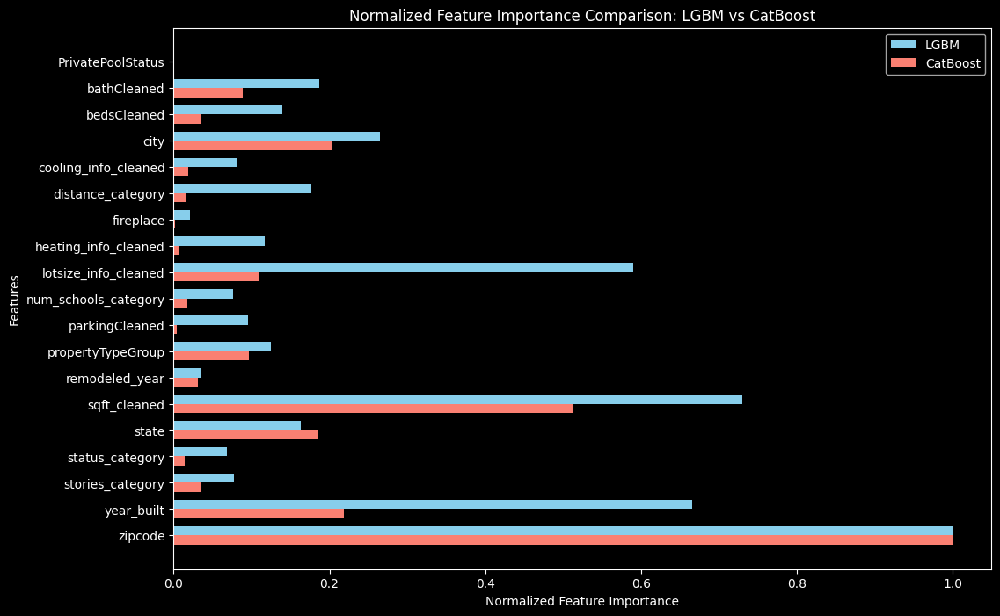

In [ ]:

# Merge the two DataFrames on the feature column
combined_df = pd.merge(feature_importance_LGBM, feature_importance_cat, on='feature', how='outer', suffixes=('_LGBM', '_CatBoost'))
combined_df = combined_df.fillna(0)  # Fill NaN values with 0

# Normalize the importance values
scaler = MinMaxScaler()
combined_df[['importance_LGBM', 'importance_CatBoost']] = scaler.fit_transform(combined_df[['importance_LGBM', 'importance_CatBoost']])

# Plot the combined feature importance
plt.figure(figsize=(12, 8))

# Set the bar width
bar_width = 0.35
index = range(len(combined_df))

# Create bars for LGBM and CatBoost
plt.barh(index, combined_df['importance_LGBM'], bar_width, label='LGBM', color='skyblue', align='center')
plt.barh([i + bar_width for i in index], combined_df['importance_CatBoost'], bar_width, label='CatBoost', color='salmon', align='center')

# Add feature names to the y-axis
plt.yticks([i + bar_width / 2 for i in index], combined_df['feature'])

# Add labels and title
plt.xlabel('Normalized Feature Importance')
plt.ylabel('Features')
plt.title('Normalized Feature Importance Comparison: LGBM vs CatBoost')
plt.legend()

# Invert y-axis to have the most important features at the top
plt.gca().invert_yaxis()

# Show the plot
plt.show()


As seen from the graphs, the feature importance and their impact on the model differ between the two models. There is a similarity in the top feature - zipcode, but then the "opinions" of the models diverge.

In the end, I decided to select the top 16 features for LGBM and the top 14 features for CatBoost and build models using these features to see if the results improve or worsen.

In [ ]:
lgbm_top_16_features = list(feature_importance_LGBM.feature[:16])

X = df_final[lgbm_top_16_features]
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=RANDOM_STATE)

X.shape, X_train.shape, X_test.shape

((291592, 16), (204114, 16), (87478, 16))

<a id = '5.12'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.12 LightGBM Top Features

</strong></p>

In [ ]:
# Create LightGBM dataset
dtrain = lgb.Dataset(X_train, label=y_train)
dtest = lgb.Dataset(X_test, label=y_test, reference=dtrain)

# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    param = {
        'objective': 'regression',
        'metric': 'rmse',
        'boosting_type': 'gbdt',
        'num_leaves': trial.suggest_int('num_leaves', 20, 100),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.1, log=True),
        'feature_fraction': trial.suggest_float('feature_fraction', 0.6, 1.0),
        'bagging_fraction': trial.suggest_float('bagging_fraction', 0.6, 1.0),
        'bagging_freq': trial.suggest_int('bagging_freq', 1, 7),
        'lambda_l1': trial.suggest_float('lambda_l1', 1e-4, 10.0, log=True),
        'lambda_l2': trial.suggest_float('lambda_l2', 1e-4, 10.0, log=True),
        'min_data_in_leaf': trial.suggest_int('min_data_in_leaf', 10, 100),
        'feature_pre_filter': False
    }
    
    # Train the model
    gbm = lgb.train(param, dtrain, num_boost_round=1000, valid_sets=[dtrain, dtest])
    
    # Make predictions and evaluate
    y_train_pred = gbm.predict(X_train, num_iteration=gbm.best_iteration)
    y_test_pred = gbm.predict(X_test, num_iteration=gbm.best_iteration)
    train_r2 = r2_score(y_train, y_train_pred)
    test_r2 = r2_score(y_test, y_test_pred)
    
    # Calculate the absolute difference in R²
    r2_difference = abs(train_r2 - test_r2)
    
    # Combine the metrics to maximize R² and minimize the difference
    combined_score = (train_r2 + test_r2) / 2 - r2_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=50)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
lgb_model_top_16 = lgb.train(
    {**best_params, 'objective': 'regression', 'metric': 'rmse', 'boosting_type': 'gbdt'},
    dtrain,
    num_boost_round=1000,
    valid_sets=[dtrain, dtest]
)

# Make final predictions and evaluate performance
y_train_predict = lgb_model_top_16.predict(X_train, num_iteration=lgb_model_top_16.best_iteration)
y_test_predict = lgb_model_top_16.predict(X_test, num_iteration=lgb_model_top_16.best_iteration)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")

[I 2024-07-21 22:34:57,766] A new study created in memory with name: no-name-fb7a1894-7a0c-48e6-b2a9-23f762e93932


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004130 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:35:13,080] Trial 0 finished with value: 0.5267561908022033 and parameters: {'num_leaves': 54, 'learning_rate': 0.0015354781491665644, 'feature_fraction': 0.9500200353298106, 'bagging_fraction': 0.6951097426664126, 'bagging_freq': 1, 'lambda_l1': 2.569399461367504, 'lambda_l2': 4.975114617604383, 'min_data_in_leaf': 32}. Best is trial 0 with value: 0.5267561908022033.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005886 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:35:24,372] Trial 1 finished with value: 0.7506872173119642 and parameters: {'num_leaves': 56, 'learning_rate': 0.07128699280676781, 'feature_fraction': 0.7155940344610083, 'bagging_fraction': 0.999127762882882, 'bagging_freq': 7, 'lambda_l1': 0.849385492762779, 'lambda_l2': 1.9944373594776048, 'min_data_in_leaf': 55}. Best is trial 1 with value: 0.7506872173119642.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008201 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:35:42,393] Trial 2 finished with value: 0.5287243042223103 and parameters: {'num_leaves': 68, 'learning_rate': 0.0014990711927563294, 'feature_fraction': 0.6587553661507672, 'bagging_fraction': 0.7434343282003647, 'bagging_freq': 3, 'lambda_l1': 0.00019477299668676192, 'lambda_l2': 3.2901646038628805, 'min_data_in_leaf': 71}. Best is trial 1 with value: 0.7506872173119642.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006311 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:35:59,725] Trial 3 finished with value: 0.3353483484834334 and parameters: {'num_leaves': 58, 'learning_rate': 0.0006080646495931985, 'feature_fraction': 0.6796325610104033, 'bagging_fraction': 0.9421979751166207, 'bagging_freq': 7, 'lambda_l1': 0.0016278017685467938, 'lambda_l2': 0.13482398737060944, 'min_data_in_leaf': 37}. Best is trial 1 with value: 0.7506872173119642.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005543 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:36:10,824] Trial 4 finished with value: 0.31619129713395444 and parameters: {'num_leaves': 32, 'learning_rate': 0.0005845892316614584, 'feature_fraction': 0.922031171391843, 'bagging_fraction': 0.6507165498966899, 'bagging_freq': 5, 'lambda_l1': 0.0019412380027338653, 'lambda_l2': 0.0009813018607353835, 'min_data_in_leaf': 63}. Best is trial 1 with value: 0.7506872173119642.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006235 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:36:30,521] Trial 5 finished with value: 0.1638175049905321 and parameters: {'num_leaves': 74, 'learning_rate': 0.0001971733430864801, 'feature_fraction': 0.9986498724672317, 'bagging_fraction': 0.9601888358132696, 'bagging_freq': 6, 'lambda_l1': 0.003388940047185291, 'lambda_l2': 0.1755142935207439, 'min_data_in_leaf': 77}. Best is trial 1 with value: 0.7506872173119642.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007001 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:36:44,424] Trial 6 finished with value: 0.7514930810691814 and parameters: {'num_leaves': 86, 'learning_rate': 0.09873707859250605, 'feature_fraction': 0.9976846366373205, 'bagging_fraction': 0.9352233242159594, 'bagging_freq': 2, 'lambda_l1': 1.5895396598107858, 'lambda_l2': 0.13857326283484053, 'min_data_in_leaf': 68}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006267 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:36:59,748] Trial 7 finished with value: 0.6387080126665343 and parameters: {'num_leaves': 51, 'learning_rate': 0.003971799613830641, 'feature_fraction': 0.8093034899107316, 'bagging_fraction': 0.8400900849718855, 'bagging_freq': 2, 'lambda_l1': 1.000579849084948, 'lambda_l2': 0.008251520203535595, 'min_data_in_leaf': 64}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004972 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:37:08,317] Trial 8 finished with value: 0.698933130292221 and parameters: {'num_leaves': 25, 'learning_rate': 0.020611557884873295, 'feature_fraction': 0.8195967122586254, 'bagging_fraction': 0.7531783512062329, 'bagging_freq': 5, 'lambda_l1': 0.01983823799028026, 'lambda_l2': 0.8820215031861997, 'min_data_in_leaf': 71}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006207 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:37:29,559] Trial 9 finished with value: 0.5968803791484263 and parameters: {'num_leaves': 83, 'learning_rate': 0.002072317845779045, 'feature_fraction': 0.854815620422271, 'bagging_fraction': 0.9672787944633138, 'bagging_freq': 4, 'lambda_l1': 0.0027748776737047437, 'lambda_l2': 0.008584078525738304, 'min_data_in_leaf': 58}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005240 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:37:44,746] Trial 10 finished with value: 0.7502077963774855 and parameters: {'num_leaves': 100, 'learning_rate': 0.09057124896710744, 'feature_fraction': 0.6070184537086247, 'bagging_fraction': 0.8637335735310511, 'bagging_freq': 1, 'lambda_l1': 0.1728786419037454, 'lambda_l2': 0.00015502079282695889, 'min_data_in_leaf': 95}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006341 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:37:58,387] Trial 11 finished with value: 0.7509135555044998 and parameters: {'num_leaves': 92, 'learning_rate': 0.09965581198619695, 'feature_fraction': 0.7342103644266033, 'bagging_fraction': 0.8921362473817138, 'bagging_freq': 3, 'lambda_l1': 8.790036850961538, 'lambda_l2': 0.3643010961273335, 'min_data_in_leaf': 42}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006614 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:38:16,244] Trial 12 finished with value: 0.7416122923506699 and parameters: {'num_leaves': 99, 'learning_rate': 0.020590992079480133, 'feature_fraction': 0.7444922241094594, 'bagging_fraction': 0.8935465004053592, 'bagging_freq': 3, 'lambda_l1': 9.05539575369929, 'lambda_l2': 0.14582623314745244, 'min_data_in_leaf': 15}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:38:32,661] Trial 13 finished with value: 0.7411227980081565 and parameters: {'num_leaves': 86, 'learning_rate': 0.022273264147464035, 'feature_fraction': 0.7494336077458598, 'bagging_fraction': 0.9033594269410733, 'bagging_freq': 3, 'lambda_l1': 8.70918851598826, 'lambda_l2': 0.03235382495710015, 'min_data_in_leaf': 42}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005634 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:38:48,252] Trial 14 finished with value: 0.7504819885306152 and parameters: {'num_leaves': 87, 'learning_rate': 0.0393829304906787, 'feature_fraction': 0.8649739810647501, 'bagging_fraction': 0.8147043428720421, 'bagging_freq': 2, 'lambda_l1': 0.131686724804659, 'lambda_l2': 0.5674260889184211, 'min_data_in_leaf': 87}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004914 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:39:07,246] Trial 15 finished with value: 0.6973917037501128 and parameters: {'num_leaves': 75, 'learning_rate': 0.007040534461434017, 'feature_fraction': 0.8944089848044807, 'bagging_fraction': 0.9134747063162666, 'bagging_freq': 2, 'lambda_l1': 0.28122800935730946, 'lambda_l2': 0.02632027796578189, 'min_data_in_leaf': 47}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006843 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:39:27,114] Trial 16 finished with value: 0.713663767289087 and parameters: {'num_leaves': 94, 'learning_rate': 0.008268344824713133, 'feature_fraction': 0.7617522672968581, 'bagging_fraction': 0.7820383981697737, 'bagging_freq': 4, 'lambda_l1': 2.162929470534762, 'lambda_l2': 0.3747568006628598, 'min_data_in_leaf': 19}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:39:39,371] Trial 17 finished with value: 0.748345912264898 and parameters: {'num_leaves': 69, 'learning_rate': 0.04604053873163935, 'feature_fraction': 0.976533404662061, 'bagging_fraction': 0.6006624924608981, 'bagging_freq': 2, 'lambda_l1': 0.02517755204329237, 'lambda_l2': 0.024594183804290688, 'min_data_in_leaf': 26}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005716 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:39:52,199] Trial 18 finished with value: 0.6891624199723262 and parameters: {'num_leaves': 40, 'learning_rate': 0.01060820538916772, 'feature_fraction': 0.6184943830856071, 'bagging_fraction': 0.8659593090684751, 'bagging_freq': 3, 'lambda_l1': 3.0733670644812845, 'lambda_l2': 0.002753904571259999, 'min_data_in_leaf': 49}. Best is trial 6 with value: 0.7514930810691814.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004765 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:40:06,164] Trial 19 finished with value: 0.752223799374662 and parameters: {'num_leaves': 91, 'learning_rate': 0.09933493342116625, 'feature_fraction': 0.7815328572511385, 'bagging_fraction': 0.9926395782312532, 'bagging_freq': 1, 'lambda_l1': 0.49175812910314726, 'lambda_l2': 8.690932235153692, 'min_data_in_leaf': 84}. Best is trial 19 with value: 0.752223799374662.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005384 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:40:20,359] Trial 20 finished with value: 0.747769633756103 and parameters: {'num_leaves': 78, 'learning_rate': 0.039466072669139214, 'feature_fraction': 0.7788539514869699, 'bagging_fraction': 0.9888525267117521, 'bagging_freq': 1, 'lambda_l1': 0.0721758579538641, 'lambda_l2': 7.139581677995039, 'min_data_in_leaf': 86}. Best is trial 19 with value: 0.752223799374662.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007923 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:40:34,021] Trial 21 finished with value: 0.7511992191027431 and parameters: {'num_leaves': 91, 'learning_rate': 0.09363603683980035, 'feature_fraction': 0.8401469131627568, 'bagging_fraction': 0.9325098385877948, 'bagging_freq': 1, 'lambda_l1': 8.938399170354176, 'lambda_l2': 1.072750113481556, 'min_data_in_leaf': 82}. Best is trial 19 with value: 0.752223799374662.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005328 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:40:48,799] Trial 22 finished with value: 0.7534045893909832 and parameters: {'num_leaves': 91, 'learning_rate': 0.05100096366267483, 'feature_fraction': 0.8393505435900522, 'bagging_fraction': 0.9362069378617932, 'bagging_freq': 1, 'lambda_l1': 0.5263608622833192, 'lambda_l2': 1.4518778599419664, 'min_data_in_leaf': 82}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006132 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:41:03,096] Trial 23 finished with value: 0.7481685402599311 and parameters: {'num_leaves': 79, 'learning_rate': 0.03969047633351129, 'feature_fraction': 0.9035364220249815, 'bagging_fraction': 0.9760101005454418, 'bagging_freq': 1, 'lambda_l1': 0.6127661151161793, 'lambda_l2': 9.09813002214845, 'min_data_in_leaf': 99}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006108 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:41:19,578] Trial 24 finished with value: 0.7217136287109099 and parameters: {'num_leaves': 69, 'learning_rate': 0.013672874648978296, 'feature_fraction': 0.8000432491164787, 'bagging_fraction': 0.9364516368637443, 'bagging_freq': 2, 'lambda_l1': 0.44350180284967927, 'lambda_l2': 2.0576993039533824, 'min_data_in_leaf': 91}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005450 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:41:34,312] Trial 25 finished with value: 0.7530292232989627 and parameters: {'num_leaves': 95, 'learning_rate': 0.057534391297328465, 'feature_fraction': 0.6968195037563066, 'bagging_fraction': 0.8622593795347426, 'bagging_freq': 1, 'lambda_l1': 0.06242024876016529, 'lambda_l2': 0.05516781008541518, 'min_data_in_leaf': 76}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006008 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:41:49,642] Trial 26 finished with value: 0.7527975746786276 and parameters: {'num_leaves': 96, 'learning_rate': 0.05184128564865619, 'feature_fraction': 0.6947100134658183, 'bagging_fraction': 0.8590657313831083, 'bagging_freq': 1, 'lambda_l1': 0.009853670749003316, 'lambda_l2': 9.946395012549072, 'min_data_in_leaf': 78}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006127 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:42:10,903] Trial 27 finished with value: 0.6897047369308894 and parameters: {'num_leaves': 100, 'learning_rate': 0.005107880553370612, 'feature_fraction': 0.6957406570182578, 'bagging_fraction': 0.8556693468482107, 'bagging_freq': 1, 'lambda_l1': 0.011754811509326533, 'lambda_l2': 0.06044747096304874, 'min_data_in_leaf': 75}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005879 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:42:28,844] Trial 28 finished with value: 0.7432080452278298 and parameters: {'num_leaves': 94, 'learning_rate': 0.02305836266111661, 'feature_fraction': 0.6383791981969861, 'bagging_fraction': 0.815357514560445, 'bagging_freq': 2, 'lambda_l1': 0.059970634813963614, 'lambda_l2': 1.9191571744513518, 'min_data_in_leaf': 79}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:42:39,001] Trial 29 finished with value: 0.7443477822394048 and parameters: {'num_leaves': 46, 'learning_rate': 0.054038121962414816, 'feature_fraction': 0.7136977498213127, 'bagging_fraction': 0.7683578663404395, 'bagging_freq': 1, 'lambda_l1': 0.009131418255785402, 'lambda_l2': 4.5491636629807335, 'min_data_in_leaf': 92}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:42:55,977] Trial 30 finished with value: 0.7274334642836713 and parameters: {'num_leaves': 81, 'learning_rate': 0.014011083975076336, 'feature_fraction': 0.6692178497040175, 'bagging_fraction': 0.8323387395346105, 'bagging_freq': 1, 'lambda_l1': 0.00041730323386839974, 'lambda_l2': 0.0001135849007803925, 'min_data_in_leaf': 100}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007933 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:43:10,680] Trial 31 finished with value: 0.7531852627903187 and parameters: {'num_leaves': 90, 'learning_rate': 0.05627238432861534, 'feature_fraction': 0.7015380343493687, 'bagging_fraction': 0.887890462330486, 'bagging_freq': 1, 'lambda_l1': 0.15527368041203604, 'lambda_l2': 5.613668750088929, 'min_data_in_leaf': 84}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:43:24,321] Trial 32 finished with value: 0.7407251848380296 and parameters: {'num_leaves': 64, 'learning_rate': 0.029559937426070715, 'feature_fraction': 0.7123484526169958, 'bagging_fraction': 0.8725789727318136, 'bagging_freq': 1, 'lambda_l1': 0.05775064064929029, 'lambda_l2': 3.180833967271404, 'min_data_in_leaf': 77}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005573 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:43:40,552] Trial 33 finished with value: 0.7520567162446129 and parameters: {'num_leaves': 96, 'learning_rate': 0.060758865435515834, 'feature_fraction': 0.6466108985971926, 'bagging_fraction': 0.7260089911842718, 'bagging_freq': 2, 'lambda_l1': 0.17801964321576158, 'lambda_l2': 1.1571331024000824, 'min_data_in_leaf': 88}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006527 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:43:55,140] Trial 34 finished with value: 0.7526913536082599 and parameters: {'num_leaves': 89, 'learning_rate': 0.05770821928943048, 'feature_fraction': 0.6924119860847632, 'bagging_fraction': 0.8802882339974801, 'bagging_freq': 1, 'lambda_l1': 0.0065617196126764666, 'lambda_l2': 4.321611695772314, 'min_data_in_leaf': 71}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:44:11,085] Trial 35 finished with value: 0.7476308014534153 and parameters: {'num_leaves': 84, 'learning_rate': 0.034060438845717744, 'feature_fraction': 0.7233924569935811, 'bagging_fraction': 0.9159467027532163, 'bagging_freq': 2, 'lambda_l1': 0.0007228383861385175, 'lambda_l2': 1.8450044073161893, 'min_data_in_leaf': 61}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007277 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:44:30,078] Trial 36 finished with value: 0.7331932685064465 and parameters: {'num_leaves': 97, 'learning_rate': 0.014369749207520422, 'feature_fraction': 0.6773060994484447, 'bagging_fraction': 0.8334642031120227, 'bagging_freq': 1, 'lambda_l1': 0.0369111258064569, 'lambda_l2': 3.4612091630149213, 'min_data_in_leaf': 81}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004857 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:44:49,010] Trial 37 finished with value: 0.0862318015490004 and parameters: {'num_leaves': 73, 'learning_rate': 0.00010412637136406535, 'feature_fraction': 0.7742101734804328, 'bagging_fraction': 0.7955290400823333, 'bagging_freq': 7, 'lambda_l1': 0.1027509403339814, 'lambda_l2': 0.00048111235088981987, 'min_data_in_leaf': 68}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006379 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:45:11,304] Trial 38 finished with value: 0.47616058862189853 and parameters: {'num_leaves': 89, 'learning_rate': 0.0010037639956171729, 'feature_fraction': 0.8305806782289502, 'bagging_fraction': 0.9582902349065007, 'bagging_freq': 6, 'lambda_l1': 0.004997580355591963, 'lambda_l2': 0.3172433910613695, 'min_data_in_leaf': 54}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004785 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:45:23,086] Trial 39 finished with value: 0.7509288141791609 and parameters: {'num_leaves': 63, 'learning_rate': 0.06625360776940396, 'feature_fraction': 0.6338134532680735, 'bagging_fraction': 0.9198057633309117, 'bagging_freq': 5, 'lambda_l1': 0.016004190914934453, 'lambda_l2': 0.06303448266176916, 'min_data_in_leaf': 73}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:45:40,504] Trial 40 finished with value: 0.7465350255735629 and parameters: {'num_leaves': 95, 'learning_rate': 0.026914097882572655, 'feature_fraction': 0.6961051237865535, 'bagging_fraction': 0.8402407955092115, 'bagging_freq': 2, 'lambda_l1': 0.26118204934165307, 'lambda_l2': 0.6953637173860929, 'min_data_in_leaf': 66}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.008452 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:45:54,671] Trial 41 finished with value: 0.7531173409913151 and parameters: {'num_leaves': 89, 'learning_rate': 0.06515862776926691, 'feature_fraction': 0.690720493704956, 'bagging_fraction': 0.8821218634937082, 'bagging_freq': 1, 'lambda_l1': 0.006508525030122347, 'lambda_l2': 5.4110245215953, 'min_data_in_leaf': 71}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007595 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:46:08,547] Trial 42 finished with value: 0.7531011935583097 and parameters: {'num_leaves': 83, 'learning_rate': 0.0612466997665212, 'feature_fraction': 0.6641827808805498, 'bagging_fraction': 0.8894557965088082, 'bagging_freq': 1, 'lambda_l1': 0.035656166444505824, 'lambda_l2': 5.648513354472514, 'min_data_in_leaf': 78}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.007732 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:46:22,571] Trial 43 finished with value: 0.7529014932416085 and parameters: {'num_leaves': 84, 'learning_rate': 0.06867924260269308, 'feature_fraction': 0.6735649895794504, 'bagging_fraction': 0.8880189210616275, 'bagging_freq': 1, 'lambda_l1': 0.03512628156138806, 'lambda_l2': 2.439827243280742, 'min_data_in_leaf': 93}. Best is trial 22 with value: 0.7534045893909832.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006772 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:46:35,639] Trial 44 finished with value: 0.753728428654256 and parameters: {'num_leaves': 76, 'learning_rate': 0.07152257425693426, 'feature_fraction': 0.6596792726058388, 'bagging_fraction': 0.9479505213818294, 'bagging_freq': 1, 'lambda_l1': 1.170026532128654, 'lambda_l2': 1.572099302817421, 'min_data_in_leaf': 73}. Best is trial 44 with value: 0.753728428654256.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006829 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:46:56,238] Trial 45 finished with value: 0.24584980413345509 and parameters: {'num_leaves': 74, 'learning_rate': 0.00036980391216462626, 'feature_fraction': 0.6563992139268283, 'bagging_fraction': 0.94709909134607, 'bagging_freq': 2, 'lambda_l1': 1.067991661654399, 'lambda_l2': 5.196743421911104, 'min_data_in_leaf': 60}. Best is trial 44 with value: 0.753728428654256.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005302 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:47:09,673] Trial 46 finished with value: 0.7532373310390814 and parameters: {'num_leaves': 79, 'learning_rate': 0.0738042431688476, 'feature_fraction': 0.6224655010727749, 'bagging_fraction': 0.9495318485092044, 'bagging_freq': 4, 'lambda_l1': 4.532339770702945, 'lambda_l2': 1.2947621938050158, 'min_data_in_leaf': 71}. Best is trial 44 with value: 0.753728428654256.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003475 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:47:24,653] Trial 47 finished with value: 0.7441810501817662 and parameters: {'num_leaves': 78, 'learning_rate': 0.03097470312047528, 'feature_fraction': 0.6331750798851551, 'bagging_fraction': 0.971178435172686, 'bagging_freq': 6, 'lambda_l1': 3.618594642222263, 'lambda_l2': 1.3566082144418707, 'min_data_in_leaf': 69}. Best is trial 44 with value: 0.753728428654256.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004305 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:47:35,828] Trial 48 finished with value: 0.7509993776481783 and parameters: {'num_leaves': 57, 'learning_rate': 0.0837863162968534, 'feature_fraction': 0.605806353551072, 'bagging_fraction': 0.9451740508294133, 'bagging_freq': 3, 'lambda_l1': 4.25583179026546, 'lambda_l2': 0.5929696364651362, 'min_data_in_leaf': 56}. Best is trial 44 with value: 0.753728428654256.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004432 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439


[I 2024-07-21 22:47:57,530] Trial 49 finished with value: 0.6022550568258619 and parameters: {'num_leaves': 88, 'learning_rate': 0.0021044211016202066, 'feature_fraction': 0.8677826828152152, 'bagging_fraction': 0.9092717309169983, 'bagging_freq': 5, 'lambda_l1': 1.7440186753049085, 'lambda_l2': 0.19757712857679832, 'min_data_in_leaf': 64}. Best is trial 44 with value: 0.753728428654256.


Best parameters: {'num_leaves': 76, 'learning_rate': 0.07152257425693426, 'feature_fraction': 0.6596792726058388, 'bagging_fraction': 0.9479505213818294, 'bagging_freq': 1, 'lambda_l1': 1.170026532128654, 'lambda_l2': 1.572099302817421, 'min_data_in_leaf': 73}
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004287 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1085
[LightGBM] [Info] Number of data points in the train set: 204114, number of used features: 16
[LightGBM] [Info] Start training from score 352772.319439
Train R²: 0.8263348530785586
Test R²: 0.7779305701290236


In [ ]:
lightgbm_top16_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("LigthGBM TOP 16 metrics:", lightgbm_top16_results)
df_results = add_row_to_df(df_results, lightgbm_top16_results, "LightGbm TOP 16")
df_results


LigthGBM TOP 16 metrics: {'MAE': 62549.11636128436, 'MAPE': 32.6131919504425, 'R2': 0.8263348530785586, 'MAE_TEST': 69820.06617465985, 'MAPE_TEST': 35.68792729535482, 'R2_TEST': 0.7779305701290236}


,MAE,MAPE,R2,MAE_TEST,MAPE_TEST,R2_TEST,model,r2_balance
0,146932.705374,106.630495,0.236290,146165.846624,104.208310,0.233663,Linear Regression,0.232350
1,146932.711728,106.630538,0.236290,146165.852216,104.208352,0.233663,Ridge,0.232350
2,146932.736842,106.630848,0.236290,146165.871905,104.208654,0.233663,Lasso,0.232350
3,30402.061898,16.691647,0.946444,61676.856500,32.006955,0.805904,Random Forest,0.735634
4,61127.656983,31.821557,0.835603,68507.610328,34.858050,0.786037,Catboost,0.761253
5,63000.311815,32.949424,0.826620,70754.164436,35.733411,0.775544,XGB,0.750006
6,52972.974087,28.003044,0.875185,68094.220359,33.959193,0.787727,XGB MAPE,0.743999
7,116344.072009,83.161722,0.505088,116138.606910,81.124702,0.499727,GradientBoostRegressor,0.497047
8,137258.516854,103.276149,0.394027,137062.966278,101.361583,0.388398,AdaBoost,0.385583
9,60575.348295,31.569639,0.836397,68574.927981,35.006615,0.784486,LightGbm,0.758531


<a id = '5.13'></a>

<p style = "background-color : DodgerBlue; border-radius: 5px 5px; padding : 10px"><strong>

## 5.13 CatBoost Top Features

</strong></p>

In [ ]:
cat_top_14_features = list(feature_importance_cat.feature[:14])

X = df_final[cat_top_14_features]
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=RANDOM_STATE)

X.shape, X_train.shape, X_test.shape

((291592, 14), (204114, 14), (87478, 14))

In [ ]:
# Define the objective function for Optuna
def objective(trial):
    # Define the hyperparameter search space
    params = {
        'iterations': trial.suggest_int('iterations', 1000, 20000),
        'learning_rate': trial.suggest_float('learning_rate', 1e-4, 0.1, log=True),
        'depth': trial.suggest_int('depth', 2, 10),
        'task_type': 'GPU',
        'devices': '0:1'
    }
    
    # Train the model
    model = CatBoostRegressor(**params, verbose=1)
    model.fit(X_train, y_train)
    
    # Make predictions and evaluate
    y_train_predict = model.predict(X_train)
    y_test_predict = model.predict(X_test)
    train_r2 = r2_score(y_train, y_train_predict)
    test_r2 = r2_score(y_test, y_test_predict)
    
    # Calculate the absolute difference in R²
    r2_difference = abs(train_r2 - test_r2)
    
    # Combine the metrics to maximize R² and minimize the difference
    combined_score = (train_r2 + test_r2) / 2 - r2_difference
    
    return combined_score

# Create a study object and specify the direction of optimization
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=20)

# Get the best parameters
best_params = study.best_params
print("Best parameters:", best_params)

# Train the model with the best parameters
best_catmodel_top14 = CatBoostRegressor(**best_params, verbose=1)
best_catmodel_top14.fit(X_train, y_train)

# Make final predictions and evaluate performance
y_train_predict = best_catmodel_top14.predict(X_train)
y_test_predict = best_catmodel_top14.predict(X_test)
train_r2 = r2_score(y_train, y_train_predict)
test_r2 = r2_score(y_test, y_test_predict)
r2_difference = abs(train_r2 - test_r2)
combined_score = (train_r2 + test_r2) / 2 - r2_difference

print(f"Train R²: {train_r2}")
print(f"Test R²: {test_r2}")
print(f"Difference in R²: {r2_difference}")
print(f"Combined Score: {combined_score}")

[I 2024-07-21 22:48:10,461] A new study created in memory with name: no-name-8ae4fa39-ebde-4888-96b5-bd9614a31425


0:	learn: 222217.1136358	total: 5.97ms	remaining: 32.5s
1:	learn: 222208.9700444	total: 10.5ms	remaining: 28.6s
2:	learn: 222200.6959446	total: 14.6ms	remaining: 26.5s
3:	learn: 222192.5280761	total: 18.6ms	remaining: 25.3s
4:	learn: 222184.4427742	total: 22.5ms	remaining: 24.4s
5:	learn: 222176.1914382	total: 26.8ms	remaining: 24.3s
6:	learn: 222168.0700248	total: 30.7ms	remaining: 23.8s
7:	learn: 222159.8654384	total: 34.4ms	remaining: 23.4s
8:	learn: 222151.6960687	total: 38.3ms	remaining: 23.1s
9:	learn: 222143.4908775	total: 42.3ms	remaining: 22.9s
10:	learn: 222135.3682686	total: 46.8ms	remaining: 23.1s
11:	learn: 222127.1743155	total: 50.8ms	remaining: 23s
12:	learn: 222118.9326936	total: 54.7ms	remaining: 22.8s
13:	learn: 222110.8447128	total: 58.5ms	remaining: 22.7s
14:	learn: 222102.6616975	total: 62.7ms	remaining: 22.7s
15:	learn: 222094.4665377	total: 66.6ms	remaining: 22.6s
16:	learn: 222086.3421358	total: 70.4ms	remaining: 22.5s
17:	learn: 222078.1937490	total: 74.2ms	rem

[I 2024-07-21 22:48:37,271] Trial 0 finished with value: 0.22277237696224023 and parameters: {'iterations': 5440, 'learning_rate': 0.0001414850960415381, 'depth': 3}. Best is trial 0 with value: 0.22277237696224023.


0:	learn: 221956.2520091	total: 5.08ms	remaining: 59.6s
1:	learn: 221689.5902099	total: 9.34ms	remaining: 54.7s
2:	learn: 221424.8642408	total: 13.1ms	remaining: 51.2s
3:	learn: 221162.4497317	total: 16.9ms	remaining: 49.4s
4:	learn: 220899.6401425	total: 20.7ms	remaining: 48.4s
5:	learn: 220638.9017353	total: 25ms	remaining: 48.8s
6:	learn: 220383.0823863	total: 28.7ms	remaining: 48s
7:	learn: 220126.3324519	total: 32.5ms	remaining: 47.6s
8:	learn: 219873.8644021	total: 36.4ms	remaining: 47.3s
9:	learn: 219621.1779826	total: 40.5ms	remaining: 47.4s
10:	learn: 219372.6008269	total: 44.4ms	remaining: 47.2s
11:	learn: 219126.4904645	total: 48.1ms	remaining: 46.9s
12:	learn: 218879.5025305	total: 51.9ms	remaining: 46.7s
13:	learn: 218637.9379476	total: 55.6ms	remaining: 46.5s
14:	learn: 218394.6729946	total: 59.8ms	remaining: 46.6s
15:	learn: 218153.3793640	total: 63.5ms	remaining: 46.4s
16:	learn: 217916.6465962	total: 67.2ms	remaining: 46.3s
17:	learn: 217681.3359228	total: 70.8ms	remai

[I 2024-07-21 22:49:33,095] Trial 1 finished with value: 0.6273228240747402 and parameters: {'iterations': 11715, 'learning_rate': 0.004657041422869168, 'depth': 3}. Best is trial 1 with value: 0.6273228240747402.


0:	learn: 222214.5332859	total: 5.11ms	remaining: 1m 32s
1:	learn: 222203.8446369	total: 8.95ms	remaining: 1m 21s
2:	learn: 222193.1317983	total: 12.8ms	remaining: 1m 17s
3:	learn: 222182.4302815	total: 17.1ms	remaining: 1m 17s
4:	learn: 222171.6808939	total: 20.9ms	remaining: 1m 15s
5:	learn: 222160.9901832	total: 24.8ms	remaining: 1m 14s
6:	learn: 222150.2752780	total: 28.6ms	remaining: 1m 13s
7:	learn: 222139.5835371	total: 32.9ms	remaining: 1m 14s
8:	learn: 222128.8794405	total: 36.6ms	remaining: 1m 13s
9:	learn: 222118.1511447	total: 40.4ms	remaining: 1m 13s
10:	learn: 222107.5052263	total: 44.1ms	remaining: 1m 12s
11:	learn: 222096.7758980	total: 48.6ms	remaining: 1m 13s
12:	learn: 222086.0578948	total: 52.3ms	remaining: 1m 12s
13:	learn: 222075.3867500	total: 56.1ms	remaining: 1m 12s
14:	learn: 222064.6203363	total: 59.8ms	remaining: 1m 12s
15:	learn: 222053.9836966	total: 64.3ms	remaining: 1m 12s
16:	learn: 222043.2636278	total: 68.1ms	remaining: 1m 12s
17:	learn: 222032.614118

[I 2024-07-21 22:50:59,146] Trial 2 finished with value: 0.4046746935260934 and parameters: {'iterations': 18117, 'learning_rate': 0.00018541655163196354, 'depth': 3}. Best is trial 1 with value: 0.6273228240747402.


0:	learn: 222033.1235063	total: 4.56ms	remaining: 1m 14s
1:	learn: 221842.4480108	total: 7.85ms	remaining: 1m 4s
2:	learn: 221653.4834015	total: 11ms	remaining: 1m
3:	learn: 221466.0084036	total: 14.2ms	remaining: 58.1s
4:	learn: 221279.3849298	total: 17.4ms	remaining: 57s
5:	learn: 221094.2932388	total: 20.9ms	remaining: 57.1s
6:	learn: 220911.2967804	total: 24.1ms	remaining: 56.3s
7:	learn: 220729.0899885	total: 27.3ms	remaining: 55.8s
8:	learn: 220550.1911909	total: 30.5ms	remaining: 55.4s
9:	learn: 220370.2400585	total: 33.7ms	remaining: 55.1s
10:	learn: 220192.1845074	total: 37.4ms	remaining: 55.5s
11:	learn: 220016.6268797	total: 40.6ms	remaining: 55.2s
12:	learn: 219840.1394101	total: 43.7ms	remaining: 55s
13:	learn: 219665.9767722	total: 47ms	remaining: 54.9s
14:	learn: 219492.3350239	total: 50.2ms	remaining: 54.7s
15:	learn: 219318.6637333	total: 53.8ms	remaining: 54.9s
16:	learn: 219147.8793769	total: 57ms	remaining: 54.8s
17:	learn: 218977.6584907	total: 60.4ms	remaining: 54

[I 2024-07-21 22:52:02,240] Trial 3 finished with value: 0.6025850994996574 and parameters: {'iterations': 16360, 'learning_rate': 0.004626776281664305, 'depth': 2}. Best is trial 1 with value: 0.6273228240747402.


0:	learn: 222160.6350012	total: 11.8ms	remaining: 49.9s
1:	learn: 222096.0179568	total: 22.3ms	remaining: 47s
2:	learn: 222030.8727156	total: 32.6ms	remaining: 45.8s
3:	learn: 221965.9690503	total: 43ms	remaining: 45.3s
4:	learn: 221901.4968247	total: 53.1ms	remaining: 44.8s
5:	learn: 221837.0414317	total: 63.6ms	remaining: 44.7s
6:	learn: 221771.4524510	total: 73.8ms	remaining: 44.4s
7:	learn: 221705.8915213	total: 84.4ms	remaining: 44.4s
8:	learn: 221639.9551825	total: 94.9ms	remaining: 44.4s
9:	learn: 221574.4384397	total: 105ms	remaining: 44.2s
10:	learn: 221508.8666960	total: 115ms	remaining: 44.1s
11:	learn: 221443.1092471	total: 126ms	remaining: 44.1s
12:	learn: 221377.1896900	total: 136ms	remaining: 44.1s
13:	learn: 221312.9737943	total: 147ms	remaining: 44s
14:	learn: 221246.9322459	total: 157ms	remaining: 44s
15:	learn: 221181.7152983	total: 167ms	remaining: 43.9s
16:	learn: 221116.6575451	total: 178ms	remaining: 43.9s
17:	learn: 221051.4735554	total: 188ms	remaining: 43.9s
1

[I 2024-07-21 22:52:48,780] Trial 4 finished with value: 0.5681442236079796 and parameters: {'iterations': 4217, 'learning_rate': 0.0006997784341289844, 'depth': 10}. Best is trial 1 with value: 0.6273228240747402.


0:	learn: 220515.3887907	total: 6.07ms	remaining: 14.4s
1:	learn: 218870.0330185	total: 10.6ms	remaining: 12.6s
2:	learn: 217263.2482120	total: 15.4ms	remaining: 12.2s
3:	learn: 215750.4099698	total: 19.9ms	remaining: 11.8s
4:	learn: 214279.7505513	total: 24.3ms	remaining: 11.5s
5:	learn: 212849.5368578	total: 29ms	remaining: 11.4s
6:	learn: 211487.0818778	total: 33.3ms	remaining: 11.3s
7:	learn: 210173.9560655	total: 37.7ms	remaining: 11.2s
8:	learn: 208939.2207084	total: 42.3ms	remaining: 11.1s
9:	learn: 207748.4464697	total: 46.7ms	remaining: 11s
10:	learn: 206610.6238866	total: 51.1ms	remaining: 11s
11:	learn: 205480.3574237	total: 55.5ms	remaining: 10.9s
12:	learn: 204408.4835953	total: 60.3ms	remaining: 10.9s
13:	learn: 203368.1464335	total: 65ms	remaining: 11s
14:	learn: 202369.4765340	total: 69.6ms	remaining: 11s
15:	learn: 201390.0498010	total: 74.6ms	remaining: 11s
16:	learn: 200473.0888443	total: 79.4ms	remaining: 11s
17:	learn: 199545.9566025	total: 84.1ms	remaining: 11s
18

[I 2024-07-21 22:53:01,637] Trial 5 finished with value: 0.6630144839302925 and parameters: {'iterations': 2375, 'learning_rate': 0.02729773940102952, 'depth': 4}. Best is trial 5 with value: 0.6630144839302925.


0:	learn: 222021.3125239	total: 9.37ms	remaining: 58.4s
1:	learn: 221816.7062973	total: 17.4ms	remaining: 54.2s
2:	learn: 221613.9763134	total: 24.9ms	remaining: 51.6s
3:	learn: 221412.0585794	total: 32.4ms	remaining: 50.5s
4:	learn: 221210.0516597	total: 40.4ms	remaining: 50.3s
5:	learn: 221008.5503669	total: 48.1ms	remaining: 49.9s
6:	learn: 220807.9610913	total: 55.8ms	remaining: 49.6s
7:	learn: 220608.5963111	total: 63.3ms	remaining: 49.3s
8:	learn: 220409.8984778	total: 71ms	remaining: 49.1s
9:	learn: 220212.3352192	total: 78.5ms	remaining: 48.8s
10:	learn: 220015.8737273	total: 85.9ms	remaining: 48.6s
11:	learn: 219819.2845117	total: 93.6ms	remaining: 48.5s
12:	learn: 219622.6510632	total: 101ms	remaining: 48.5s
13:	learn: 219427.5914964	total: 109ms	remaining: 48.5s
14:	learn: 219231.8904727	total: 117ms	remaining: 48.3s
15:	learn: 219038.8005052	total: 124ms	remaining: 48.2s
16:	learn: 218845.9127531	total: 132ms	remaining: 48.1s
17:	learn: 218653.9013928	total: 139ms	remaining

[I 2024-07-21 22:53:56,151] Trial 6 finished with value: 0.6585380940449799 and parameters: {'iterations': 6232, 'learning_rate': 0.0023883551997792743, 'depth': 8}. Best is trial 5 with value: 0.6630144839302925.


0:	learn: 222212.0239261	total: 4.4ms	remaining: 47.7s
1:	learn: 222198.8493223	total: 7.62ms	remaining: 41.2s
2:	learn: 222185.6029088	total: 10.8ms	remaining: 38.8s
3:	learn: 222172.4385770	total: 13.9ms	remaining: 37.5s
4:	learn: 222159.1905888	total: 17.2ms	remaining: 37.2s
5:	learn: 222146.0128516	total: 20.3ms	remaining: 36.7s
6:	learn: 222132.7632874	total: 23.3ms	remaining: 36.1s
7:	learn: 222119.6195071	total: 26.4ms	remaining: 35.7s
8:	learn: 222106.4038953	total: 29.4ms	remaining: 35.4s
9:	learn: 222093.2703981	total: 32.7ms	remaining: 35.3s
10:	learn: 222080.1005930	total: 36ms	remaining: 35.4s
11:	learn: 222066.9655402	total: 39ms	remaining: 35.2s
12:	learn: 222053.7586397	total: 42.1ms	remaining: 35s
13:	learn: 222040.6694118	total: 45.2ms	remaining: 34.9s
14:	learn: 222027.4964867	total: 48.4ms	remaining: 34.9s
15:	learn: 222014.4175577	total: 51.8ms	remaining: 35s
16:	learn: 222001.2549228	total: 54.9ms	remaining: 34.9s
17:	learn: 221988.1862962	total: 58.1ms	remaining:

[I 2024-07-21 22:54:44,879] Trial 7 finished with value: 0.35239411746799504 and parameters: {'iterations': 10832, 'learning_rate': 0.0003180183576165714, 'depth': 2}. Best is trial 5 with value: 0.6630144839302925.


0:	learn: 222077.9687166	total: 5.27ms	remaining: 48.5s
1:	learn: 221931.3649636	total: 9.24ms	remaining: 42.5s
2:	learn: 221785.4233081	total: 13.1ms	remaining: 40.1s
3:	learn: 221640.1094564	total: 17.2ms	remaining: 39.5s
4:	learn: 221494.1896443	total: 21.1ms	remaining: 38.8s
5:	learn: 221349.0529674	total: 24.9ms	remaining: 38.2s
6:	learn: 221205.8186782	total: 28.7ms	remaining: 37.7s
7:	learn: 221061.7776879	total: 32.4ms	remaining: 37.2s
8:	learn: 220919.5953602	total: 36.5ms	remaining: 37.3s
9:	learn: 220776.7615265	total: 40.4ms	remaining: 37.1s
10:	learn: 220635.7307097	total: 44.1ms	remaining: 36.8s
11:	learn: 220495.6474967	total: 47.9ms	remaining: 36.7s
12:	learn: 220354.6158085	total: 51.8ms	remaining: 36.6s
13:	learn: 220216.2170355	total: 55.9ms	remaining: 36.7s
14:	learn: 220076.3568063	total: 59.8ms	remaining: 36.6s
15:	learn: 219938.2612972	total: 63.5ms	remaining: 36.5s
16:	learn: 219800.8209511	total: 67.2ms	remaining: 36.3s
17:	learn: 219663.9771280	total: 71.3ms	r

[I 2024-07-21 22:55:26,825] Trial 8 finished with value: 0.5840375384821052 and parameters: {'iterations': 9206, 'learning_rate': 0.0025481240869949994, 'depth': 3}. Best is trial 5 with value: 0.6630144839302925.


0:	learn: 222198.9203465	total: 9.05ms	remaining: 26.1s
1:	learn: 222172.4859322	total: 16.6ms	remaining: 23.8s
2:	learn: 222146.2022946	total: 24.4ms	remaining: 23.4s
3:	learn: 222119.9273884	total: 32ms	remaining: 23s
4:	learn: 222093.5309439	total: 39.6ms	remaining: 22.8s
5:	learn: 222067.2853388	total: 47.3ms	remaining: 22.7s
6:	learn: 222041.0366314	total: 54.8ms	remaining: 22.5s
7:	learn: 222014.8085151	total: 62.7ms	remaining: 22.5s
8:	learn: 221988.3877224	total: 70.2ms	remaining: 22.4s
9:	learn: 221962.1889348	total: 77.6ms	remaining: 22.3s
10:	learn: 221935.9752031	total: 85ms	remaining: 22.2s
11:	learn: 221909.7939332	total: 92.5ms	remaining: 22.1s
12:	learn: 221883.4910321	total: 100ms	remaining: 22.1s
13:	learn: 221857.3628465	total: 108ms	remaining: 22.1s
14:	learn: 221830.7810175	total: 115ms	remaining: 22s
15:	learn: 221804.6703396	total: 123ms	remaining: 22s
16:	learn: 221778.5447278	total: 130ms	remaining: 21.9s
17:	learn: 221752.4634829	total: 137ms	remaining: 21.9s


[I 2024-07-21 22:55:52,153] Trial 9 finished with value: 0.3587777375794412 and parameters: {'iterations': 2881, 'learning_rate': 0.0003077579083476826, 'depth': 8}. Best is trial 5 with value: 0.6630144839302925.


0:	learn: 216181.5710119	total: 6.65ms	remaining: 6.92s
1:	learn: 210987.4473831	total: 12.2ms	remaining: 6.34s
2:	learn: 206386.0126918	total: 17.5ms	remaining: 6.07s
3:	learn: 202302.4905258	total: 22.9ms	remaining: 5.94s
4:	learn: 198806.4338278	total: 28.2ms	remaining: 5.83s
5:	learn: 195387.1528802	total: 33.4ms	remaining: 5.76s
6:	learn: 192420.8164527	total: 38.7ms	remaining: 5.71s
7:	learn: 189916.3225392	total: 44ms	remaining: 5.69s
8:	learn: 187439.5203553	total: 49.4ms	remaining: 5.66s
9:	learn: 185305.2442389	total: 54.6ms	remaining: 5.63s
10:	learn: 183306.5893273	total: 60.2ms	remaining: 5.63s
11:	learn: 181588.6219265	total: 65.5ms	remaining: 5.61s
12:	learn: 180022.2808999	total: 70.8ms	remaining: 5.6s
13:	learn: 178420.3451564	total: 76.3ms	remaining: 5.59s
14:	learn: 177014.7357437	total: 81.6ms	remaining: 5.58s
15:	learn: 175770.1969539	total: 86.9ms	remaining: 5.57s
16:	learn: 174560.1011488	total: 92.4ms	remaining: 5.56s
17:	learn: 173424.4173792	total: 97.7ms	rema

[I 2024-07-21 22:55:58,735] Trial 10 finished with value: 0.6963696568958296 and parameters: {'iterations': 1041, 'learning_rate': 0.08902969574915513, 'depth': 5}. Best is trial 10 with value: 0.6963696568958296.


0:	learn: 216827.5420334	total: 6.39ms	remaining: 11.7s
1:	learn: 212113.8946642	total: 11.7ms	remaining: 10.7s
2:	learn: 207827.1497499	total: 16.8ms	remaining: 10.3s
3:	learn: 203982.2239293	total: 21.9ms	remaining: 10s
4:	learn: 200594.0994384	total: 27.3ms	remaining: 10s
5:	learn: 197342.5395410	total: 32.4ms	remaining: 9.88s
6:	learn: 194562.6048130	total: 37.3ms	remaining: 9.75s
7:	learn: 191980.8330246	total: 42.7ms	remaining: 9.75s
8:	learn: 189600.6581104	total: 47.9ms	remaining: 9.73s
9:	learn: 187467.1764276	total: 53ms	remaining: 9.68s
10:	learn: 185520.0759052	total: 58.2ms	remaining: 9.66s
11:	learn: 183694.1527019	total: 63.6ms	remaining: 9.66s
12:	learn: 182063.5468980	total: 68.7ms	remaining: 9.63s
13:	learn: 180521.6902922	total: 73.8ms	remaining: 9.6s
14:	learn: 179136.9239131	total: 79.1ms	remaining: 9.59s
15:	learn: 177886.6946697	total: 84.2ms	remaining: 9.58s
16:	learn: 176675.1880470	total: 89.4ms	remaining: 9.56s
17:	learn: 175595.3362712	total: 94.5ms	remainin

[I 2024-07-21 22:56:10,101] Trial 11 finished with value: 0.710505399065342 and parameters: {'iterations': 1835, 'learning_rate': 0.07922497849317948, 'depth': 5}. Best is trial 11 with value: 0.710505399065342.


0:	learn: 217296.8163408	total: 7.39ms	remaining: 7.59s
1:	learn: 212831.5191194	total: 13.5ms	remaining: 6.9s
2:	learn: 208777.6214211	total: 19.4ms	remaining: 6.61s
3:	learn: 205061.2001101	total: 25.6ms	remaining: 6.54s
4:	learn: 201699.0782908	total: 31.5ms	remaining: 6.45s
5:	learn: 198631.5527978	total: 37.5ms	remaining: 6.39s
6:	learn: 195792.9796965	total: 43.7ms	remaining: 6.38s
7:	learn: 193257.1229470	total: 49.6ms	remaining: 6.33s
8:	learn: 190820.1177137	total: 55.5ms	remaining: 6.28s
9:	learn: 188680.4765463	total: 61.4ms	remaining: 6.25s
10:	learn: 186423.4353819	total: 67.1ms	remaining: 6.21s
11:	learn: 184505.6375330	total: 73.4ms	remaining: 6.21s
12:	learn: 182822.6791999	total: 79.1ms	remaining: 6.17s
13:	learn: 181091.8644158	total: 84.9ms	remaining: 6.15s
14:	learn: 179457.8616595	total: 90.8ms	remaining: 6.13s
15:	learn: 177977.9162982	total: 96.7ms	remaining: 6.12s
16:	learn: 176674.9498470	total: 103ms	remaining: 6.1s
17:	learn: 175361.4624967	total: 109ms	remai

[I 2024-07-21 22:56:17,507] Trial 12 finished with value: 0.7005007313229341 and parameters: {'iterations': 1028, 'learning_rate': 0.06651650941987268, 'depth': 6}. Best is trial 11 with value: 0.710505399065342.


0:	learn: 214943.1486103	total: 7.75ms	remaining: 1m 2s
1:	learn: 208689.7421411	total: 13.7ms	remaining: 55.6s
2:	learn: 203220.6063985	total: 19.5ms	remaining: 52.9s
3:	learn: 198431.8778113	total: 25.6ms	remaining: 51.9s
4:	learn: 194365.7189792	total: 31.4ms	remaining: 51s
5:	learn: 190629.2872224	total: 37.2ms	remaining: 50.4s
6:	learn: 187507.0537627	total: 43ms	remaining: 49.9s
7:	learn: 184624.4986097	total: 48.9ms	remaining: 49.6s
8:	learn: 182065.8511609	total: 54.5ms	remaining: 49.2s
9:	learn: 179468.5020689	total: 60.2ms	remaining: 48.9s
10:	learn: 177198.4602743	total: 66.2ms	remaining: 48.8s
11:	learn: 175152.0636306	total: 71.9ms	remaining: 48.6s
12:	learn: 173496.2085566	total: 78ms	remaining: 48.7s
13:	learn: 171822.3762695	total: 83.9ms	remaining: 48.6s
14:	learn: 170312.6935436	total: 89.5ms	remaining: 48.4s
15:	learn: 168899.5510758	total: 95.5ms	remaining: 48.4s
16:	learn: 167771.2892436	total: 101ms	remaining: 48.2s
17:	learn: 166634.3307417	total: 107ms	remaining

[I 2024-07-21 22:57:13,235] Trial 13 finished with value: 0.7342578458796425 and parameters: {'iterations': 8126, 'learning_rate': 0.09944815210941034, 'depth': 6}. Best is trial 13 with value: 0.7342578458796425.


0:	learn: 220629.6388747	total: 7.89ms	remaining: 58.5s
1:	learn: 219083.0580671	total: 14.7ms	remaining: 54.5s
2:	learn: 217586.8502811	total: 21.2ms	remaining: 52.4s
3:	learn: 216135.6605845	total: 28ms	remaining: 51.8s
4:	learn: 214716.0452981	total: 34.5ms	remaining: 51.1s
5:	learn: 213335.5392148	total: 41ms	remaining: 50.6s
6:	learn: 211999.8319478	total: 47.7ms	remaining: 50.5s
7:	learn: 210696.9801794	total: 54.1ms	remaining: 50.1s
8:	learn: 209395.2482873	total: 60.9ms	remaining: 50.1s
9:	learn: 208140.6606453	total: 67.2ms	remaining: 49.8s
10:	learn: 206952.8537422	total: 73.9ms	remaining: 49.7s
11:	learn: 205766.3007343	total: 80.5ms	remaining: 49.6s
12:	learn: 204589.5858658	total: 87ms	remaining: 49.5s
13:	learn: 203471.6005965	total: 93.5ms	remaining: 49.4s
14:	learn: 202359.9623102	total: 100ms	remaining: 49.4s
15:	learn: 201311.2078533	total: 107ms	remaining: 49.4s
16:	learn: 200283.6352409	total: 113ms	remaining: 49.3s
17:	learn: 199288.1112102	total: 120ms	remaining: 

[I 2024-07-21 22:58:15,669] Trial 14 finished with value: 0.7283662904627705 and parameters: {'iterations': 7409, 'learning_rate': 0.019861883130053735, 'depth': 7}. Best is trial 13 with value: 0.7342578458796425.


0:	learn: 220366.8264514	total: 14.9ms	remaining: 2m 1s
1:	learn: 218555.0584674	total: 27.7ms	remaining: 1m 52s
2:	learn: 216807.1252558	total: 40.6ms	remaining: 1m 50s
3:	learn: 215128.7520787	total: 53.1ms	remaining: 1m 48s
4:	learn: 213480.4563851	total: 65.8ms	remaining: 1m 47s
5:	learn: 211890.2883732	total: 78.3ms	remaining: 1m 46s
6:	learn: 210354.0646058	total: 90.8ms	remaining: 1m 45s
7:	learn: 208840.9940239	total: 103ms	remaining: 1m 45s
8:	learn: 207305.5065231	total: 116ms	remaining: 1m 45s
9:	learn: 205919.2017960	total: 128ms	remaining: 1m 44s
10:	learn: 204540.7006475	total: 141ms	remaining: 1m 44s
11:	learn: 203149.6025570	total: 154ms	remaining: 1m 44s
12:	learn: 201829.6363200	total: 166ms	remaining: 1m 44s
13:	learn: 200517.8434670	total: 179ms	remaining: 1m 44s
14:	learn: 199270.2532051	total: 191ms	remaining: 1m 43s
15:	learn: 198065.9094407	total: 204ms	remaining: 1m 43s
16:	learn: 196932.5200871	total: 216ms	remaining: 1m 43s
17:	learn: 195777.0263691	total: 22

[I 2024-07-21 22:59:28,133] Trial 15 finished with value: 0.7329934120551257 and parameters: {'iterations': 8158, 'learning_rate': 0.021892948304939108, 'depth': 8}. Best is trial 13 with value: 0.7342578458796425.


0:	learn: 220393.7280611	total: 11.7ms	remaining: 2m 37s
1:	learn: 218568.2120275	total: 22.1ms	remaining: 2m 28s
2:	learn: 216822.5562954	total: 32.3ms	remaining: 2m 25s
3:	learn: 215126.2578785	total: 42.9ms	remaining: 2m 24s
4:	learn: 213459.2389107	total: 53.1ms	remaining: 2m 22s
5:	learn: 211839.3506241	total: 63.5ms	remaining: 2m 22s
6:	learn: 210255.1103190	total: 73.8ms	remaining: 2m 21s
7:	learn: 208708.5459243	total: 84.1ms	remaining: 2m 21s
8:	learn: 207182.0809488	total: 94.5ms	remaining: 2m 21s
9:	learn: 205642.1623782	total: 105ms	remaining: 2m 20s
10:	learn: 204192.5023288	total: 115ms	remaining: 2m 20s
11:	learn: 202823.9874840	total: 126ms	remaining: 2m 20s
12:	learn: 201466.5696648	total: 136ms	remaining: 2m 21s
13:	learn: 200091.0380225	total: 146ms	remaining: 2m 20s
14:	learn: 198834.5989438	total: 157ms	remaining: 2m 20s
15:	learn: 197592.9469741	total: 167ms	remaining: 2m 20s
16:	learn: 196323.3277250	total: 178ms	remaining: 2m 20s
17:	learn: 195153.9304565	total:

[I 2024-07-21 23:02:07,232] Trial 16 finished with value: 0.723633750299632 and parameters: {'iterations': 13462, 'learning_rate': 0.019942860416967474, 'depth': 10}. Best is trial 13 with value: 0.7342578458796425.


0:	learn: 221315.4576940	total: 9.51ms	remaining: 1m 14s
1:	learn: 220413.8722806	total: 17.1ms	remaining: 1m 6s
2:	learn: 219527.7069805	total: 25.1ms	remaining: 1m 5s
3:	learn: 218660.8542096	total: 32.6ms	remaining: 1m 3s
4:	learn: 217800.5507104	total: 40.8ms	remaining: 1m 3s
5:	learn: 216955.1791345	total: 48.2ms	remaining: 1m 2s
6:	learn: 216121.4583795	total: 56.3ms	remaining: 1m 2s
7:	learn: 215302.3947005	total: 63.7ms	remaining: 1m 2s
8:	learn: 214489.0816754	total: 71ms	remaining: 1m 1s
9:	learn: 213701.1557071	total: 78.9ms	remaining: 1m 1s
10:	learn: 212915.4776722	total: 86.3ms	remaining: 1m 1s
11:	learn: 212149.7157573	total: 94.2ms	remaining: 1m 1s
12:	learn: 211388.6455318	total: 101ms	remaining: 1m
13:	learn: 210643.8683824	total: 109ms	remaining: 1m
14:	learn: 209900.6965785	total: 116ms	remaining: 1m
15:	learn: 209132.9259755	total: 124ms	remaining: 1m
16:	learn: 208423.6987828	total: 131ms	remaining: 1m
17:	learn: 207688.5968328	total: 139ms	remaining: 1m
18:	learn

[I 2024-07-21 23:03:18,495] Trial 17 finished with value: 0.7238541286800452 and parameters: {'iterations': 7820, 'learning_rate': 0.01068014569388345, 'depth': 8}. Best is trial 13 with value: 0.7342578458796425.


0:	learn: 219556.1370130	total: 7.81ms	remaining: 1m 45s
1:	learn: 217022.6963747	total: 14.7ms	remaining: 1m 38s
2:	learn: 214595.1414847	total: 21.1ms	remaining: 1m 34s
3:	learn: 212307.6457769	total: 28.1ms	remaining: 1m 34s
4:	learn: 210131.3644475	total: 34.6ms	remaining: 1m 33s
5:	learn: 207990.7774115	total: 41.8ms	remaining: 1m 33s
6:	learn: 205951.8156187	total: 48.5ms	remaining: 1m 33s
7:	learn: 204007.7147778	total: 54.8ms	remaining: 1m 32s
8:	learn: 202143.6334604	total: 61.7ms	remaining: 1m 32s
9:	learn: 200405.6395853	total: 68.2ms	remaining: 1m 31s
10:	learn: 198711.4049982	total: 75.1ms	remaining: 1m 31s
11:	learn: 197093.3153036	total: 81.6ms	remaining: 1m 31s
12:	learn: 195466.8032003	total: 88.1ms	remaining: 1m 31s
13:	learn: 193982.3649625	total: 95.3ms	remaining: 1m 31s
14:	learn: 192585.0235631	total: 102ms	remaining: 1m 31s
15:	learn: 191212.4735183	total: 109ms	remaining: 1m 31s
16:	learn: 189928.9598077	total: 115ms	remaining: 1m 31s
17:	learn: 188680.6717095	t

[I 2024-07-21 23:05:09,827] Trial 18 finished with value: 0.7356698131361527 and parameters: {'iterations': 13482, 'learning_rate': 0.03337085821582983, 'depth': 7}. Best is trial 18 with value: 0.7356698131361527.


0:	learn: 219248.9743491	total: 7.4ms	remaining: 1m 40s
1:	learn: 216434.4815356	total: 13.4ms	remaining: 1m 31s
2:	learn: 213767.3629062	total: 19.7ms	remaining: 1m 29s
3:	learn: 211301.9890913	total: 25.5ms	remaining: 1m 26s
4:	learn: 208985.0884980	total: 31.3ms	remaining: 1m 25s
5:	learn: 206746.8332066	total: 37.6ms	remaining: 1m 25s
6:	learn: 204628.6907734	total: 43.7ms	remaining: 1m 25s
7:	learn: 202665.9609822	total: 50.2ms	remaining: 1m 25s
8:	learn: 200770.5920470	total: 56.5ms	remaining: 1m 25s
9:	learn: 198989.1978982	total: 62.2ms	remaining: 1m 24s
10:	learn: 197247.2054872	total: 68.5ms	remaining: 1m 24s
11:	learn: 195637.9523341	total: 74.3ms	remaining: 1m 24s
12:	learn: 194086.1940504	total: 80.3ms	remaining: 1m 24s
13:	learn: 192621.9638437	total: 86.9ms	remaining: 1m 24s
14:	learn: 191114.1435407	total: 92.8ms	remaining: 1m 24s
15:	learn: 189736.4151310	total: 98.9ms	remaining: 1m 24s
16:	learn: 188454.9839529	total: 105ms	remaining: 1m 24s
17:	learn: 187266.9179704	

[I 2024-07-21 23:06:51,722] Trial 19 finished with value: 0.735104130852373 and parameters: {'iterations': 13639, 'learning_rate': 0.039798173887498345, 'depth': 6}. Best is trial 18 with value: 0.7356698131361527.


Best parameters: {'iterations': 13482, 'learning_rate': 0.03337085821582983, 'depth': 7}
0:	learn: 219563.4295221	total: 22ms	remaining: 4m 56s
1:	learn: 217065.9030169	total: 40.7ms	remaining: 4m 34s
2:	learn: 214723.9483190	total: 59.5ms	remaining: 4m 27s
3:	learn: 212408.3707481	total: 76.9ms	remaining: 4m 19s
4:	learn: 210196.2421790	total: 95ms	remaining: 4m 16s
5:	learn: 208099.5108928	total: 111ms	remaining: 4m 8s
6:	learn: 206078.8838345	total: 128ms	remaining: 4m 5s
7:	learn: 204186.4698191	total: 146ms	remaining: 4m 5s
8:	learn: 202355.8979468	total: 164ms	remaining: 4m 5s
9:	learn: 200516.0957557	total: 181ms	remaining: 4m 3s
10:	learn: 198794.7456205	total: 200ms	remaining: 4m 4s
11:	learn: 197122.4438675	total: 218ms	remaining: 4m 5s
12:	learn: 195543.6585113	total: 236ms	remaining: 4m 4s
13:	learn: 194026.0707496	total: 254ms	remaining: 4m 4s
14:	learn: 192555.4018327	total: 271ms	remaining: 4m 3s
15:	learn: 191195.0551321	total: 288ms	remaining: 4m 2s
16:	learn: 189920.4

In [ ]:
cat_top14_results = calculate_metrics(y_train,y_train_predict,y_test, y_test_predict)
print("CatBoost TOP 14 metrics:", cat_top14_results)
df_results = add_row_to_df(df_results, cat_top14_results, "CatBoost TOP 14")


CatBoost TOP 14 metrics: {'MAE': 60075.738162714675, 'MAPE': 32.2786065245407, 'R2': 0.8411294577286218, 'MAE_TEST': 68627.57878062903, 'MAPE_TEST': 36.009066833855144, 'R2_TEST': 0.7842810536346385}


<a id='6'></a>
<p style = "background-color : DarkGreen; border-radius: 5px 5px; padding : 10px"><strong>

# 6. Conclusions
</strong></p>

In [ ]:
df_results['r2_balance'] = df_results.apply(lambda row: (row.R2 + row.R2_TEST) / 2 - abs(row.R2 - row.R2_TEST), axis = 1)
df_results.sort_values(by=['r2_balance'])

,MAE,MAPE,R2,MAE_TEST,MAPE_TEST,R2_TEST,model,r2_balance
0,146932.705374,106.630495,0.236290,146165.846624,104.208310,0.233663,Linear Regression,0.232350
2,146932.736842,106.630848,0.236290,146165.871905,104.208654,0.233663,Lasso,0.232350
1,146932.711728,106.630538,0.236290,146165.852216,104.208352,0.233663,Ridge,0.232350
8,137258.516854,103.276149,0.394027,137062.966278,101.361583,0.388398,AdaBoost,0.385583
7,116344.072009,83.161722,0.505088,116138.606910,81.124702,0.499727,GradientBoostRegressor,0.497047
3,30402.061898,16.691647,0.946444,61676.856500,32.006955,0.805904,Random Forest,0.735634
6,52972.974087,28.003044,0.875185,68094.220359,33.959193,0.787727,XGB MAPE,0.743999
10,66026.298848,34.950768,0.809327,71712.114648,37.379835,0.769398,H2o.ai,0.749433
5,63000.311815,32.949424,0.826620,70754.164436,35.733411,0.775544,XGB,0.750006
11,62549.116361,32.613192,0.826335,69820.066175,35.687927,0.777931,LightGbm TOP 16,0.753728


### Analysis of Model Performance


#### Key Metrics:
- **MAE (Mean Absolute Error)**: Lower values indicate better performance.
- **MAPE (Mean Absolute Percentage Error)**: Lower values indicate better performance.
- **R2 (R-squared)**: Higher values indicate better performance.
- **MAE_TEST**: MAE on the test set.
- **MAPE_TEST**: MAPE on the test set.
- **R2_TEST**: R-squared on the test set.
- **r2_balance**: Indicates how balanced the R-squared values are between train and test sets.

#### Linear Models (Linear Regression, Lasso, Ridge):
- These models show very similar performance.
- MAE, MAPE, and R2 are all quite high, indicating poor performance compared to other models.
- r2_balance is low, suggesting these models are not very balanced.

#### AdaBoost:
- Shows some improvement over linear models.
- MAE, MAPE, and R2 values are better but still not competitive with the best models.
- r2_balance is moderately high, indicating better stability between train and test sets.

#### GradientBoostRegressor:
- Performs better than AdaBoost and linear models.
- Significant improvement in MAE, MAPE, and R2.
- r2_balance is relatively high, indicating good stability.

#### RandomForest:
- Shows excellent performance on the training set but significant drop on the test set.
- Indicates overfitting (high train R2 and much lower test R2).
- Despite overfitting, it shows strong performance on the test set in terms of MAE and MAPE.

#### XGB MAPE:
- Strong performance in terms of MAE, MAPE, and R2.
- r2_balance is good, indicating balanced performance between train and test sets.

#### H2O.ai:
- Shows competitive performance.
- MAE and MAPE are higher than XGB but still good.
- r2_balance indicates balanced performance.

#### XGB:
- Very good performance overall.
- Strong MAE, MAPE, and R2 values.
- r2_balance is high, indicating stable performance.

#### LightGBM and CatBoost:
- LightGBM (both original and TOP 16) and CatBoost (both original and TOP 14) show excellent performance.
- Low MAE, MAPE, and high R2 values.
- r2_balance is very high, indicating very balanced performance between train and test sets.

### Summary:
- **Best Performing Models**: LightGBM, CatBoost, and XGB.
- **Overfitting Issue**: RandomForest, despite good performance on the test set, shows signs of overfitting.
- **Balanced Performance**: LightGBM and CatBoost show very balanced performance, which is desirable.

#### Final Recommendation:
- **LightGBM** and **CatBoost** should be preferred due to their overall excellent performance and balanced results.
- **XGB** also shows strong performance and can be considered.
- **RandomForest** should be used with caution due to overfitting issues.

These observations indicate that boosting algorithms, particularly LightGBM and CatBoost, are highly effective for this dataset.

- **Good Fit:** Both CatBoost and LightGBM show R2 values above 0.8, which generally indicates a good fit.
- **Reasonable Errors:** The MAE and MAPE values suggest that the models make reasonably accurate predictions, but this should be judged relative to the target variable's scale.
- **Balanced Models:** The relatively high r2_balance values suggest that the models are not overfitting and maintain good generalization.
In summary, models seem to be performing well, especially given their high R2 values and relatively balanced performance on both training and test sets. However, to definitively determine their quality, compare these results with industry standards, simpler baseline models, and consult with domain experts.

To potentially improve the model, a more thorough examination of the data during the EDA phase is necessary.

1. Review the algorithms for identifying new features.
2. Exclude records of older houses, as their wide price range can significantly affect the model.

In principle, as mentioned before, for the scope of this project and within the limits of this dataset, I consider the model to meet the requirements. It might be somewhat raw for real-world applications, but it is perfectly suitable for a thesis project.

The remaining tasks include adding the server-side and front-end components, which will allow users to select house parameters and predict the price.

In [ ]:

with open('data\model.pkl', 'wb') as output:
    pickle.dump(best_catmodel, output)